# Import library and Dataset

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
! pip install kaggle

In [ ]:
! mkdir ~/.kaggle

In [ ]:
#! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
import json
import zipfile
import os
from pathlib import Path
api_token = {"username":"rattapornk","key":"9a9017f57e099d1b52bfccf94afccf30"}
kaggle_path = Path('/root/.kaggle')
os.makedirs(kaggle_path, exist_ok=True)

with open (kaggle_path/'kaggle.json', 'w') as handl:
    json.dump(api_token,handl)

In [ ]:
! kaggle datasets download -d rattapornk/memcat-datacat

  0% 0.00/255k [00:00<?, ?B/s]
100% 255k/255k [00:00<00:00, 99.7MB/s]


In [ ]:
! unzip /content/memcat-datacat.zip

Archive:  /content/memcat-datacat.zip
  inflating: animal.csv              
  inflating: food.csv                
  inflating: landscape.csv           
  inflating: sports.csv              
  inflating: vehicle.csv             


In [ ]:
!kaggle datasets download -d rattapornk/memcat-split-csv

  0% 0.00/66.1k [00:00<?, ?B/s]
100% 66.1k/66.1k [00:00<00:00, 72.3MB/s]


In [ ]:
! unzip /content/memcat-split-csv.zip

Archive:  /content/memcat-split-csv.zip
  inflating: test_animal_new.csv     
  inflating: test_food_new.csv       
  inflating: test_landscape_new.csv  
  inflating: train_animal_new.csv    
  inflating: train_food_new.csv      
  inflating: train_landscape_new.csv  
  inflating: val_animal_new.csv      
  inflating: val_food_new.csv        
  inflating: val_landscape_new.csv   


In [ ]:
! kaggle datasets download -d rattapornk/memcat-cat

100% 1.09G/1.09G [00:14<00:00, 62.3MB/s]
100% 1.09G/1.09G [00:14<00:00, 78.3MB/s]


In [ ]:
! unzip /content/memcat-cat.zip

Streaming output truncated to the last 5000 lines.
  inflating: landscape/n09376198_10845.jpg  
  inflating: landscape/n09376198_10901.jpg  
  inflating: landscape/n09376198_11171.jpg  
  inflating: landscape/n09376198_11360.jpg  
  inflating: landscape/n09376198_12294.jpg  
  inflating: landscape/n09376198_12692.jpg  
  inflating: landscape/n09376198_13588.jpg  
  inflating: landscape/n09376198_13928.jpg  
  inflating: landscape/n09376198_1396.jpg  
  inflating: landscape/n09376198_14485.jpg  
  inflating: landscape/n09376198_14571.jpg  
  inflating: landscape/n09376198_15308.jpg  
  inflating: landscape/n09376198_15319.jpg  
  inflating: landscape/n09376198_15467.jpg  
  inflating: landscape/n09376198_15858.jpg  
  inflating: landscape/n09376198_16065.jpg  
  inflating: landscape/n09376198_16253.jpg  
  inflating: landscape/n09376198_16513.jpg  
  inflating: landscape/n09376198_16757.jpg  
  inflating: landscape/n09376198_17428.jpg  
  inflating: landscape/n09376198_178.jpg  
  infla

In [ ]:
!pip install einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 439.6 kB/s eta 0:00:00


In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import os
import cv2

import numpy as np
from torch import nn
from torch import Tensor
from PIL import Image
from torchvision import transforms
import torchvision
from einops import rearrange, reduce, repeat
from einops.layers.torch import Rearrange, Reduce
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
from sklearn.utils import shuffle
import torchvision.models as models
import gc
from tqdm import tqdm
import torch.optim as optim
import random
import pandas as pd
from sklearn.utils import shuffle
import time

from transformers import ResNetConfig, ResNetModel
from transformers import AutoImageProcessor, ConvNextImageProcessor, ConvNextModel
import tensorflow as tf

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!pip install timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 8.1 MB/s eta 0:00:00


In [ ]:
import timm

In [ ]:
! pip install torchsummary

In [ ]:
from torchsummary import summary
import torch.nn.functional as F

In [ ]:
from scipy.stats import spearmanr
import time

# Preprocess & Split

In [ ]:
df_landscape = pd.read_csv("/content/landscape.csv")
df_landscape["image_file"] =df_landscape["image_file"].apply(lambda file: "/content/landscape" +"/"+ file) # Create image path
df_landscape["memorability_wo_fa_correction"] = df_landscape["memorability_wo_fa_correction"].values.astype(np.float32)

In [ ]:
df_landscape.head()

,Unnamed: 0,image_file,category,subcategory,current_height,current_width,source,searched_label,resize_factor,H,FA,n_resp,memorability_wo_fa_correction,memorability_w_fa_correction
0,4001,/content/landscape/00da7332b7397d6f.jpg,landscape,badlands,342.0,455.0,open images,Badlands,0.111134,67,16,116,0.577586,0.439655
1,4002,/content/landscape/059749eaad9544d9.jpg,landscape,badlands,303.0,404.0,open images,Badlands,0.123819,47,10,103,0.456311,0.359223
2,4003,/content/landscape/0a41e7b2e1f24787.jpg,landscape,badlands,259.0,346.0,open images,Badlands,0.135316,55,11,108,0.509259,0.407407
3,4004,/content/landscape/0bdbfdfbf9606d17.jpg,landscape,badlands,449.0,673.0,open images,Badlands,0.129940,75,1,95,0.789474,0.778947
4,4005,/content/landscape/0c25ec21ea3806e6.jpg,landscape,badlands,389.0,519.0,open images,Badlands,0.200469,71,2,90,0.788889,0.766667


Image shape: (2000, 224, 224, 3)
Minimum pixel value: 0
Maximum pixel value: 255
Mean pixel value: 117.6827192416029
Standard deviation of pixel values: 66.35625502037836


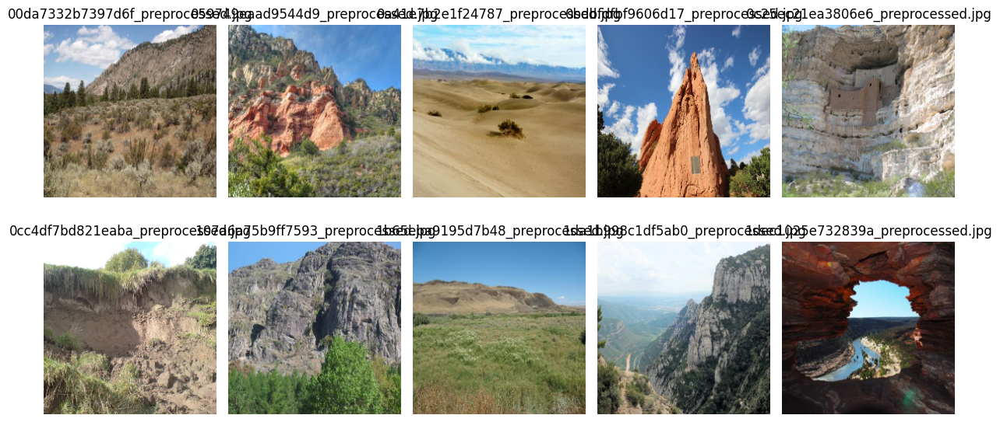

In [ ]:
# Sample data (replace this with your DataFrame)
df_landscape = pd.DataFrame({
    'image_file': df_landscape["image_file"],
    'memoscore': df_landscape["memorability_wo_fa_correction"]
})

# Create a new column to store the paths of preprocessed images
df_landscape['preprocessed_image_path'] = ''

# Empty lists to store preprocessed images
images = []

# Load and preprocess images
for index, row in df_landscape.iterrows():
    image_path = row['image_file']
    image = cv2.imread(image_path)

    if image is None:
        print(f"Error reading image: {image_path}")
        continue

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, (224, 224))  # Resize image if necessary

    # Save preprocessed image to the same path
    preprocessed_path = os.path.splitext(image_path)[0] + '_preprocessed.jpg'
    cv2.imwrite(preprocessed_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))

    # Store preprocessed image path in the DataFrame
    df_landscape.at[index, 'preprocessed_image_path'] = preprocessed_path

    images.append(image)

# Convert the list of images into a NumPy array
images = np.array(images)

# Save preprocessed images as NumPy array (if needed)
#np.save('/content/drive/MyDrive/your_folder/preprocessed_images.npy', images)

# Calculate basic image statistics
print('Image shape:', images.shape)
print('Minimum pixel value:', np.min(images))
print('Maximum pixel value:', np.max(images))
print('Mean pixel value:', np.mean(images))
print('Standard deviation of pixel values:', np.std(images))

# Visualize sample images
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
axes = axes.flatten()
for i in range(min(10, len(images))):
    axes[i].imshow(images[i])
    axes[i].axis('off')
    axes[i].set_title(os.path.basename(df_landscape.at[i, 'preprocessed_image_path']))  # Display file name as title
plt.tight_layout()
plt.show()

# Display the updated DataFrame with preprocessed image paths
#print(df_landscape)

In [ ]:
df_landscape.head()

,image_file,memoscore,preprocessed_image_path
0,/content/landscape/00da7332b7397d6f.jpg,0.577586,/content/landscape/00da7332b7397d6f_preprocess...
1,/content/landscape/059749eaad9544d9.jpg,0.456311,/content/landscape/059749eaad9544d9_preprocess...
2,/content/landscape/0a41e7b2e1f24787.jpg,0.509259,/content/landscape/0a41e7b2e1f24787_preprocess...
3,/content/landscape/0bdbfdfbf9606d17.jpg,0.789474,/content/landscape/0bdbfdfbf9606d17_preprocess...
4,/content/landscape/0c25ec21ea3806e6.jpg,0.788889,/content/landscape/0c25ec21ea3806e6_preprocess...


In [ ]:
del df_landscape["image_file"]

In [ ]:
df_landscape.head()

,memoscore,preprocessed_image_path
0,0.577586,/content/landscape/00da7332b7397d6f_preprocess...
1,0.456311,/content/landscape/059749eaad9544d9_preprocess...
2,0.509259,/content/landscape/0a41e7b2e1f24787_preprocess...
3,0.789474,/content/landscape/0bdbfdfbf9606d17_preprocess...
4,0.788889,/content/landscape/0c25ec21ea3806e6_preprocess...


In [ ]:
from sklearn.model_selection import train_test_split

# Split the DataFrame into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(pd.DataFrame(df_landscape.drop('memoscore', axis=1)), pd.DataFrame(df_landscape['memoscore']), test_size=0.1)

# Split the validation set into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_val, y_val, test_size=0.5)

# Print the train, validation, and test set sizes
print('Train set size:', len(X_train))
print('Validation set size:', len(X_val))
print('Test set size:', len(X_test))

Train set size: 1800
Validation set size: 100
Test set size: 100


In [ ]:
X_train.head()

,preprocessed_image_path
19,/content/landscape/73b01924148f9a88_preprocess...
1182,/content/landscape/c325b519607e21dc_preprocess...
34,/content/landscape/ac3390421ba8e3dc_preprocess...
774,/content/landscape/n09309168_2076_preprocessed...
1677,/content/landscape/n09468604_57854_preprocesse...


In [ ]:
merged_train_landscape= pd.concat([X_train, y_train], axis=1)
merged_train_landscape

,preprocessed_image_path,memoscore
19,/content/landscape/73b01924148f9a88_preprocess...,0.645161
1182,/content/landscape/c325b519607e21dc_preprocess...,0.641509
34,/content/landscape/ac3390421ba8e3dc_preprocess...,0.755319
774,/content/landscape/n09309168_2076_preprocessed...,0.697674
1677,/content/landscape/n09468604_57854_preprocesse...,0.424779
...,...,...
963,/content/landscape/n12345899_7590_preprocessed...,0.407080
425,/content/landscape/sun_acdirvgzjzazssye_prepro...,0.494118
654,/content/landscape/n09288635_25462_preprocesse...,0.633663
1433,/content/landscape/n09376198_39749_preprocesse...,0.604651


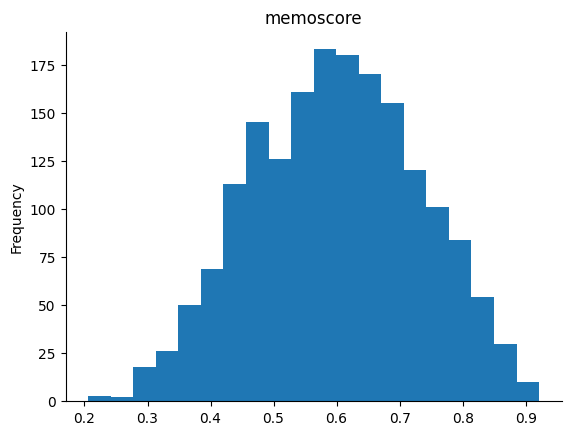

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_train_landscape['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
merged_val_landscape = pd.concat([X_val, y_val], axis=1)
merged_val_landscape

,preprocessed_image_path,memoscore
296,/content/landscape/n09270735_25780_preprocesse...,0.728261
1693,/content/landscape/n09468604_86976_preprocesse...,0.535354
969,/content/landscape/n12345899_9894_preprocessed...,0.472727
1255,/content/landscape/n09415671_19391_preprocesse...,0.458333
1291,/content/landscape/n09415671_9545_preprocessed...,0.553191
...,...,...
754,/content/landscape/n09308572_3703_preprocessed...,0.731183
1146,/content/landscape/462b79af7fb7cbaf_preprocess...,0.645833
189,/content/landscape/1de1c35c00ce3111_preprocess...,0.733945
1016,/content/landscape/n09359803_23069_preprocesse...,0.504673


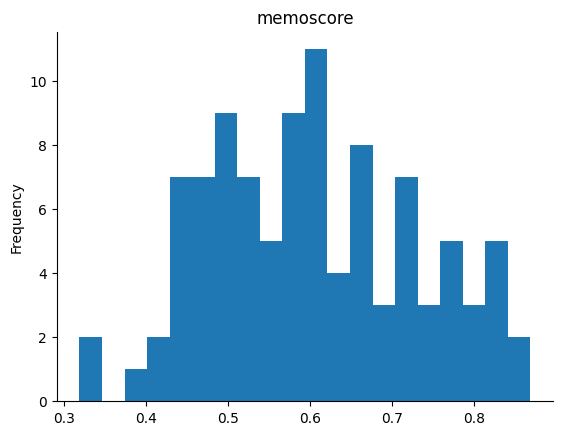

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_val_landscape['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
merged_test_landscape = pd.concat([X_test, y_test], axis=1)
merged_test_landscape

,preprocessed_image_path,memoscore
479,/content/landscape/sun_ahksbkeqopdxmskp_prepro...,0.406593
132,/content/landscape/n02793495_2558_preprocessed...,0.545455
663,/content/landscape/n09288635_365_preprocessed.jpg,0.680000
1389,/content/landscape/n09376198_18482_preprocesse...,0.504348
1960,/content/landscape/f14eeb74dab7f8c1_preprocess...,0.593750
...,...,...
546,/content/landscape/sun_adkeovalbkluzeri_prepro...,0.586957
1063,/content/landscape/n09359803_44389_preprocesse...,0.282353
827,/content/landscape/c9a18643266fb7a8_preprocess...,0.466667
509,/content/landscape/sun_asjcajxcngqwqinm_prepro...,0.302326


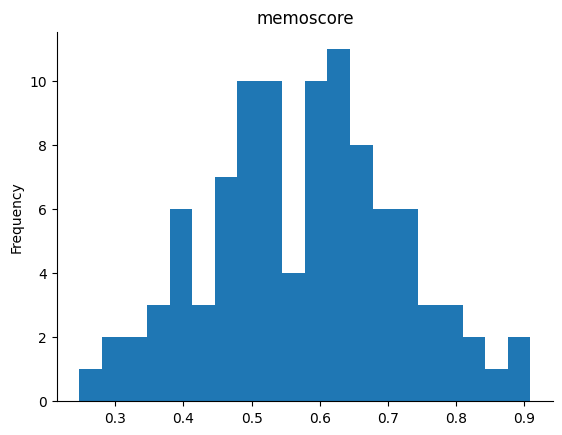

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_test_landscape['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

# Save CSV To GGDrive

In [ ]:
# บันทึกตารางเป็นไฟล์ CSV
csv_train_landscape= '/content/drive/MyDrive/IS/MemCat_data/dataproject/train/landscape_ResNet.csv'
merged_train_landscape.to_csv(csv_train_landscape, index=False)

In [ ]:
csv_val_landscape = '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/landscape_ResNet.csv'
merged_val_landscape.to_csv(csv_val_landscape, index=False)

In [ ]:
csv_test_landscape = '/content/drive/MyDrive/IS/MemCat_data/dataproject/test/landscape_ResNet.csv'
merged_test_landscape.to_csv(csv_test_landscape, index=False)

#Load Dataset

In [ ]:
df_train_landscape = pd.read_csv("/content/drive/MyDrive/IS/MemCat_data/dataproject/train/landscape_ResNet.csv")
df_val_landscape = pd.read_csv( '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/landscape_ResNet.csv')
df_test_landscape = pd.read_csv('/content/drive/MyDrive/IS/MemCat_data/dataproject/test/landscape_ResNet.csv')

In [ ]:
df_train_landscape.head()

,preprocessed_image_path,memoscore
0,/content/landscape/n09376198_19423_preprocesse...,0.561905
1,/content/landscape/e72f9cfc62e3b4be_preprocess...,0.639175
2,/content/landscape/99bcf6128cb5d909_preprocess...,0.316832
3,/content/landscape/17f134afeb63a40f_preprocess...,0.598039
4,/content/landscape/n09468604_54577_preprocesse...,0.620370


In [ ]:
df_train_landscape.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1800 entries, 0 to 1799
Data columns (total 2 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   preprocessed_image_path  1800 non-null   object 
 1   memoscore                1800 non-null   float64
dtypes: float64(1), object(1)
memory usage: 28.2+ KB


#Load Pretrain

In [ ]:
# Define function to add data/model in to GPU (cuda)
def get_default_device():
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
def to_device(data, device):
    # if data is list or tuple, move each of them to device
    if isinstance(data, (list, tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    def __init__(self, dl, device) -> None:
        self.dl = dl
        self.device = device

    def __iter__(self):
        for b in self.dl:
            # yield only execuate when the function is called
            yield to_device(b, self. device)

    def __len__(self):
        return len(self.dl)

## Train

In [ ]:
class Dataset_res_landscape(Dataset):
    def __init__(self, df,Resnet_transform =None):
        self.labels = df_train_landscape["memoscore"]
        self.images = df_train_landscape["preprocessed_image_path"]
        self.Resnet_transform  = Resnet_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.Resnet_transform (image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
#trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
Resnet_transform   = ConvNextImageProcessor.from_pretrained("facebook/convnext-tiny-224")

# สร้าง Dataset และ DataLoader
train_ds = Dataset_res_landscape(df_train_landscape, Resnet_transform =Resnet_transform )
train_dl = DataLoader(train_ds, batch_size=32, shuffle=False)



/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/266 [00:00<?, ?B/s]

In [ ]:
class ResNet_model_train_landscape(torch.nn.Module):
    def __init__(self, arch="resnet50.a1_in1k"):    #microsoft/resnet-50
        super().__init__()
        self.arch = arch
        self.res = timm.create_model(self.arch, pretrained=True, num_classes=1)
        #self.res_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))


    def forward(self, x):
        resfeat = self.res(x)
        #adap = self.res_AdaptiveAvgPool(x)
        out = torch.sigmoid(resfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

ResNet = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_res =  ResNet_model_train_landscape( arch="resnet50.a1_in1k")


model.safetensors:   0%|          | 0.00/102M [00:00<?, ?B/s]

In [ ]:
# Assuming your model is an instance of YourModelClass and is already on GPU
model =ResNet_model_train_landscape().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)




----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
         Identity-10           [-1, 64, 56, 56]               0
             ReLU-11           [-1, 64, 56, 56]               0
         Identity-12           [-1, 64, 56, 56]               0
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model_res  = to_device(model_res  , device)

In [ ]:
params = [param for param in list(model_res.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)


In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/50) Loss = 0.011171531863510609

 Epoch: (1/50) Loss_rmse = 0.10569547116756439

 Epoch: (1/50) R^2 = -0.03239738941192627

 Epoch: (1/50) MAE = 0.0717819333076477
Spearman correlation coefficient: SignificanceResult(statistic=0.10720540569491874, pvalue=5.411504188720018e-06)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.593

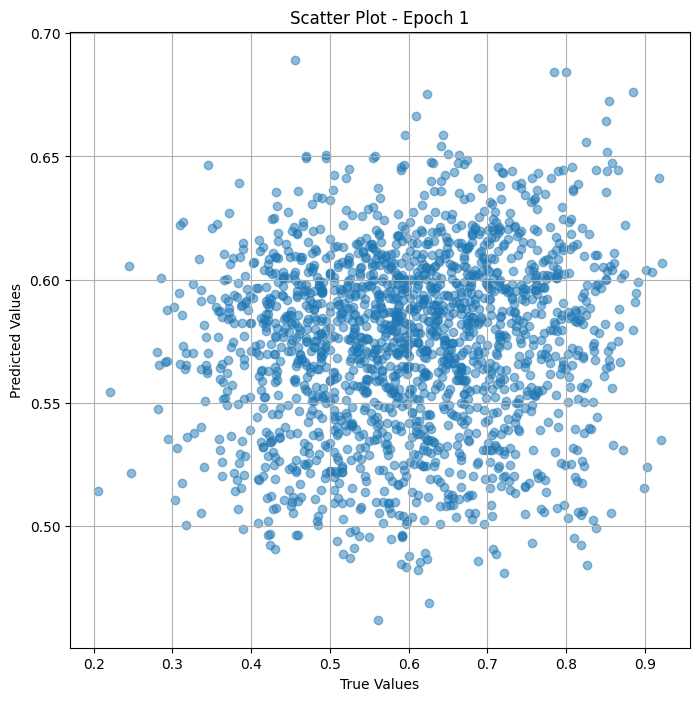

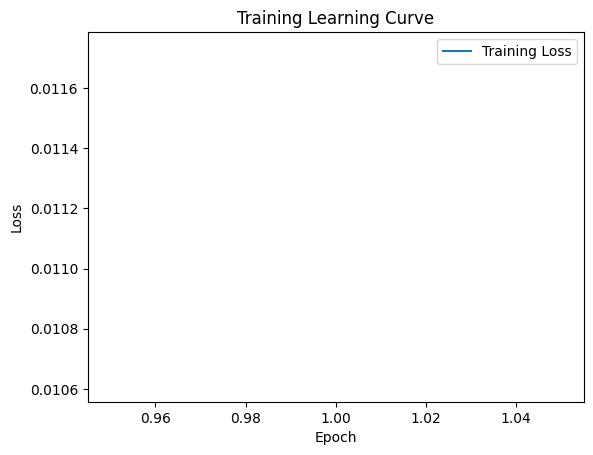


 Epoch: (2/50) Loss = 0.004431781824678183

 Epoch: (2/50) Loss_rmse = 0.06657163053750992

 Epoch: (2/50) R^2 = 0.5904447436332703

 Epoch: (2/50) MAE = 0.03651820495724678
Spearman correlation coefficient: SignificanceResult(statistic=0.7521251451759429, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615386, 0.

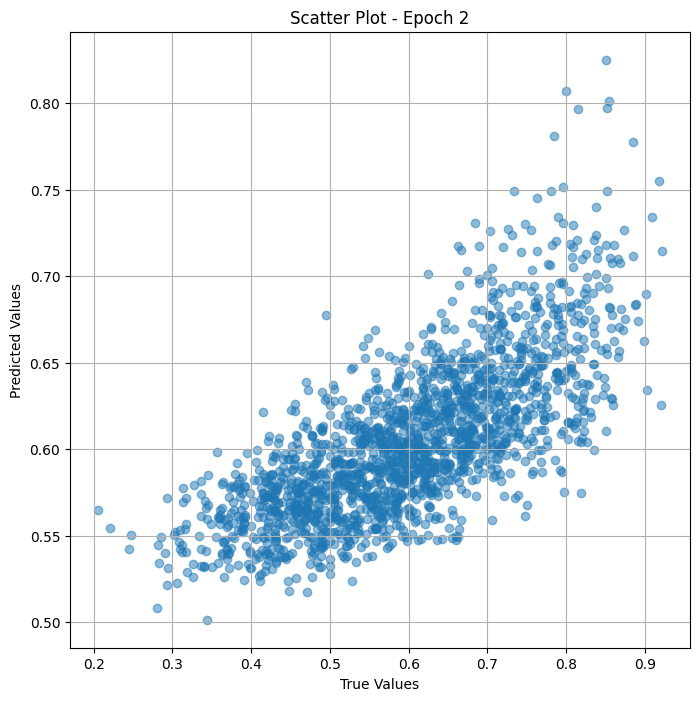

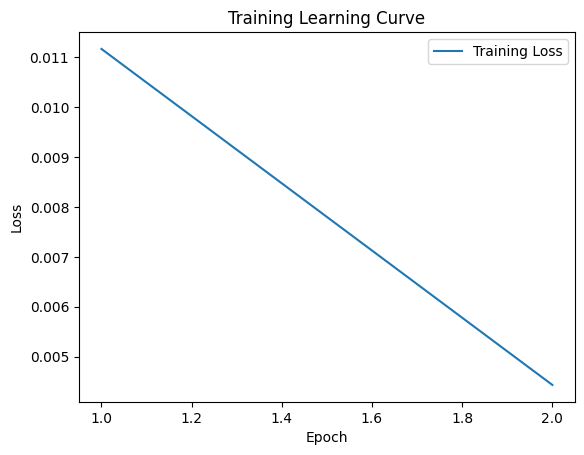


 Epoch: (3/50) Loss = 0.002037648344412446

 Epoch: (3/50) Loss_rmse = 0.04514031857252121

 Epoch: (3/50) R^2 = 0.811694324016571

 Epoch: (3/50) MAE = 0.02759592980146408
Spearman correlation coefficient: SignificanceResult(statistic=0.8838999797530663, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615386, 0.7

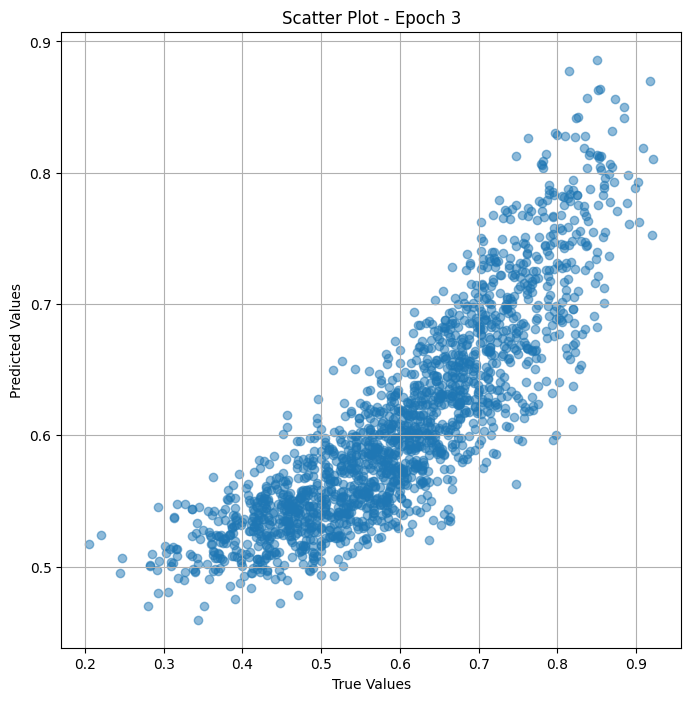

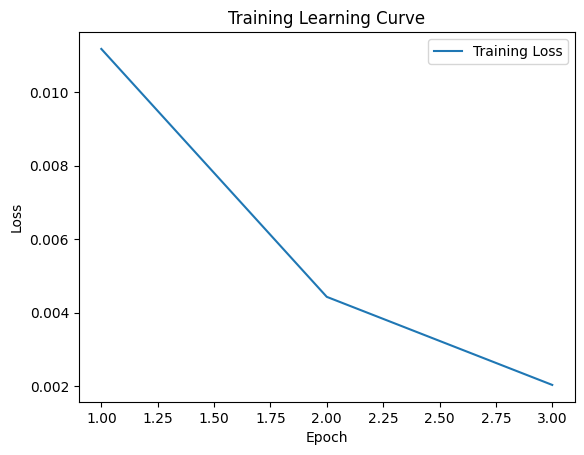


 Epoch: (4/50) Loss = 0.0017940504476428032

 Epoch: (4/50) Loss_rmse = 0.042356234043836594

 Epoch: (4/50) R^2 = 0.8342059850692749

 Epoch: (4/50) MAE = 0.035554200410842896
Spearman correlation coefficient: SignificanceResult(statistic=0.9375043325376868, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615386,

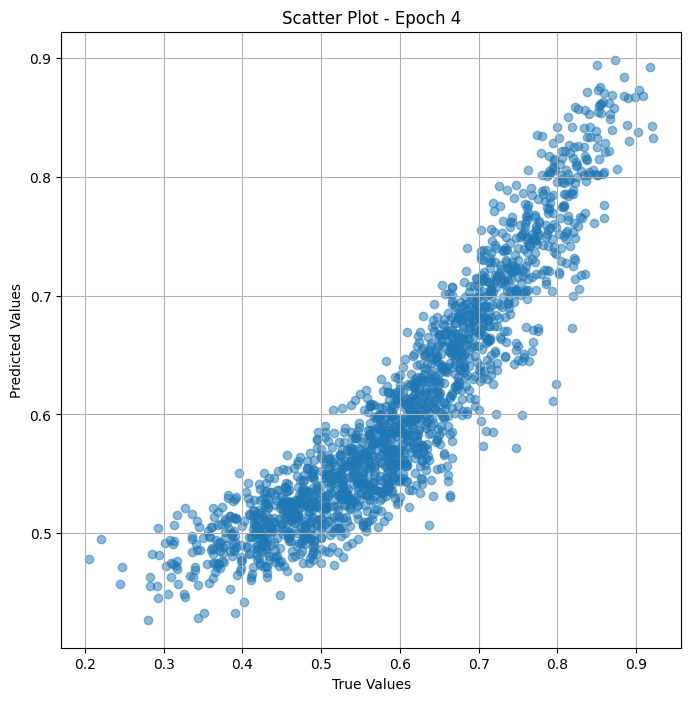

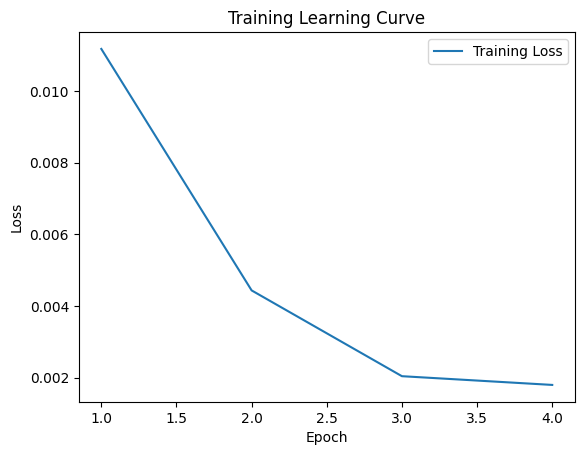


 Epoch: (5/50) Loss = 0.0032986460719257593

 Epoch: (5/50) Loss_rmse = 0.0574338398873806

 Epoch: (5/50) R^2 = 0.6951614618301392

 Epoch: (5/50) MAE = 0.04453301057219505
Spearman correlation coefficient: SignificanceResult(statistic=0.9669718957122677, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615386, 0.

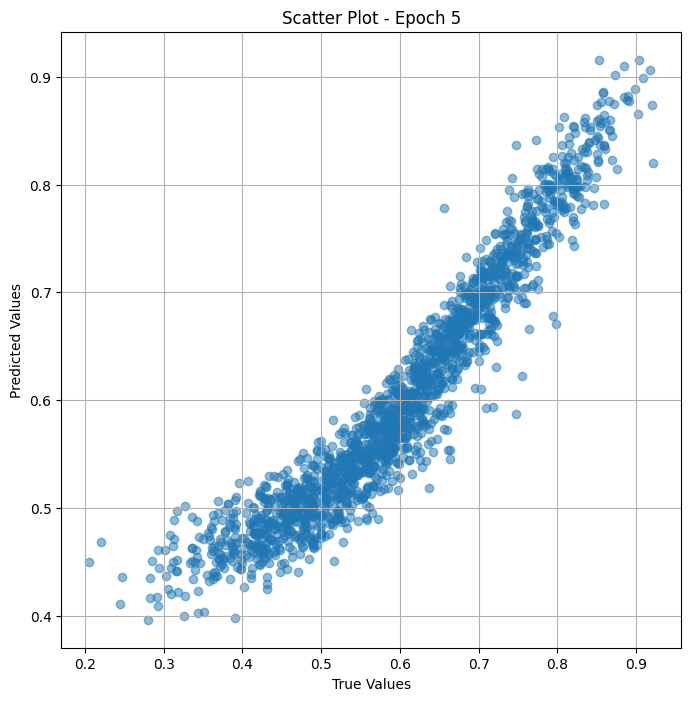

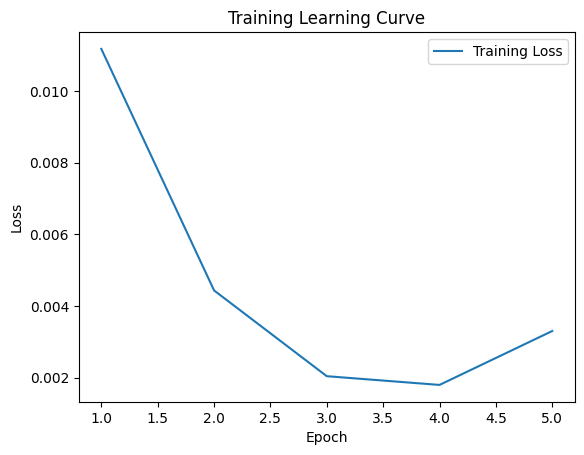


 Epoch: (6/50) Loss = 0.0036832012701779604

 Epoch: (6/50) Loss_rmse = 0.06068938225507736

 Epoch: (6/50) R^2 = 0.6596235036849976

 Epoch: (6/50) MAE = 0.04249662533402443
Spearman correlation coefficient: SignificanceResult(statistic=0.9780667581136981, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615386, 0

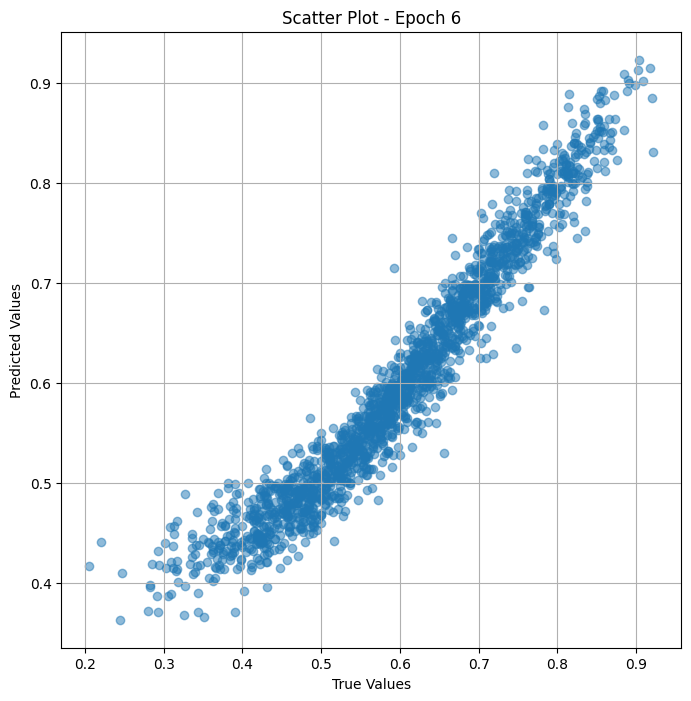

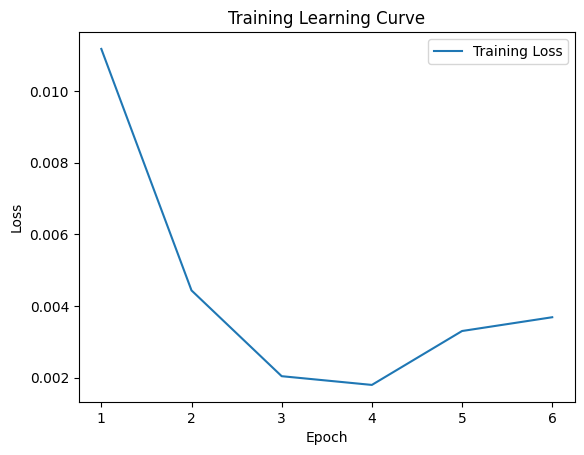

Epoch 0.07: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (7/50) Loss = 0.004237161949276924

 Epoch: (7/50) Loss_rmse = 0.06509348750114441

 Epoch: (7/50) R^2 = 0.6084301471710205

 Epoch: (7/50) MAE = 0.048594880849123
Spearman correlation coefficient: SignificanceResult(statistic=0.9833418312521052, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922

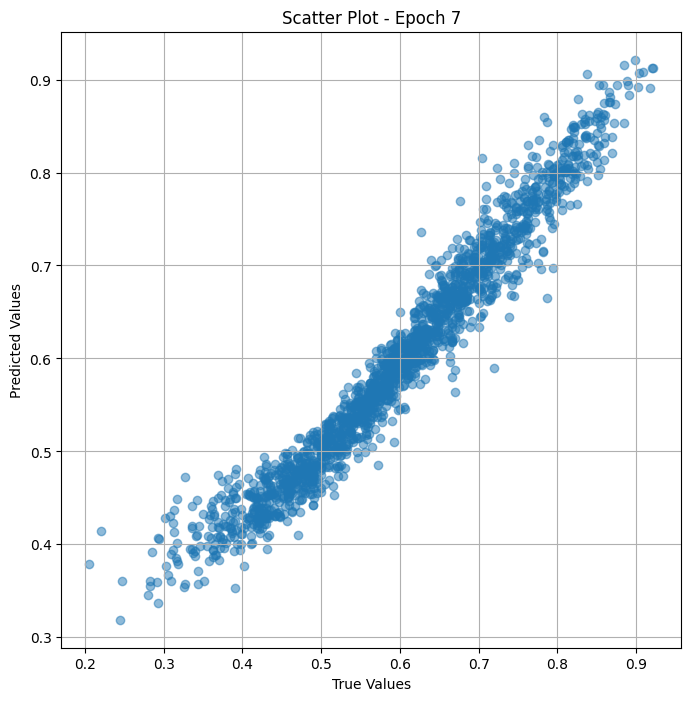

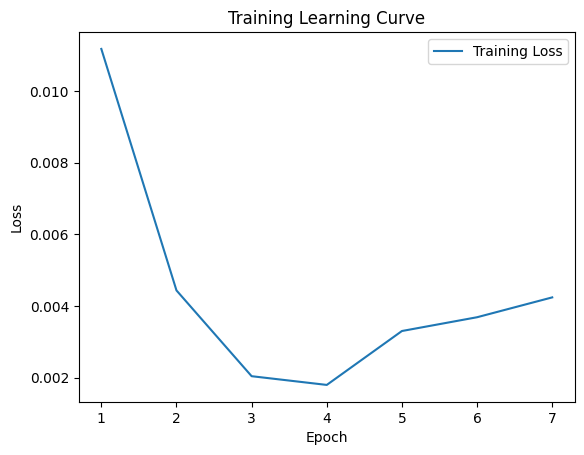


 Epoch: (8/50) Loss = 0.0010006730444729328

 Epoch: (8/50) Loss_rmse = 0.031633418053388596

 Epoch: (8/50) R^2 = 0.907524585723877

 Epoch: (8/50) MAE = 0.02252284809947014
Spearman correlation coefficient: SignificanceResult(statistic=0.9865566526885343, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615386, 0

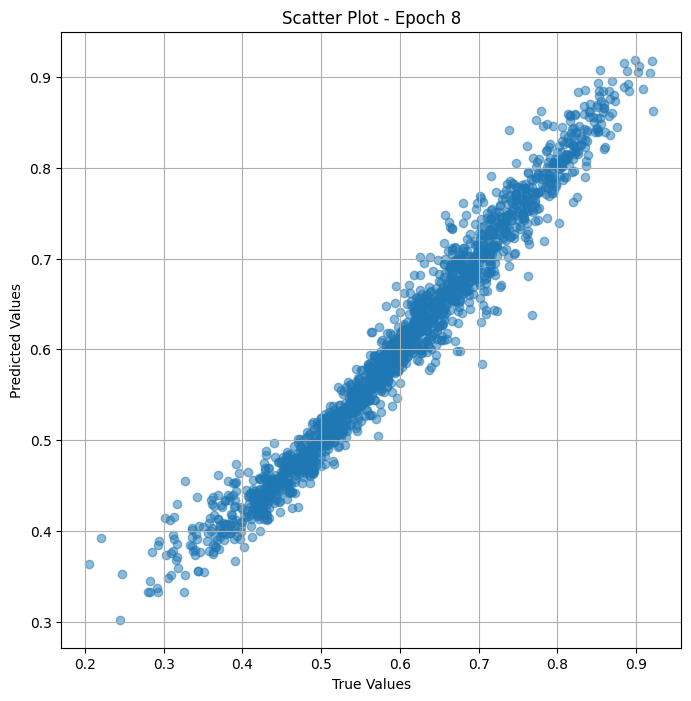

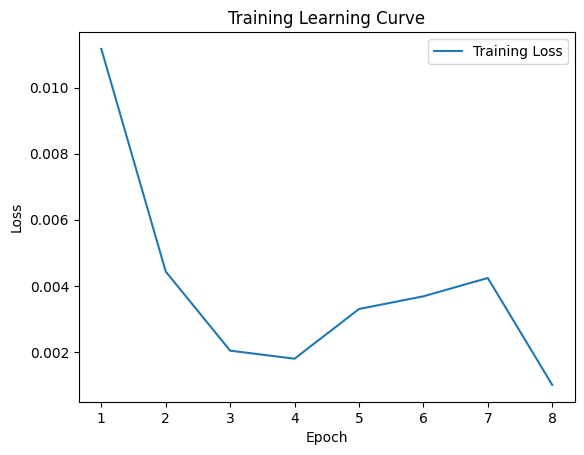


 Epoch: (9/50) Loss = 0.0005039724637754261

 Epoch: (9/50) Loss_rmse = 0.022449331358075142

 Epoch: (9/50) R^2 = 0.9534263014793396

 Epoch: (9/50) MAE = 0.01636369153857231
Spearman correlation coefficient: SignificanceResult(statistic=0.9915639666229099, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615386, 

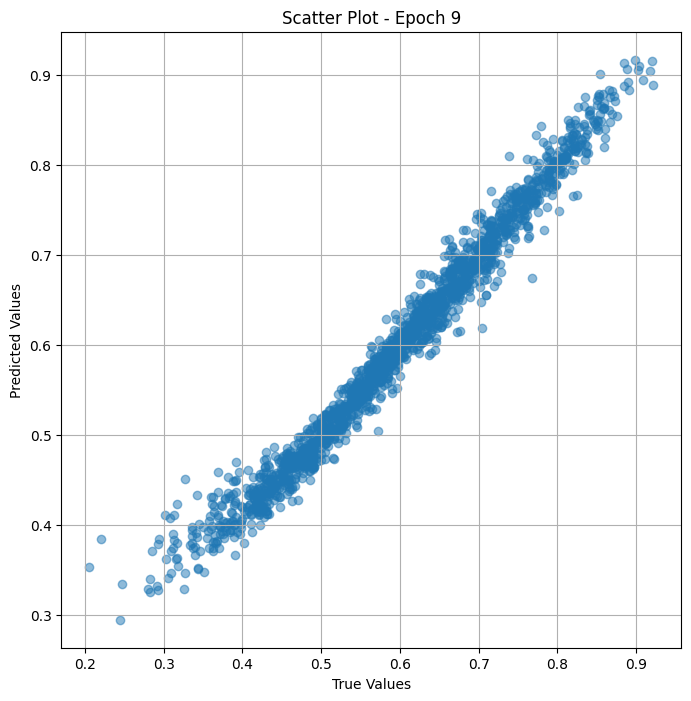

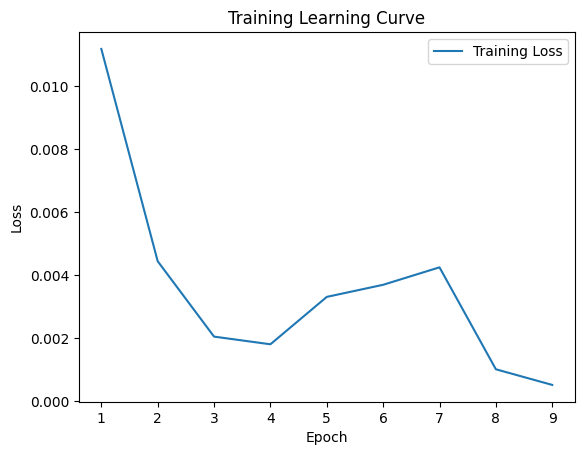


 Epoch: (10/50) Loss = 0.00023318389139603823

 Epoch: (10/50) Loss_rmse = 0.015270359814167023

 Epoch: (10/50) R^2 = 0.9784507155418396

 Epoch: (10/50) MAE = 0.012163128703832626
Spearman correlation coefficient: SignificanceResult(statistic=0.9942063035510426, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5961

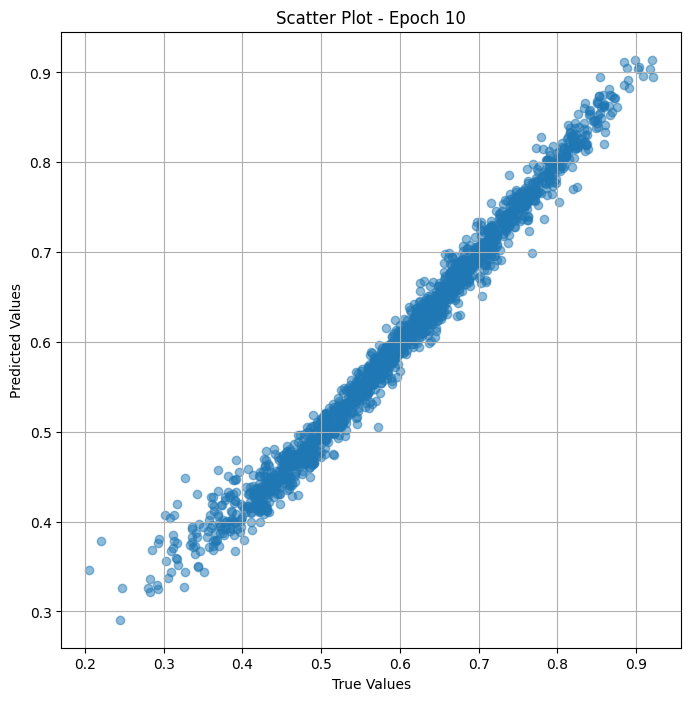

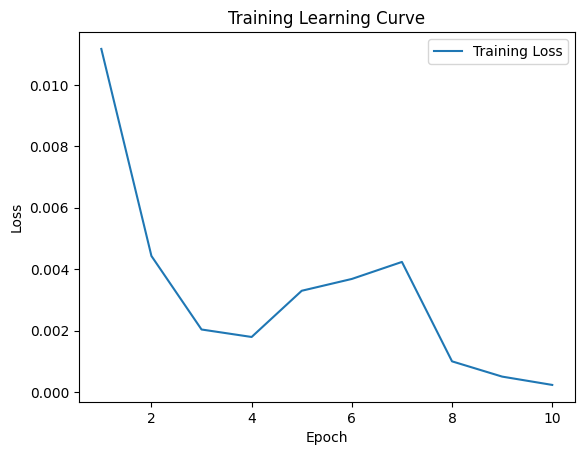


 Epoch: (11/50) Loss = 0.00011088233441114426

 Epoch: (11/50) Loss_rmse = 0.010530068539083004

 Epoch: (11/50) R^2 = 0.989753007888794

 Epoch: (11/50) MAE = 0.00902533158659935
Spearman correlation coefficient: SignificanceResult(statistic=0.9956568528446028, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596153

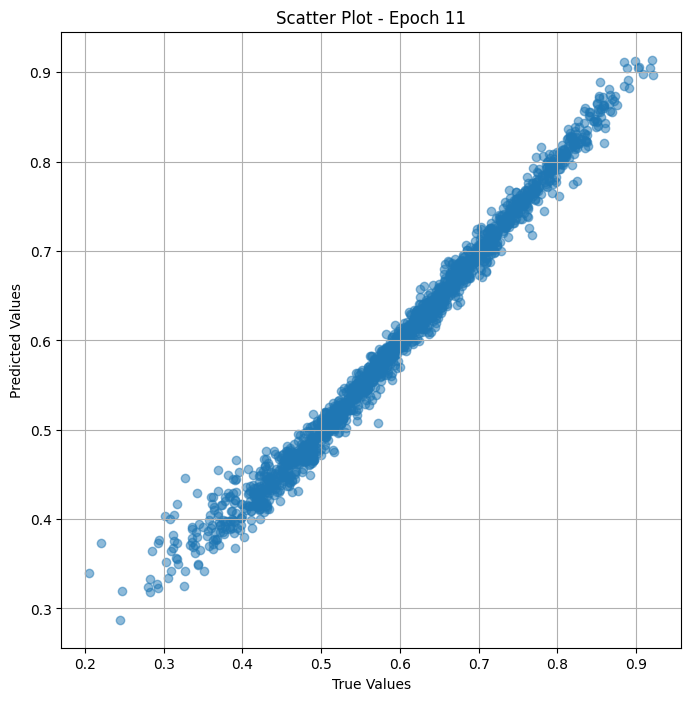

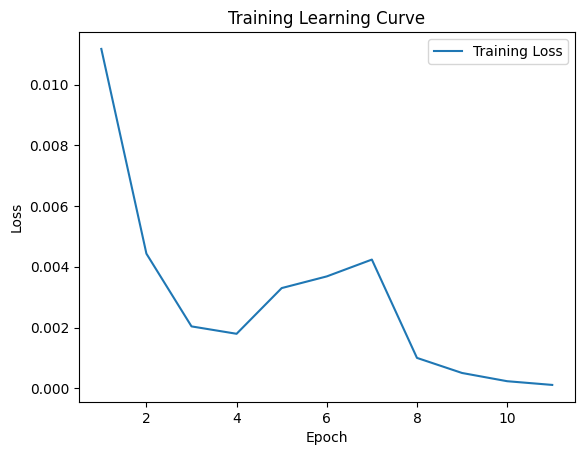


 Epoch: (12/50) Loss = 5.833543400513008e-05

 Epoch: (12/50) Loss_rmse = 0.007637763861566782

 Epoch: (12/50) R^2 = 0.9946090579032898

 Epoch: (12/50) MAE = 0.006819058209657669
Spearman correlation coefficient: SignificanceResult(statistic=0.9965570572540571, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615

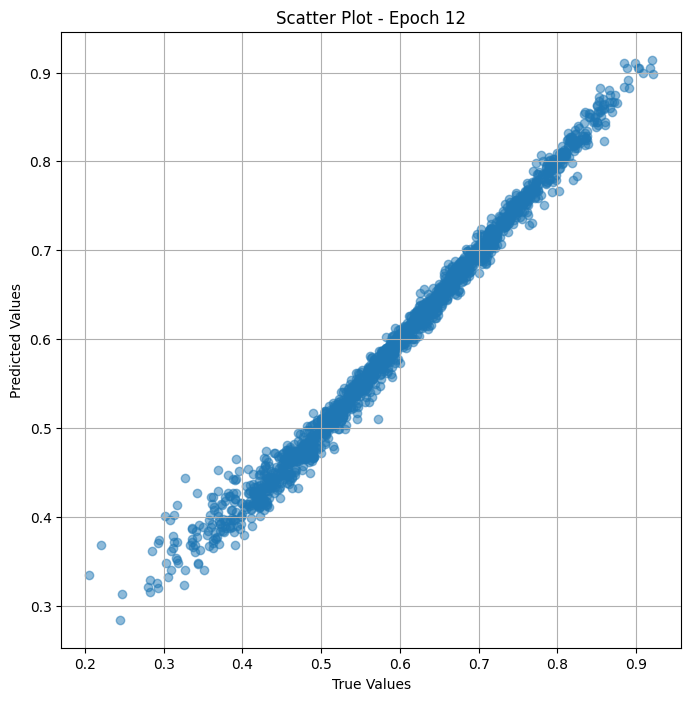

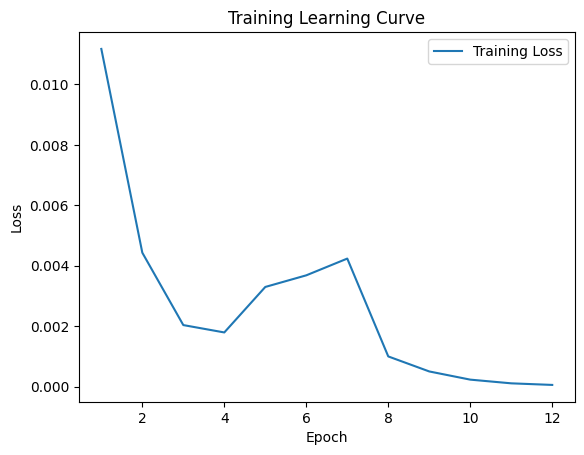


 Epoch: (13/50) Loss = 3.573176945792511e-05

 Epoch: (13/50) Loss_rmse = 0.00597760546952486

 Epoch: (13/50) R^2 = 0.9966979026794434

 Epoch: (13/50) MAE = 0.005323261022567749
Spearman correlation coefficient: SignificanceResult(statistic=0.9971366901679631, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596153

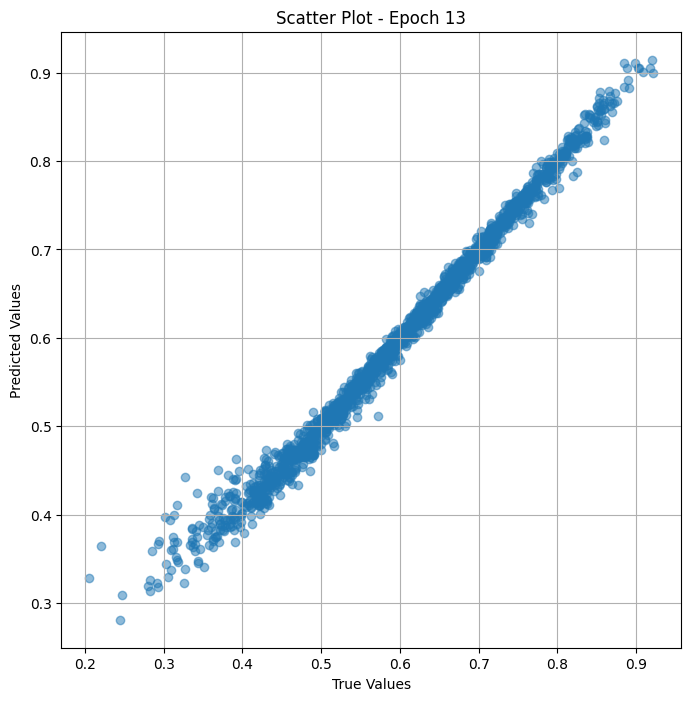

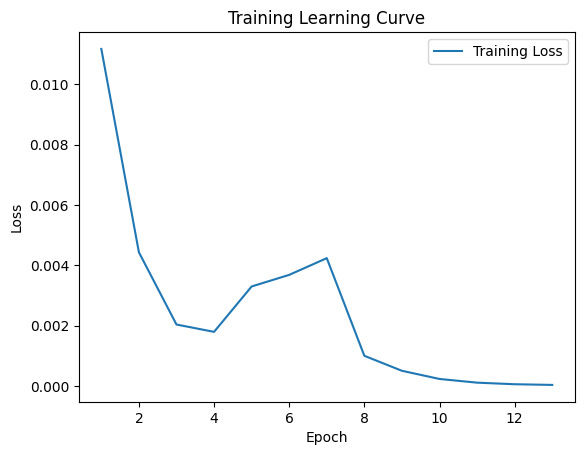


 Epoch: (14/50) Loss = 2.4095948901958764e-05

 Epoch: (14/50) Loss_rmse = 0.004908762406557798

 Epoch: (14/50) R^2 = 0.9977732300758362

 Epoch: (14/50) MAE = 0.004191931337118149
Spearman correlation coefficient: SignificanceResult(statistic=0.9975513029238908, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5961

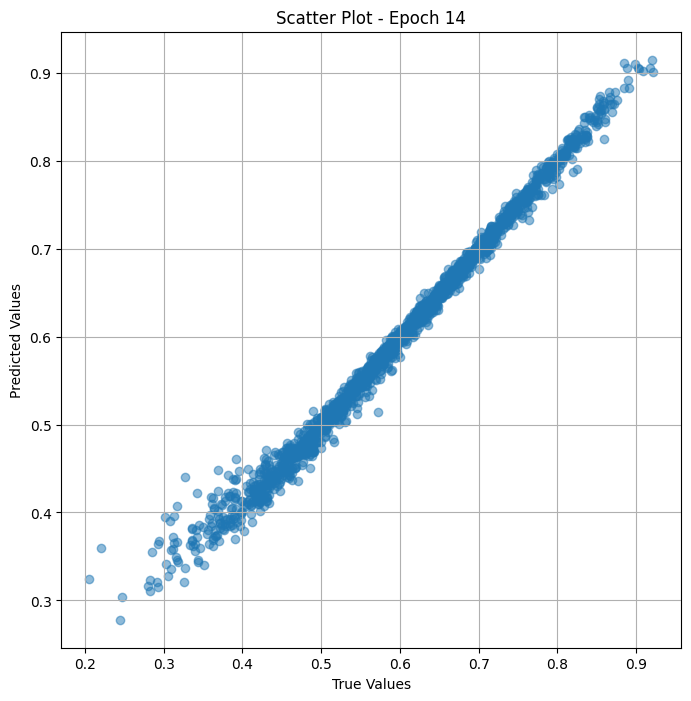

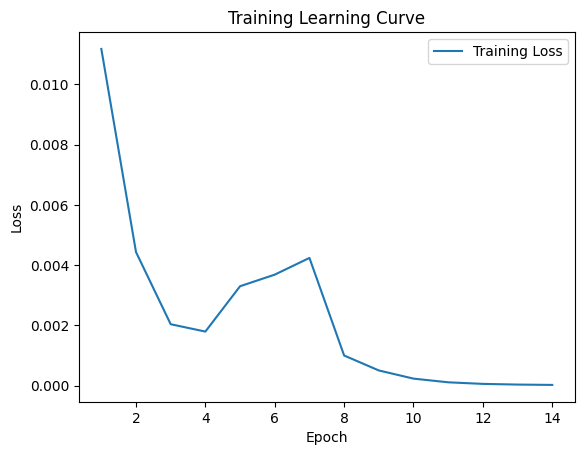


 Epoch: (15/50) Loss = 1.7612419469514862e-05

 Epoch: (15/50) Loss_rmse = 0.0041967155411839485

 Epoch: (15/50) R^2 = 0.9983723759651184

 Epoch: (15/50) MAE = 0.0033669881522655487
Spearman correlation coefficient: SignificanceResult(statistic=0.9978657285188909, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

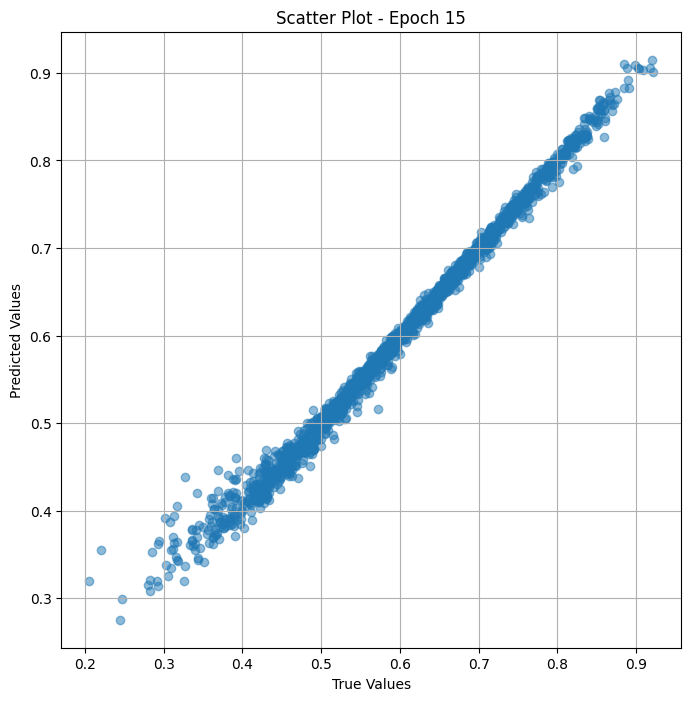

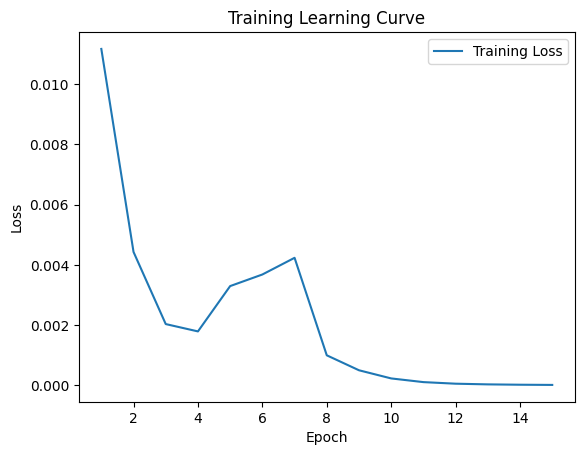


 Epoch: (16/50) Loss = 1.3512549230654258e-05

 Epoch: (16/50) Loss_rmse = 0.0036759418435394764

 Epoch: (16/50) R^2 = 0.9987512826919556

 Epoch: (16/50) MAE = 0.0027900785207748413
Spearman correlation coefficient: SignificanceResult(statistic=0.9981263878000823, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

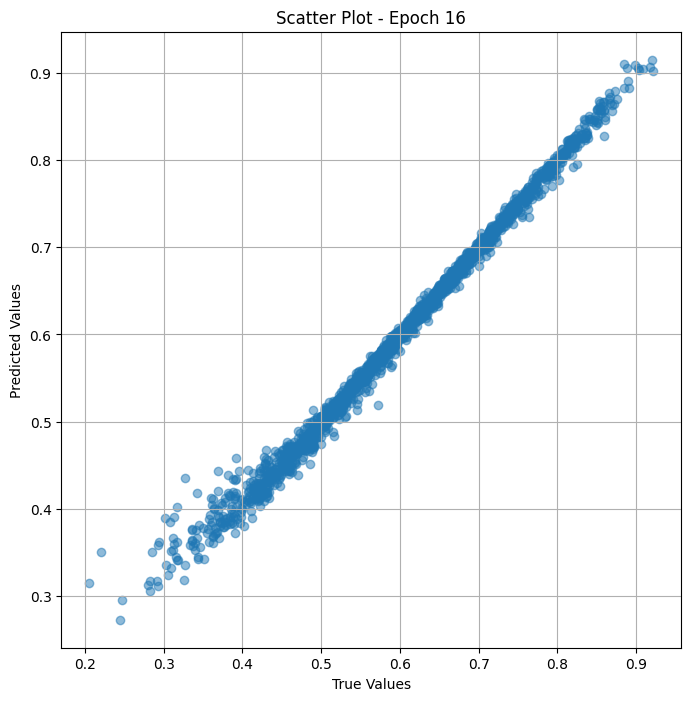

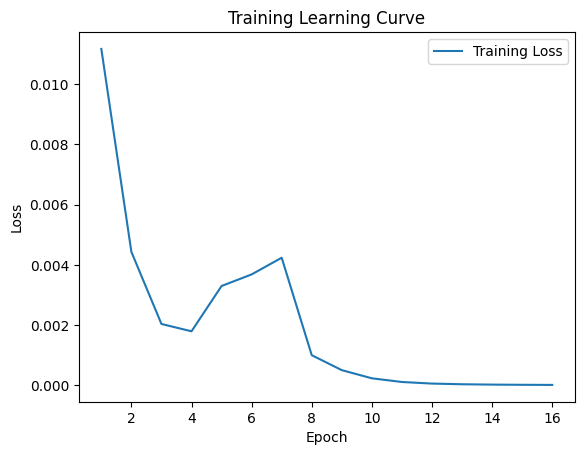


 Epoch: (17/50) Loss = 1.0423495041322894e-05

 Epoch: (17/50) Loss_rmse = 0.0032285437919199467

 Epoch: (17/50) R^2 = 0.9990367293357849

 Epoch: (17/50) MAE = 0.002345871180295944
Spearman correlation coefficient: SignificanceResult(statistic=0.9983493031644302, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

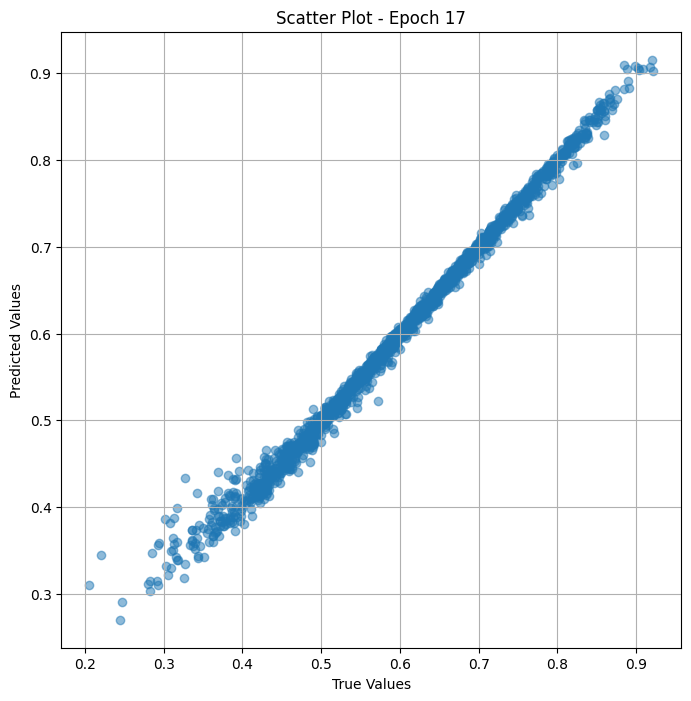

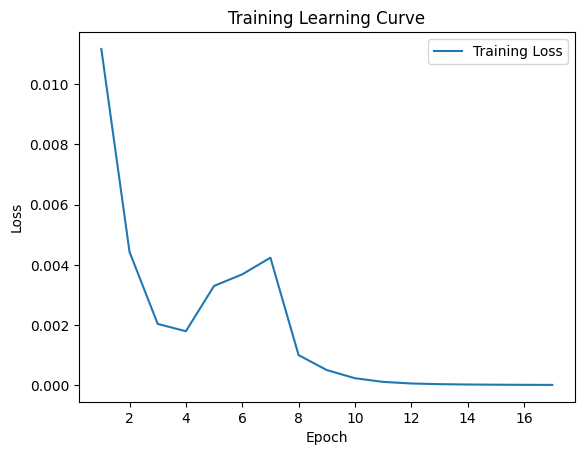


 Epoch: (18/50) Loss = 8.017115760594606e-06

 Epoch: (18/50) Loss_rmse = 0.002831451129168272

 Epoch: (18/50) R^2 = 0.9992591142654419

 Epoch: (18/50) MAE = 0.001978650689125061
Spearman correlation coefficient: SignificanceResult(statistic=0.9985367267351496, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615

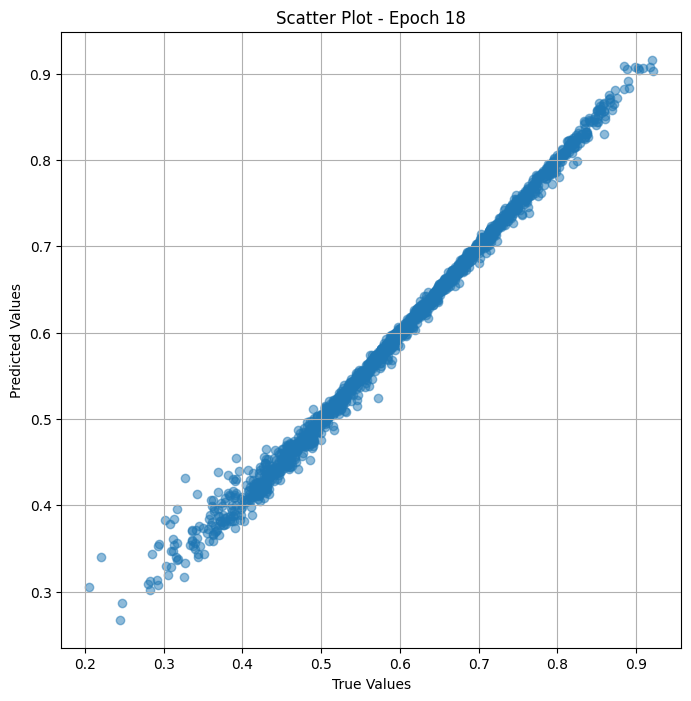

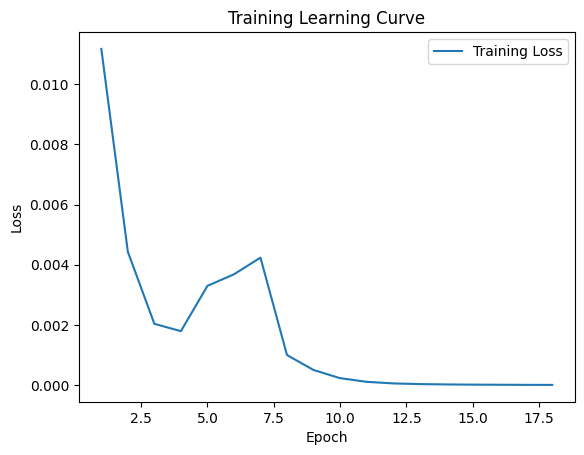


 Epoch: (19/50) Loss = 6.105374268372543e-06

 Epoch: (19/50) Loss_rmse = 0.0024709056597203016

 Epoch: (19/50) R^2 = 0.9994357824325562

 Epoch: (19/50) MAE = 0.0016735084354877472
Spearman correlation coefficient: SignificanceResult(statistic=0.9986961165850909, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

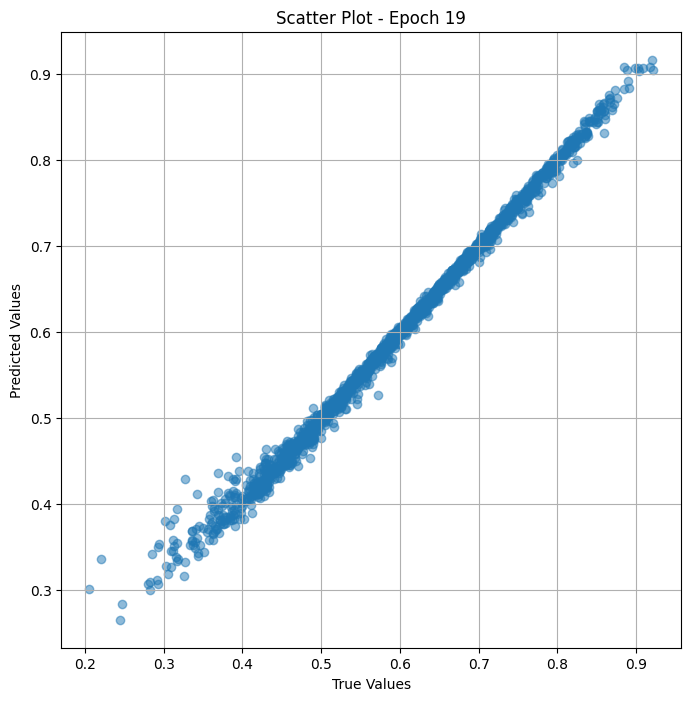

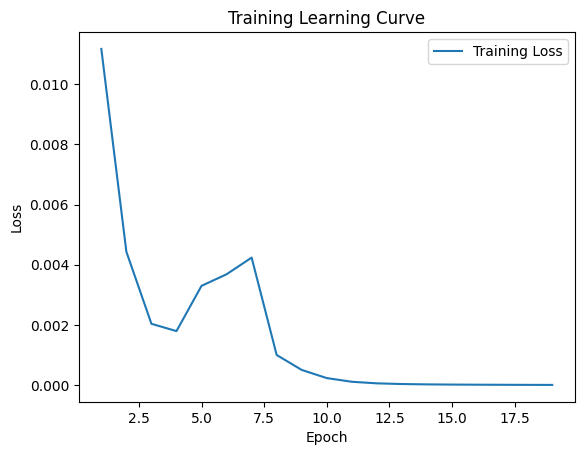


 Epoch: (20/50) Loss = 4.608859853760805e-06

 Epoch: (20/50) Loss_rmse = 0.0021468254271894693

 Epoch: (20/50) R^2 = 0.9995740652084351

 Epoch: (20/50) MAE = 0.001415114849805832
Spearman correlation coefficient: SignificanceResult(statistic=0.9988372089765599, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5961

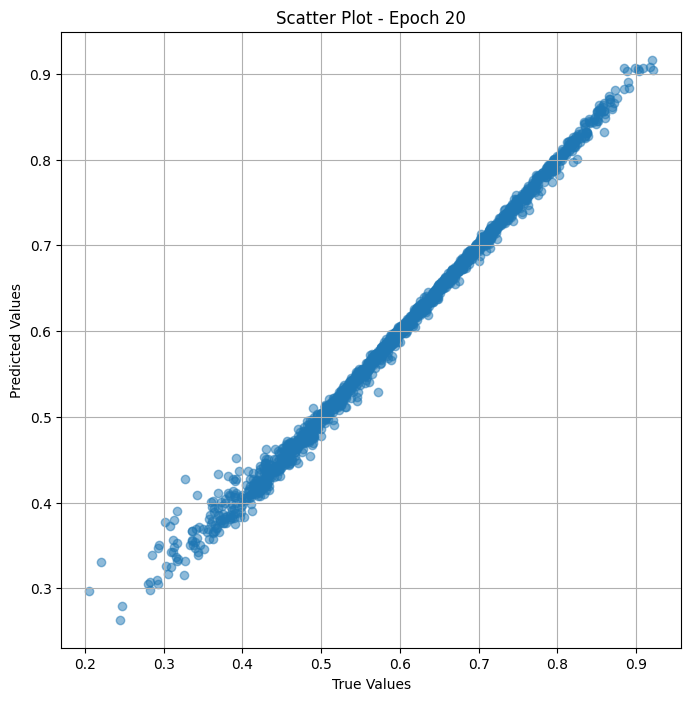

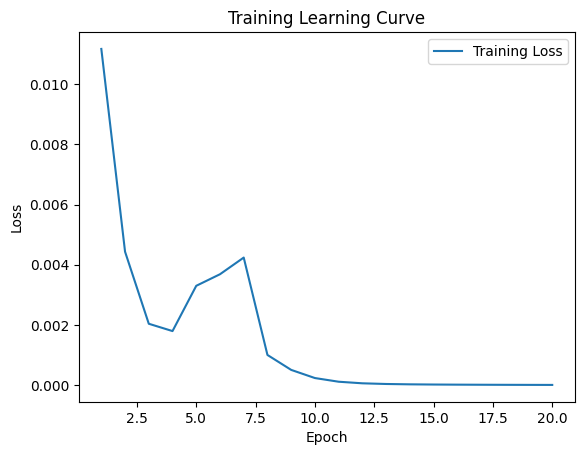


 Epoch: (21/50) Loss = 3.484847184154205e-06

 Epoch: (21/50) Loss_rmse = 0.0018667745171114802

 Epoch: (21/50) R^2 = 0.9996779561042786

 Epoch: (21/50) MAE = 0.0012024454772472382
Spearman correlation coefficient: SignificanceResult(statistic=0.9989685296556353, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

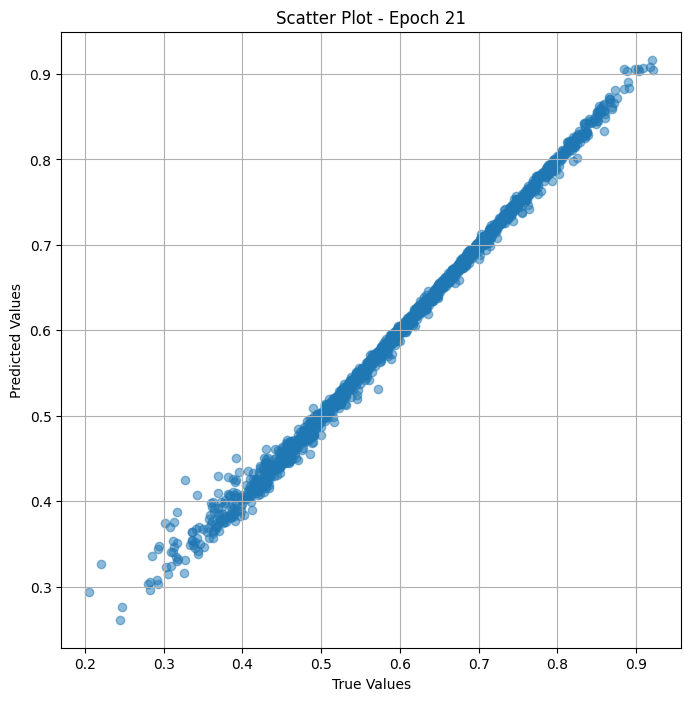

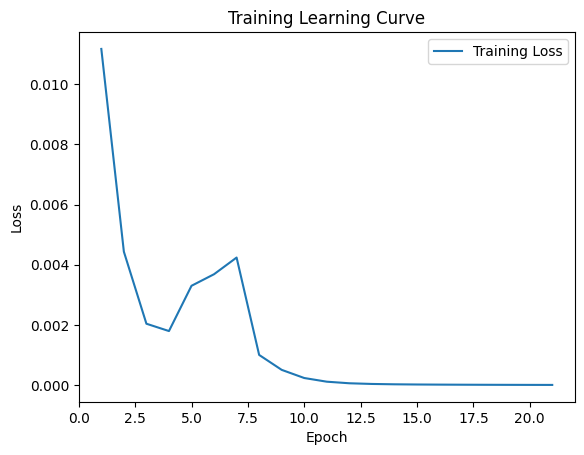


 Epoch: (22/50) Loss = 2.643677817104617e-06

 Epoch: (22/50) Loss_rmse = 0.0016259390395134687

 Epoch: (22/50) R^2 = 0.9997556805610657

 Epoch: (22/50) MAE = 0.0010159090161323547
Spearman correlation coefficient: SignificanceResult(statistic=0.9990893445969726, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

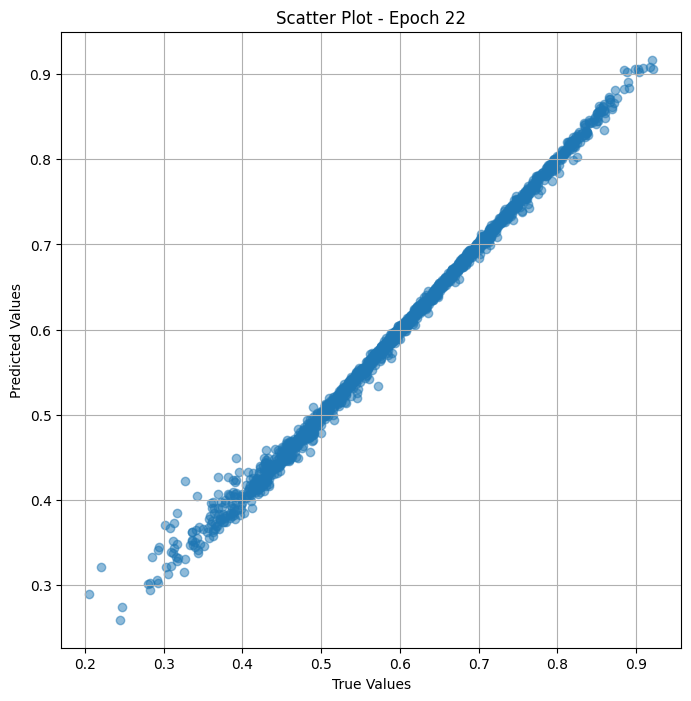

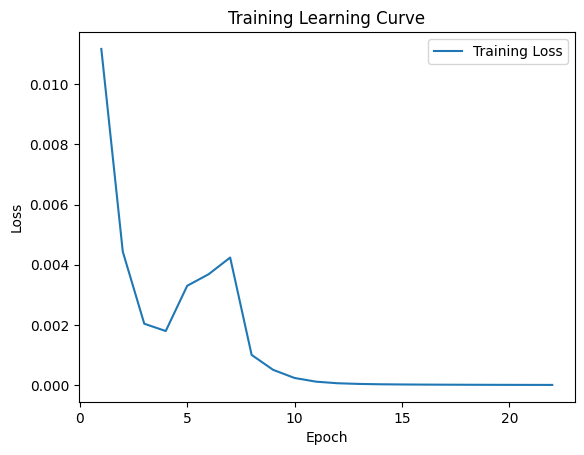


 Epoch: (23/50) Loss = 1.9578574210754596e-06

 Epoch: (23/50) Loss_rmse = 0.0013992346357554197

 Epoch: (23/50) R^2 = 0.9998190402984619

 Epoch: (23/50) MAE = 0.000856347382068634
Spearman correlation coefficient: SignificanceResult(statistic=0.9991968449024508, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

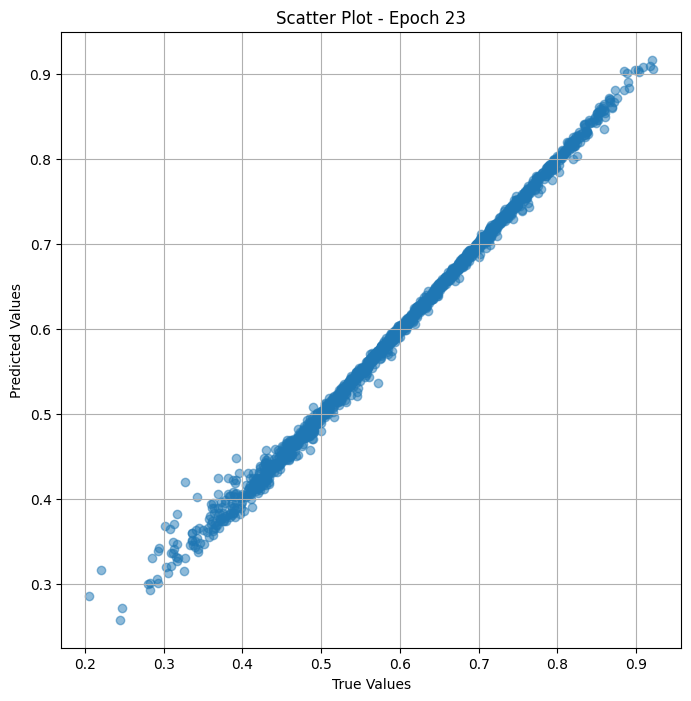

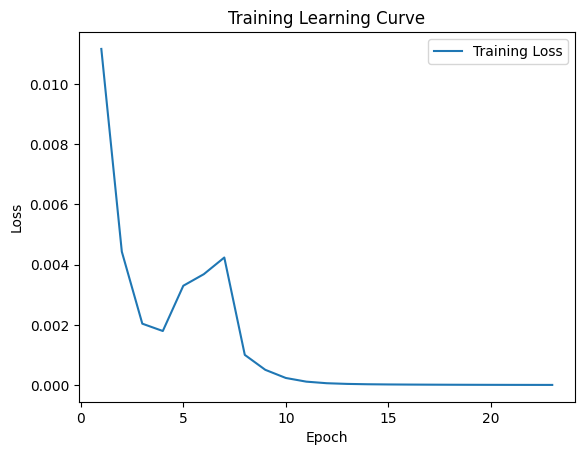


 Epoch: (24/50) Loss = 1.4792515230510617e-06

 Epoch: (24/50) Loss_rmse = 0.0012162448838353157

 Epoch: (24/50) R^2 = 0.99986332654953

 Epoch: (24/50) MAE = 0.0007276348769664764
Spearman correlation coefficient: SignificanceResult(statistic=0.9992887044207315, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5961

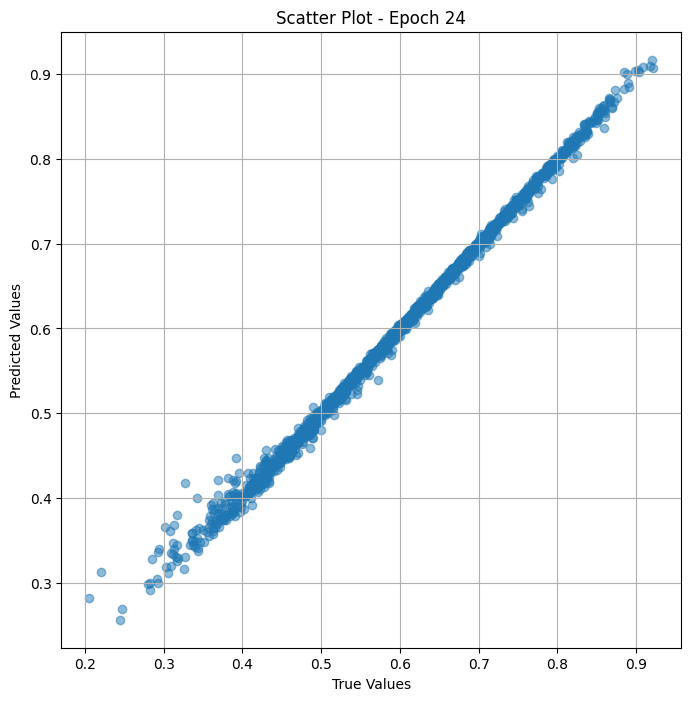

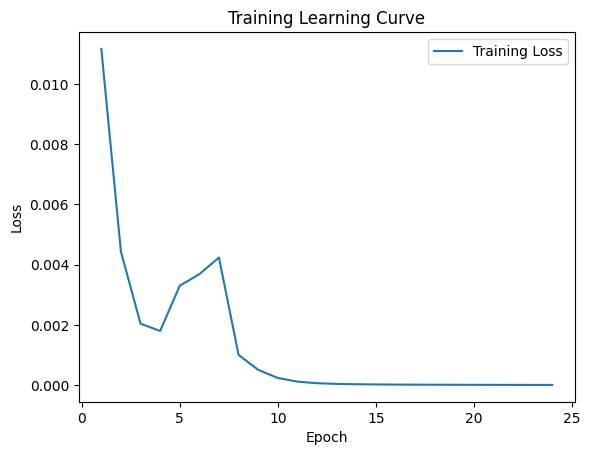


 Epoch: (25/50) Loss = 1.1115706683995086e-06

 Epoch: (25/50) Loss_rmse = 0.0010543104726821184

 Epoch: (25/50) R^2 = 0.999897301197052

 Epoch: (25/50) MAE = 0.0006101280450820923
Spearman correlation coefficient: SignificanceResult(statistic=0.9993740515493816, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

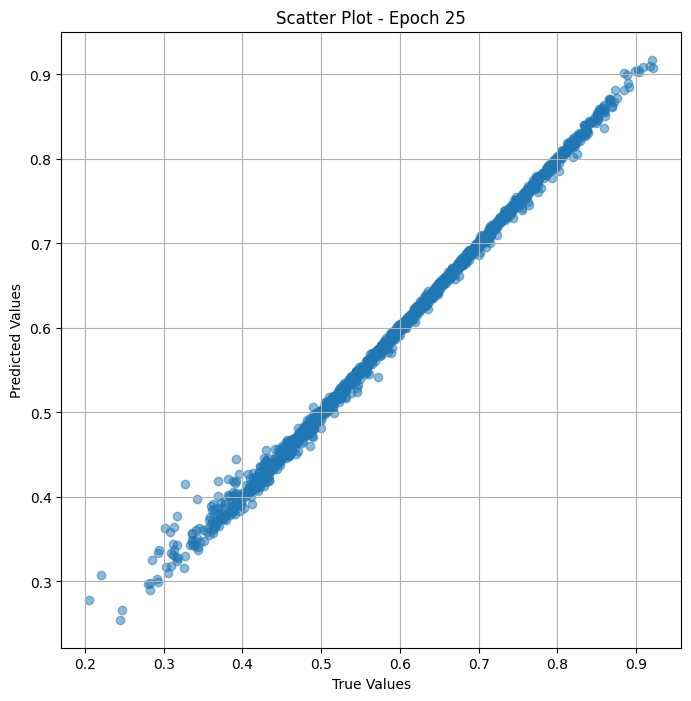

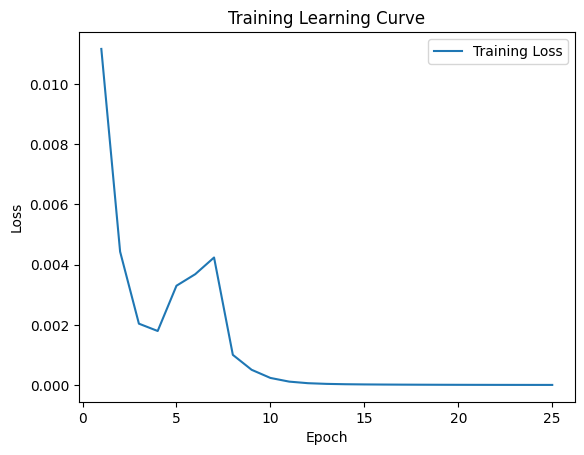


 Epoch: (26/50) Loss = 8.795728376753686e-07

 Epoch: (26/50) Loss_rmse = 0.0009378554532304406

 Epoch: (26/50) R^2 = 0.9999186992645264

 Epoch: (26/50) MAE = 0.0005267076194286346
Spearman correlation coefficient: SignificanceResult(statistic=0.9994516643030279, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

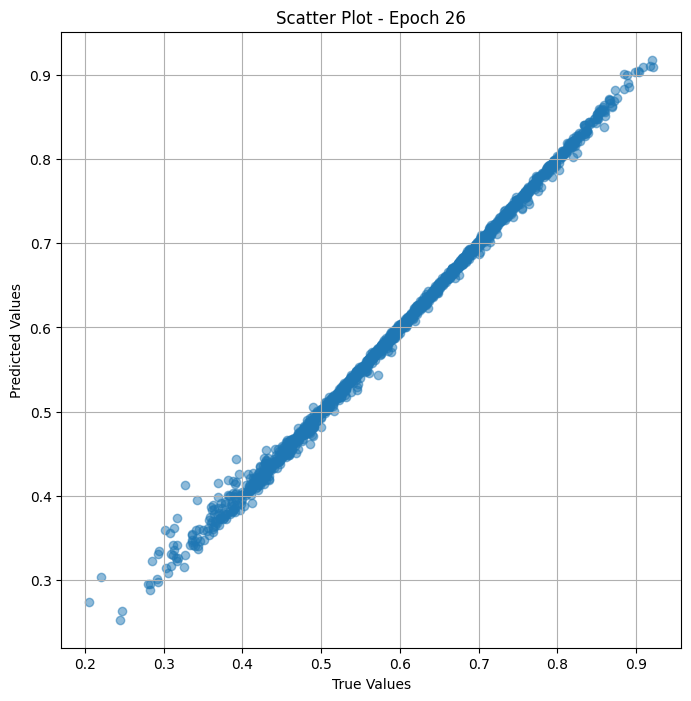

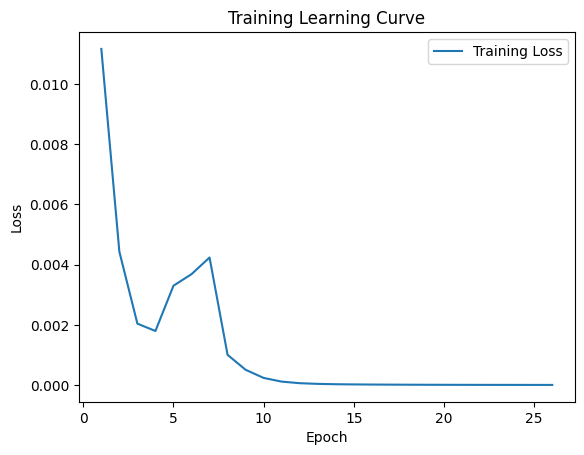


 Epoch: (27/50) Loss = 6.812797437305562e-07

 Epoch: (27/50) Loss_rmse = 0.0008253967389464378

 Epoch: (27/50) R^2 = 0.9999370574951172

 Epoch: (27/50) MAE = 0.00044778361916542053
Spearman correlation coefficient: SignificanceResult(statistic=0.9995168288626635, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

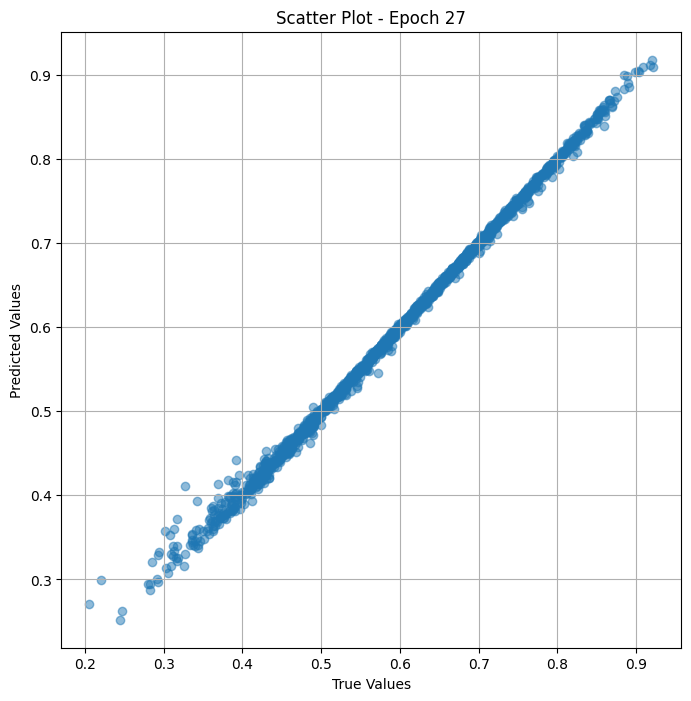

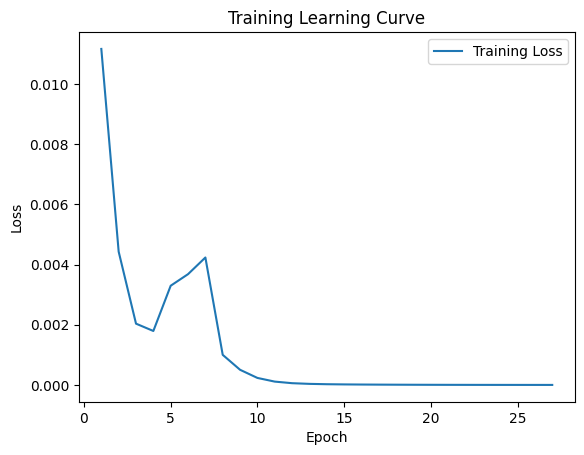


 Epoch: (28/50) Loss = 5.470784572025877e-07

 Epoch: (28/50) Loss_rmse = 0.0007396475411951542

 Epoch: (28/50) R^2 = 0.9999494552612305

 Epoch: (28/50) MAE = 0.00040867552161216736
Spearman correlation coefficient: SignificanceResult(statistic=0.9995794973190689, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

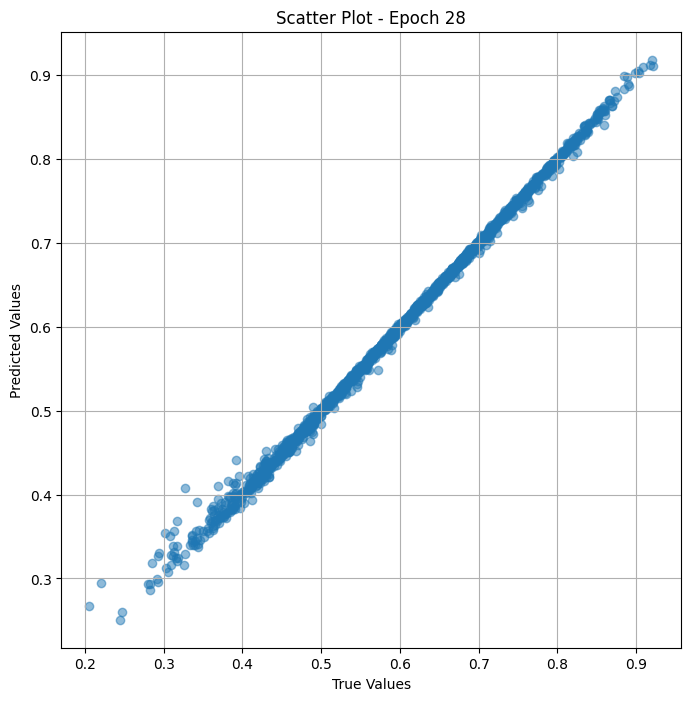

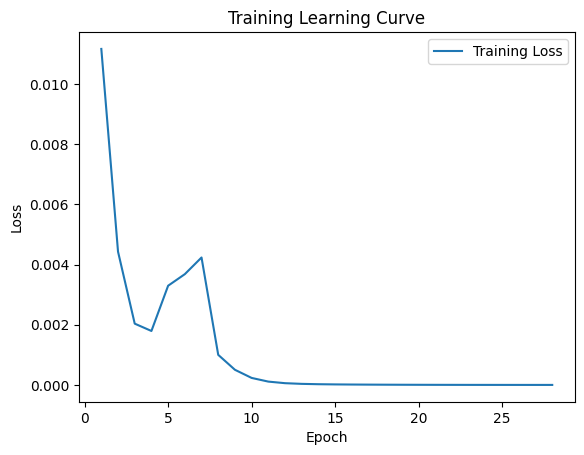


 Epoch: (29/50) Loss = 4.2974369307557936e-07

 Epoch: (29/50) Loss_rmse = 0.0006555484142154455

 Epoch: (29/50) R^2 = 0.9999603033065796

 Epoch: (29/50) MAE = 0.00034329667687416077
Spearman correlation coefficient: SignificanceResult(statistic=0.9996346993614271, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5

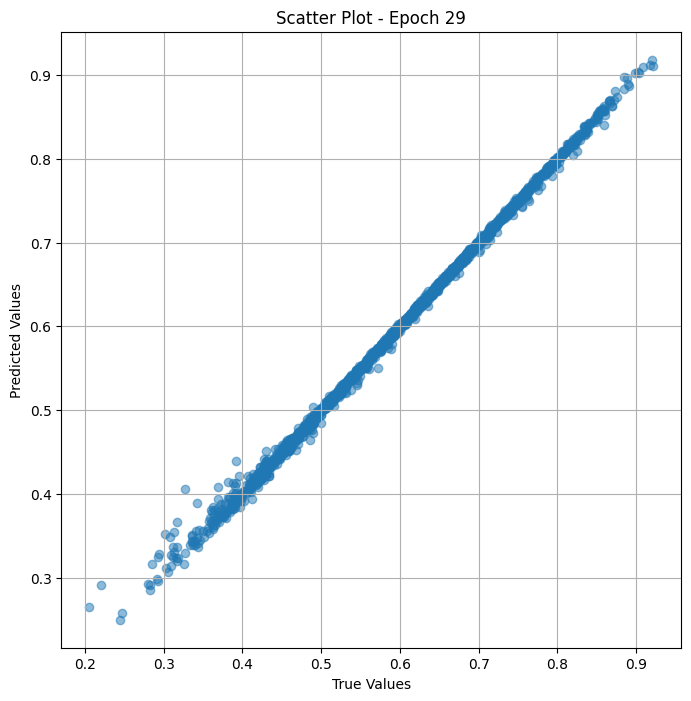

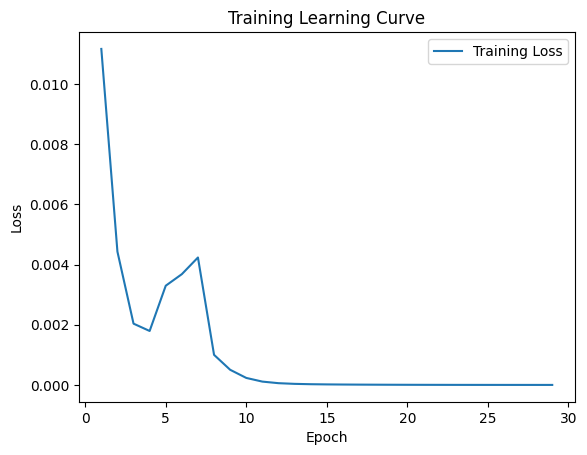


 Epoch: (30/50) Loss = 3.47699000258217e-07

 Epoch: (30/50) Loss_rmse = 0.0005896600778214633

 Epoch: (30/50) R^2 = 0.9999678730964661

 Epoch: (30/50) MAE = 0.0003336109220981598
Spearman correlation coefficient: SignificanceResult(statistic=0.9996784416414609, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5961

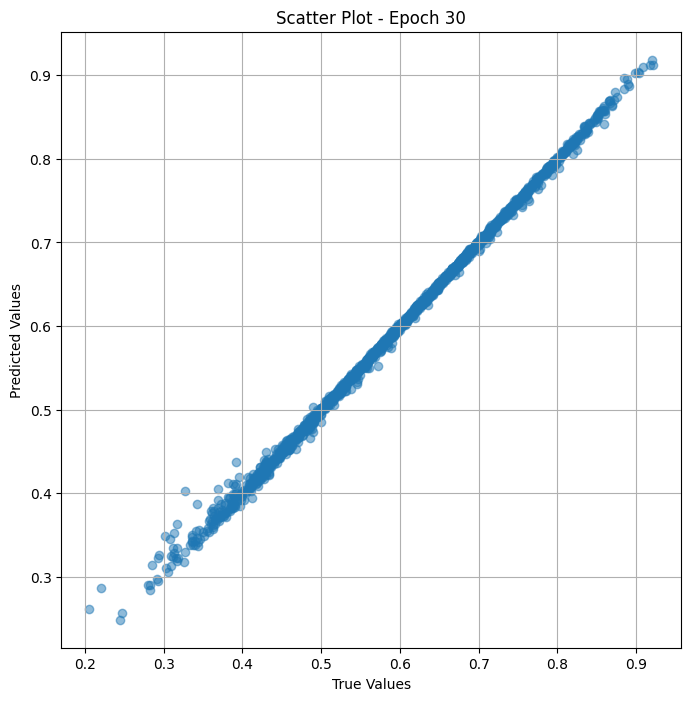

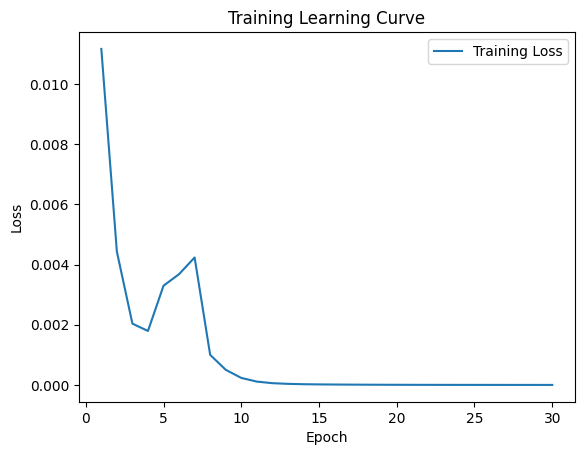


 Epoch: (31/50) Loss = 2.734772692747356e-07

 Epoch: (31/50) Loss_rmse = 0.000522950547747314

 Epoch: (31/50) R^2 = 0.9999747276306152

 Epoch: (31/50) MAE = 0.00028652697801589966
Spearman correlation coefficient: SignificanceResult(statistic=0.9997231212638557, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

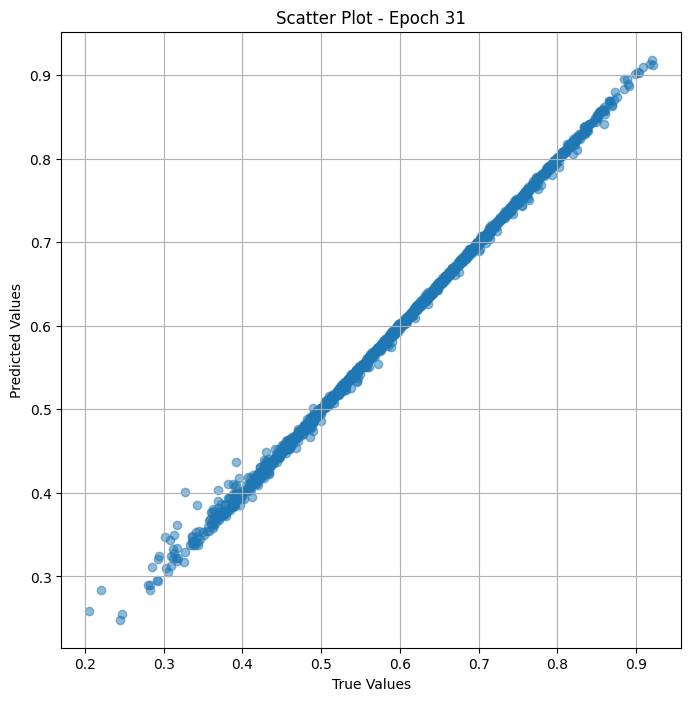

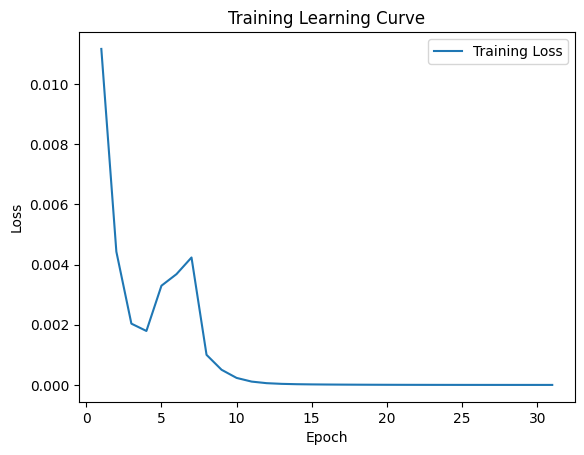


 Epoch: (32/50) Loss = 2.2413763645090512e-07

 Epoch: (32/50) Loss_rmse = 0.0004734317772090435

 Epoch: (32/50) R^2 = 0.9999792575836182

 Epoch: (32/50) MAE = 0.0002776607871055603
Spearman correlation coefficient: SignificanceResult(statistic=0.9997565694641966, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

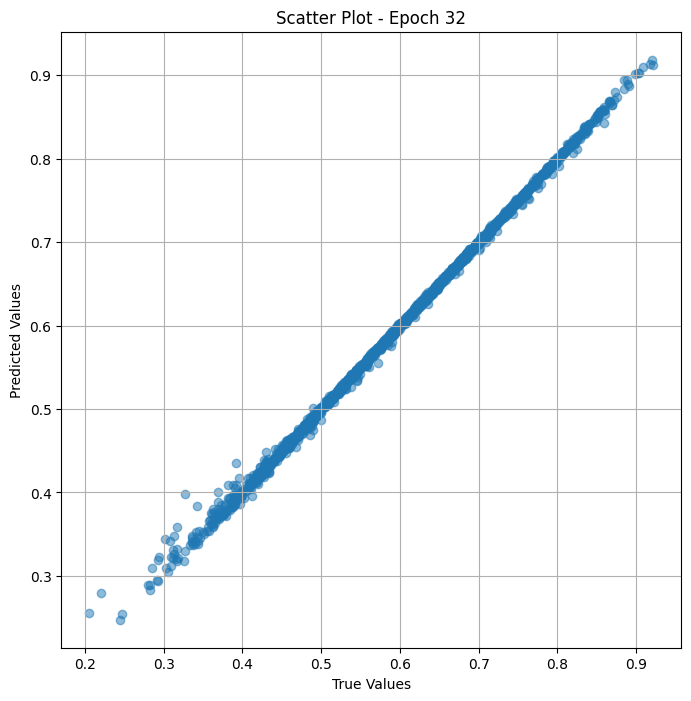

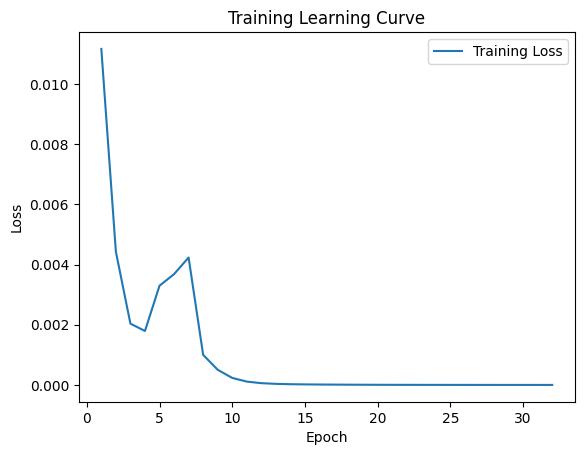


 Epoch: (33/50) Loss = 1.7424713405489456e-07

 Epoch: (33/50) Loss_rmse = 0.000417429197113961

 Epoch: (33/50) R^2 = 0.9999839067459106

 Epoch: (33/50) MAE = 0.00023483112454414368
Spearman correlation coefficient: SignificanceResult(statistic=0.9997882409895567, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

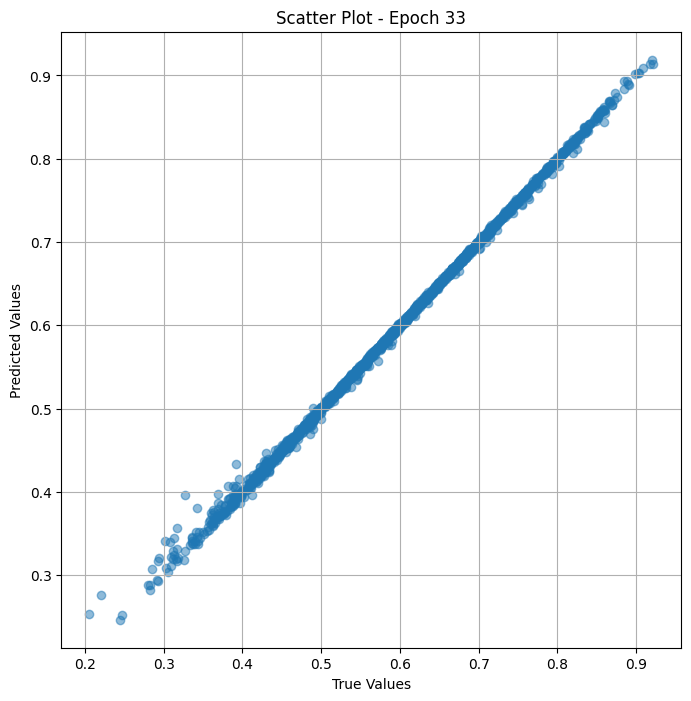

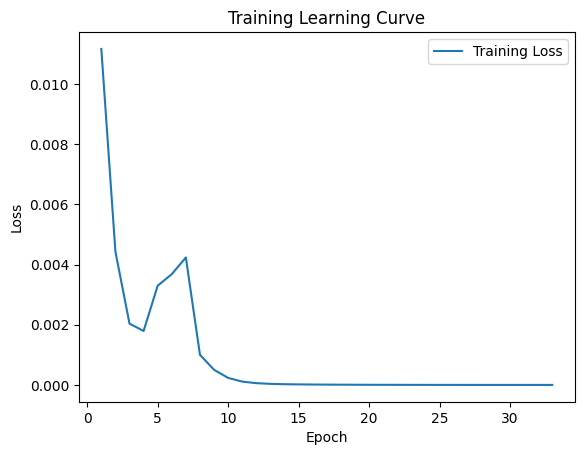


 Epoch: (34/50) Loss = 1.5063672265114292e-07

 Epoch: (34/50) Loss_rmse = 0.0003881194570567459

 Epoch: (34/50) R^2 = 0.9999860525131226

 Epoch: (34/50) MAE = 0.00023842230439186096
Spearman correlation coefficient: SignificanceResult(statistic=0.9998169232384091, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5

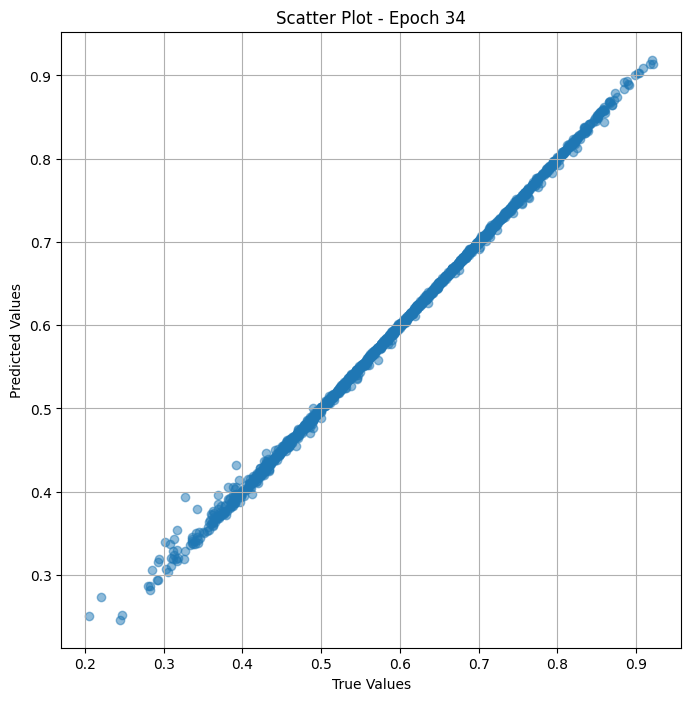

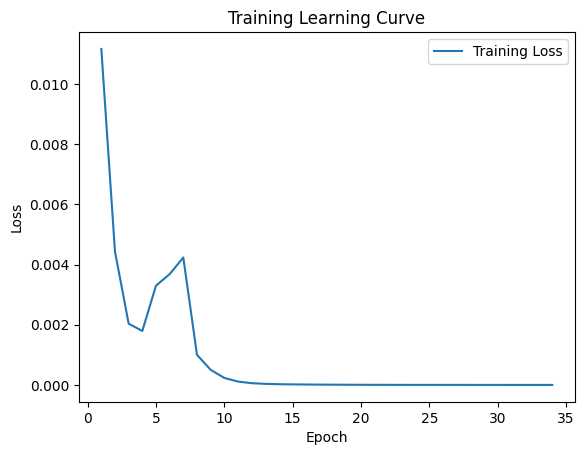


 Epoch: (35/50) Loss = 1.227884922627709e-07

 Epoch: (35/50) Loss_rmse = 0.00035041189403273165

 Epoch: (35/50) R^2 = 0.9999886751174927

 Epoch: (35/50) MAE = 0.00021067261695861816
Spearman correlation coefficient: SignificanceResult(statistic=0.9998408046069255, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5

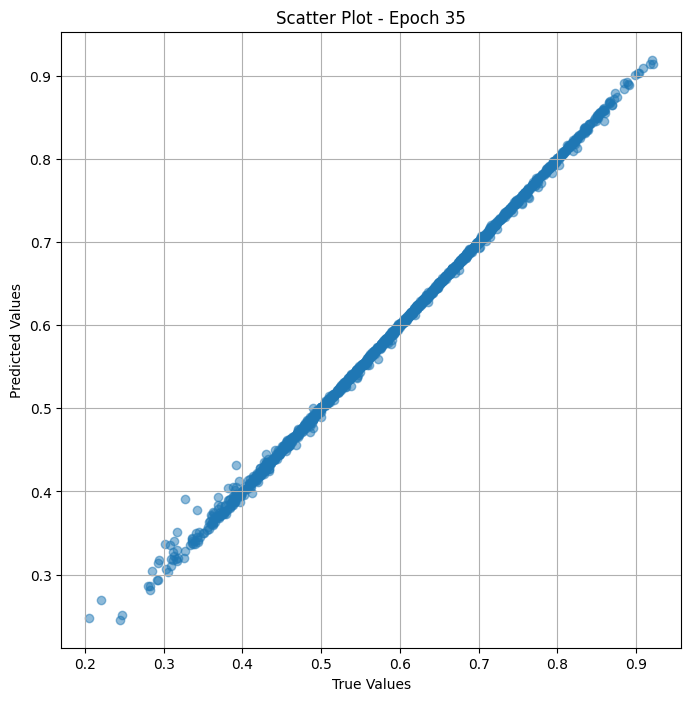

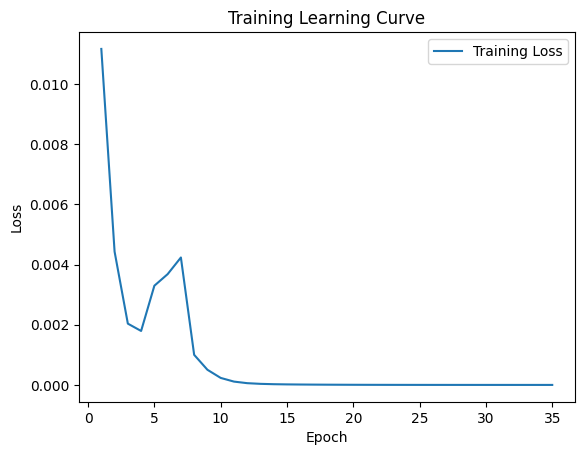


 Epoch: (36/50) Loss = 1.0705769426522238e-07

 Epoch: (36/50) Loss_rmse = 0.00032719672890380025

 Epoch: (36/50) R^2 = 0.9999901056289673

 Epoch: (36/50) MAE = 0.00020843744277954102
Spearman correlation coefficient: SignificanceResult(statistic=0.9998625871218189, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.

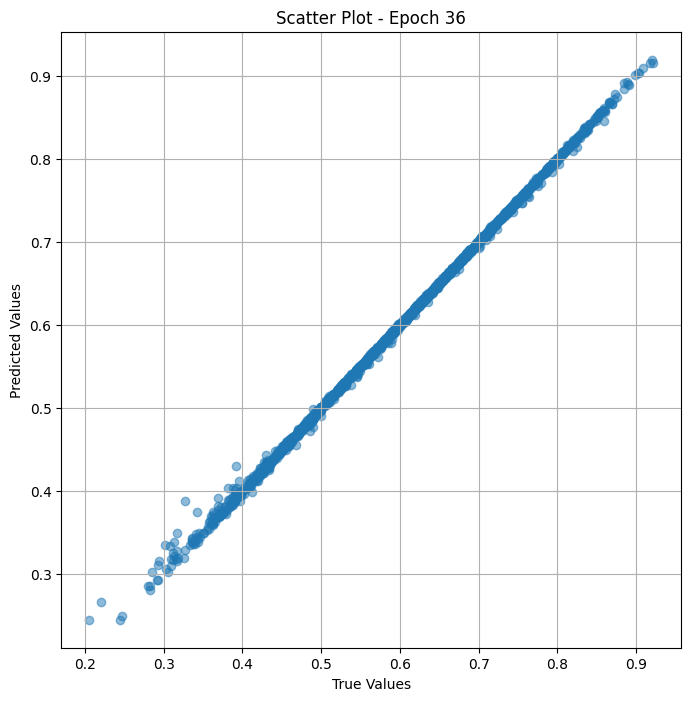

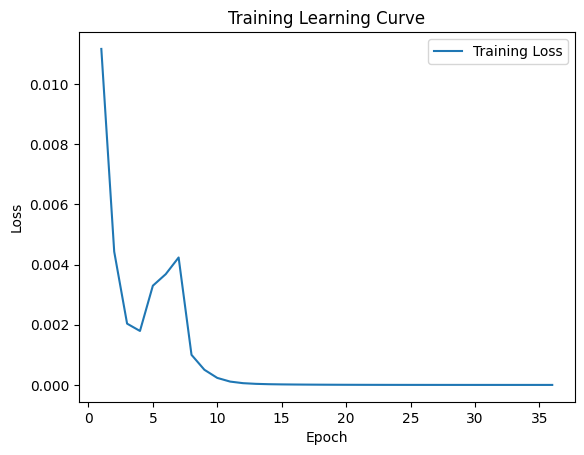


 Epoch: (37/50) Loss = 9.099404962853441e-08

 Epoch: (37/50) Loss_rmse = 0.0003016522096004337

 Epoch: (37/50) R^2 = 0.9999915957450867

 Epoch: (37/50) MAE = 0.0002078711986541748
Spearman correlation coefficient: SignificanceResult(statistic=0.9998845844224765, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

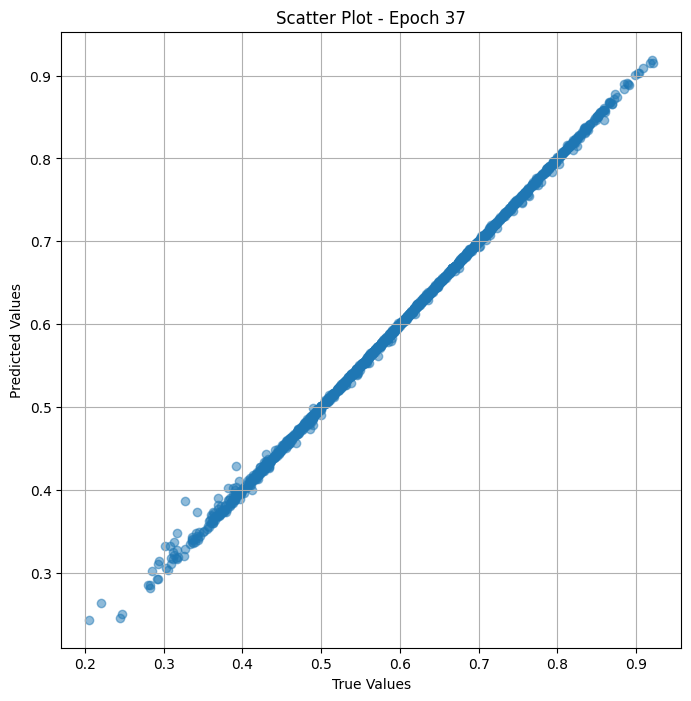

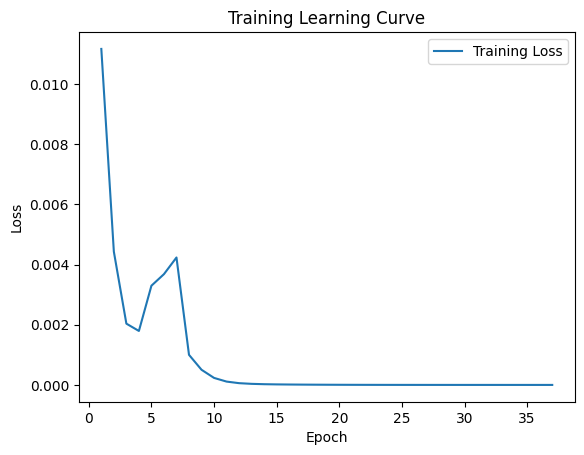


 Epoch: (38/50) Loss = 9.069911754977511e-08

 Epoch: (38/50) Loss_rmse = 0.00030116294510662556

 Epoch: (38/50) R^2 = 0.9999915957450867

 Epoch: (38/50) MAE = 0.00020713359117507935
Spearman correlation coefficient: SignificanceResult(statistic=0.9999009561071397, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5

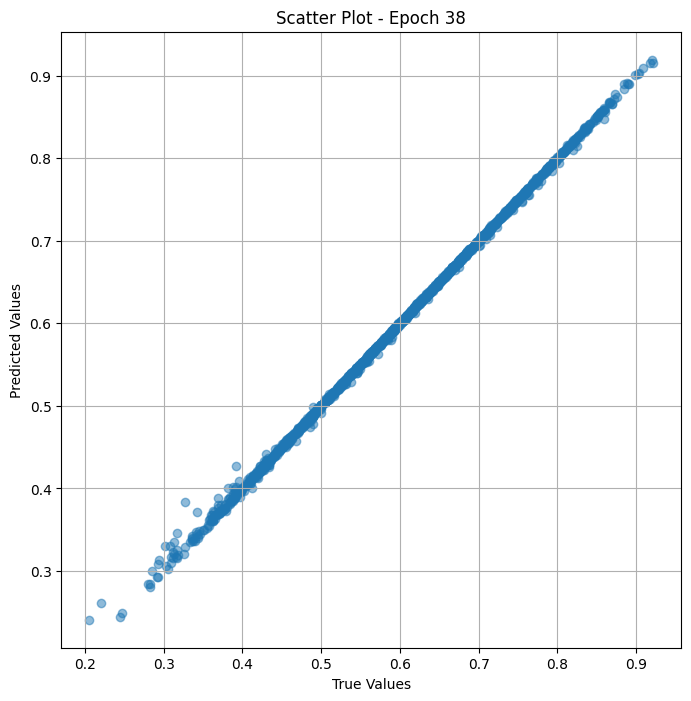

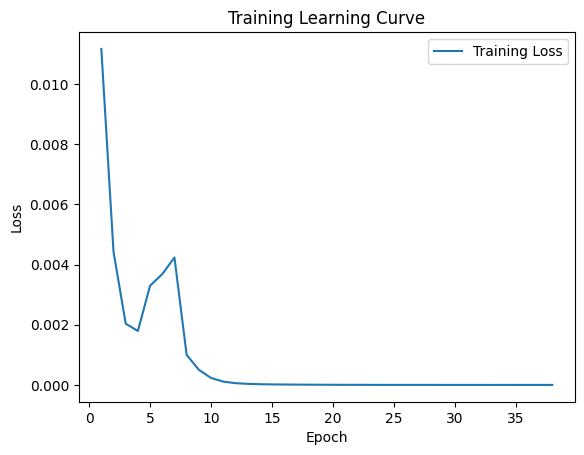


 Epoch: (39/50) Loss = 1.0318422738464506e-07

 Epoch: (39/50) Loss_rmse = 0.00032122302218340337

 Epoch: (39/50) R^2 = 0.9999904632568359

 Epoch: (39/50) MAE = 0.0002617277204990387
Spearman correlation coefficient: SignificanceResult(statistic=0.999914561120975, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

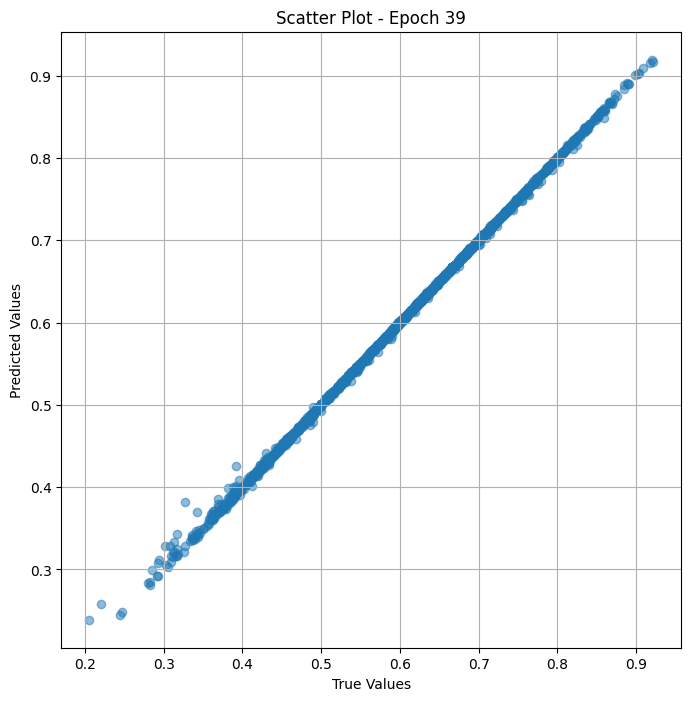

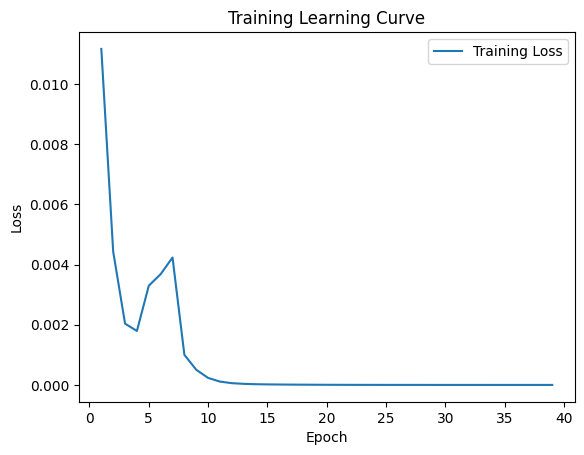


 Epoch: (40/50) Loss = 1.655211860907002e-07

 Epoch: (40/50) Loss_rmse = 0.0004068429407197982

 Epoch: (40/50) R^2 = 0.9999846816062927

 Epoch: (40/50) MAE = 0.00026569142937660217
Spearman correlation coefficient: SignificanceResult(statistic=0.9999254390846335, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

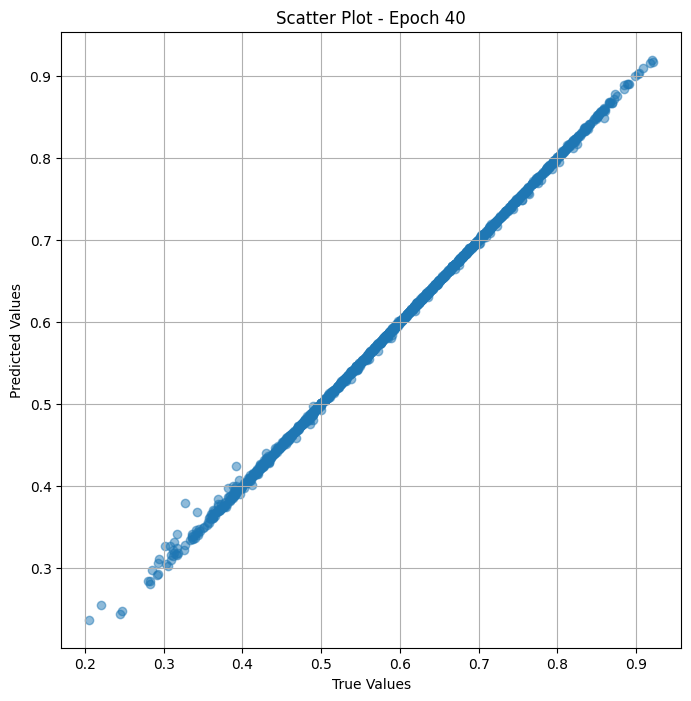

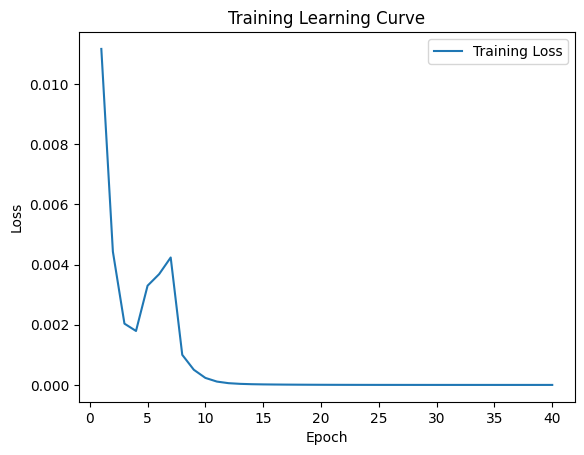

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (41/50) Loss = 3.234456755762949e-07

 Epoch: (41/50) Loss_rmse = 0.00056872284039855

 Epoch: (41/50) R^2 = 0.9999701380729675

 Epoch: (41/50) MAE = 0.00042429566383361816
Spearman correlation coefficient: SignificanceResult(statistic=0.9999351357262534, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 

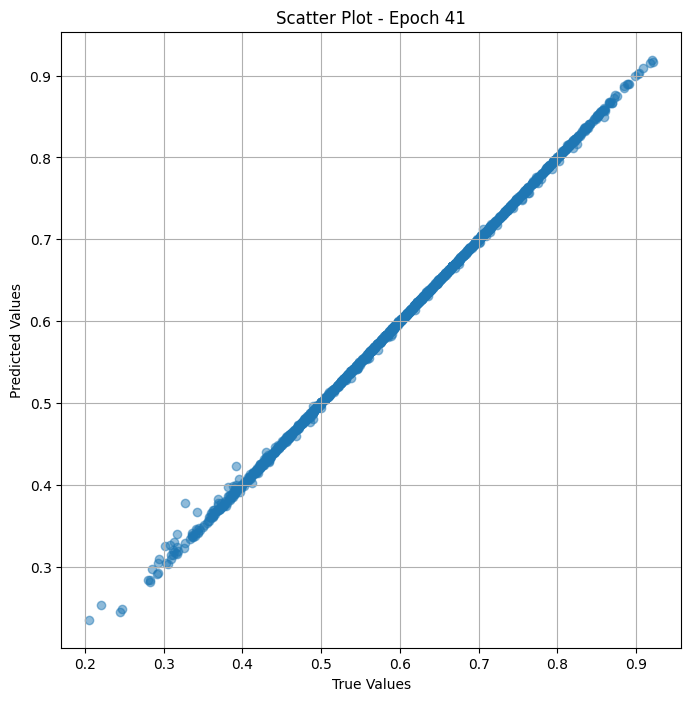

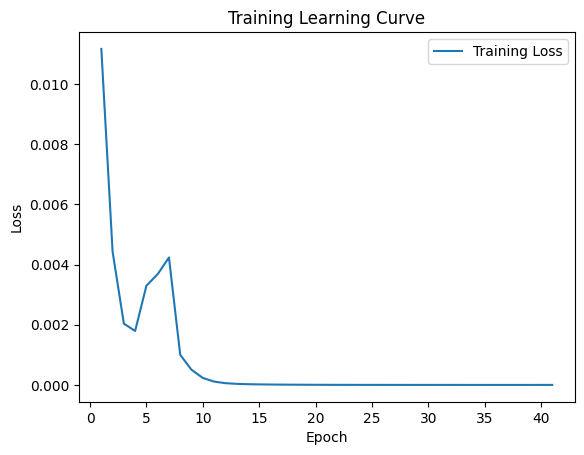


 Epoch: (42/50) Loss = 9.975254045002657e-08

 Epoch: (42/50) Loss_rmse = 0.00031583625241182745

 Epoch: (42/50) R^2 = 0.9999907612800598

 Epoch: (42/50) MAE = 0.0002452470362186432
Spearman correlation coefficient: SignificanceResult(statistic=0.9999419139915406, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

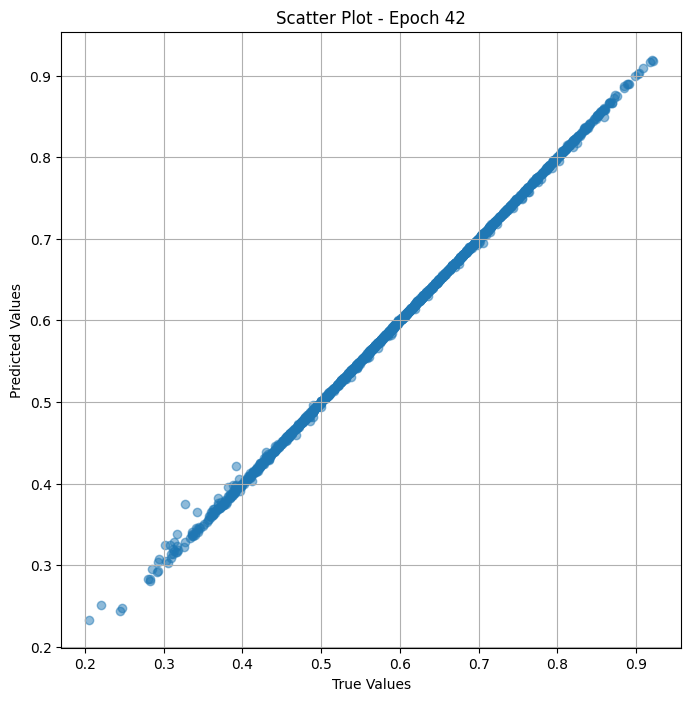

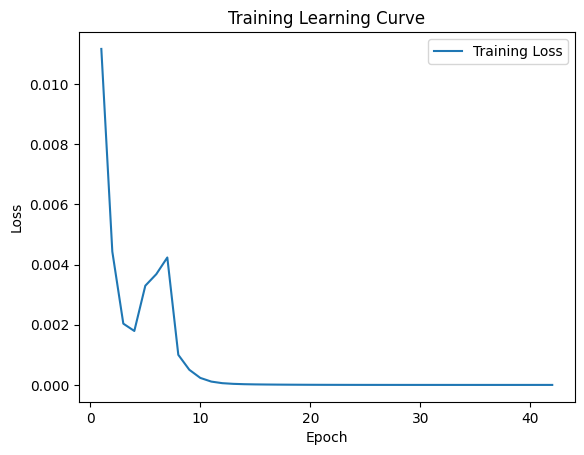


 Epoch: (43/50) Loss = 6.779987415939104e-08

 Epoch: (43/50) Loss_rmse = 0.00026038408395834267

 Epoch: (43/50) R^2 = 0.9999937415122986

 Epoch: (43/50) MAE = 0.00020205974578857422
Spearman correlation coefficient: SignificanceResult(statistic=0.9999441108543248, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5

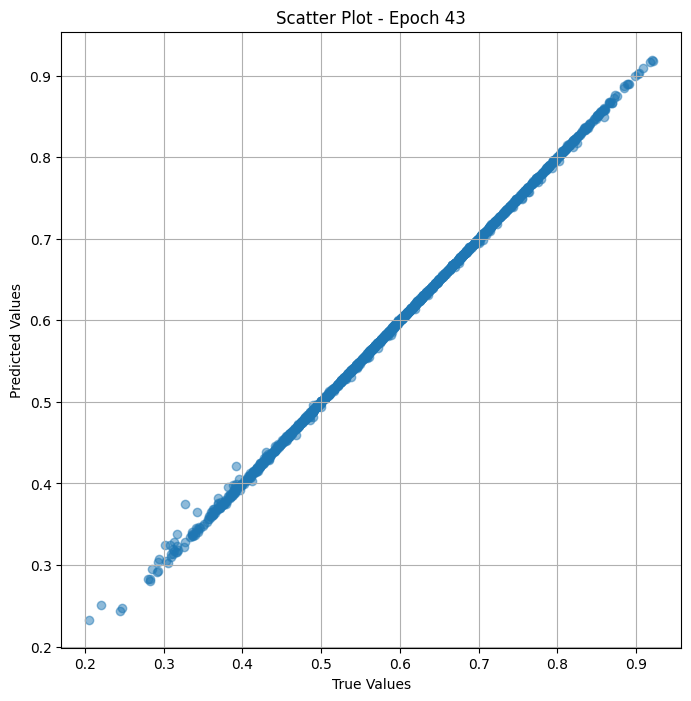

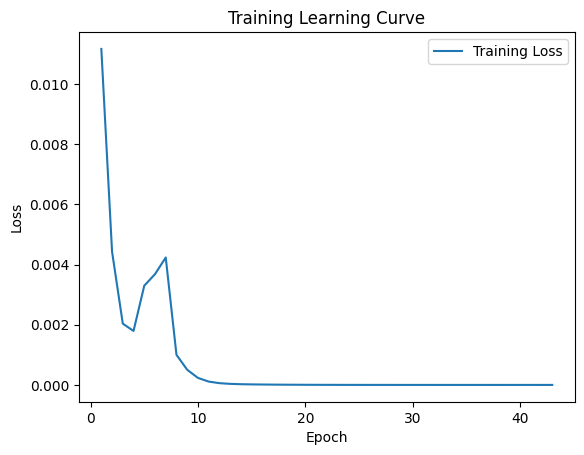


 Epoch: (44/50) Loss = 4.869704284260479e-08

 Epoch: (44/50) Loss_rmse = 0.00022067406098358333

 Epoch: (44/50) R^2 = 0.9999954700469971

 Epoch: (44/50) MAE = 0.0001687668263912201
Spearman correlation coefficient: SignificanceResult(statistic=0.99994573113186, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5961

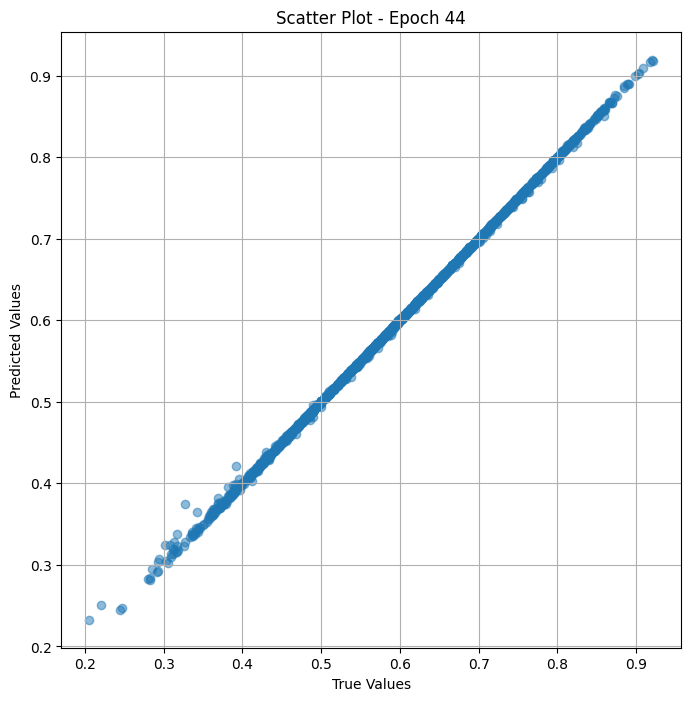

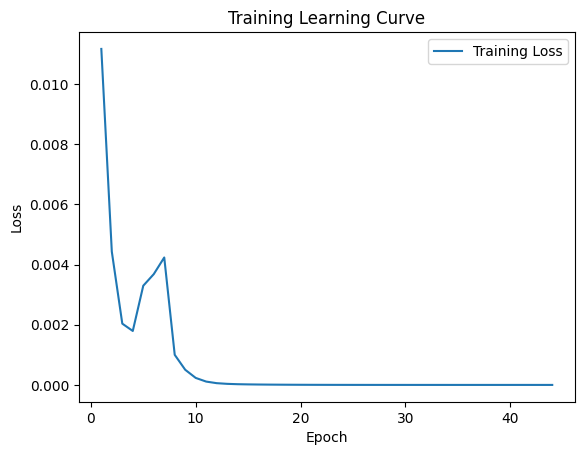


 Epoch: (45/50) Loss = 3.870112053050434e-08

 Epoch: (45/50) Loss_rmse = 0.00019672600319609046

 Epoch: (45/50) R^2 = 0.9999964237213135

 Epoch: (45/50) MAE = 0.0001463964581489563
Spearman correlation coefficient: SignificanceResult(statistic=0.9999471835428039, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

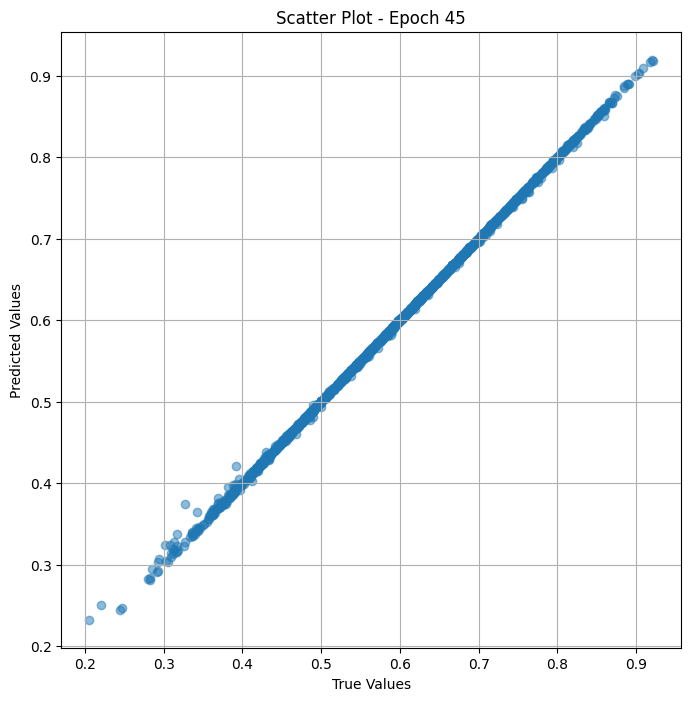

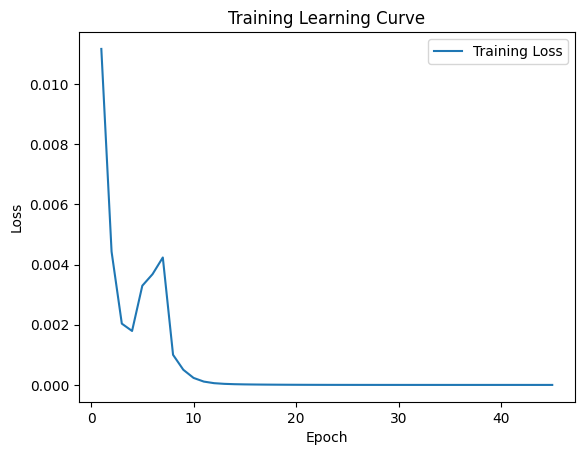


 Epoch: (46/50) Loss = 3.287274807917129e-08

 Epoch: (46/50) Loss_rmse = 0.00018130843818653375

 Epoch: (46/50) R^2 = 0.9999969601631165

 Epoch: (46/50) MAE = 0.00012946873903274536
Spearman correlation coefficient: SignificanceResult(statistic=0.9999483481824479, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5

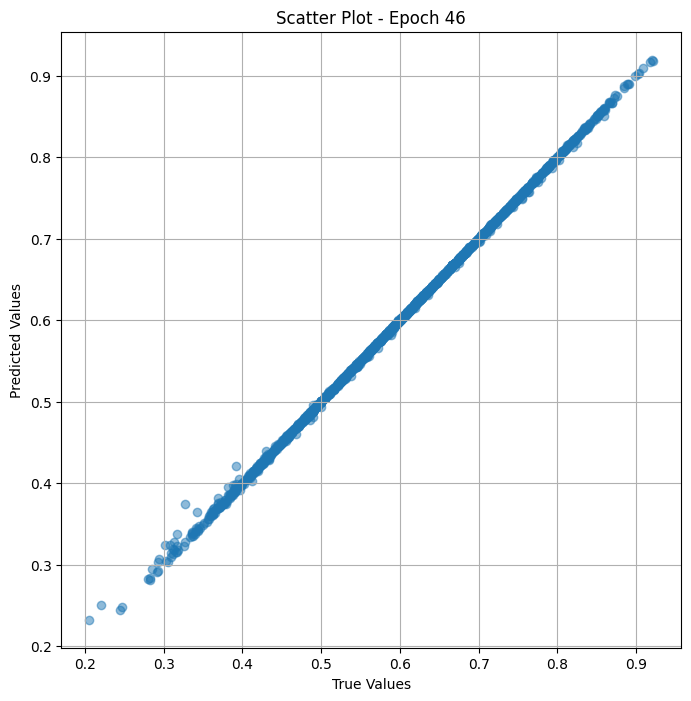

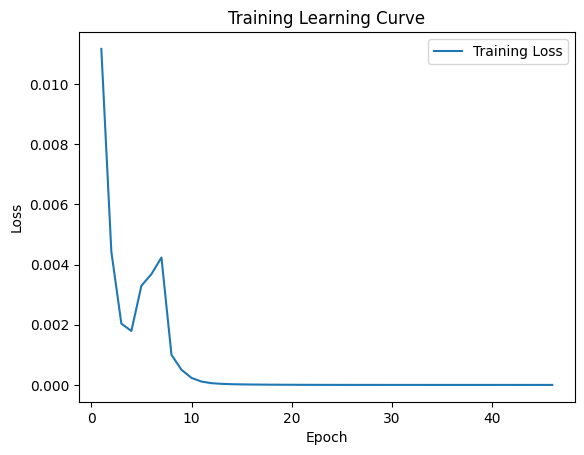


 Epoch: (47/50) Loss = 2.910250884724519e-08

 Epoch: (47/50) Loss_rmse = 0.00017059457604773343

 Epoch: (47/50) R^2 = 0.9999973177909851

 Epoch: (47/50) MAE = 0.00011548399925231934
Spearman correlation coefficient: SignificanceResult(statistic=0.9999492459037848, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5

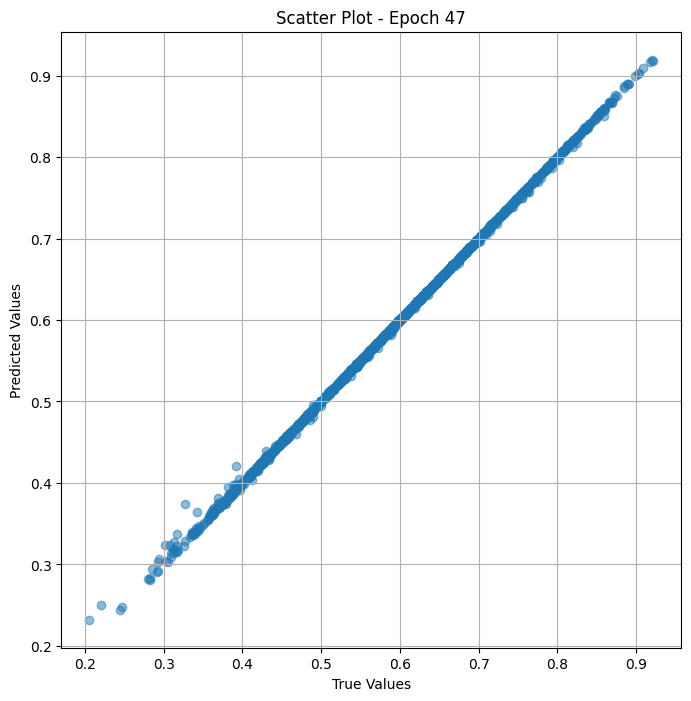

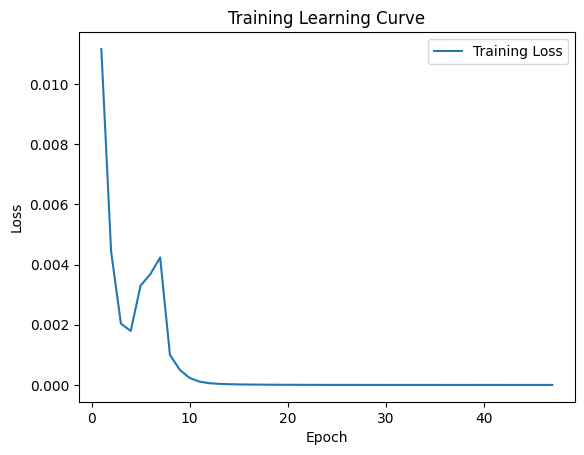


 Epoch: (48/50) Loss = 2.6971781252882465e-08

 Epoch: (48/50) Loss_rmse = 0.00016423087799921632

 Epoch: (48/50) R^2 = 0.9999974966049194

 Epoch: (48/50) MAE = 0.00010587647557258606
Spearman correlation coefficient: SignificanceResult(statistic=0.9999503511123999, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.

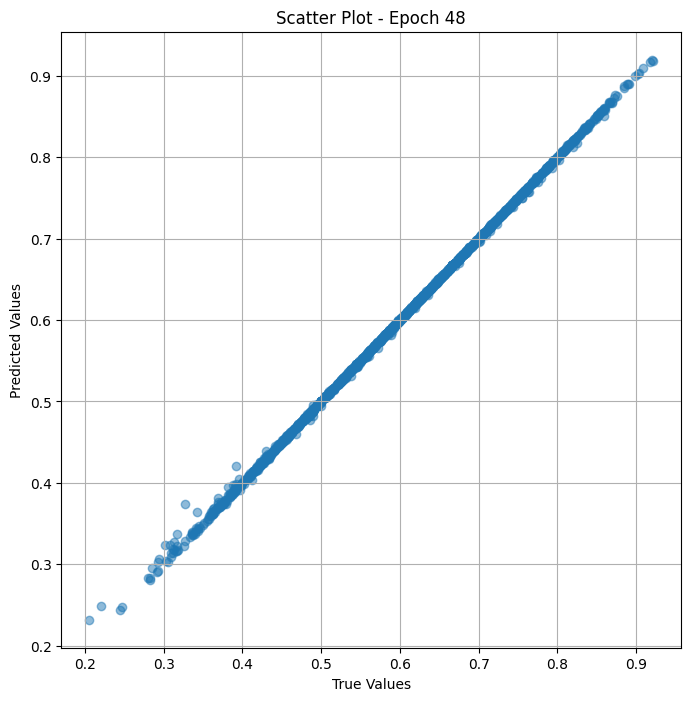

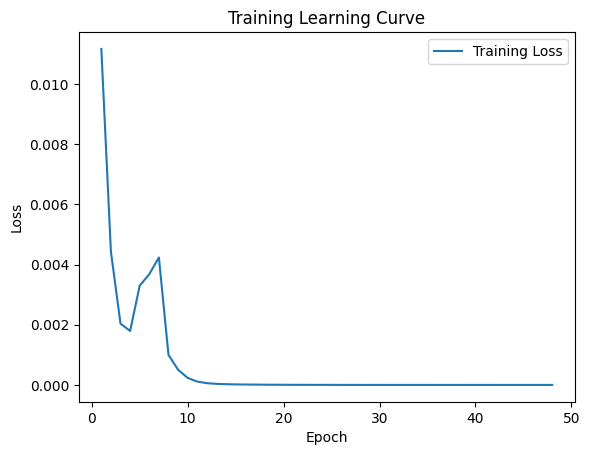


 Epoch: (49/50) Loss = 2.5552406412998607e-08

 Epoch: (49/50) Loss_rmse = 0.00015985120262484998

 Epoch: (49/50) R^2 = 0.999997615814209

 Epoch: (49/50) MAE = 9.815394878387451e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9999512874117734, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

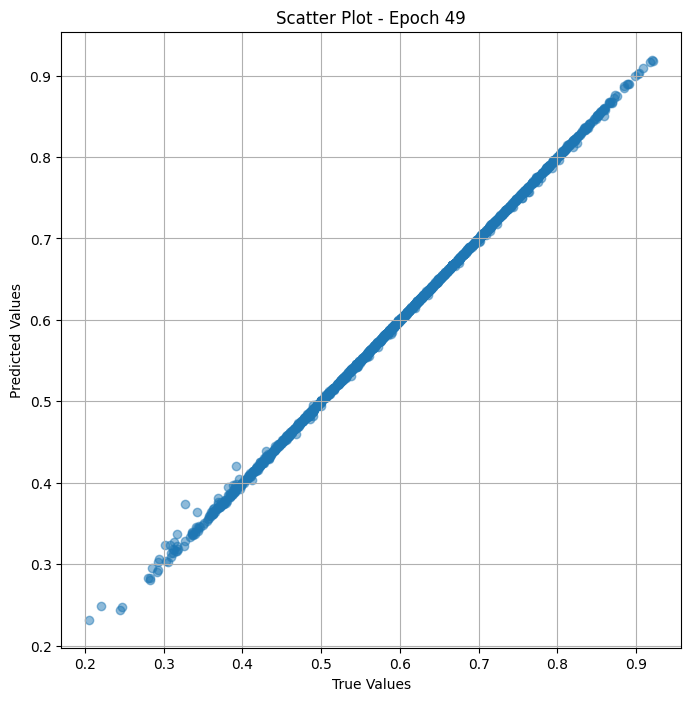

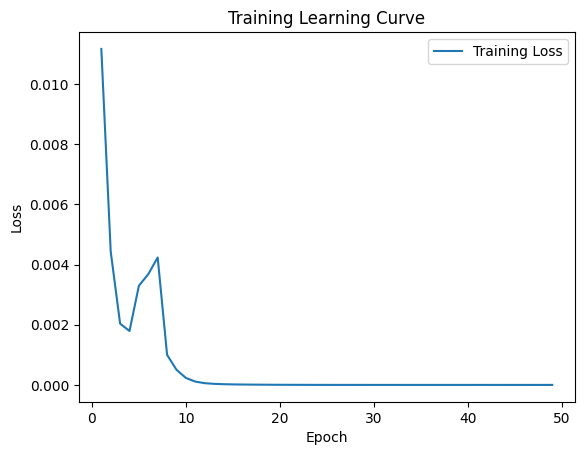


 Epoch: (50/50) Loss = 2.4623100003395848e-08

 Epoch: (50/50) Loss_rmse = 0.00015691749285906553

 Epoch: (50/50) R^2 = 0.9999977350234985

 Epoch: (50/50) MAE = 9.262561798095703e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9999523394452566, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5

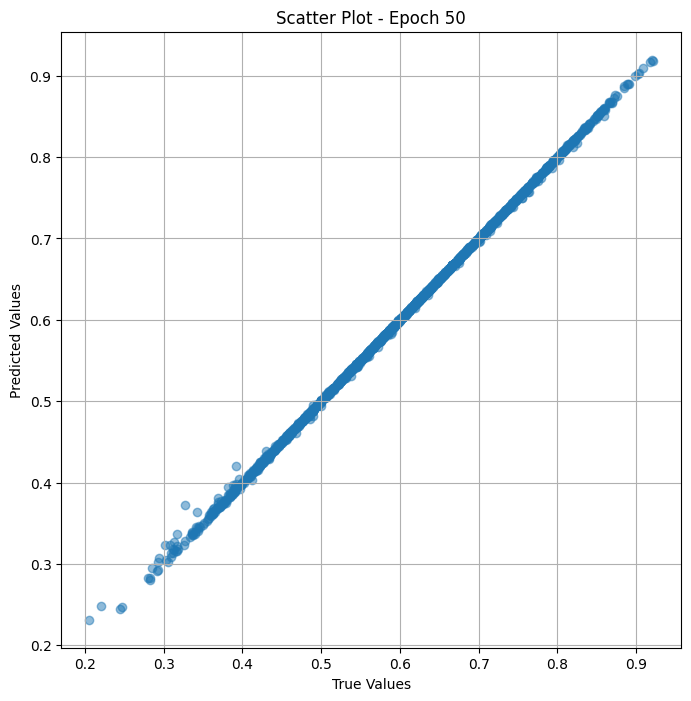

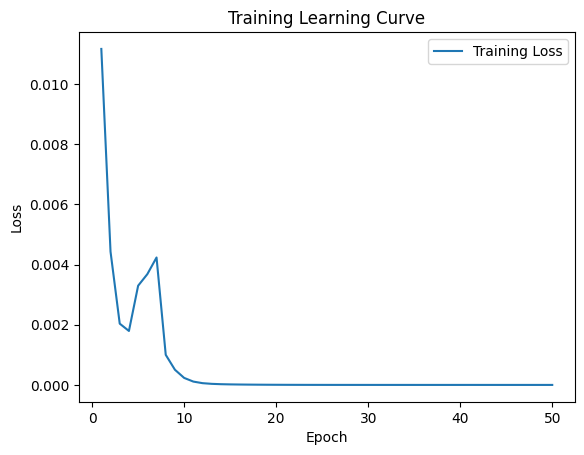

In [ ]:
# Training the model and save weights
fit(50, model_res , train_dl)
torch.save(model_res.state_dict(), "model_weights_1")

In [ ]:
true_values_list = []
predicted_values_list = []

for x_trans, yb in train_dl:
    preds = model_res(x_trans)
    true_values_list.extend(yb.cpu().detach().numpy())
    predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_landscape' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_train_landscape['preprocessed_image_path'],
    'True Value': true_values_list,  # Replace with your actual true values
    'Predicted Value': predicted_values_list  # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)



                                             Image Path  True Value  \
0     /content/landscape/n09376198_19423_preprocesse...    0.561905   
1     /content/landscape/e72f9cfc62e3b4be_preprocess...    0.639175   
2     /content/landscape/99bcf6128cb5d909_preprocess...    0.316832   
3     /content/landscape/17f134afeb63a40f_preprocess...    0.598039   
4     /content/landscape/n09468604_54577_preprocesse...    0.620370   
...                                                 ...         ...   
1795  /content/landscape/68a485c6716902c2_preprocess...    0.643478   
1796  /content/landscape/n09376198_7248_preprocessed...    0.656250   
1797  /content/landscape/n02793495_10000_preprocesse...    0.719626   
1798  /content/landscape/n09308572_1766_preprocessed...    0.574074   
1799  /content/landscape/eb8f7163a6a2866f_preprocess...    0.535714   

      Predicted Value  
0            0.561881  
1            0.639160  
2            0.315735  
3            0.598090  
4            0.620520  
...

In [ ]:
from prettytable import PrettyTable

# Assuming 'df_result' is your DataFrame
# The 'Image Path' column should contain the paths to your images

# Create a PrettyTable instance
table = PrettyTable()

# Add column names
table.field_names = df_result.columns.tolist()

# Add rows
for _, row in df_result.iterrows():
    table.add_row(row.tolist())

# Display the table
print(table)

+----------------------------------------------------------+------------+---------------------+
|                        Image Path                        | True Value |   Predicted Value   |
+----------------------------------------------------------+------------+---------------------+
|   /content/landscape/n09376198_19423_preprocessed.jpg    | 0.5619048  |  0.5618805289268494 |
|   /content/landscape/e72f9cfc62e3b4be_preprocessed.jpg   | 0.63917524 |  0.6391603946685791 |
|   /content/landscape/99bcf6128cb5d909_preprocessed.jpg   | 0.31683168 |  0.3157349228858948 |
|   /content/landscape/17f134afeb63a40f_preprocessed.jpg   | 0.5980392  |  0.5980901718139648 |
|   /content/landscape/n09468604_54577_preprocessed.jpg    | 0.6203704  |  0.6205204129219055 |
|    /content/landscape/n12345899_9894_preprocessed.jpg    | 0.47272727 |  0.4727577567100525 |
|   /content/landscape/a73d5ae43671e30c_preprocessed.jpg   | 0.7570093  |  0.7572419047355652 |
|   /content/landscape/8b5e46c0963a64ff_

## Valid

In [ ]:
class Dataset_val_resnet_landscape(Dataset):
    def __init__(self, df,res_transform=None):
        self.labels = df_val_landscape["memoscore"]
        self.images = df_val_landscape["preprocessed_image_path"]
        self.res_transform = res_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.res_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
res_transform   = ConvNextImageProcessor.from_pretrained("facebook/convnext-tiny-224")

# สร้าง Dataset และ DataLoader
val_ds =Dataset_val_resnet_landscape(df_val_landscape,res_transform=res_transform)
val_dl = DataLoader(val_ds, batch_size=32, shuffle=False)

In [ ]:
class ResNet_model_val_landscape(torch.nn.Module):
    def __init__(self, arch="resnet50.a1_in1k"):
        super().__init__()
        self.arch = arch
        self.res = timm.create_model(self.arch, pretrained=True, num_classes=1)


    def forward(self, x):
        resfeat = self.res(x)
        out = torch.sigmoid(resfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

ResNet = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_res_val =  ResNet_model_val_landscape( arch="resnet50.a1_in1k")

In [ ]:


# Assuming your model is an instance of YourModelClass and is already on GPU
model = ResNet_model_val_landscape().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
         Identity-10           [-1, 64, 56, 56]               0
             ReLU-11           [-1, 64, 56, 56]               0
         Identity-12           [-1, 64, 56, 56]               0
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

In [ ]:
device = get_default_device()
val_dl = DeviceDataLoader(val_dl, device)
model_res_val  = to_device(model_res_val  , device)

In [ ]:
params = [param for param in list(model_res_val.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
 #Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Val Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res_val, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res_val.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res_val(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/50) Loss = 0.033078983426094055

 Epoch: (1/50) Loss_rmse = 0.1818762868642807

 Epoch: (1/50) R^2 = -0.22121238708496094

 Epoch: (1/50) MAE = 0.16018450260162354
Spearman correlation coefficient: SignificanceResult(statistic=0.1621381481374817, pvalue=0.11450240174240459)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31683168, 

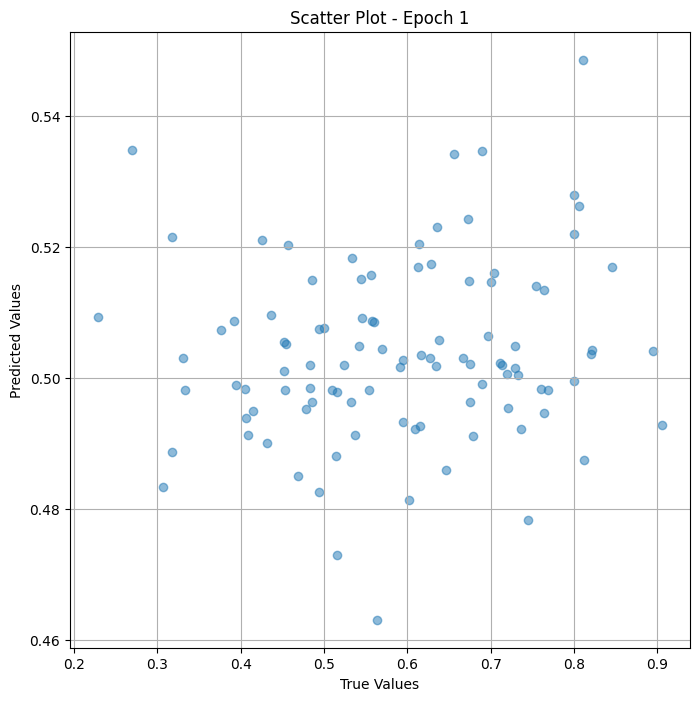

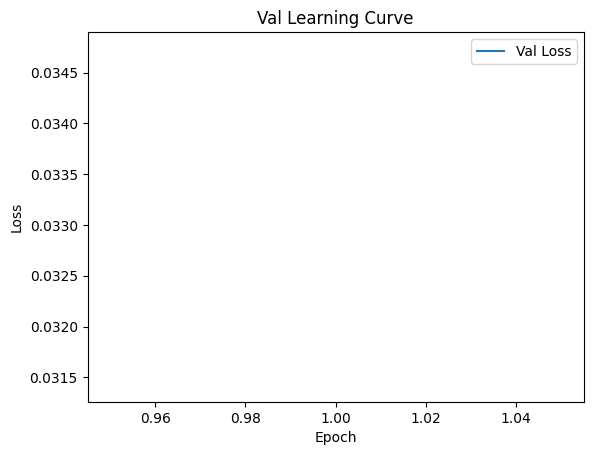


 Epoch: (2/50) Loss = 0.022443998605012894

 Epoch: (2/50) Loss_rmse = 0.1498132050037384

 Epoch: (2/50) R^2 = 0.17141079902648926

 Epoch: (2/50) MAE = 0.1350698471069336
Spearman correlation coefficient: SignificanceResult(statistic=0.8313844654298245, pvalue=1.0168215146131918e-25)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31683168,

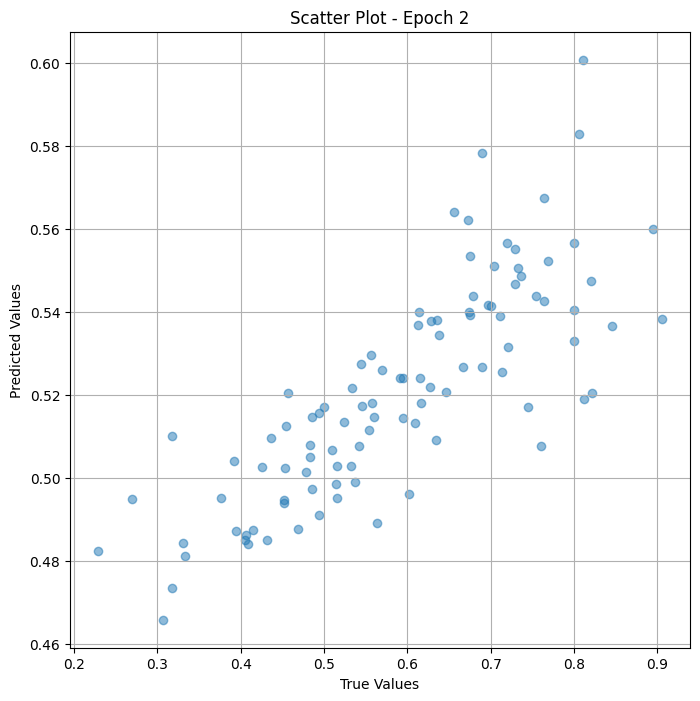

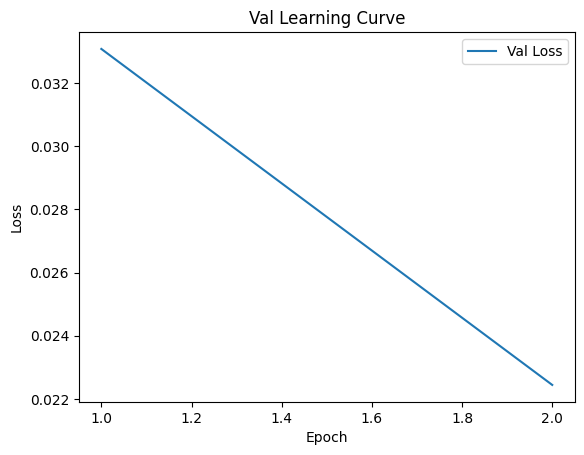


 Epoch: (3/50) Loss = 0.015067538246512413

 Epoch: (3/50) Loss_rmse = 0.12274990230798721

 Epoch: (3/50) R^2 = 0.4437354803085327

 Epoch: (3/50) MAE = 0.11021969467401505
Spearman correlation coefficient: SignificanceResult(statistic=0.8770313902139807, pvalue=1.1049717918808711e-31)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31683168

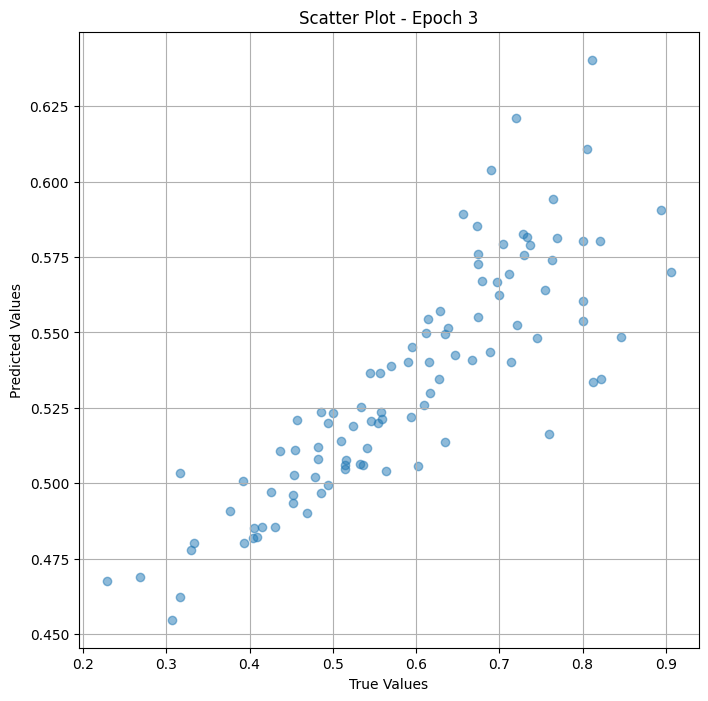

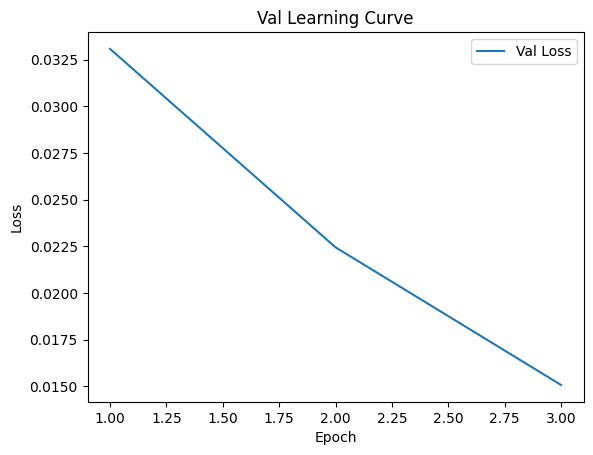


 Epoch: (4/50) Loss = 0.01024522166699171

 Epoch: (4/50) Loss_rmse = 0.10121868550777435

 Epoch: (4/50) R^2 = 0.6217661499977112

 Epoch: (4/50) MAE = 0.08697665482759476
Spearman correlation coefficient: SignificanceResult(statistic=0.9017200687005078, pvalue=5.2948407400586916e-36)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31683168,

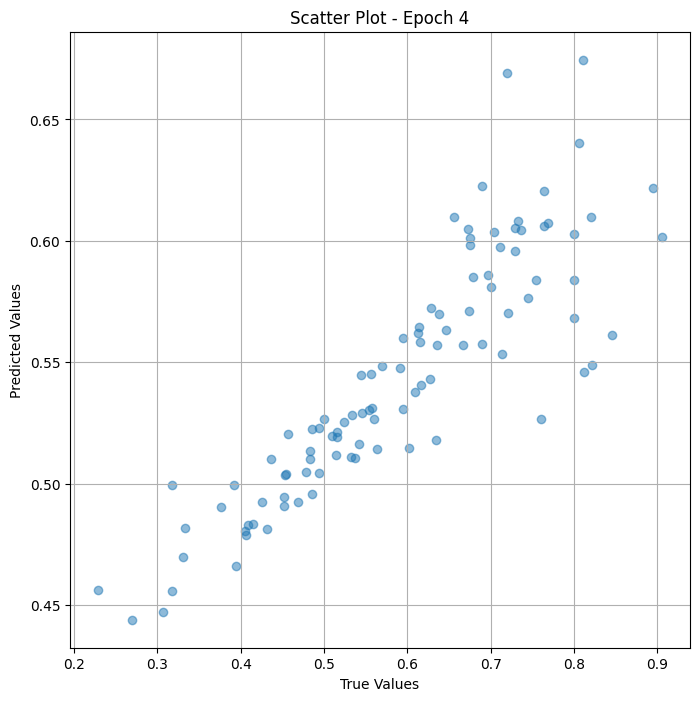

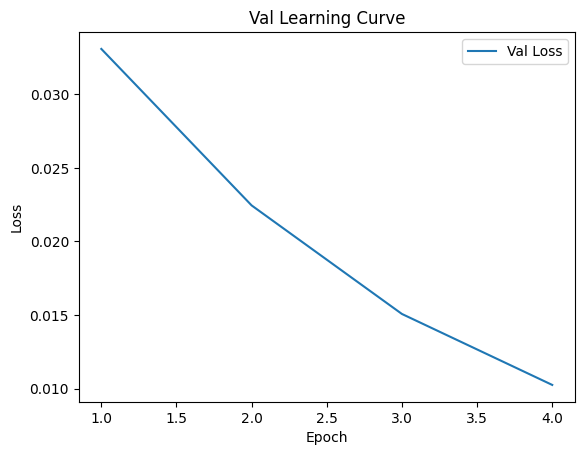


 Epoch: (5/50) Loss = 0.006929070223122835

 Epoch: (5/50) Loss_rmse = 0.0832410380244255

 Epoch: (5/50) R^2 = 0.7441920638084412

 Epoch: (5/50) MAE = 0.06291470676660538
Spearman correlation coefficient: SignificanceResult(statistic=0.9179101444003268, pvalue=1.641019502273246e-39)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31683168, 

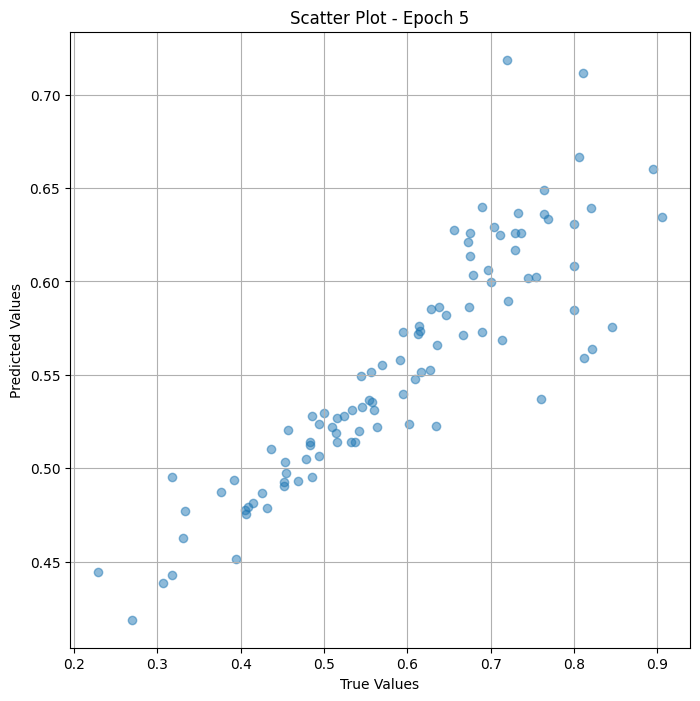

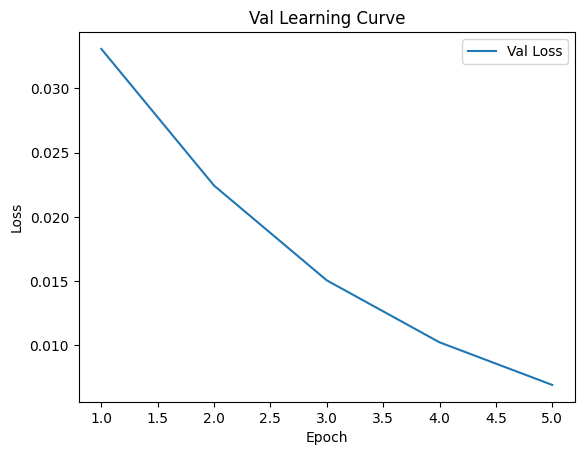


 Epoch: (6/50) Loss = 0.005088677164167166

 Epoch: (6/50) Loss_rmse = 0.07133496552705765

 Epoch: (6/50) R^2 = 0.8121358156204224

 Epoch: (6/50) MAE = 0.05973063409328461
Spearman correlation coefficient: SignificanceResult(statistic=0.9337000464653364, pvalue=1.0345715248538998e-43)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31683168

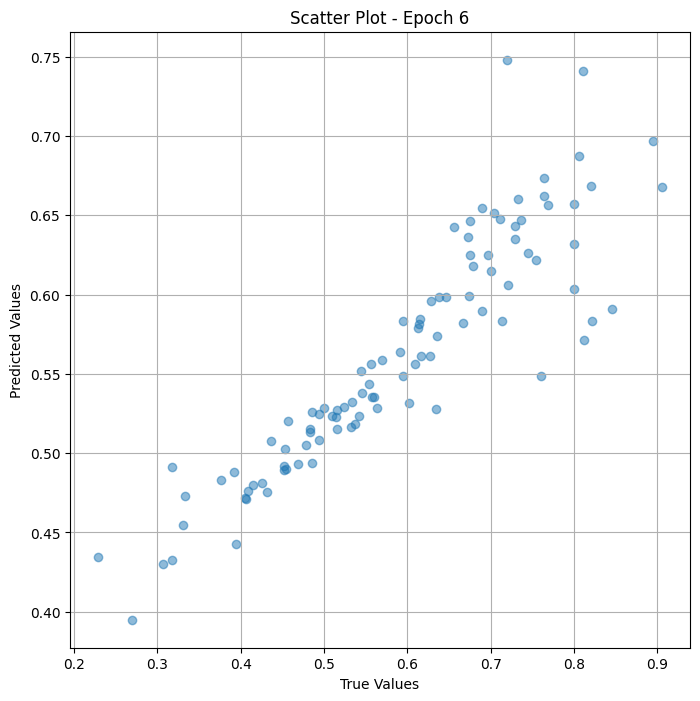

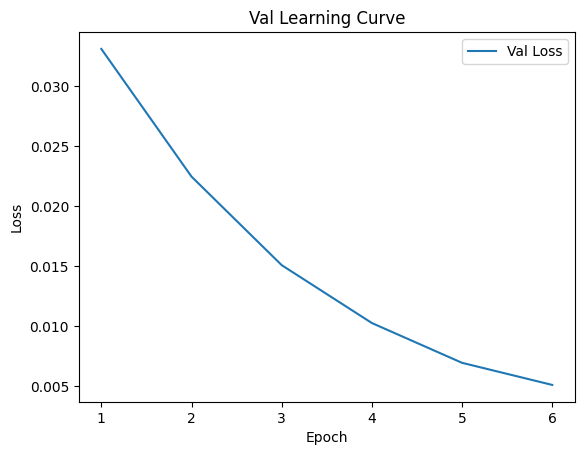


 Epoch: (7/50) Loss = 0.003811305621638894

 Epoch: (7/50) Loss_rmse = 0.06173577159643173

 Epoch: (7/50) R^2 = 0.8592939376831055

 Epoch: (7/50) MAE = 0.054495006799697876
Spearman correlation coefficient: SignificanceResult(statistic=0.9449930820917287, pvalue=2.0749835294796437e-47)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3168316

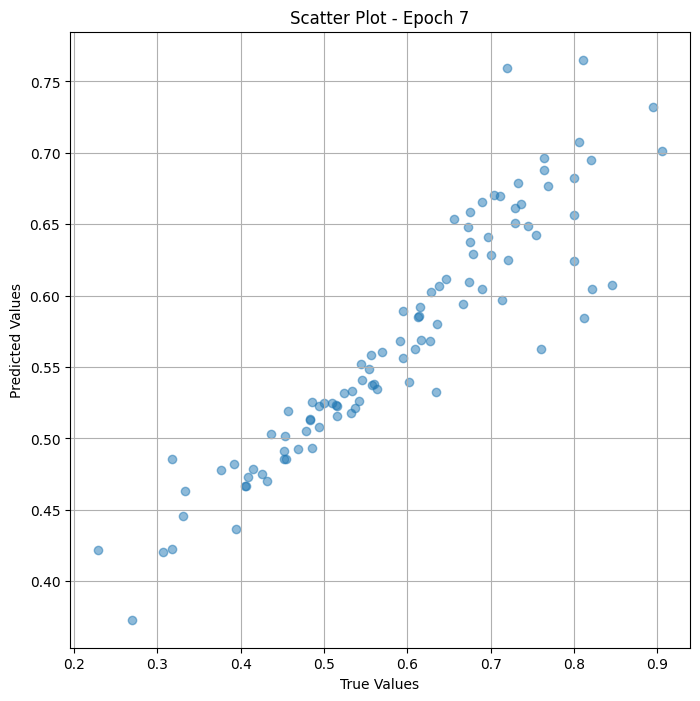

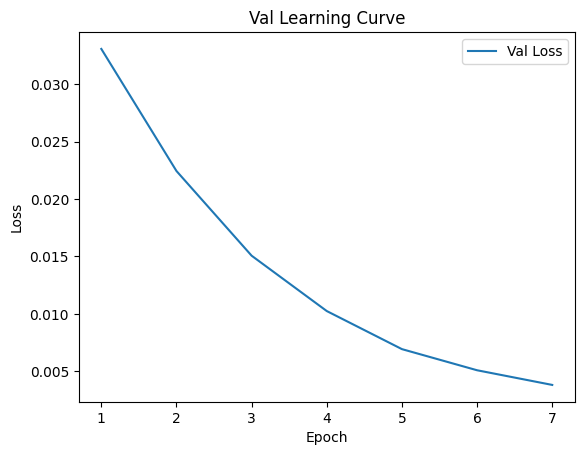


 Epoch: (8/50) Loss = 0.0025764452293515205

 Epoch: (8/50) Loss_rmse = 0.05075869709253311

 Epoch: (8/50) R^2 = 0.9048826098442078

 Epoch: (8/50) MAE = 0.04633612185716629
Spearman correlation coefficient: SignificanceResult(statistic=0.9568762042643649, pvalue=2.9384953893507873e-52)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3168316

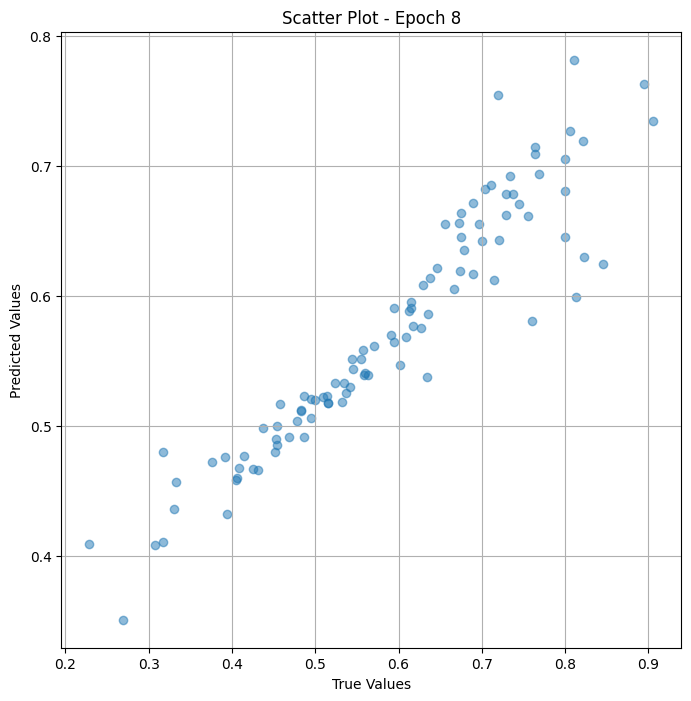

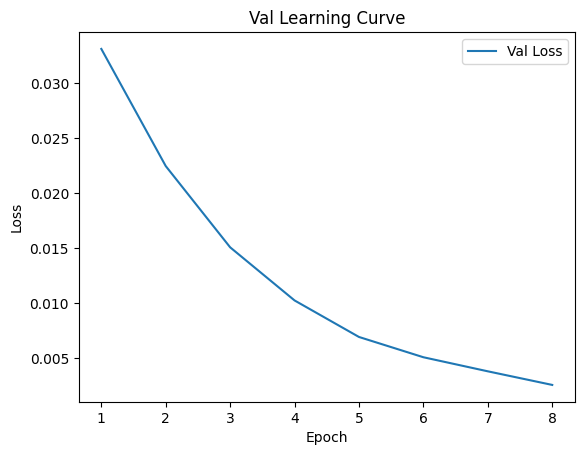


 Epoch: (9/50) Loss = 0.0016167941503226757

 Epoch: (9/50) Loss_rmse = 0.04020937904715538

 Epoch: (9/50) R^2 = 0.940311074256897

 Epoch: (9/50) MAE = 0.037463732063770294
Spearman correlation coefficient: SignificanceResult(statistic=0.9663311542122272, pvalue=3.238655414524579e-57)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31683168

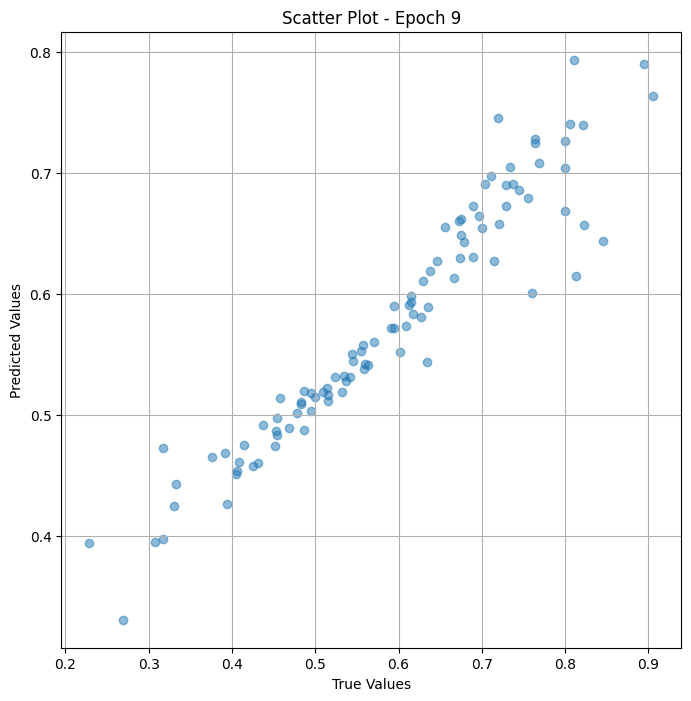

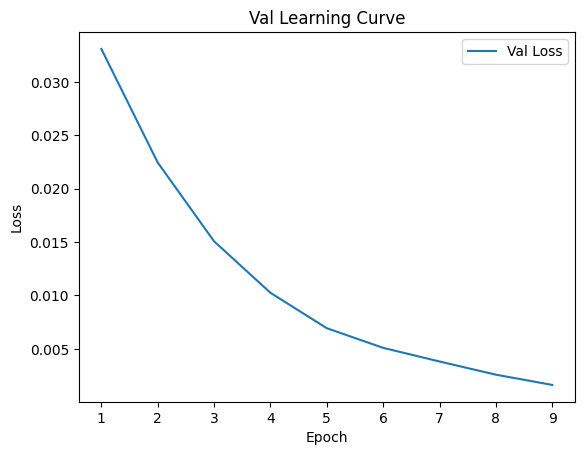


 Epoch: (10/50) Loss = 0.0009733366314321756

 Epoch: (10/50) Loss_rmse = 0.031198343262076378

 Epoch: (10/50) R^2 = 0.9640662670135498

 Epoch: (10/50) MAE = 0.02926831692457199
Spearman correlation coefficient: SignificanceResult(statistic=0.9748297569989356, pvalue=4.535846599917035e-63)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.316

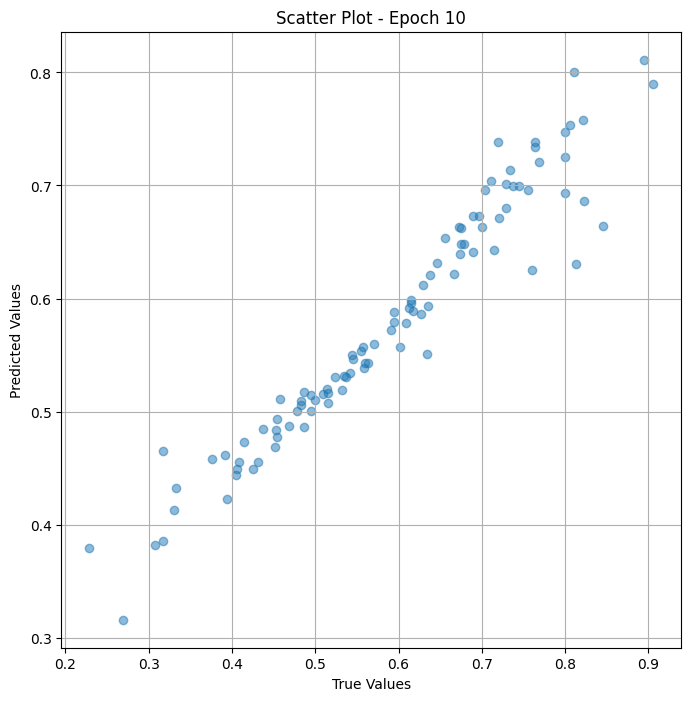

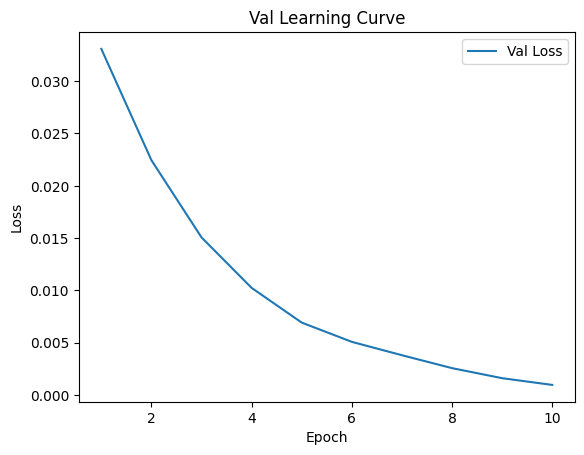


 Epoch: (11/50) Loss = 0.000515229650773108

 Epoch: (11/50) Loss_rmse = 0.022698670625686646

 Epoch: (11/50) R^2 = 0.9809787273406982

 Epoch: (11/50) MAE = 0.02114342898130417
Spearman correlation coefficient: SignificanceResult(statistic=0.9818429695140646, pvalue=1.1464928329462546e-69)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.316

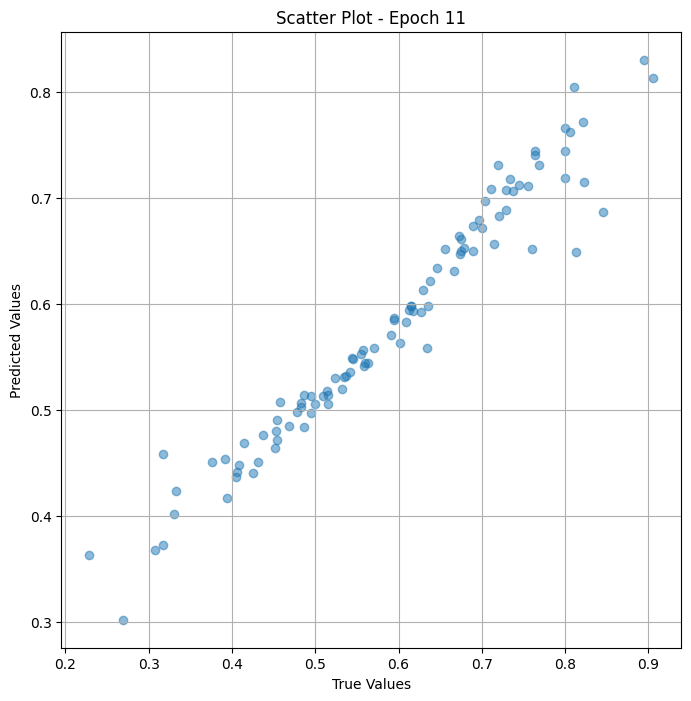

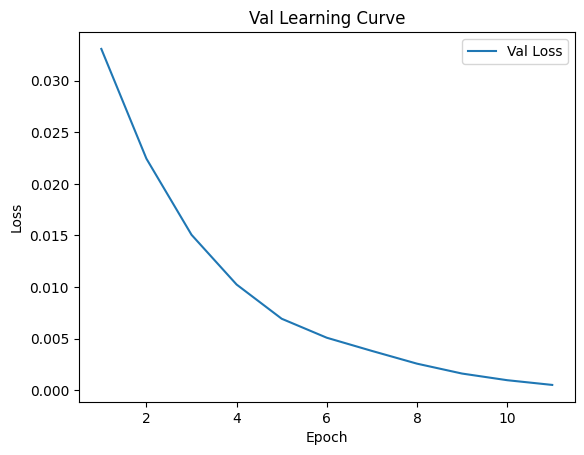


 Epoch: (12/50) Loss = 0.00025185104459524155

 Epoch: (12/50) Loss_rmse = 0.01586981490254402

 Epoch: (12/50) R^2 = 0.9907021522521973

 Epoch: (12/50) MAE = 0.01502557098865509
Spearman correlation coefficient: SignificanceResult(statistic=0.9886527039097989, pvalue=3.398486869217609e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.316

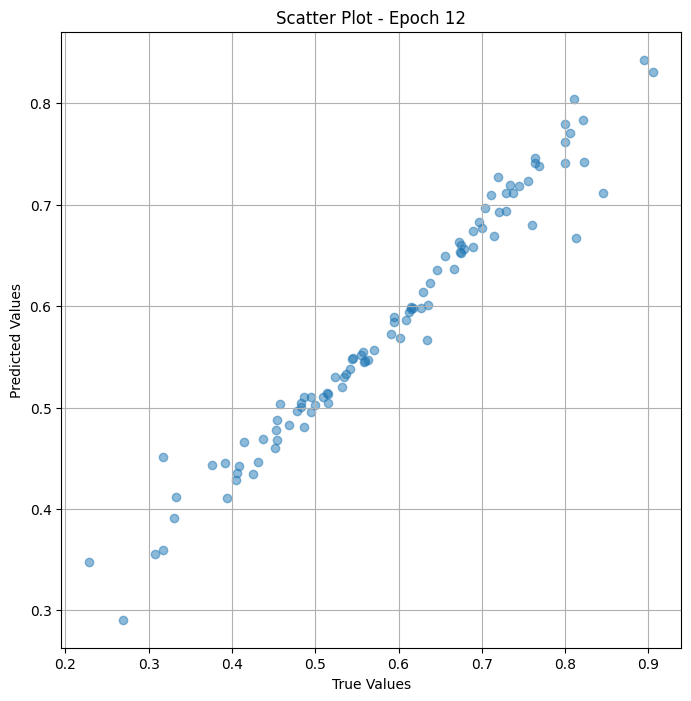

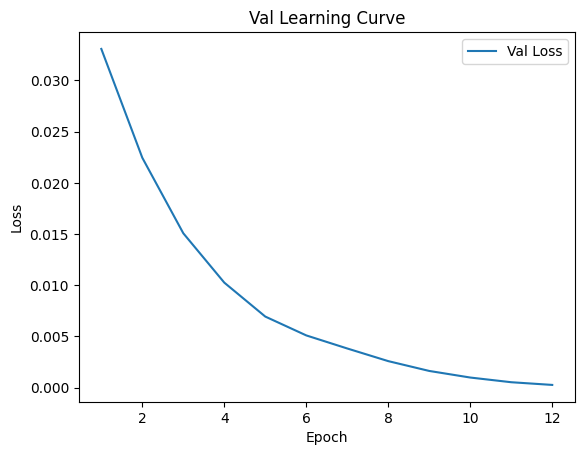


 Epoch: (13/50) Loss = 0.00010389632370788604

 Epoch: (13/50) Loss_rmse = 0.010192954912781715

 Epoch: (13/50) R^2 = 0.9961643218994141

 Epoch: (13/50) MAE = 0.009961061179637909
Spearman correlation coefficient: SignificanceResult(statistic=0.9919287016320497, pvalue=4.0726282016579116e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

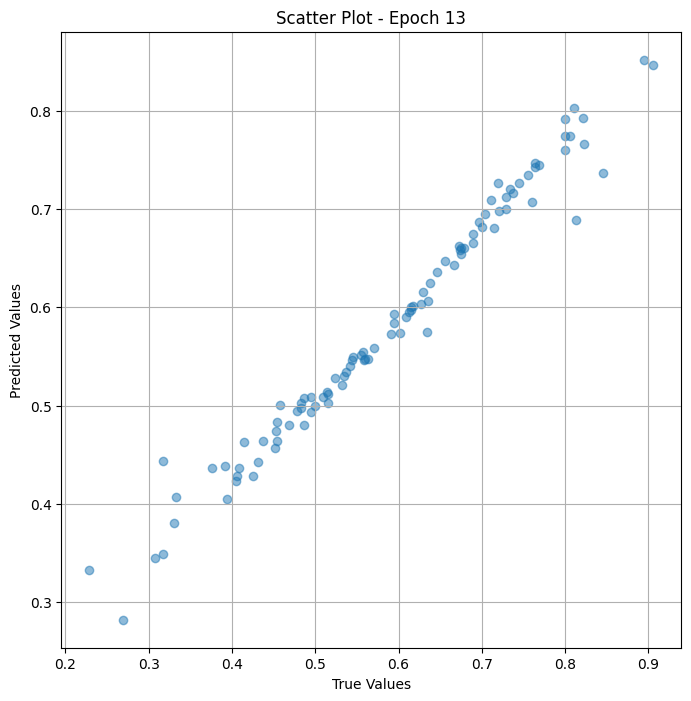

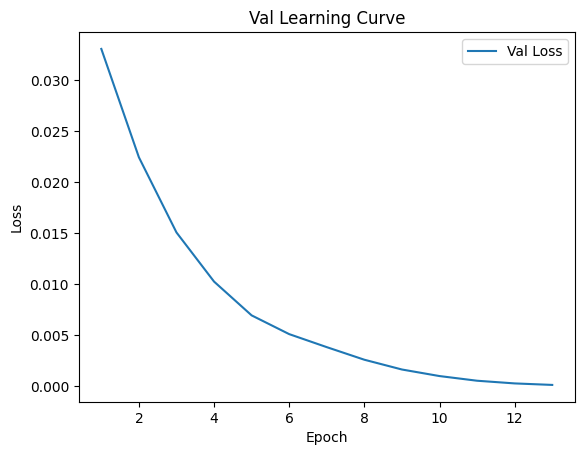


 Epoch: (14/50) Loss = 3.00772790069459e-05

 Epoch: (14/50) Loss_rmse = 0.00548427551984787

 Epoch: (14/50) R^2 = 0.9988896250724792

 Epoch: (14/50) MAE = 0.005451194941997528
Spearman correlation coefficient: SignificanceResult(statistic=0.9941737435493684, pvalue=9.525272787366811e-93)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3168

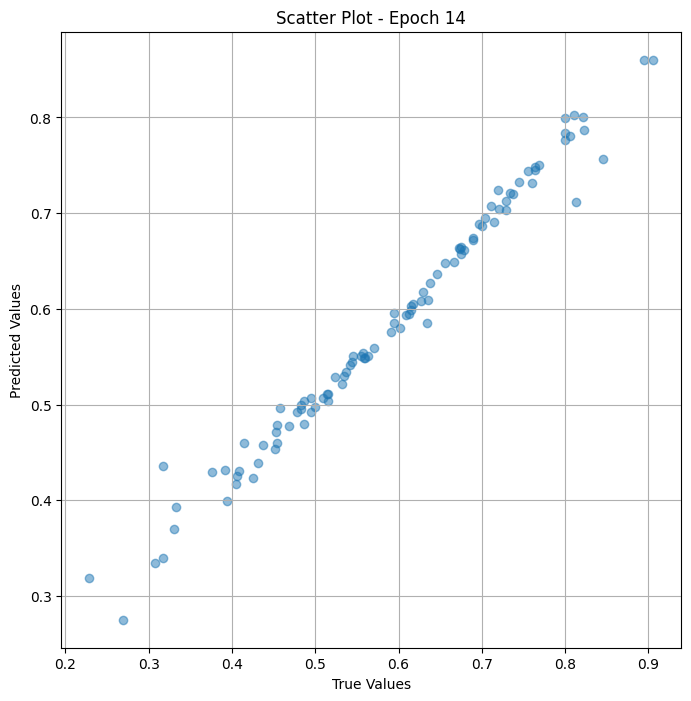

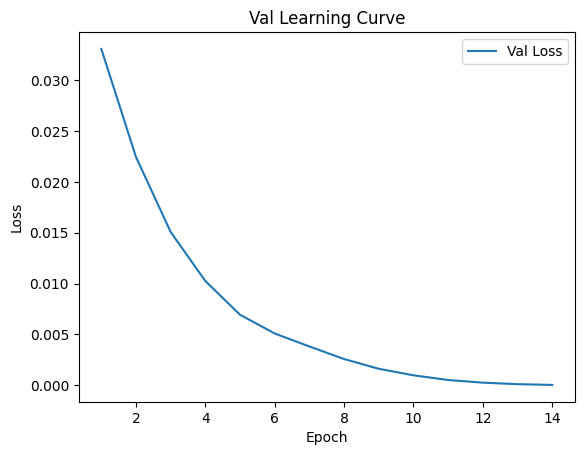


 Epoch: (15/50) Loss = 4.157144303462701e-06

 Epoch: (15/50) Loss_rmse = 0.00203890772536397

 Epoch: (15/50) R^2 = 0.9998465180397034

 Epoch: (15/50) MAE = 0.002006225287914276
Spearman correlation coefficient: SignificanceResult(statistic=0.9955777425731903, pvalue=2.3152677688350306e-98)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31

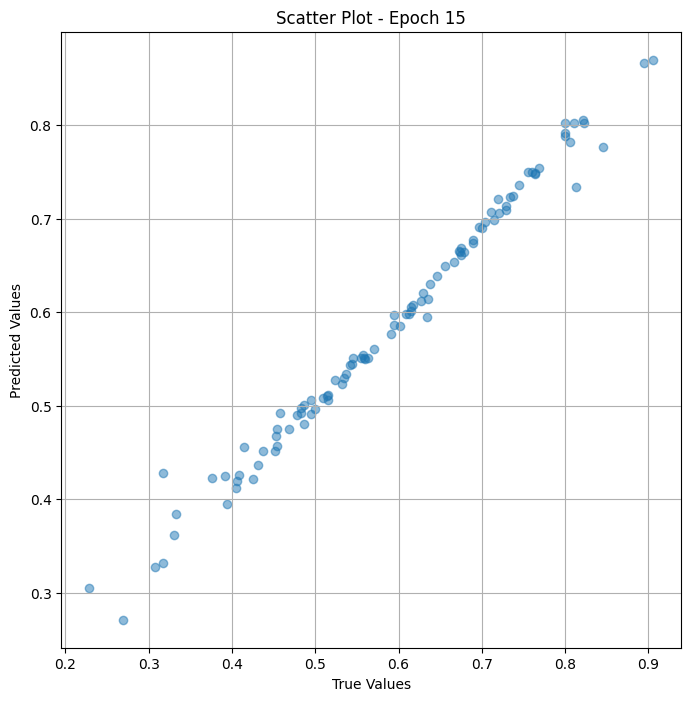

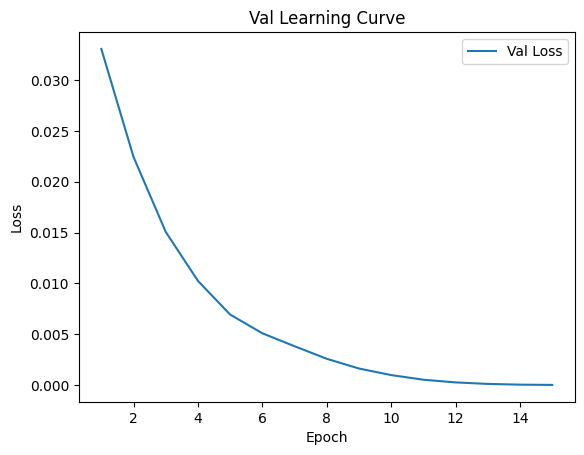


 Epoch: (16/50) Loss = 2.6397123065180494e-07

 Epoch: (16/50) Loss_rmse = 0.0005137813277542591

 Epoch: (16/50) R^2 = 0.9999902844429016

 Epoch: (16/50) MAE = 0.00033820420503616333
Spearman correlation coefficient: SignificanceResult(statistic=0.9973276543999826, pvalue=1.2601726467371957e-108)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478

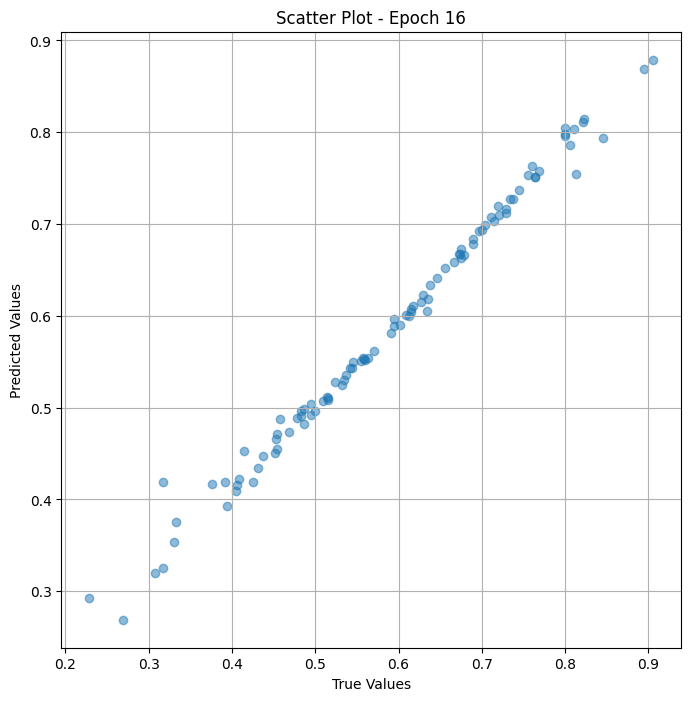

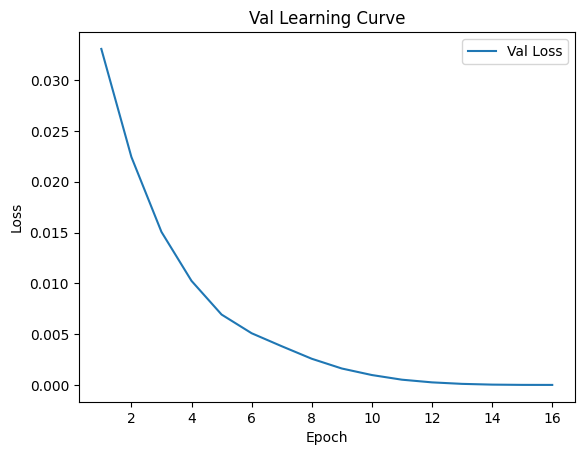


 Epoch: (17/50) Loss = 2.869349373213481e-06

 Epoch: (17/50) Loss_rmse = 0.001693915342912078

 Epoch: (17/50) R^2 = 0.9998940825462341

 Epoch: (17/50) MAE = 0.0016618743538856506
Spearman correlation coefficient: SignificanceResult(statistic=0.998372175412874, pvalue=9.823377938030671e-119)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

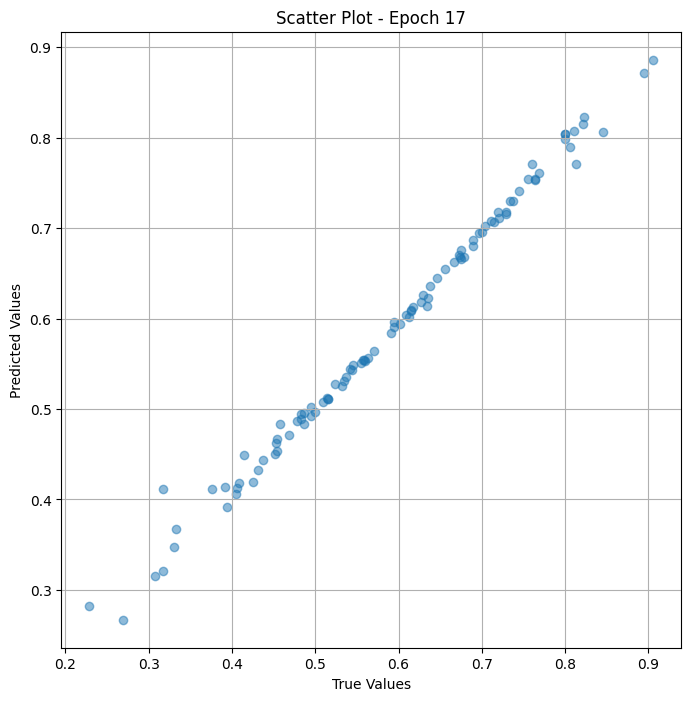

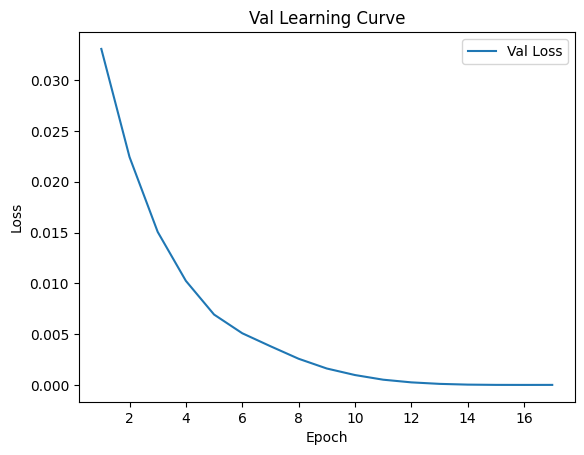


 Epoch: (18/50) Loss = 4.917540081805782e-06

 Epoch: (18/50) Loss_rmse = 0.002217552624642849

 Epoch: (18/50) R^2 = 0.9998184442520142

 Epoch: (18/50) MAE = 0.002125971019268036
Spearman correlation coefficient: SignificanceResult(statistic=0.9988537402954409, pvalue=6.882066070116317e-126)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

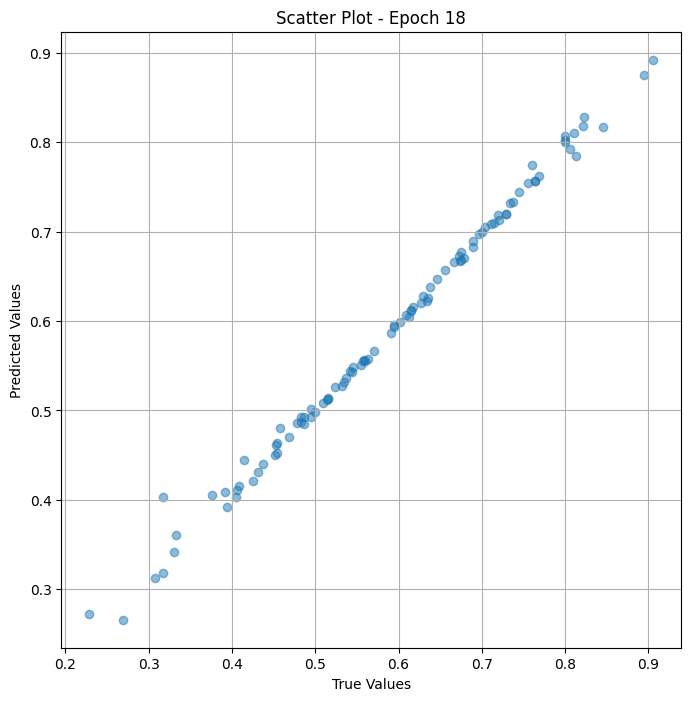

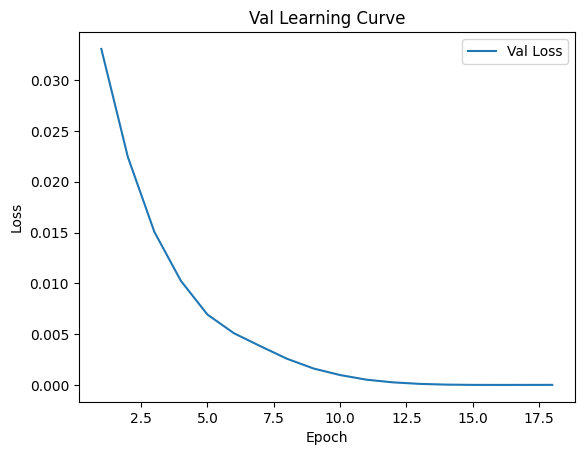

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (19/50) Loss = 4.67304244011757e-06

 Epoch: (19/50) Loss_rmse = 0.0021617221646010876

 Epoch: (19/50) R^2 = 0.99982750415802

 Epoch: (19/50) MAE = 0.0020296722650527954
Spearman correlation coefficient: SignificanceResult(statistic=0.9990911314347346, pvalue=1.2685001510088755e-130)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7

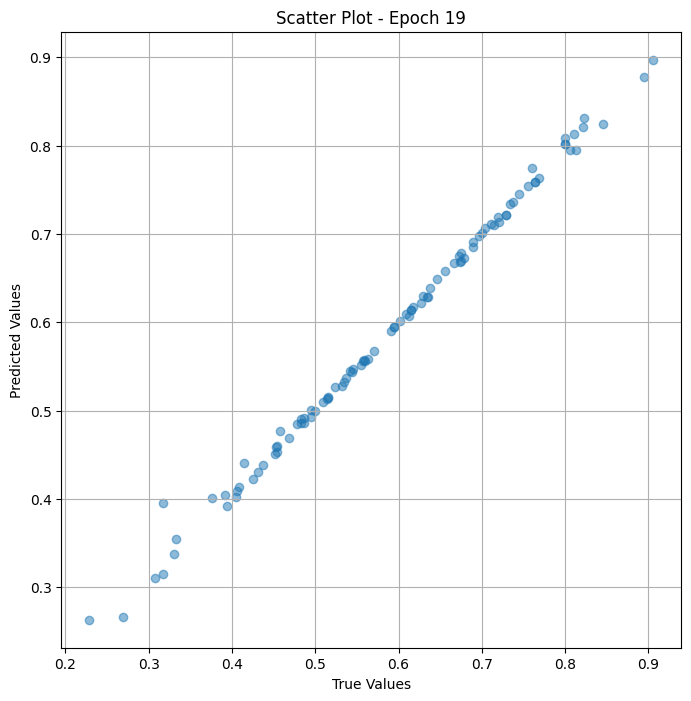

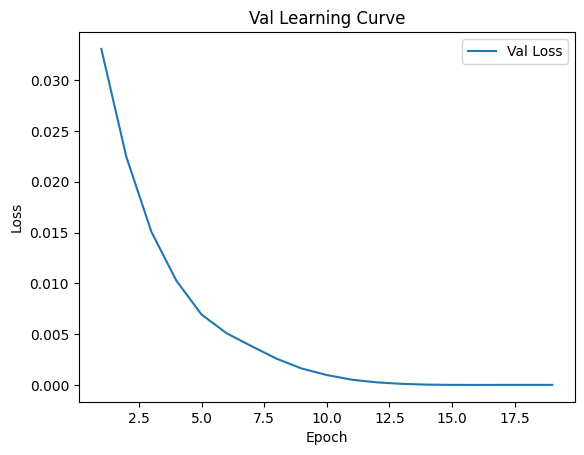


 Epoch: (20/50) Loss = 3.824503437499516e-06

 Epoch: (20/50) Loss_rmse = 0.0019556337501853704

 Epoch: (20/50) R^2 = 0.9998587965965271

 Epoch: (20/50) MAE = 0.001843288540840149
Spearman correlation coefficient: SignificanceResult(statistic=0.9993081747620886, pvalue=3.4331606464582672e-136)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0

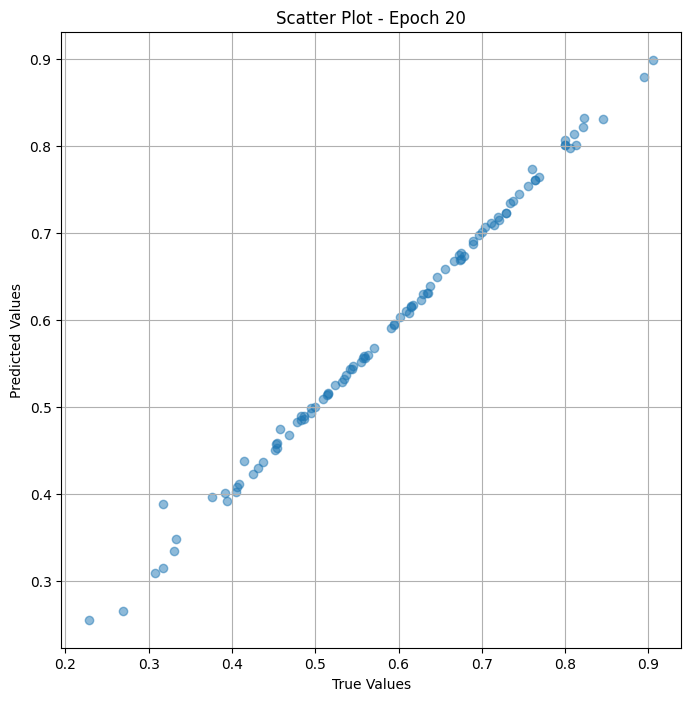

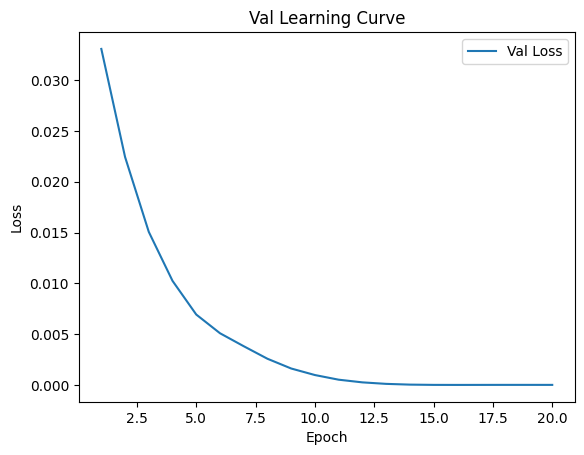


 Epoch: (21/50) Loss = 3.5273146750114392e-06

 Epoch: (21/50) Loss_rmse = 0.0018781146500259638

 Epoch: (21/50) R^2 = 0.9998697638511658

 Epoch: (21/50) MAE = 0.0017764046788215637
Spearman correlation coefficient: SignificanceResult(statistic=0.9993081747620886, pvalue=3.4331606464582672e-136)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478,

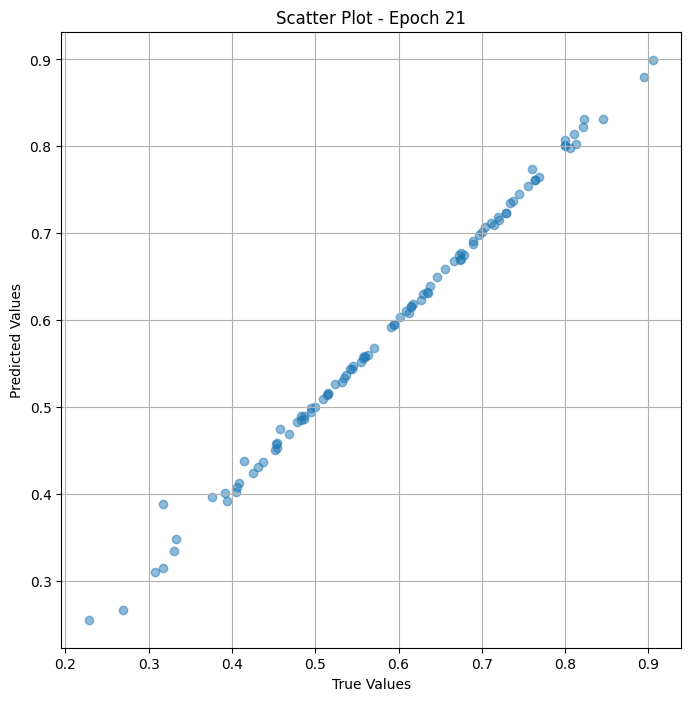

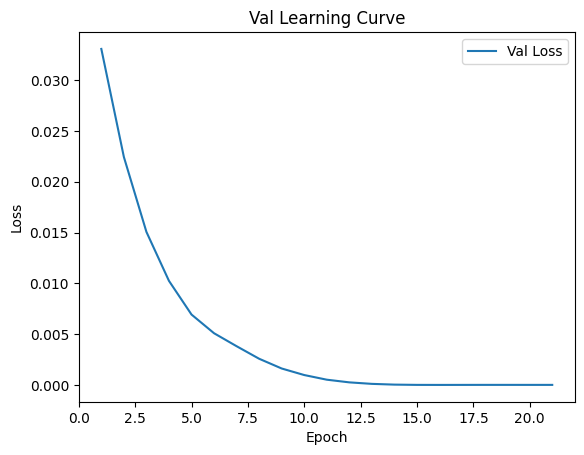

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (22/50) Loss = 3.1907197808322962e-06

 Epoch: (22/50) Loss_rmse = 0.0017862586537376046

 Epoch: (22/50) R^2 = 0.9998822212219238

 Epoch: (22/50) MAE = 0.0016964823007583618
Spearman correlation coefficient: SignificanceResult(statistic=0.9993081747620886, pvalue=3.4331606464582672e-136)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257,

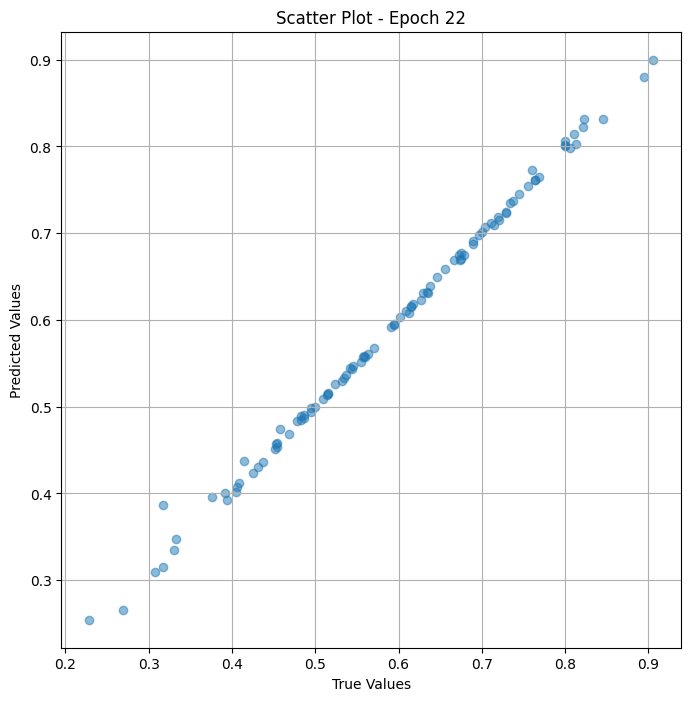

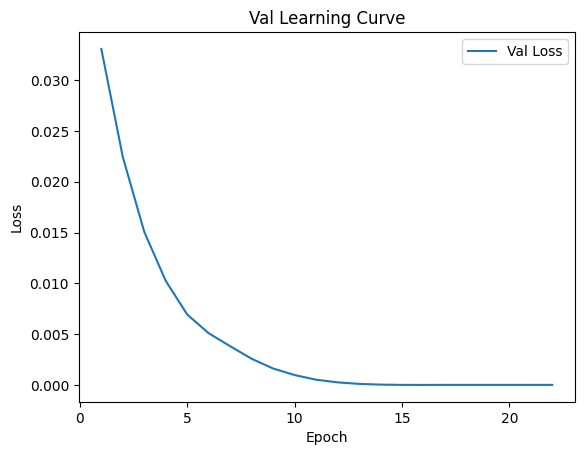


 Epoch: (23/50) Loss = 3.0546364087058464e-06

 Epoch: (23/50) Loss_rmse = 0.0017477518413215876

 Epoch: (23/50) R^2 = 0.999887228012085

 Epoch: (23/50) MAE = 0.0016622394323349
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.316

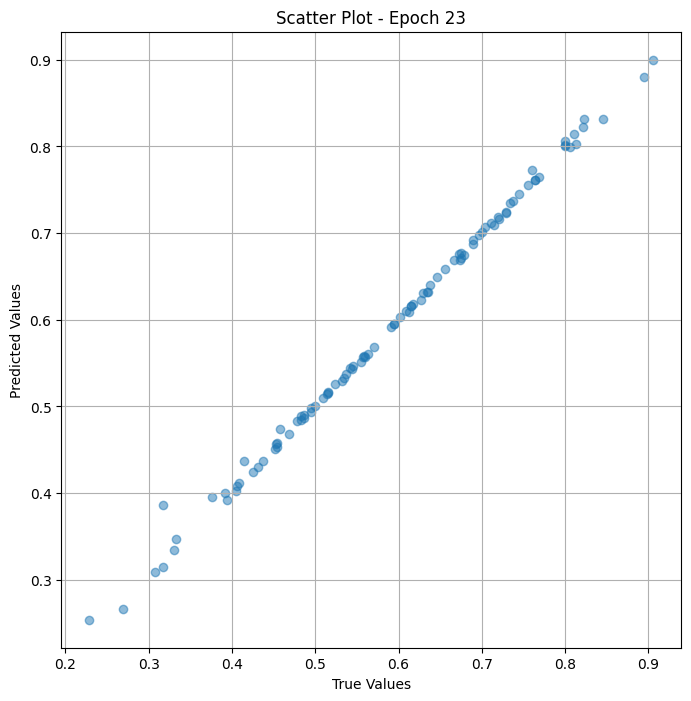

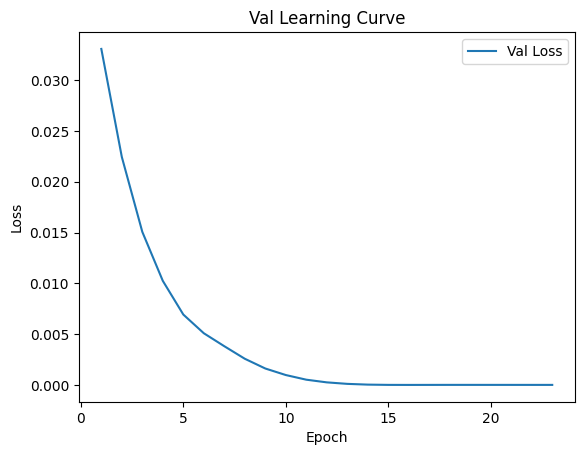


 Epoch: (24/50) Loss = 3.018479219463188e-06

 Epoch: (24/50) Loss_rmse = 0.0017373771406710148

 Epoch: (24/50) R^2 = 0.99988853931427

 Epoch: (24/50) MAE = 0.0016529485583305359
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31

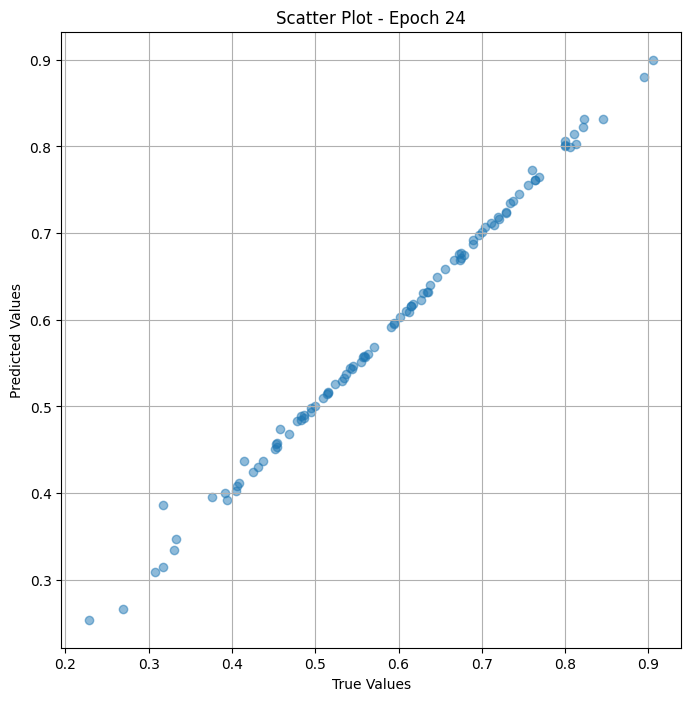

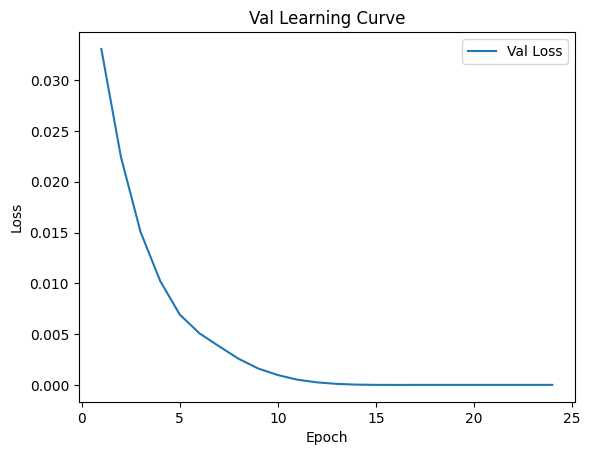

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (25/50) Loss = 2.9808161343680695e-06

 Epoch: (25/50) Loss_rmse = 0.001726504066027701

 Epoch: (25/50) R^2 = 0.9998899698257446

 Epoch: (25/50) MAE = 0.001643158495426178
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7

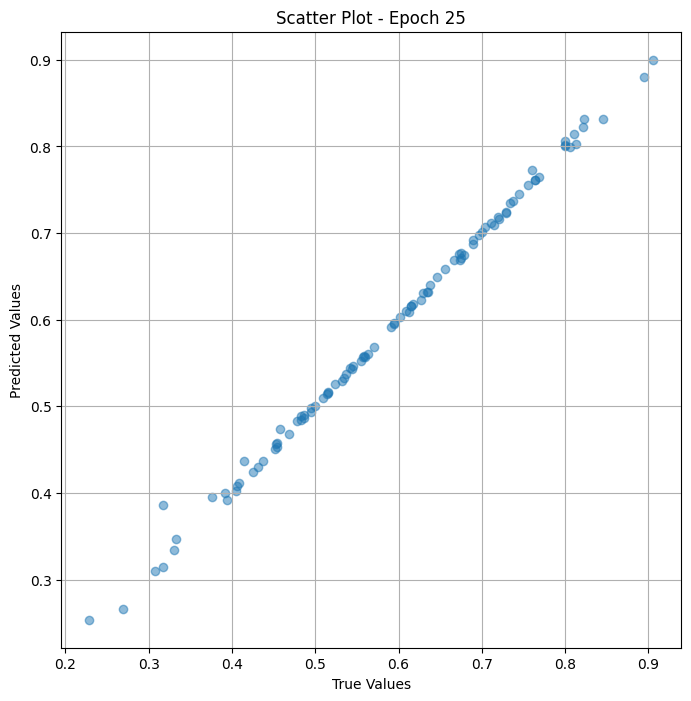

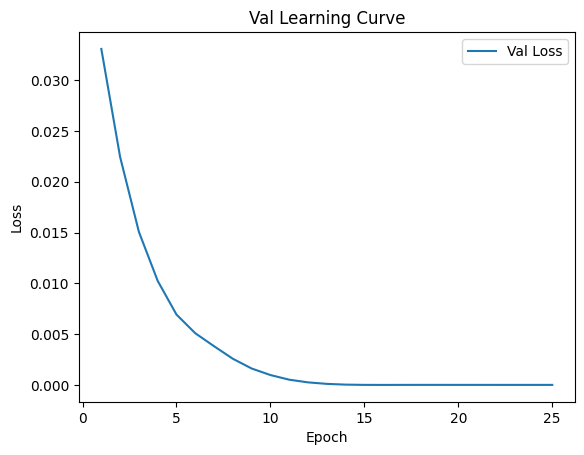


 Epoch: (26/50) Loss = 2.967528871522518e-06

 Epoch: (26/50) Loss_rmse = 0.001722651650197804

 Epoch: (26/50) R^2 = 0.9998904466629028

 Epoch: (26/50) MAE = 0.0016396045684814453
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

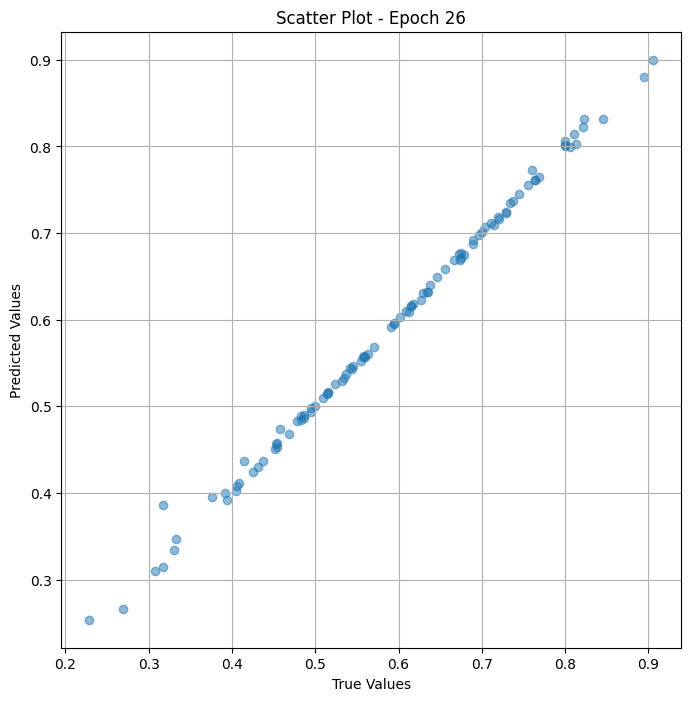

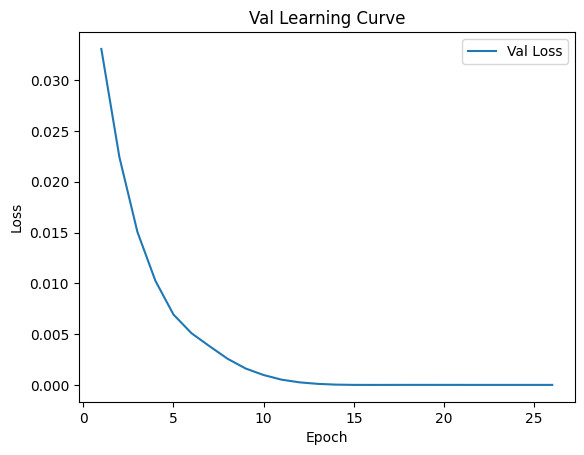


 Epoch: (27/50) Loss = 2.9658040148206055e-06

 Epoch: (27/50) Loss_rmse = 0.0017221509478986263

 Epoch: (27/50) R^2 = 0.9998905062675476

 Epoch: (27/50) MAE = 0.0016391724348068237
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0

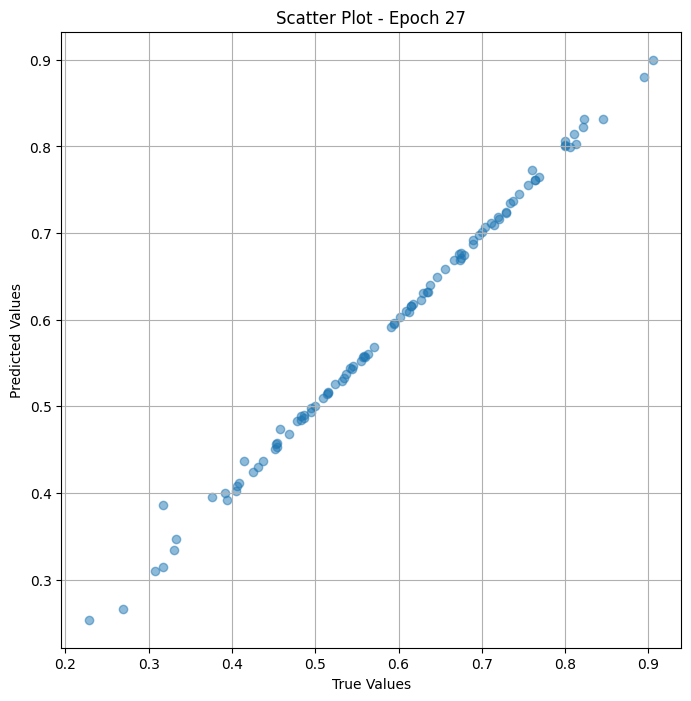

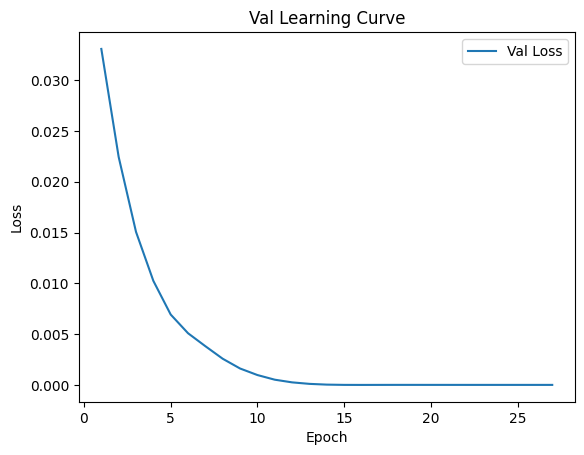

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (28/50) Loss = 2.9640243610629113e-06

 Epoch: (28/50) Loss_rmse = 0.0017216341802850366

 Epoch: (28/50) R^2 = 0.9998905658721924

 Epoch: (28/50) MAE = 0.0016387030482292175
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0

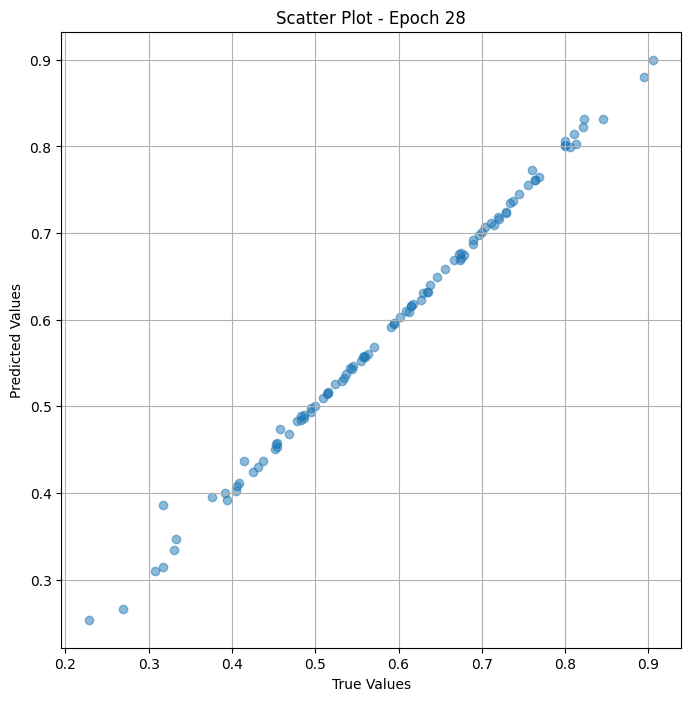

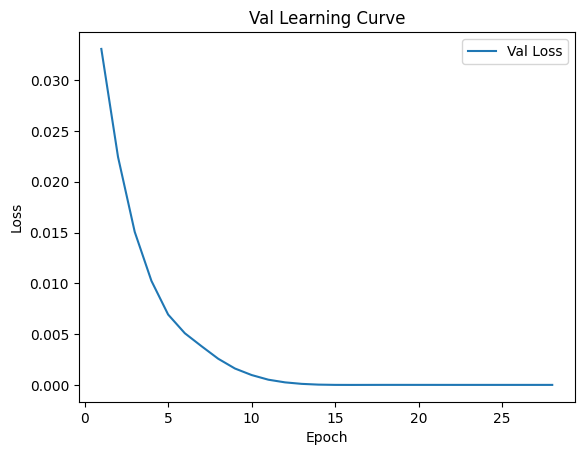


 Epoch: (29/50) Loss = 2.9634688871738035e-06

 Epoch: (29/50) Loss_rmse = 0.0017214728286489844

 Epoch: (29/50) R^2 = 0.9998905658721924

 Epoch: (29/50) MAE = 0.001638568937778473
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

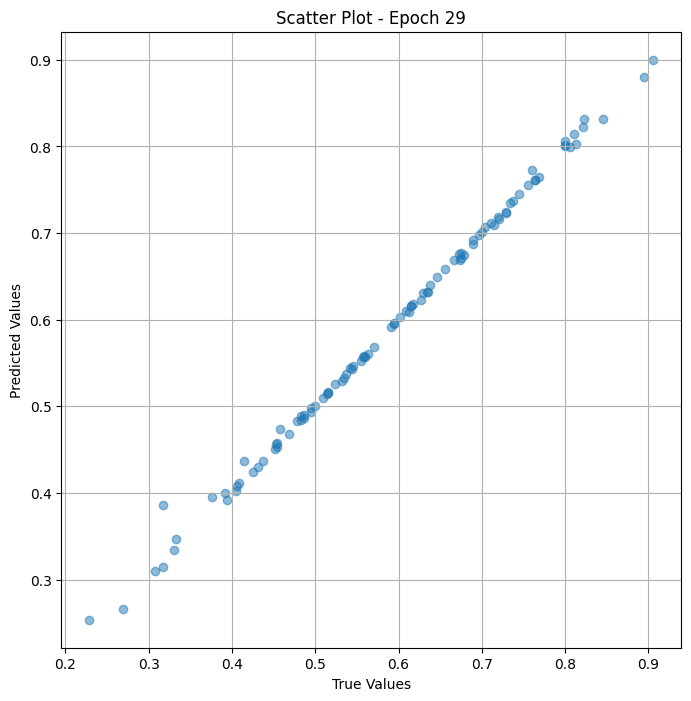

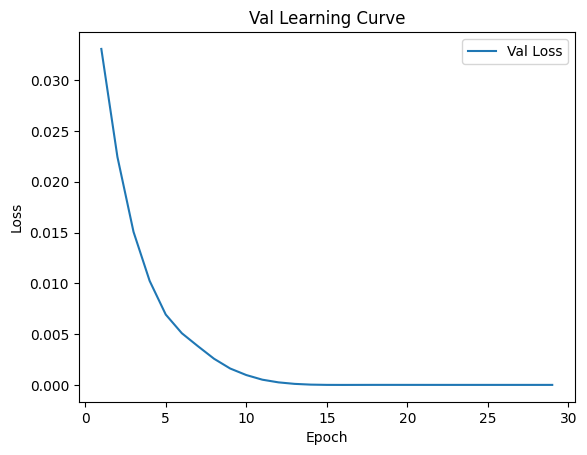


 Epoch: (30/50) Loss = 2.9635396003868664e-06

 Epoch: (30/50) Loss_rmse = 0.0017214934341609478

 Epoch: (30/50) R^2 = 0.9998905658721924

 Epoch: (30/50) MAE = 0.0016385763883590698
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0

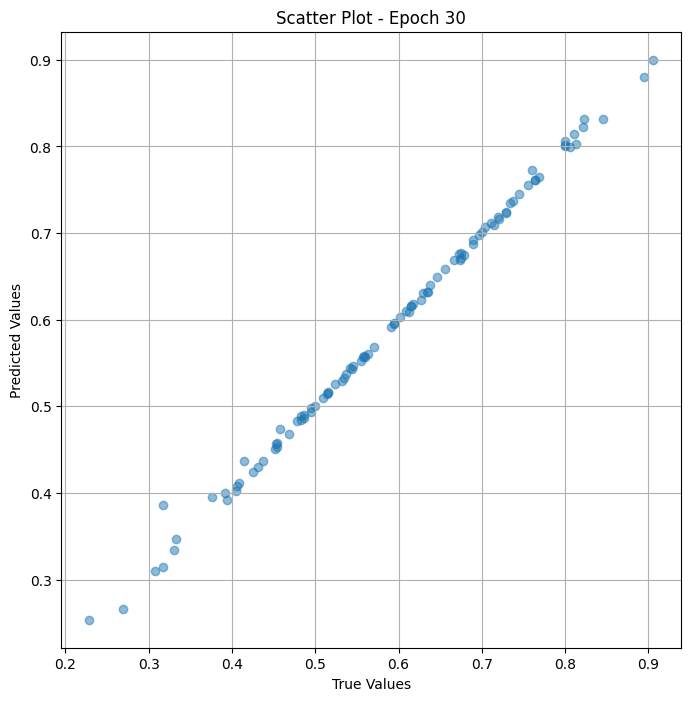

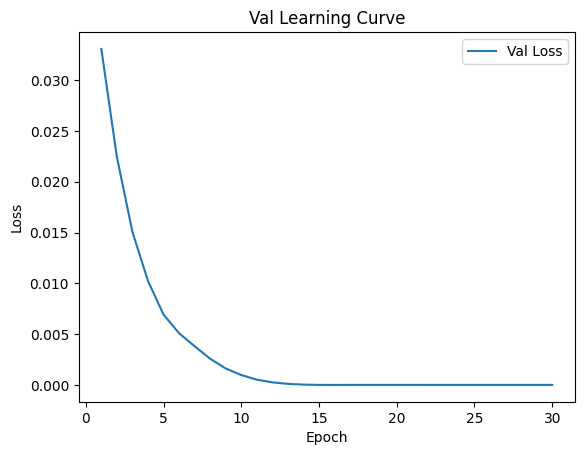


 Epoch: (31/50) Loss = 2.9635602913913317e-06

 Epoch: (31/50) Loss_rmse = 0.0017214994877576828

 Epoch: (31/50) R^2 = 0.9998905658721924

 Epoch: (31/50) MAE = 0.0016385987401008606
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0

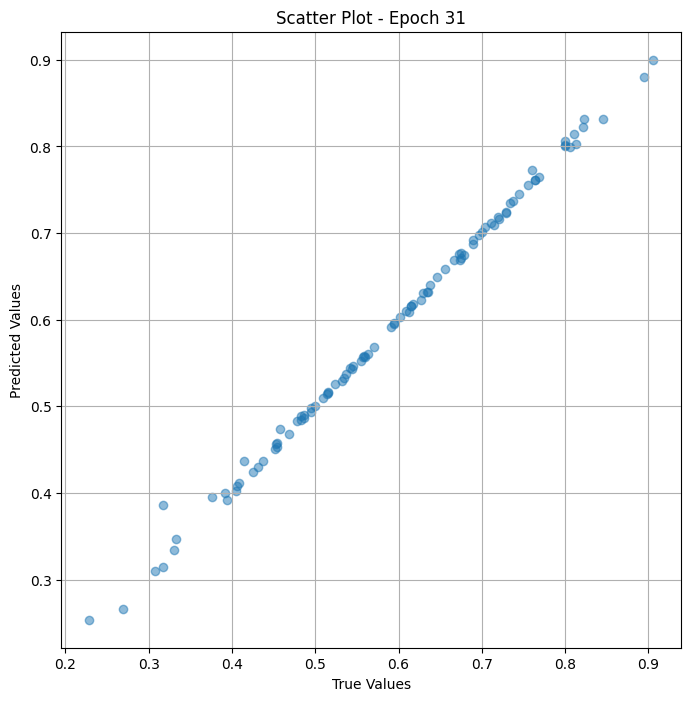

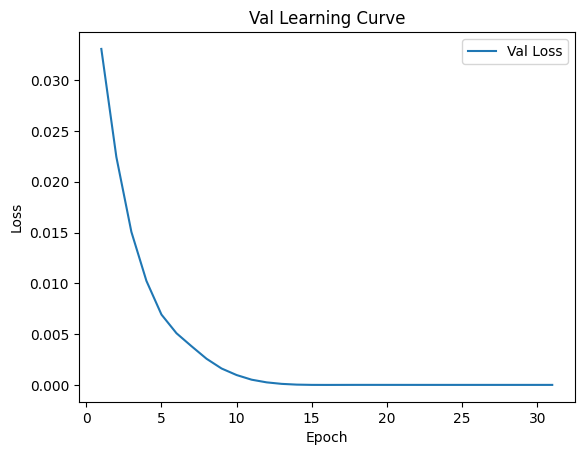


 Epoch: (32/50) Loss = 2.9635882583534112e-06

 Epoch: (32/50) Loss_rmse = 0.0017215075204148889

 Epoch: (32/50) R^2 = 0.9998905658721924

 Epoch: (32/50) MAE = 0.0016386136412620544
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0

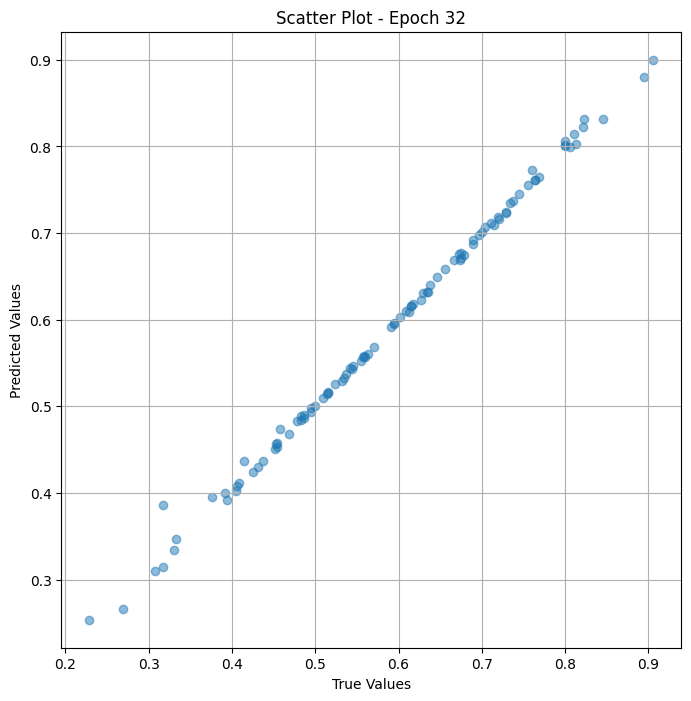

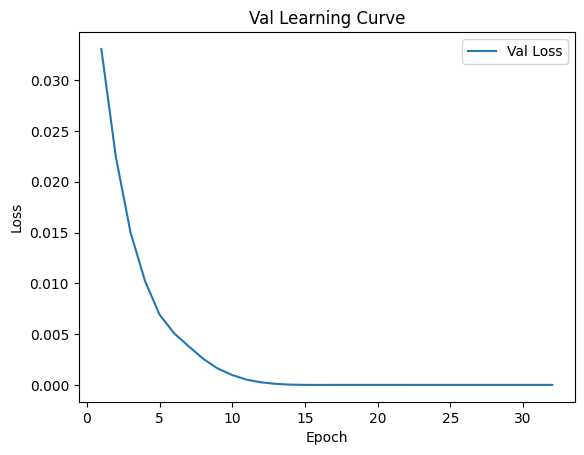


 Epoch: (33/50) Loss = 2.963759015983669e-06

 Epoch: (33/50) Loss_rmse = 0.0017215571133419871

 Epoch: (33/50) R^2 = 0.9998905658721924

 Epoch: (33/50) MAE = 0.0016386881470680237
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

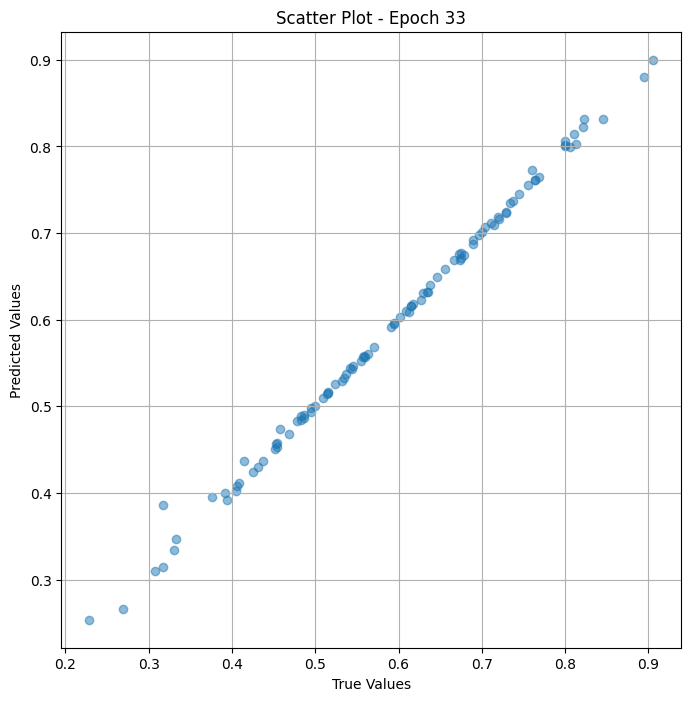

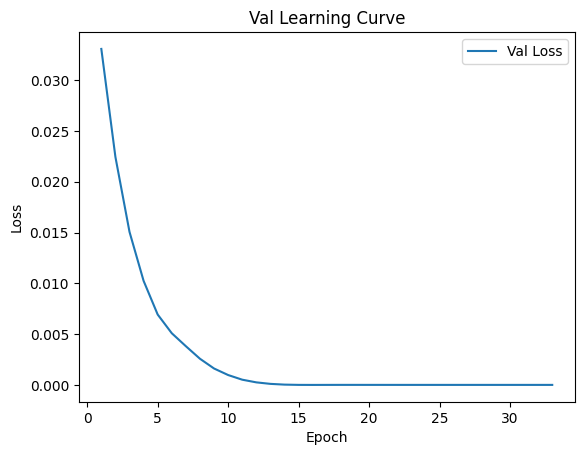


 Epoch: (34/50) Loss = 2.9637344596267212e-06

 Epoch: (34/50) Loss_rmse = 0.0017215500120073557

 Epoch: (34/50) R^2 = 0.9998905658721924

 Epoch: (34/50) MAE = 0.001638665795326233
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

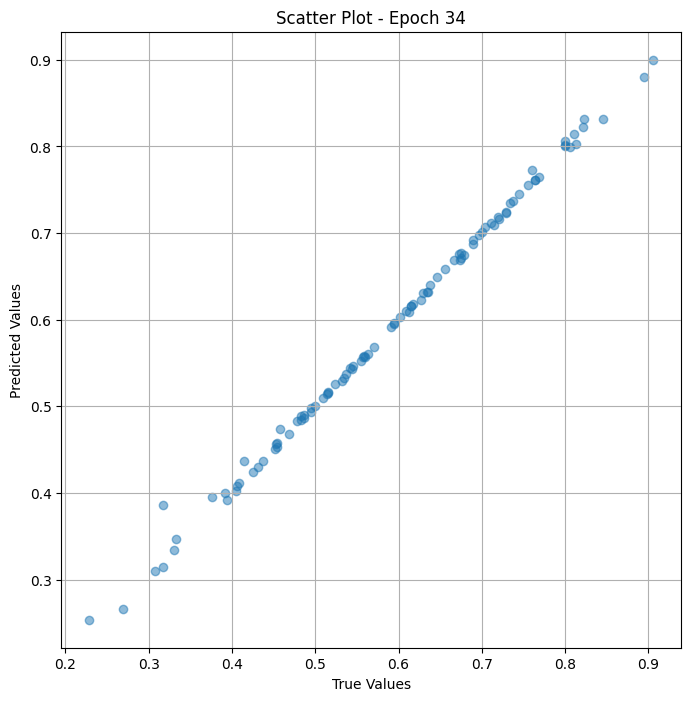

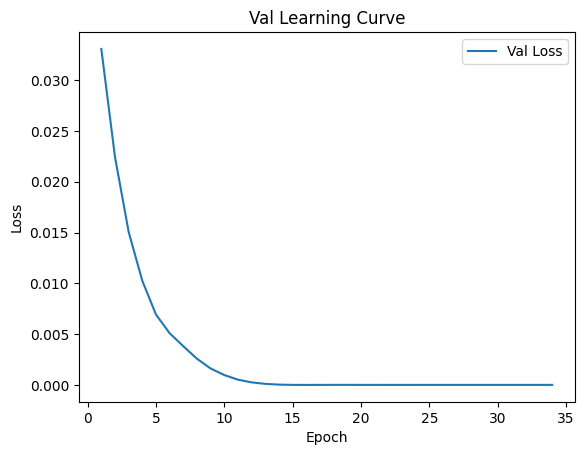


 Epoch: (35/50) Loss = 2.963814949907828e-06

 Epoch: (35/50) Loss_rmse = 0.001721573411487043

 Epoch: (35/50) R^2 = 0.9998905658721924

 Epoch: (35/50) MAE = 0.0016386955976486206
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

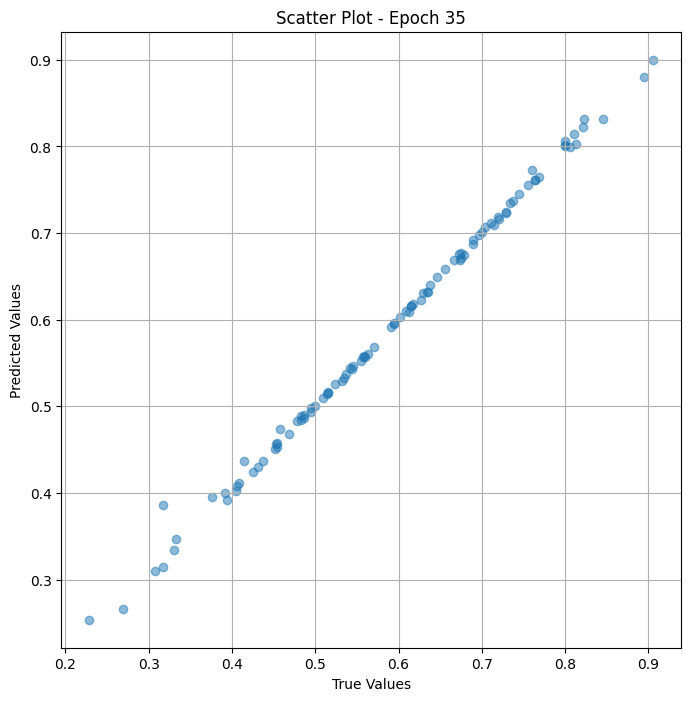

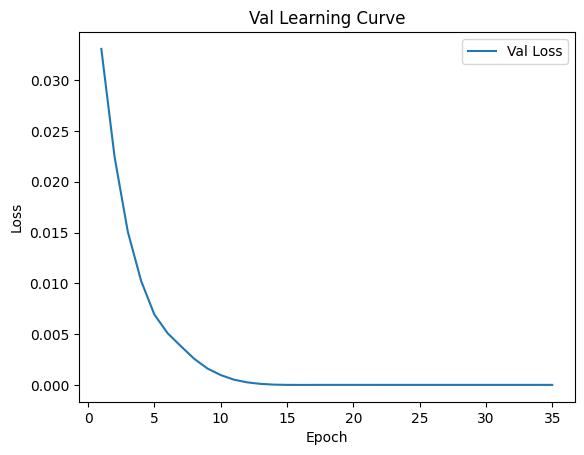


 Epoch: (36/50) Loss = 2.963939550681971e-06

 Epoch: (36/50) Loss_rmse = 0.001721609616652131

 Epoch: (36/50) R^2 = 0.9998905658721924

 Epoch: (36/50) MAE = 0.0016387179493904114
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

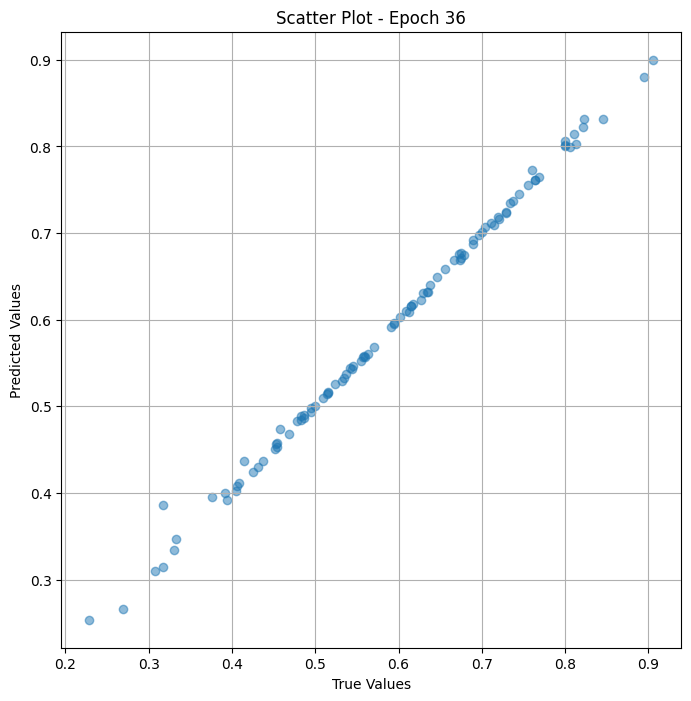

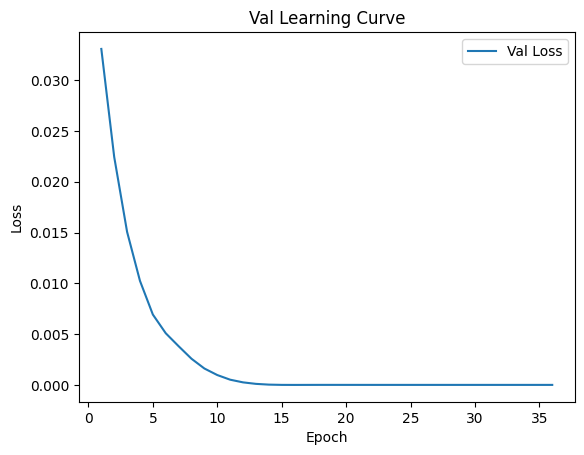


 Epoch: (37/50) Loss = 2.9638345040439162e-06

 Epoch: (37/50) Loss_rmse = 0.0017215791158378124

 Epoch: (37/50) R^2 = 0.9998905658721924

 Epoch: (37/50) MAE = 0.0016386881470680237
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0

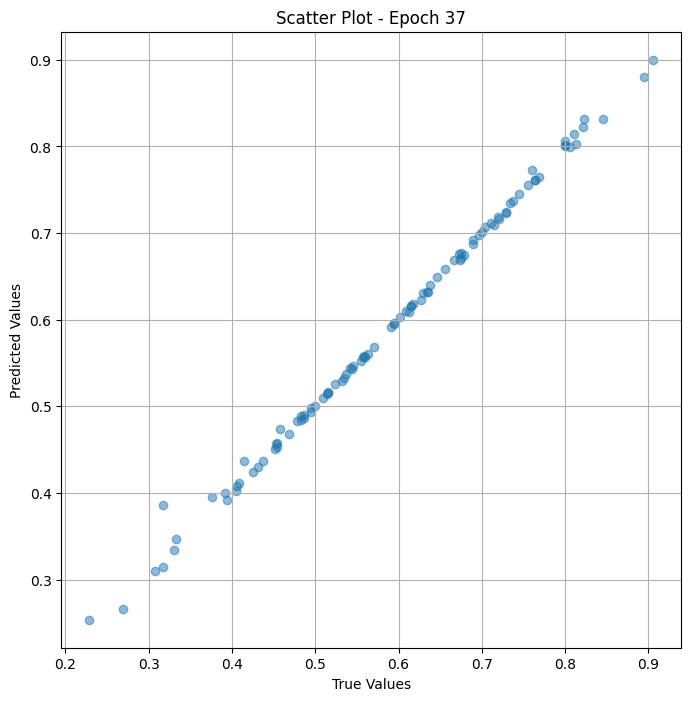

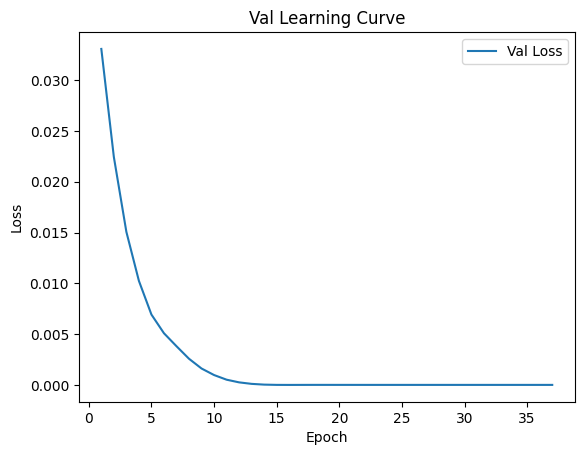


 Epoch: (38/50) Loss = 2.964008899652981e-06

 Epoch: (38/50) Loss_rmse = 0.0017216297565028071

 Epoch: (38/50) R^2 = 0.9998905658721924

 Epoch: (38/50) MAE = 0.0016387253999710083
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

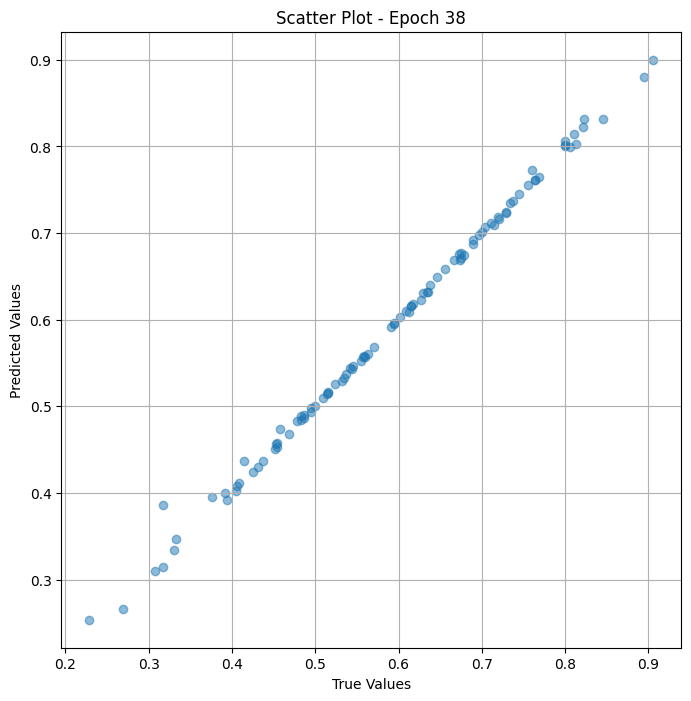

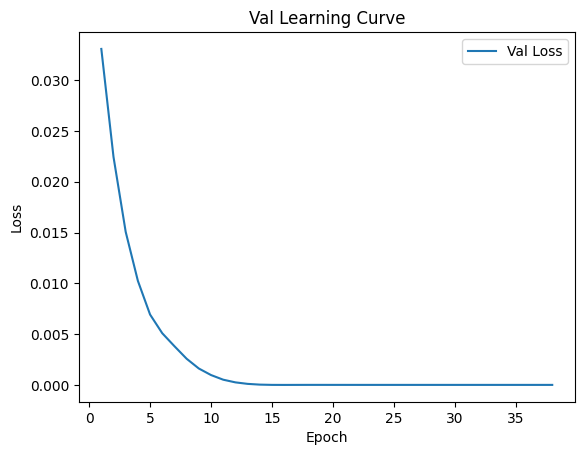


 Epoch: (39/50) Loss = 2.964111899927957e-06

 Epoch: (39/50) Loss_rmse = 0.0017216596752405167

 Epoch: (39/50) R^2 = 0.9998905658721924

 Epoch: (39/50) MAE = 0.0016387775540351868
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

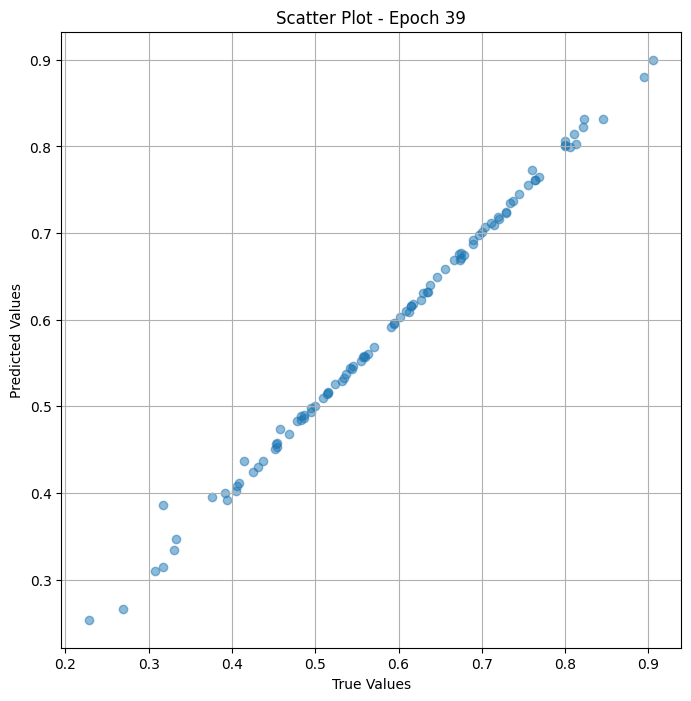

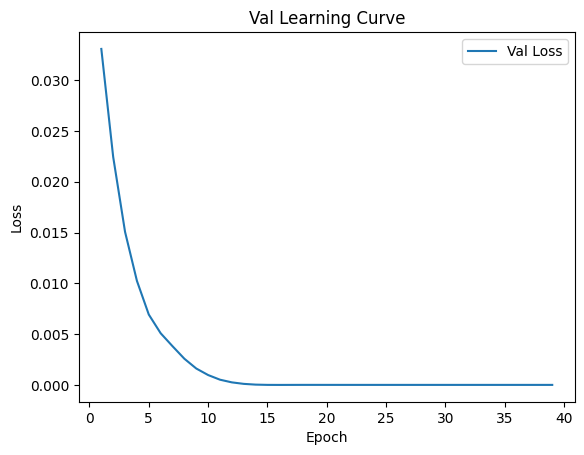


 Epoch: (40/50) Loss = 2.964049826914561e-06

 Epoch: (40/50) Loss_rmse = 0.0017216416308656335

 Epoch: (40/50) R^2 = 0.9998905658721924

 Epoch: (40/50) MAE = 0.001638747751712799
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

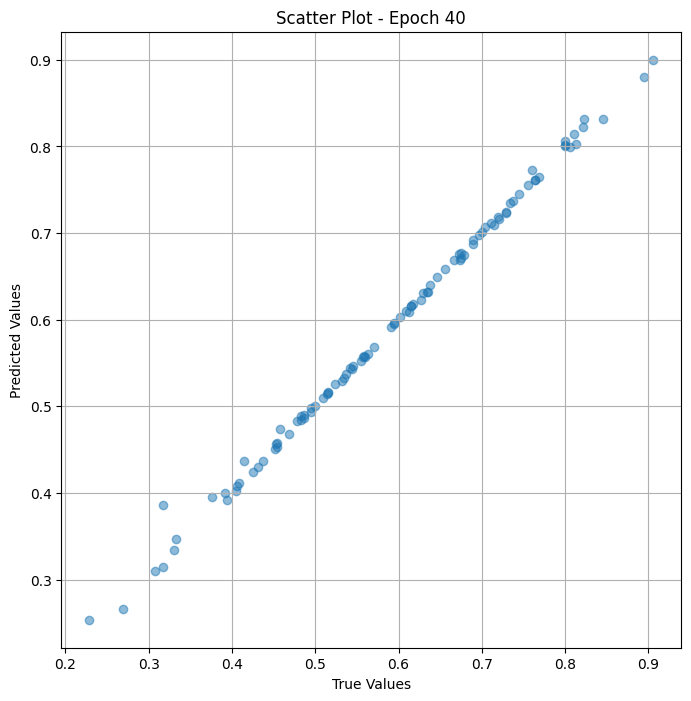

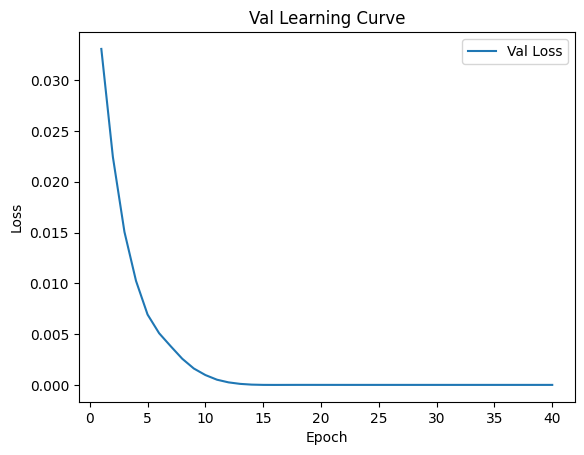


 Epoch: (41/50) Loss = 2.9641096261912026e-06

 Epoch: (41/50) Loss_rmse = 0.0017216589767485857

 Epoch: (41/50) R^2 = 0.9998905658721924

 Epoch: (41/50) MAE = 0.001638747751712799
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

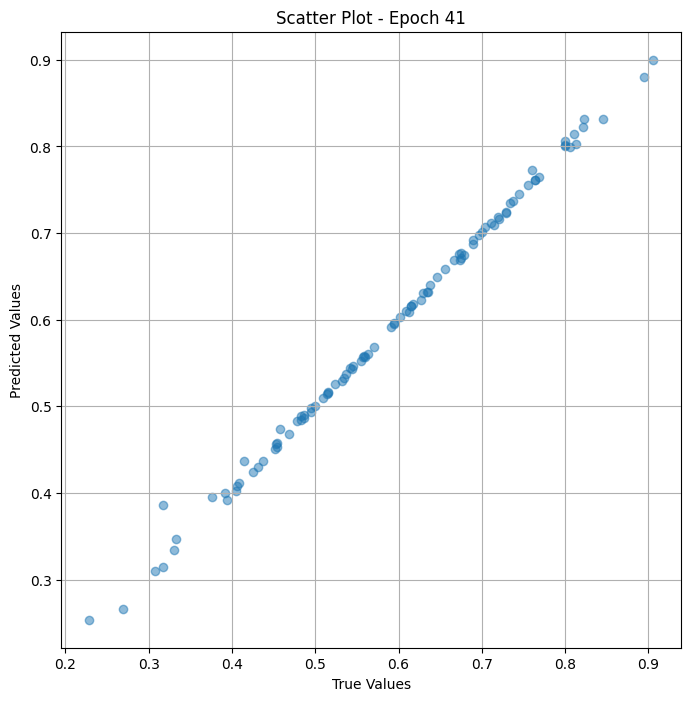

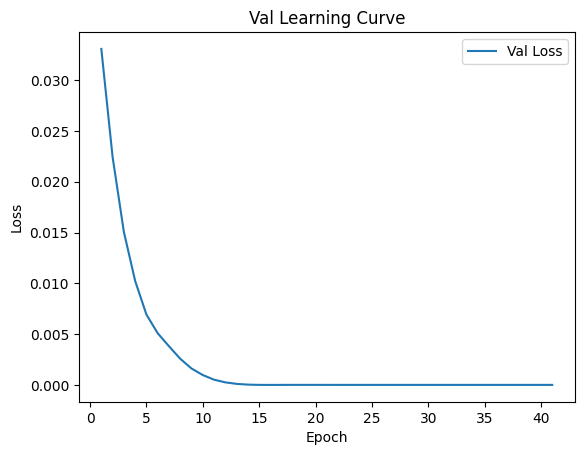


 Epoch: (42/50) Loss = 2.9642408208019333e-06

 Epoch: (42/50) Loss_rmse = 0.0017216970445588231

 Epoch: (42/50) R^2 = 0.9998905658721924

 Epoch: (42/50) MAE = 0.0016387850046157837
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0

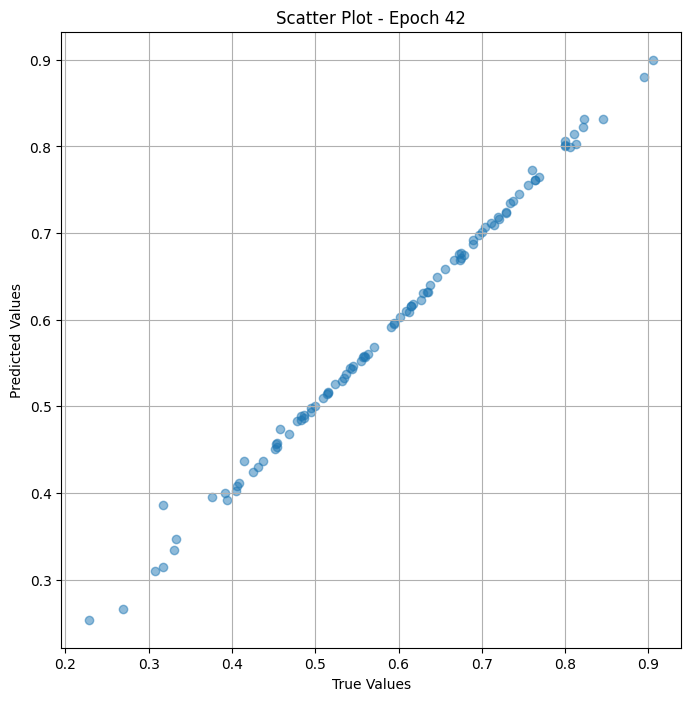

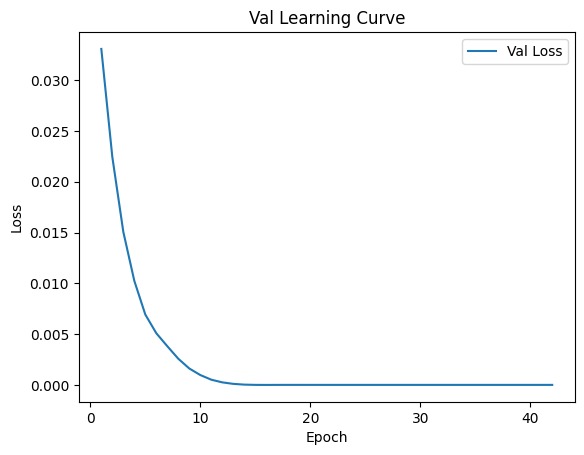


 Epoch: (43/50) Loss = 2.964178520414862e-06

 Epoch: (43/50) Loss_rmse = 0.00172167900018394

 Epoch: (43/50) R^2 = 0.9998905658721924

 Epoch: (43/50) MAE = 0.0016387850046157837
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31

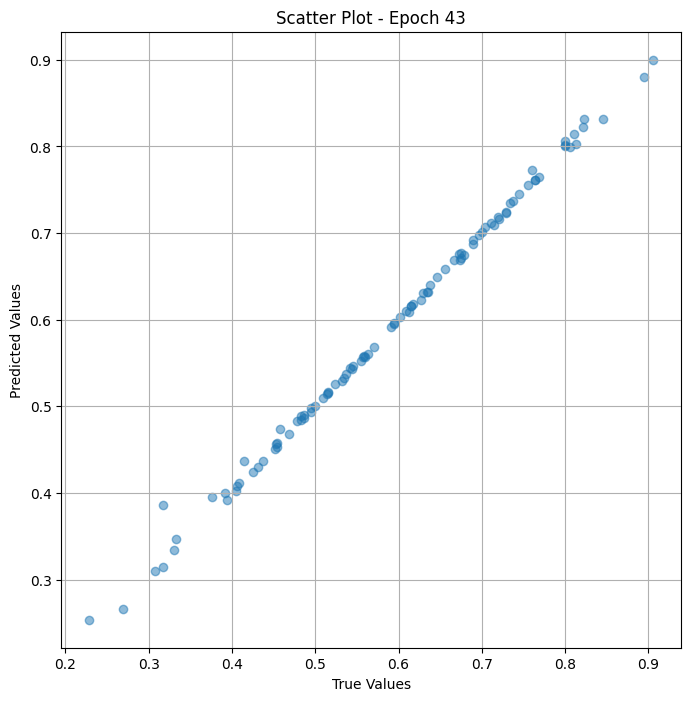

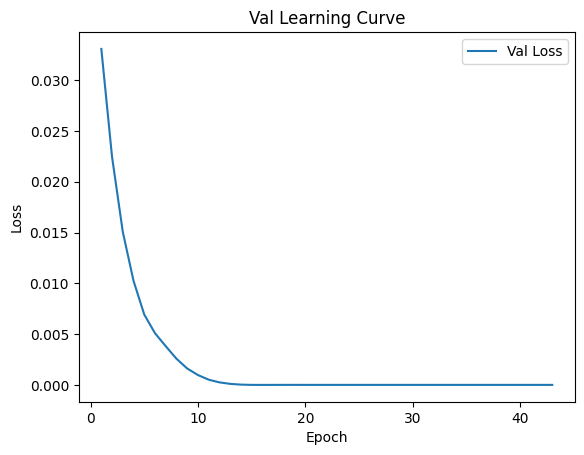


 Epoch: (44/50) Loss = 2.964184204756748e-06

 Epoch: (44/50) Loss_rmse = 0.0017216806299984455

 Epoch: (44/50) R^2 = 0.9998905658721924

 Epoch: (44/50) MAE = 0.0016387850046157837
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

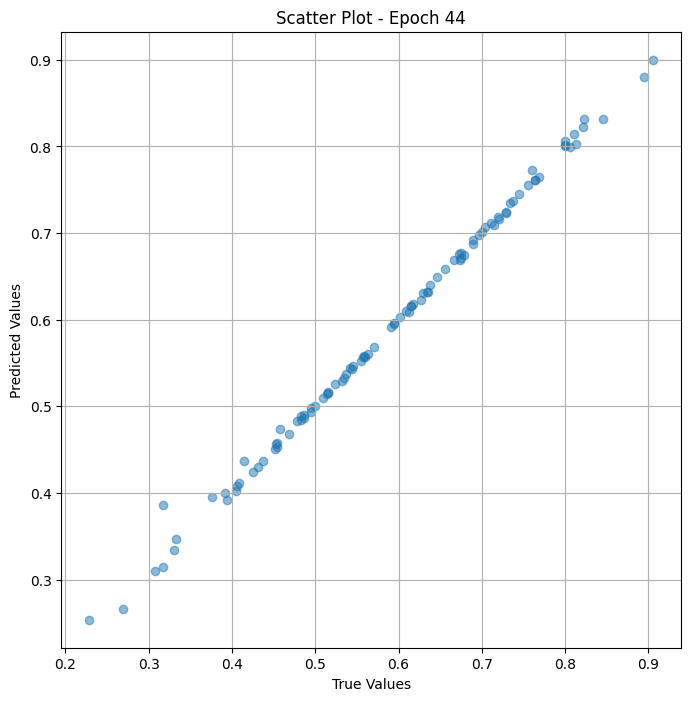

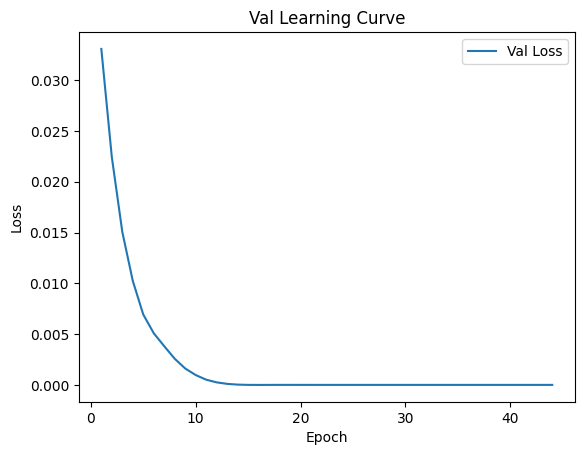


 Epoch: (45/50) Loss = 2.964420673379209e-06

 Epoch: (45/50) Loss_rmse = 0.0017217493150383234

 Epoch: (45/50) R^2 = 0.9998905658721924

 Epoch: (45/50) MAE = 0.001638844609260559
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

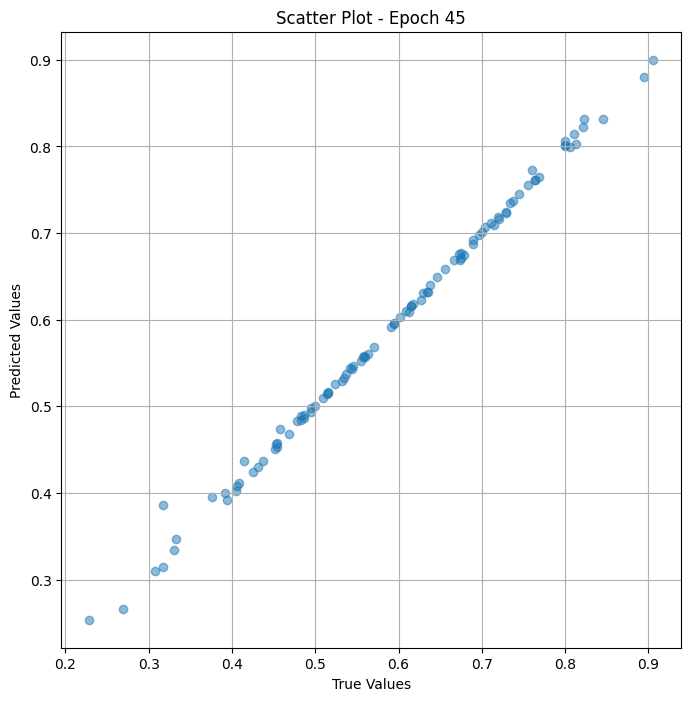

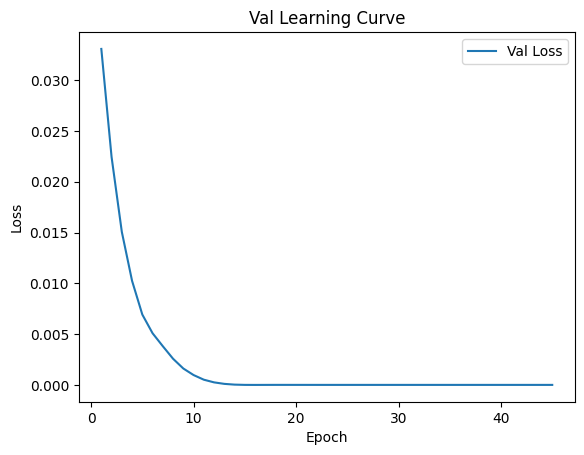


 Epoch: (46/50) Loss = 2.9643983907590155e-06

 Epoch: (46/50) Loss_rmse = 0.001721742795780301

 Epoch: (46/50) R^2 = 0.9998905658721924

 Epoch: (46/50) MAE = 0.001638852059841156
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

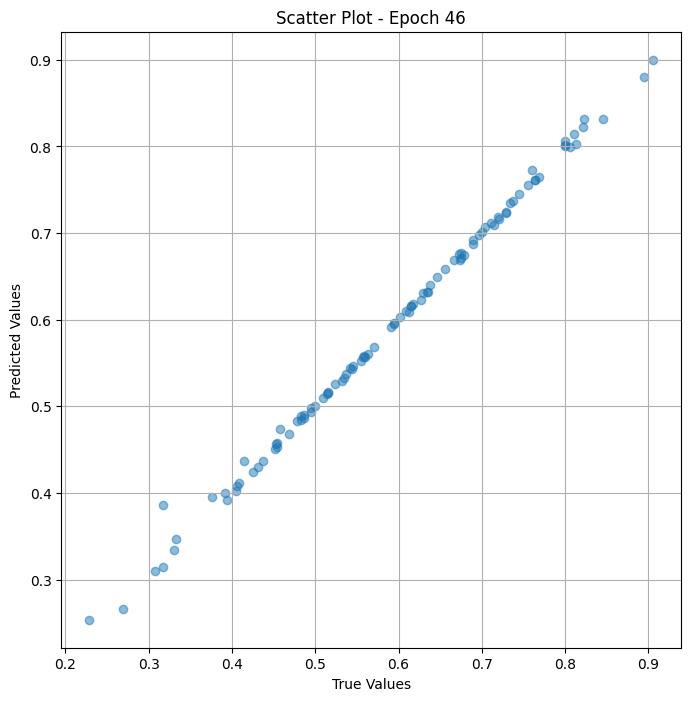

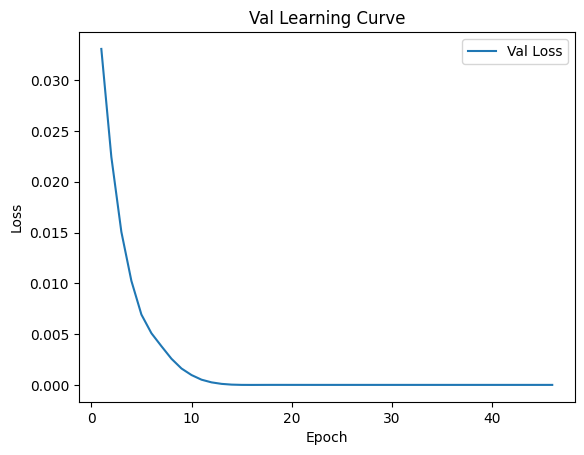


 Epoch: (47/50) Loss = 2.9644825190189295e-06

 Epoch: (47/50) Loss_rmse = 0.0017217672429978848

 Epoch: (47/50) R^2 = 0.9998905658721924

 Epoch: (47/50) MAE = 0.0016388744115829468
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0

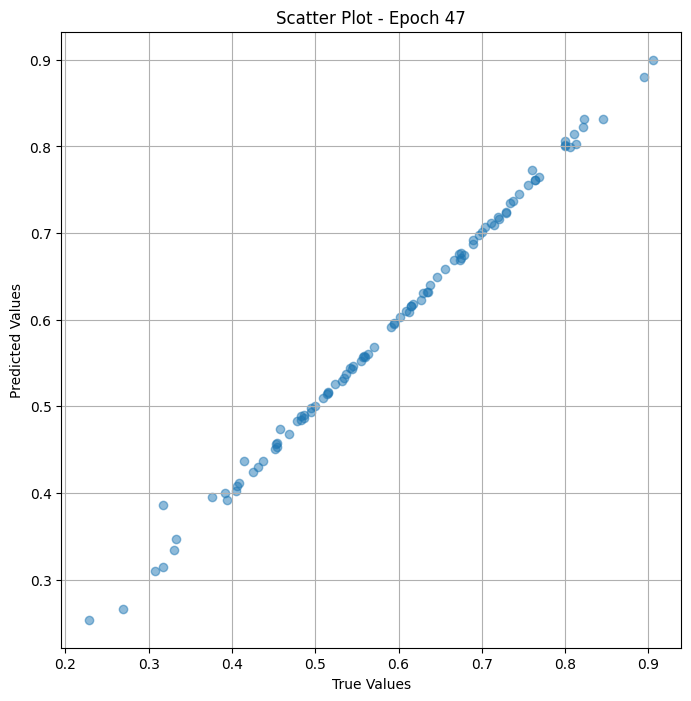

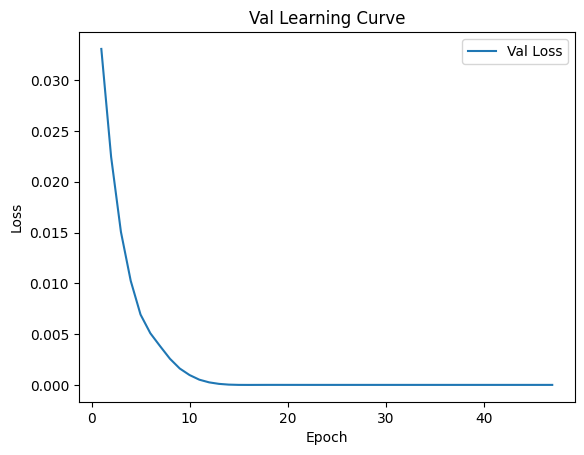


 Epoch: (48/50) Loss = 2.9645195809280267e-06

 Epoch: (48/50) Loss_rmse = 0.0017217780696228147

 Epoch: (48/50) R^2 = 0.9998905658721924

 Epoch: (48/50) MAE = 0.0016388818621635437
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0

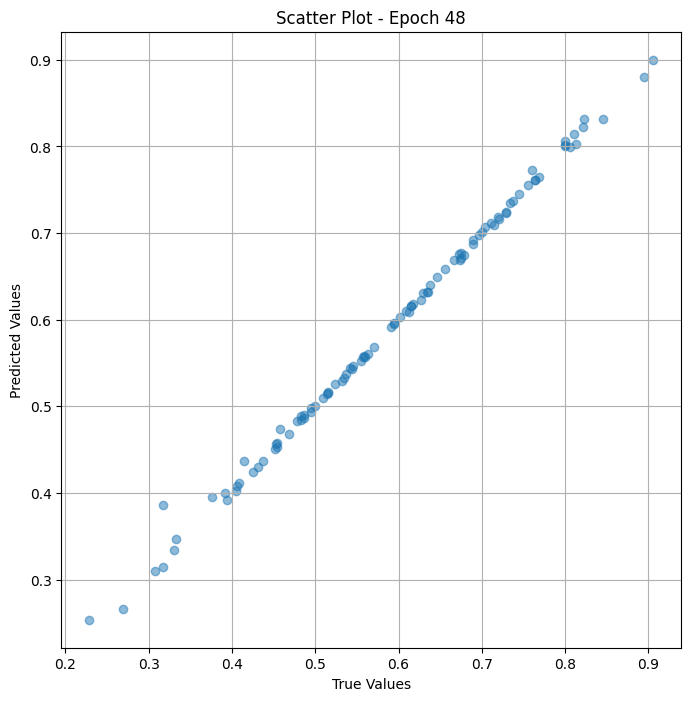

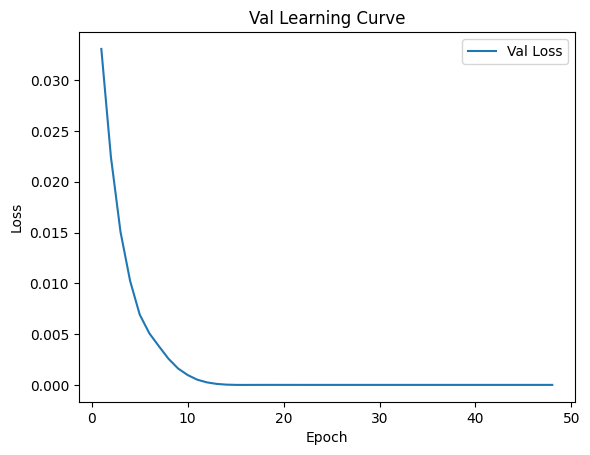


 Epoch: (49/50) Loss = 2.9644174901477527e-06

 Epoch: (49/50) Loss_rmse = 0.0017217483837157488

 Epoch: (49/50) R^2 = 0.9998905658721924

 Epoch: (49/50) MAE = 0.001638852059841156
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

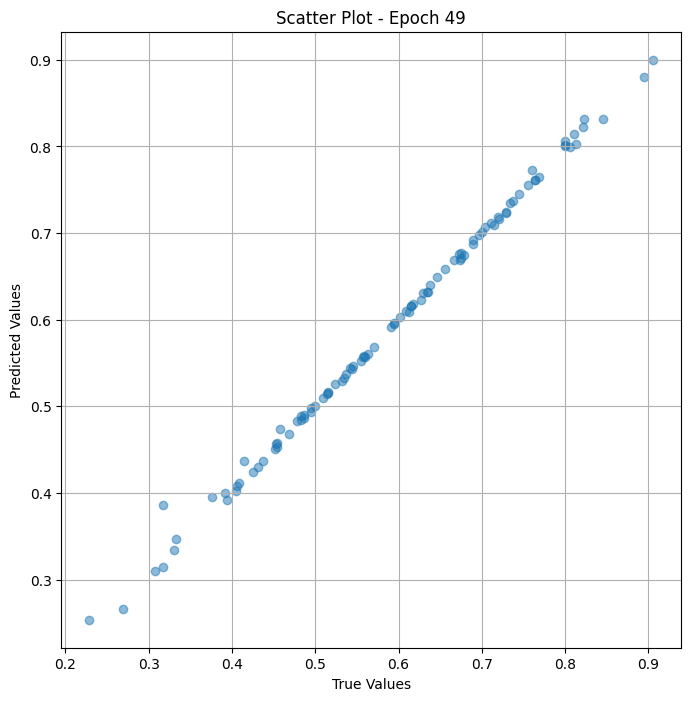

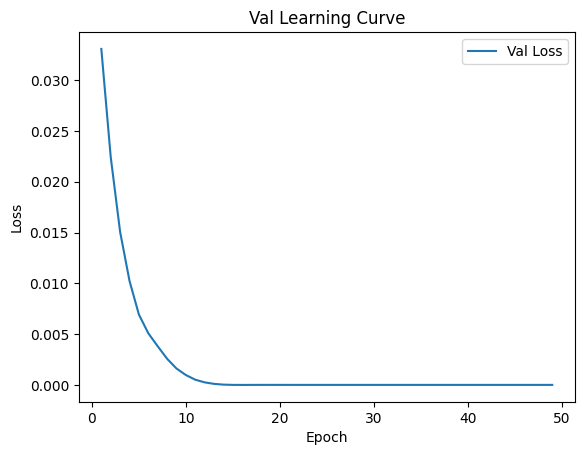


 Epoch: (50/50) Loss = 2.9644425012520514e-06

 Epoch: (50/50) Loss_rmse = 0.001721755601465702

 Epoch: (50/50) R^2 = 0.9998905658721924

 Epoch: (50/50) MAE = 0.0016388744115829468
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760008018867, pvalue=2.69262796370408e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

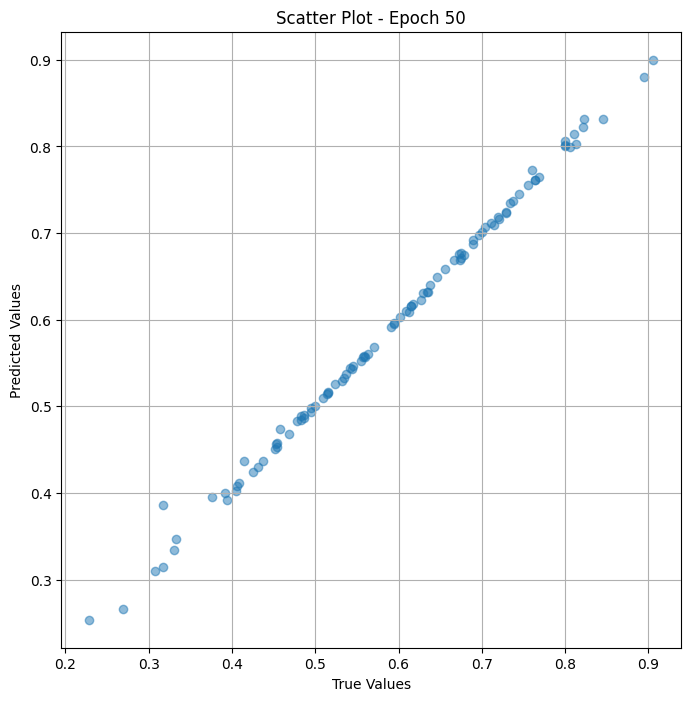

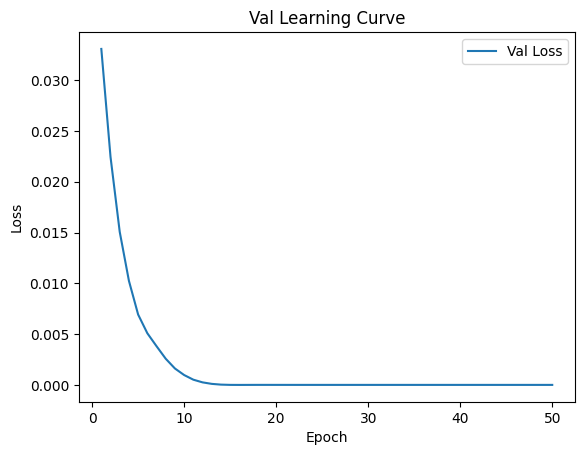

In [ ]:
# val the model and save weights
fit(50, model_res_val , val_dl )
torch.save(model_res_val .state_dict(), "model_weights_s")

In [ ]:
true_values_list_val = []
predicted_values_list_val = []

for x_trans, yb in val_dl:
    preds = model_res_val(x_trans)
    true_values_list_val.extend(yb.cpu().detach().numpy())
    predicted_values_list_val.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_landscape' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_val_landscape['preprocessed_image_path'],
    'True Value': true_values_list_val,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_val # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

                                           Image Path  True Value  \
0   /content/landscape/n09288635_10303_preprocesse...    0.763636   
1   /content/landscape/n03634034_3909_preprocessed...    0.764045   
2   /content/landscape/n09288635_12206_preprocesse...    0.769231   
3   /content/landscape/n09376198_3096_preprocessed...    0.376471   
4   /content/landscape/sun_avipgcjbbnedfqla_prepro...    0.563830   
..                                                ...         ...   
95  /content/landscape/n09270735_11406_preprocesse...    0.515151   
96  /content/landscape/sun_apzhvyvljzvahpvh_prepro...    0.268817   
97  /content/landscape/a252b3cce303c122_preprocess...    0.454545   
98  /content/landscape/n09288635_9839_preprocessed...    0.719626   
99  /content/landscape/af398033fcc3c41d_preprocess...    0.393939   

    Predicted Value  
0          0.760743  
1          0.760878  
2          0.764509  
3          0.394886  
4          0.560314  
..              ...  
95         0.5150

## Test

In [ ]:
df_test_landscape.head()


,preprocessed_image_path,memoscore
0,/content/landscape/n07801091_49081_preprocesse...,0.564356
1,/content/landscape/0ce0499b7f00cb0e_preprocess...,0.511905
2,/content/landscape/sun_attunurkvvvrpksl_prepro...,0.370000
3,/content/landscape/5e3a2b6e7943040f_preprocess...,0.474227
4,/content/landscape/sun_ammlmcnlqojiatxv_prepro...,0.365854


In [ ]:
class Dataset_test_res_landscape(Dataset):
    def __init__(self, df, res_transform =None):
        self.labels = df_test_landscape["memoscore"]
        self.images = df_test_landscape["preprocessed_image_path"]
        self.res_transform  = res_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.res_transform (image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
res_transform   = ConvNextImageProcessor.from_pretrained("facebook/convnext-tiny-224")

# สร้าง Dataset และ DataLoader
test_ds = Dataset_test_res_landscape(df_test_landscape, res_transform =res_transform )
test_dl = DataLoader(test_ds, batch_size=32, shuffle=False)

In [ ]:
print(test_ds)

In [ ]:
class Resnet_model_test_res_landscape(torch.nn.Module):
    def __init__(self, arch="resnet50.a1_in1k"):
        super().__init__()
        self.arch = arch
        self.res = timm.create_model(self.arch, pretrained=True, num_classes=1)

    def forward(self, x):
        resfeat = self.res(x)
        out = torch.sigmoid(resfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_res_test = Resnet_model_test_res_landscape( arch="resnet50.a1_in1k")

In [ ]:


# Assuming your model is an instance of YourModelClass and is already on GPU
model = Resnet_model_test_res_landscape().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
         Identity-10           [-1, 64, 56, 56]               0
             ReLU-11           [-1, 64, 56, 56]               0
         Identity-12           [-1, 64, 56, 56]               0
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

In [ ]:
device = get_default_device()
test_dl = DeviceDataLoader(test_dl, device)
model_res_test  = to_device(model_res_test  , device)

In [ ]:
params = [param for param in list(model_res_test.parameters()) if param.requires_grad ]
optimizer = torch.optim.Adam(params, lr=1e-4)   #,weight_decay=1e-7

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)



/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/50) Loss = 0.005894105415791273

 Epoch: (1/50) Loss_rmse = 0.07677307724952698

 Epoch: (1/50) R^2 = -0.15676093101501465

 Epoch: (1/50) MAE = 0.056219108402729034
Spearman correlation coefficient: SignificanceResult(statistic=0.034081891494893345, pvalue=0.7416611055270017)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.6447

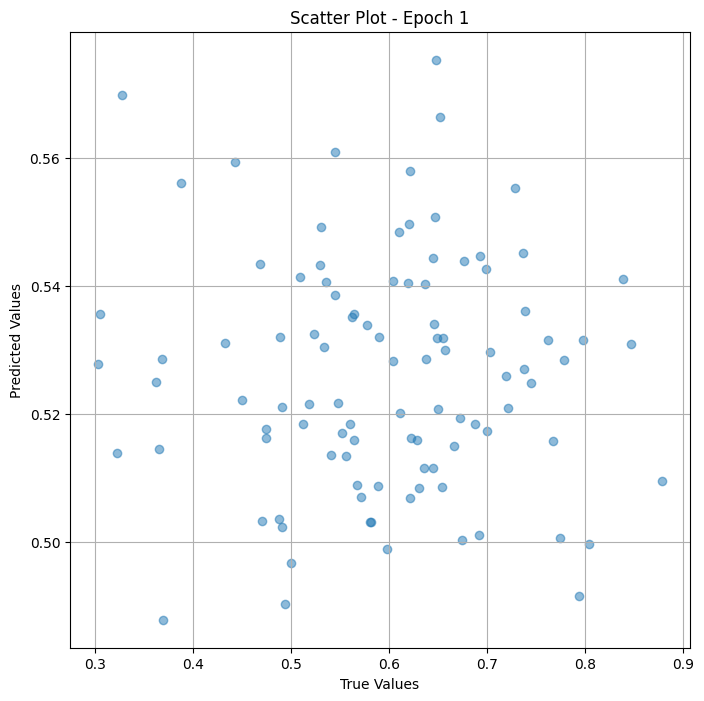

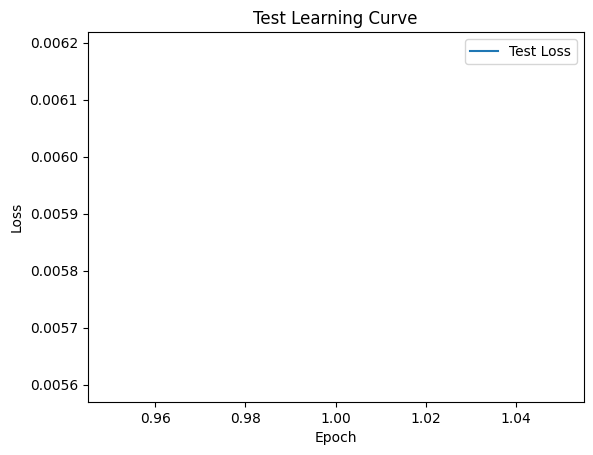


 Epoch: (2/50) Loss = 0.004770745988935232

 Epoch: (2/50) Loss_rmse = 0.06907058507204056

 Epoch: (2/50) R^2 = 0.06370651721954346

 Epoch: (2/50) MAE = 0.055769555270671844
Spearman correlation coefficient: SignificanceResult(statistic=0.16972442841158428, pvalue=0.09829286832907781)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.64473

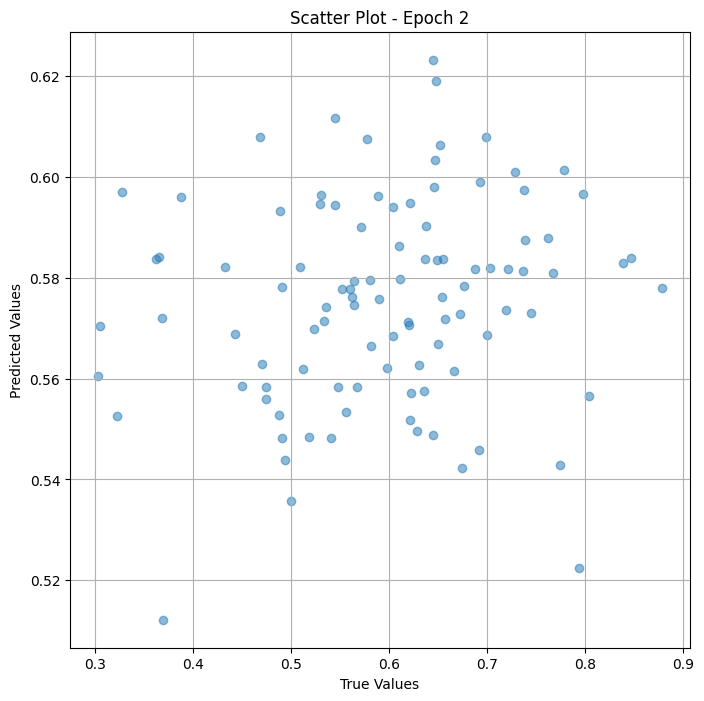

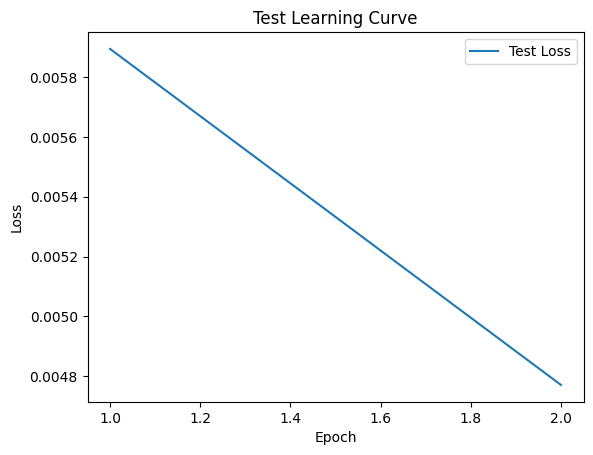


 Epoch: (3/50) Loss = 0.0028949622064828873

 Epoch: (3/50) Loss_rmse = 0.053804852068424225

 Epoch: (3/50) R^2 = 0.4318426847457886

 Epoch: (3/50) MAE = 0.04118987172842026
Spearman correlation coefficient: SignificanceResult(statistic=0.4695908138388927, pvalue=1.3889776479080313e-06)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.644

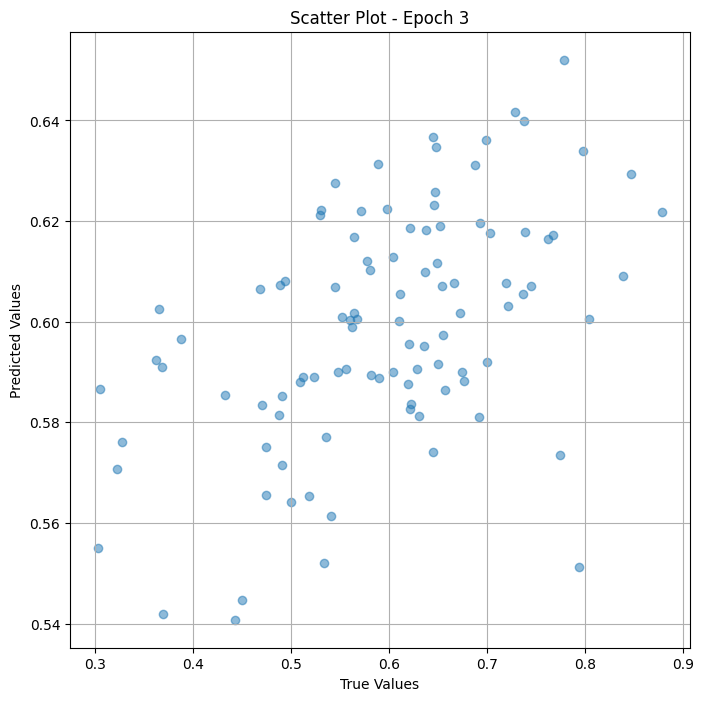

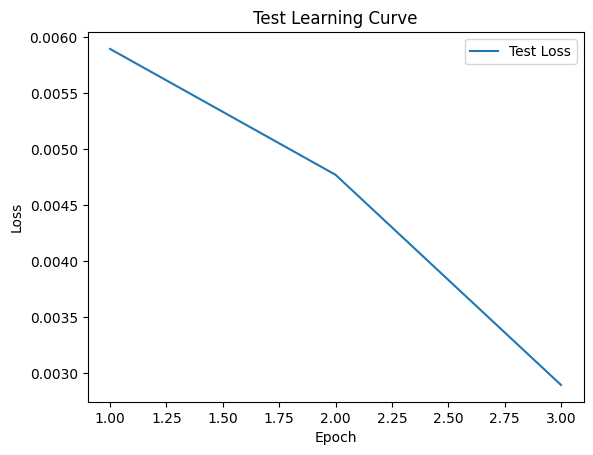


 Epoch: (4/50) Loss = 0.0017487350851297379

 Epoch: (4/50) Loss_rmse = 0.04181788116693497

 Epoch: (4/50) R^2 = 0.6567980647087097

 Epoch: (4/50) MAE = 0.030867286026477814
Spearman correlation coefficient: SignificanceResult(statistic=0.6863923385422291, pvalue=1.1747250198309503e-14)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.644

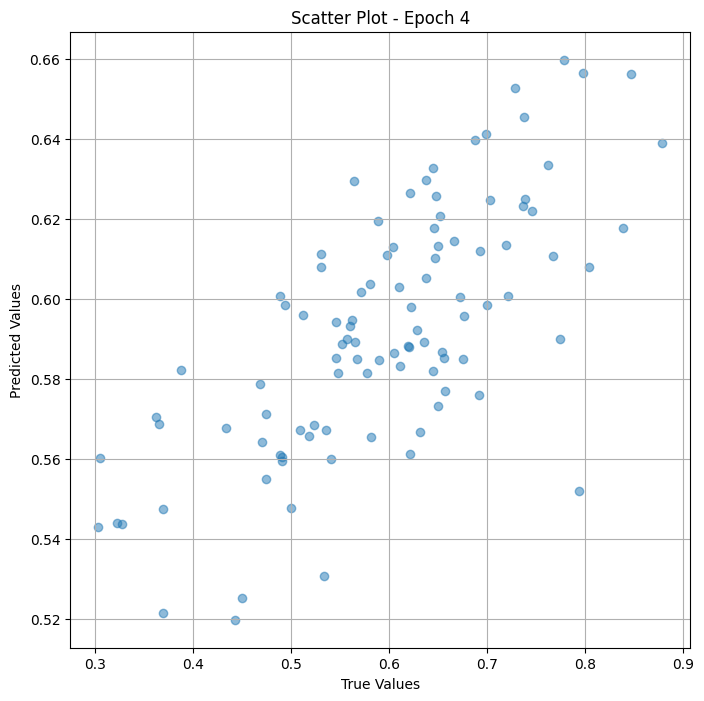

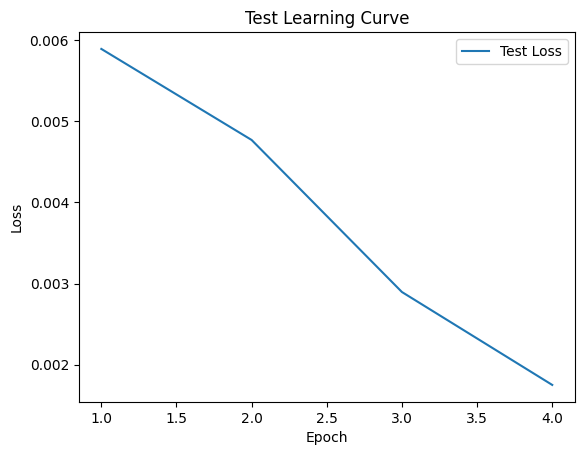


 Epoch: (5/50) Loss = 0.0009996776934713125

 Epoch: (5/50) Loss_rmse = 0.031617678701877594

 Epoch: (5/50) R^2 = 0.8038060069084167

 Epoch: (5/50) MAE = 0.021367691457271576
Spearman correlation coefficient: SignificanceResult(statistic=0.8042715970857607, pvalue=5.758414147413415e-23)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.644

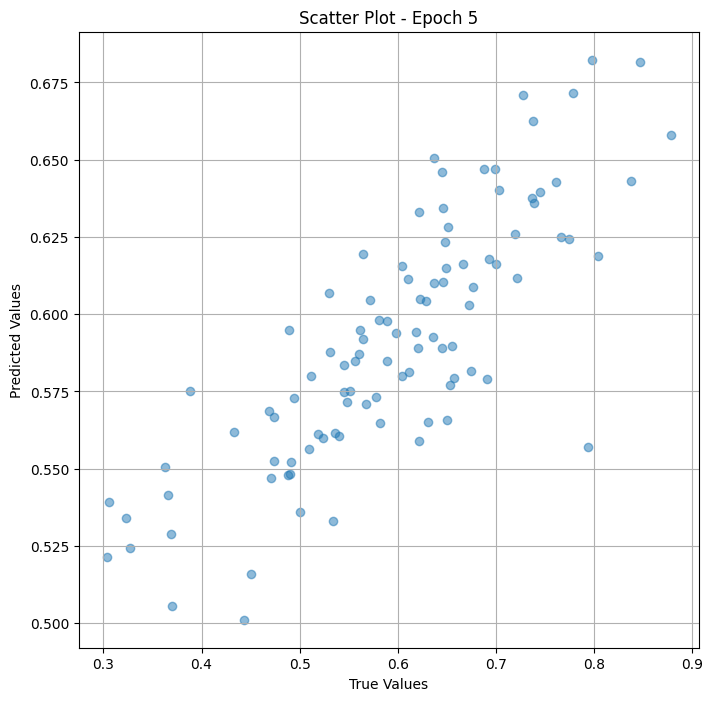

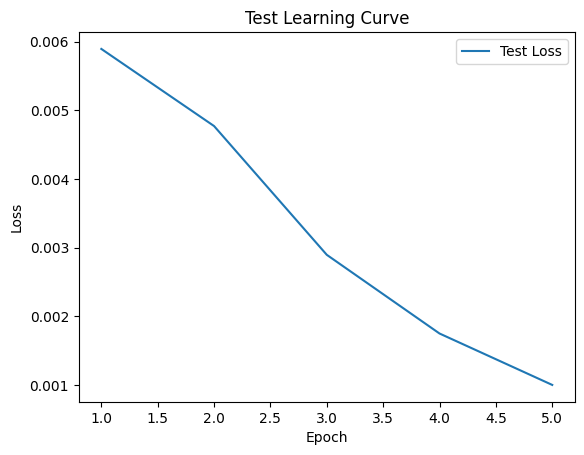


 Epoch: (6/50) Loss = 0.00047588266897946596

 Epoch: (6/50) Loss_rmse = 0.021814735606312752

 Epoch: (6/50) R^2 = 0.9066045880317688

 Epoch: (6/50) MAE = 0.017308145761489868
Spearman correlation coefficient: SignificanceResult(statistic=0.864615196813137, pvalue=7.539854139684188e-30)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.644

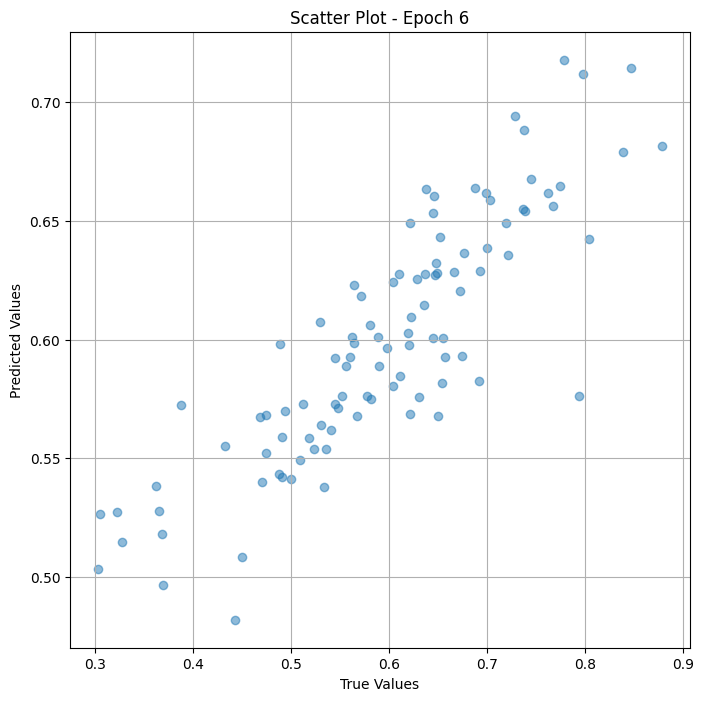

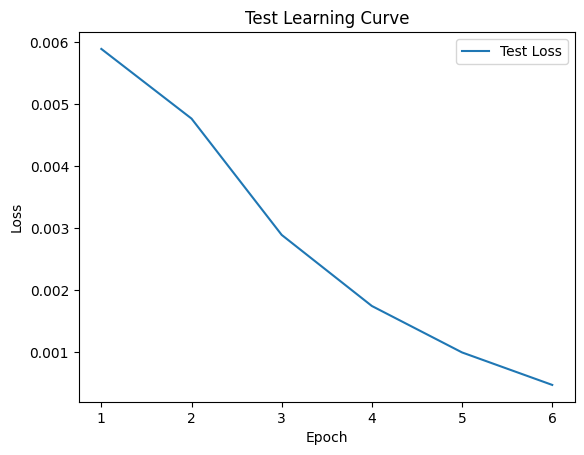


 Epoch: (7/50) Loss = 0.00013648511958308518

 Epoch: (7/50) Loss_rmse = 0.011682684533298016

 Epoch: (7/50) R^2 = 0.973213791847229

 Epoch: (7/50) MAE = 0.009317293763160706
Spearman correlation coefficient: SignificanceResult(statistic=0.8981002313027467, pvalue=2.66046788294575e-35)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.6447

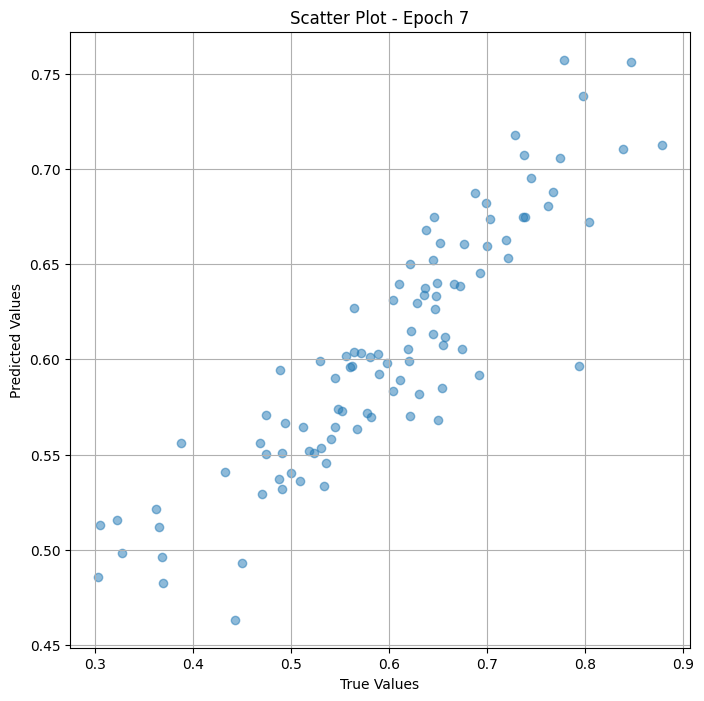

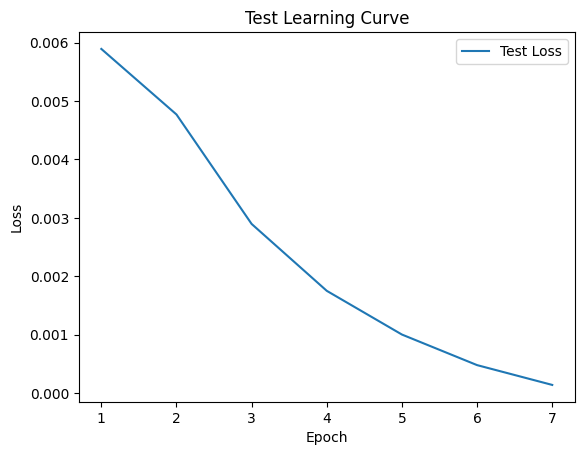


 Epoch: (8/50) Loss = 5.853485617990373e-06

 Epoch: (8/50) Loss_rmse = 0.0024193977005779743

 Epoch: (8/50) R^2 = 0.9988512396812439

 Epoch: (8/50) MAE = 0.001660771667957306
Spearman correlation coefficient: SignificanceResult(statistic=0.9259626015039452, pvalue=1.5471465840435346e-41)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.6

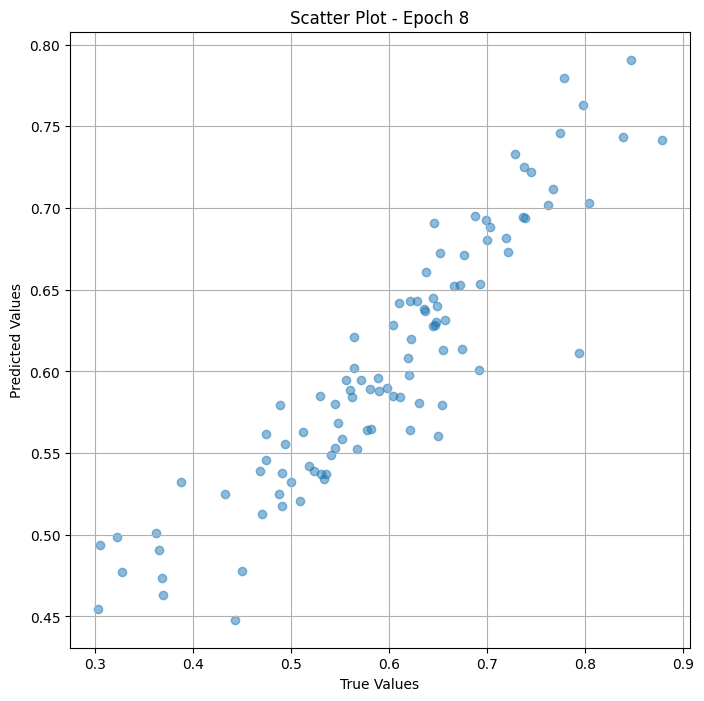

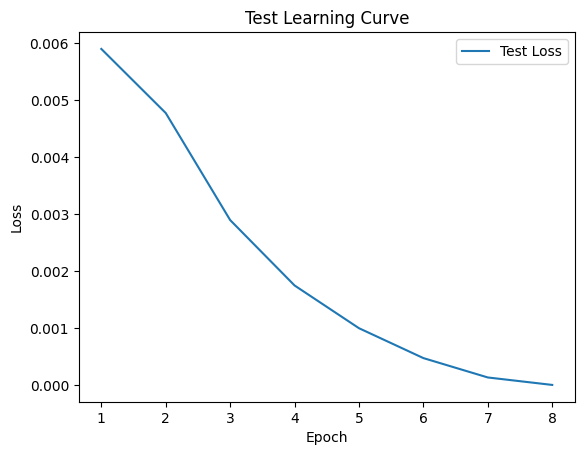


 Epoch: (9/50) Loss = 2.2425272618420422e-05

 Epoch: (9/50) Loss_rmse = 0.004735533148050308

 Epoch: (9/50) R^2 = 0.9955988526344299

 Epoch: (9/50) MAE = 0.004232585430145264
Spearman correlation coefficient: SignificanceResult(statistic=0.9493892389613305, pvalue=4.58068380100897e-49)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.644

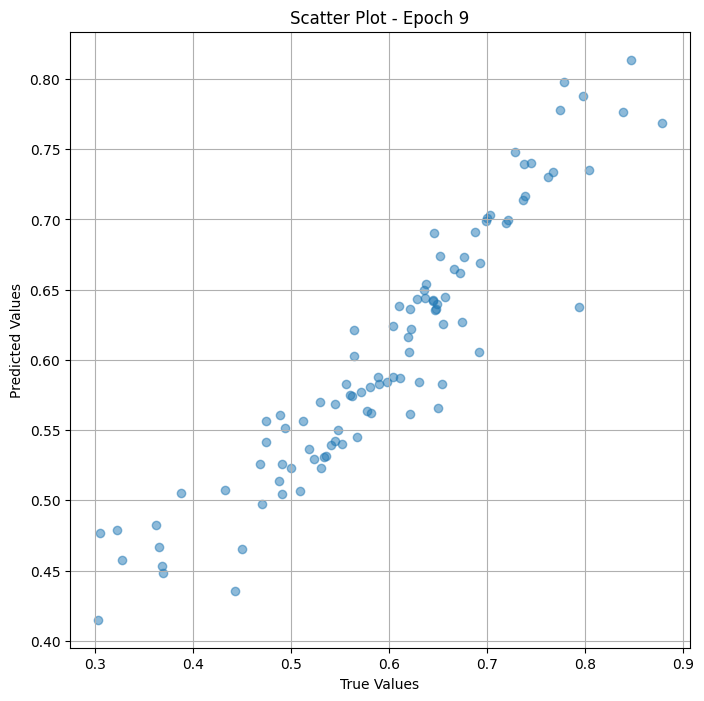

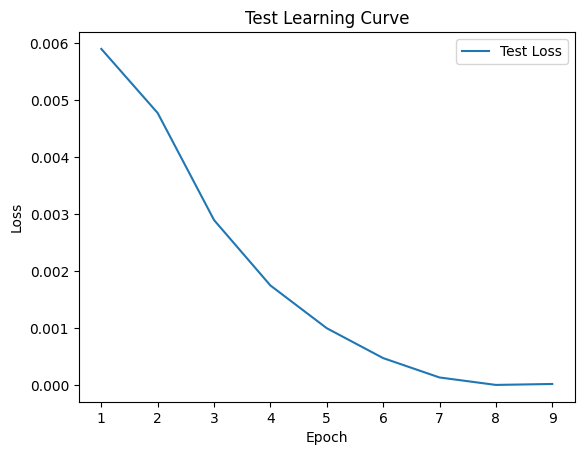


 Epoch: (10/50) Loss = 7.204028952401131e-05

 Epoch: (10/50) Loss_rmse = 0.008487654849886894

 Epoch: (10/50) R^2 = 0.985861599445343

 Epoch: (10/50) MAE = 0.006433233618736267
Spearman correlation coefficient: SignificanceResult(statistic=0.9688752636906497, pvalue=8.548323191073156e-59)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.

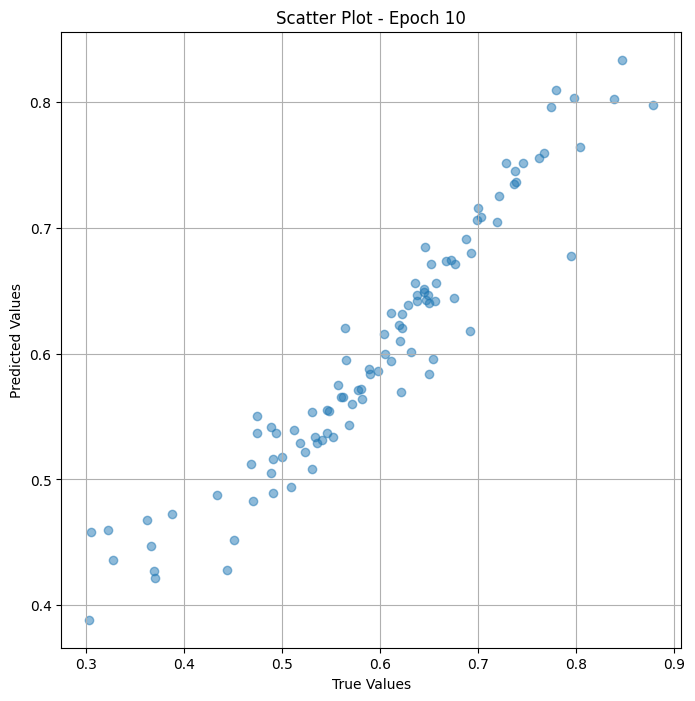

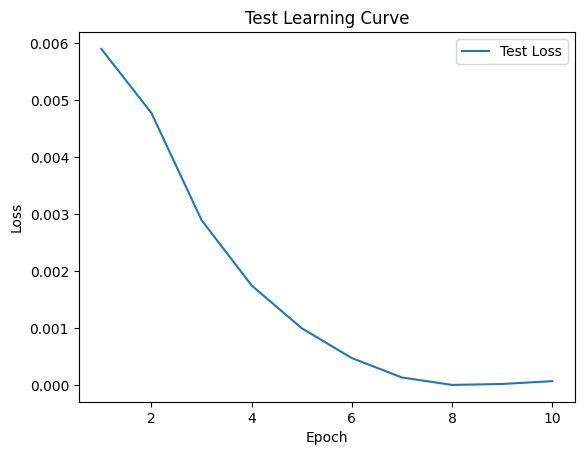

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (11/50) Loss = 4.8401088861282915e-05

 Epoch: (11/50) Loss_rmse = 0.006957089062780142

 Epoch: (11/50) R^2 = 0.9905009269714355

 Epoch: (11/50) MAE = 0.00564005970954895
Spearman correlation coefficient: SignificanceResult(statistic=0.9785402776966642, pvalue=2.741477801619297e-66)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.

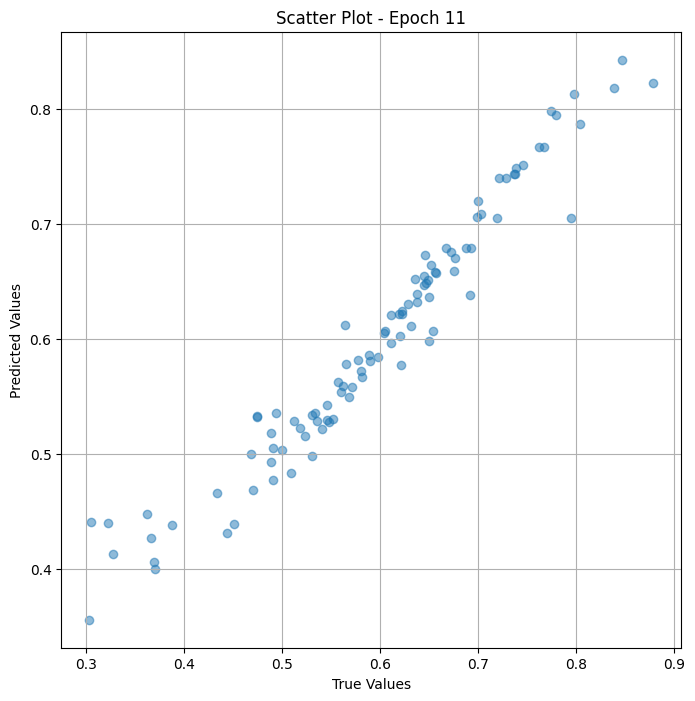

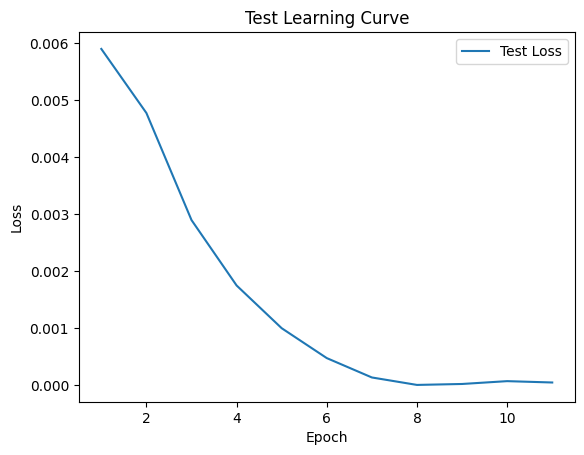


 Epoch: (12/50) Loss = 2.6855046598939225e-05

 Epoch: (12/50) Loss_rmse = 0.005182185675948858

 Epoch: (12/50) R^2 = 0.9947295188903809

 Epoch: (12/50) MAE = 0.0037954822182655334
Spearman correlation coefficient: SignificanceResult(statistic=0.9876219996293333, pvalue=1.975958354180572e-77)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

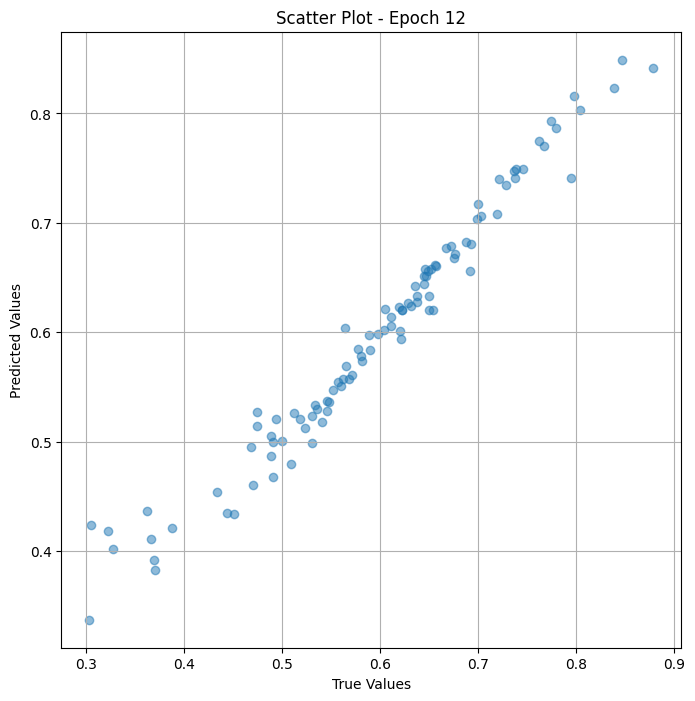

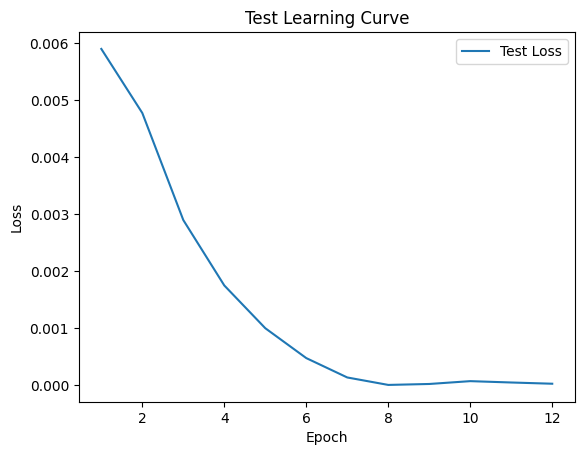


 Epoch: (13/50) Loss = 2.2766889742342755e-05

 Epoch: (13/50) Loss_rmse = 0.004771466366946697

 Epoch: (13/50) R^2 = 0.9955318570137024

 Epoch: (13/50) MAE = 0.003878675401210785
Spearman correlation coefficient: SignificanceResult(statistic=0.9900840347761285, pvalue=6.210968642680093e-82)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 

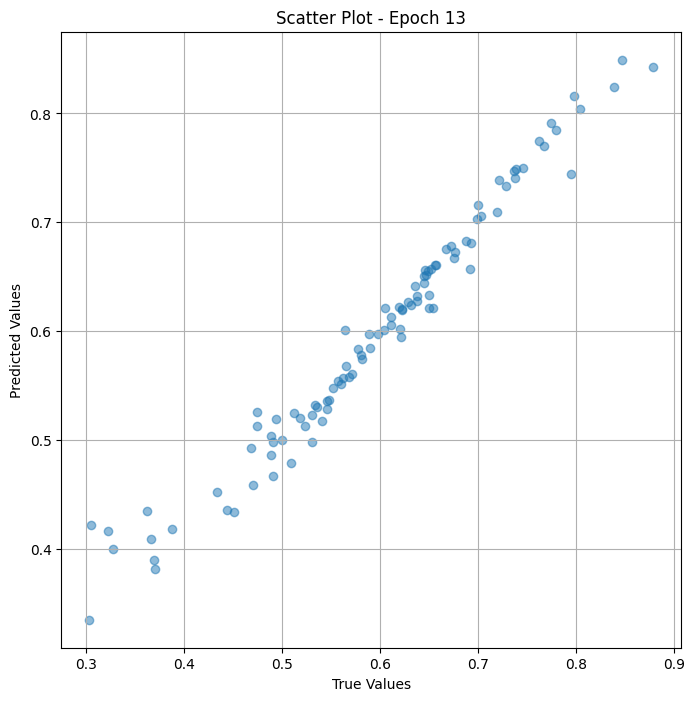

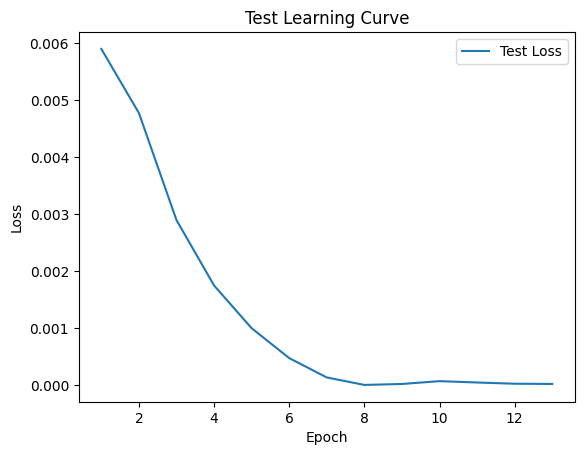

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (14/50) Loss = 1.737960337777622e-05

 Epoch: (14/50) Loss_rmse = 0.0041688852943480015

 Epoch: (14/50) R^2 = 0.9965891242027283

 Epoch: (14/50) MAE = 0.003508426249027252
Spearman correlation coefficient: SignificanceResult(statistic=0.9912709663207268, pvalue=1.5939903434604304e-84)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 

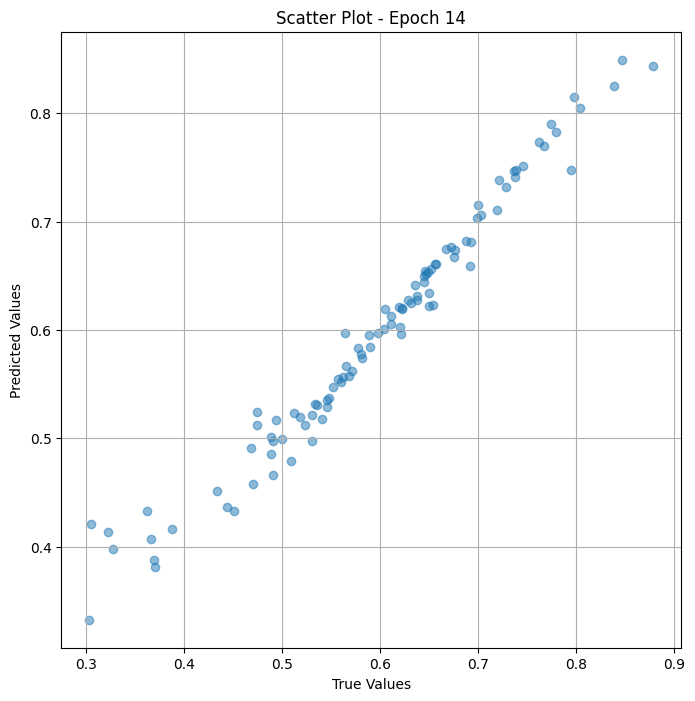

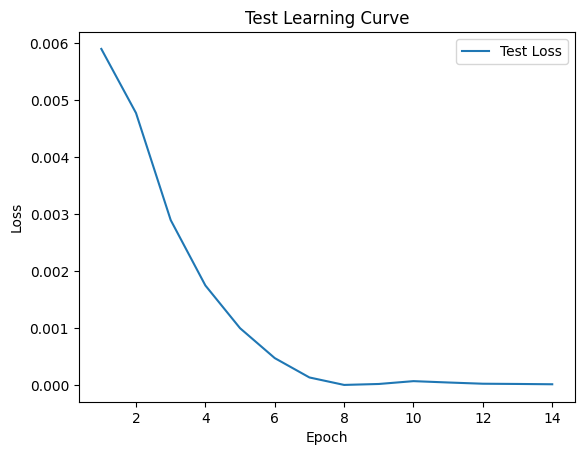


 Epoch: (15/50) Loss = 1.4791596186114475e-05

 Epoch: (15/50) Loss_rmse = 0.003845984349027276

 Epoch: (15/50) R^2 = 0.9970970153808594

 Epoch: (15/50) MAE = 0.003196932375431061
Spearman correlation coefficient: SignificanceResult(statistic=0.991894953189887, pvalue=4.951232176634272e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0

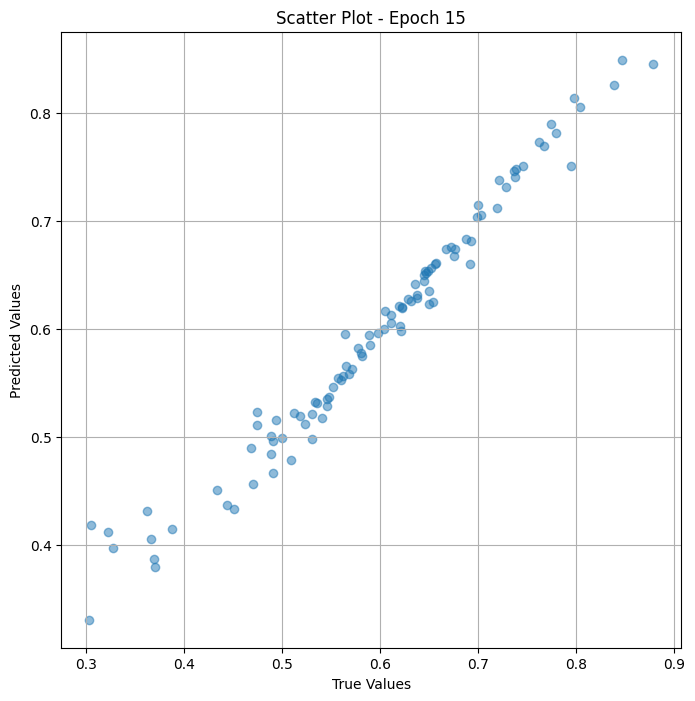

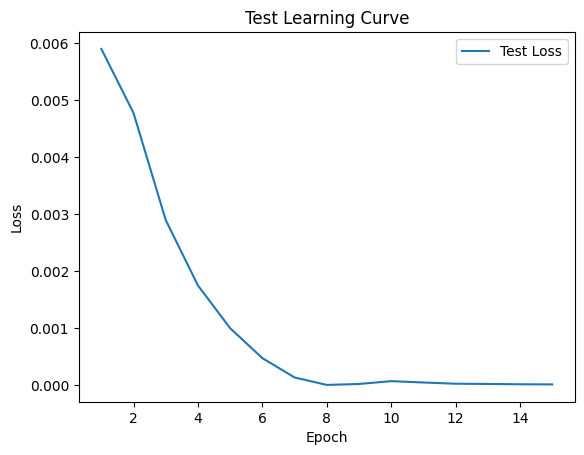


 Epoch: (16/50) Loss = 1.4058338820177596e-05

 Epoch: (16/50) Loss_rmse = 0.003749445080757141

 Epoch: (16/50) R^2 = 0.9972409605979919

 Epoch: (16/50) MAE = 0.0030931979417800903
Spearman correlation coefficient: SignificanceResult(statistic=0.991894953189887, pvalue=4.951232176634272e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 

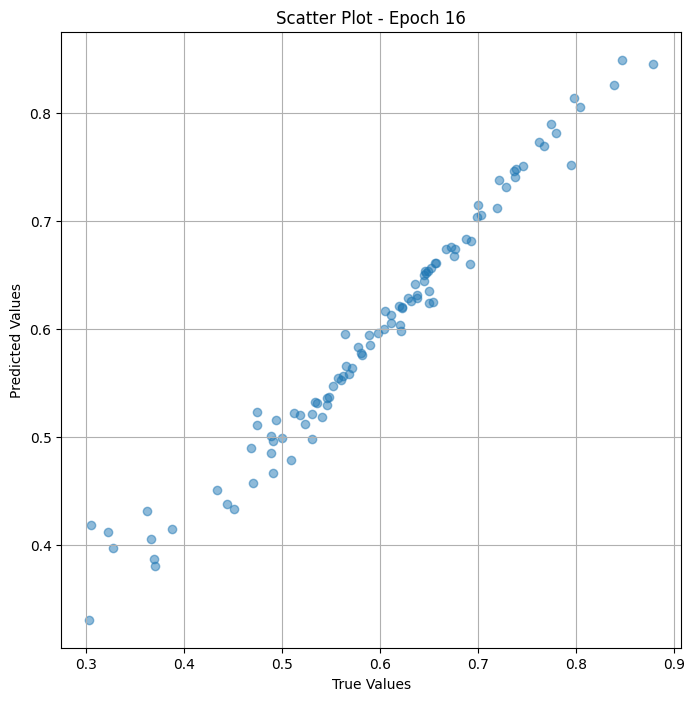

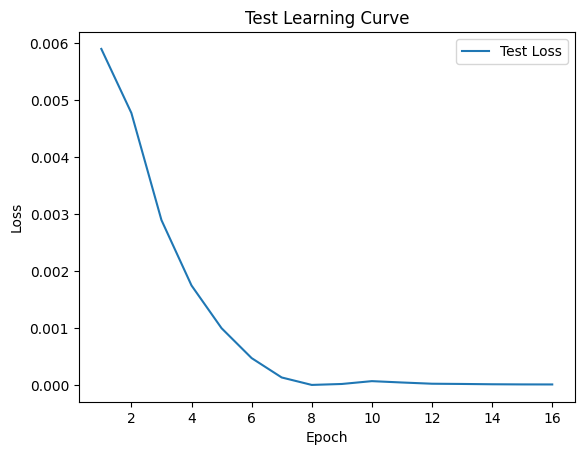

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (17/50) Loss = 1.3310117537912447e-05

 Epoch: (17/50) Loss_rmse = 0.0036483034491539

 Epoch: (17/50) R^2 = 0.9973877668380737

 Epoch: (17/50) MAE = 0.002977803349494934
Spearman correlation coefficient: SignificanceResult(statistic=0.991894953189887, pvalue=4.951232176634272e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.53

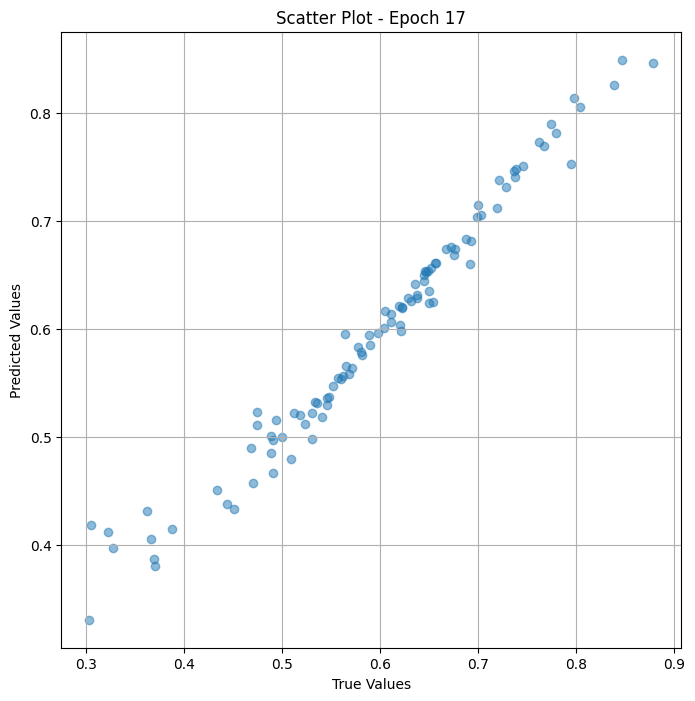

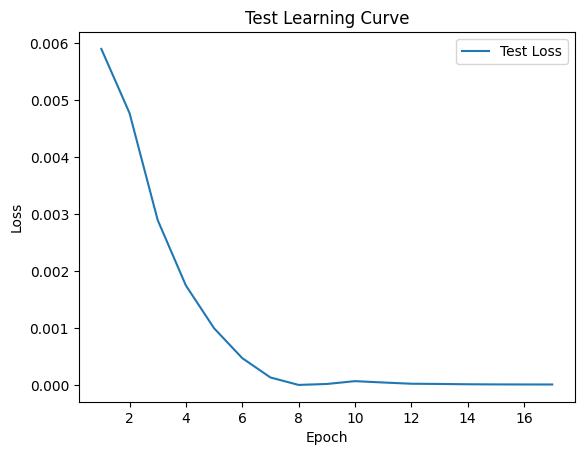


 Epoch: (18/50) Loss = 1.3030270565650426e-05

 Epoch: (18/50) Loss_rmse = 0.0036097466945648193

 Epoch: (18/50) R^2 = 0.9974427223205566

 Epoch: (18/50) MAE = 0.002932809293270111
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

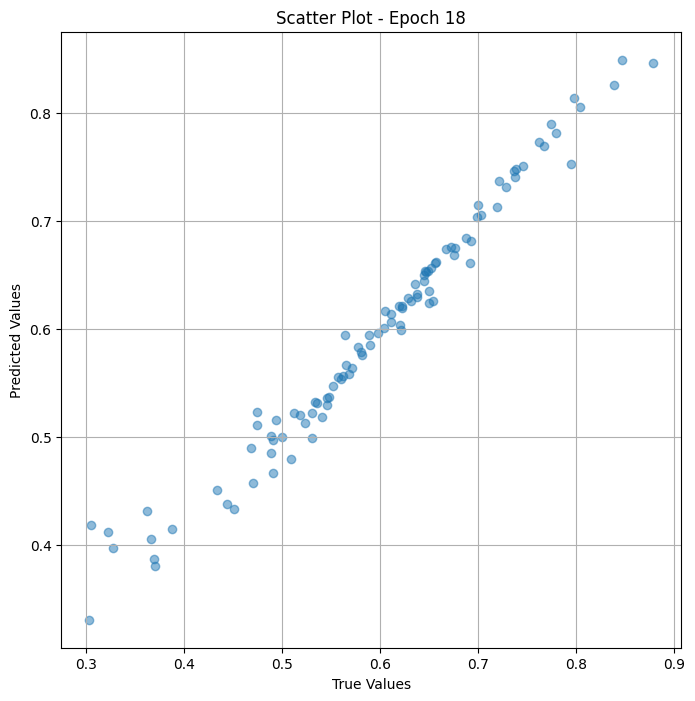

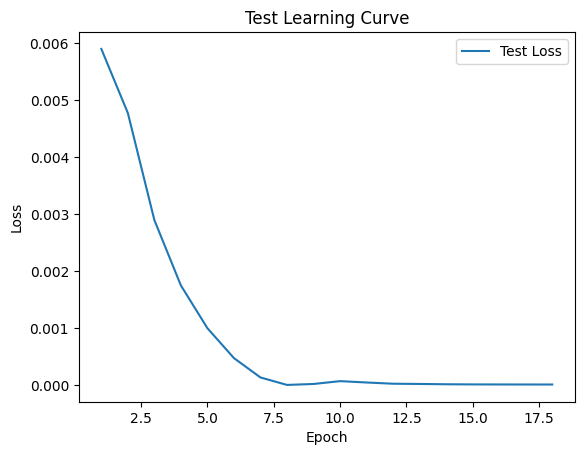


 Epoch: (19/50) Loss = 1.2960559615748934e-05

 Epoch: (19/50) Loss_rmse = 0.0036000777035951614

 Epoch: (19/50) R^2 = 0.9974563717842102

 Epoch: (19/50) MAE = 0.0029213950037956238
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

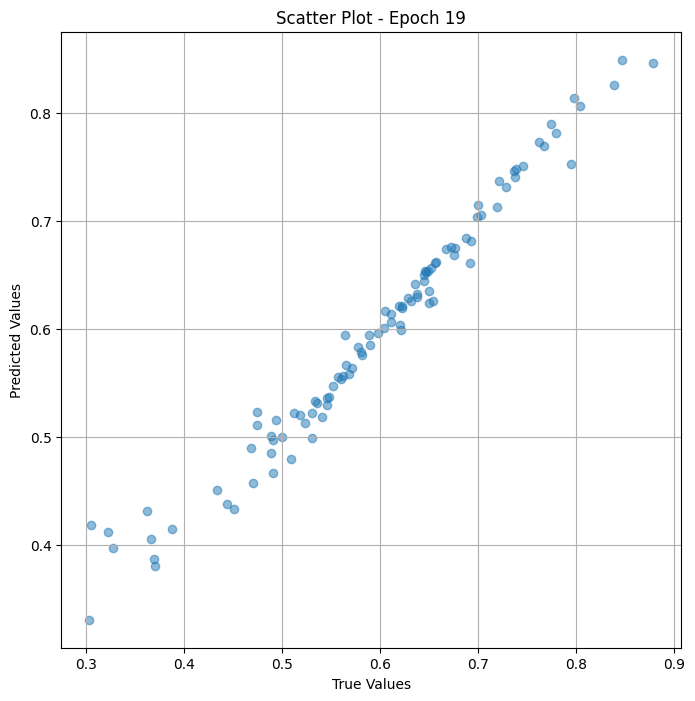

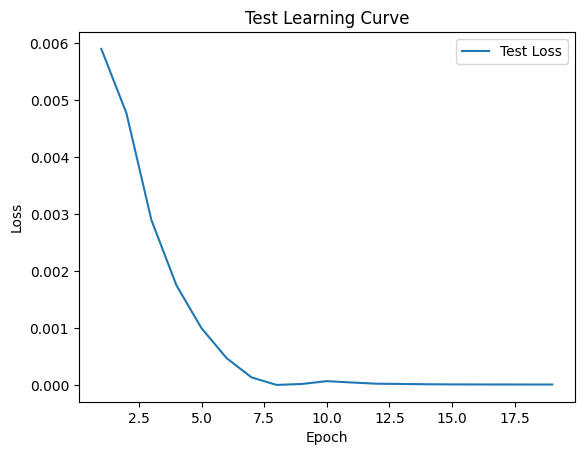

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (20/50) Loss = 1.2890514881291892e-05

 Epoch: (20/50) Loss_rmse = 0.003590336302295327

 Epoch: (20/50) R^2 = 0.9974701404571533

 Epoch: (20/50) MAE = 0.0029098689556121826
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 

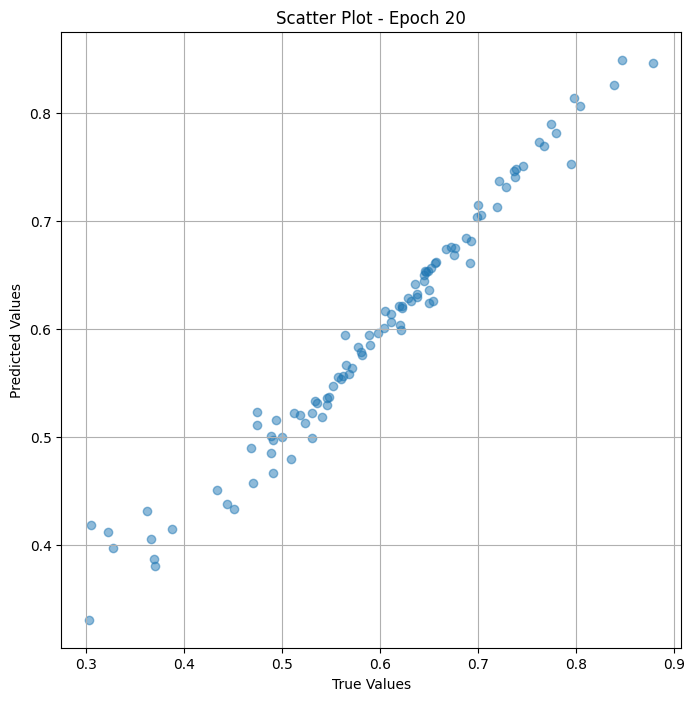

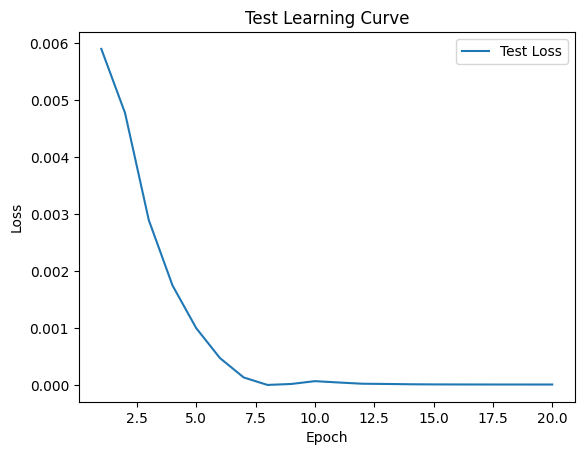


 Epoch: (21/50) Loss = 1.2866580618720036e-05

 Epoch: (21/50) Loss_rmse = 0.0035870017018169165

 Epoch: (21/50) R^2 = 0.9974748492240906

 Epoch: (21/50) MAE = 0.0029059574007987976
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

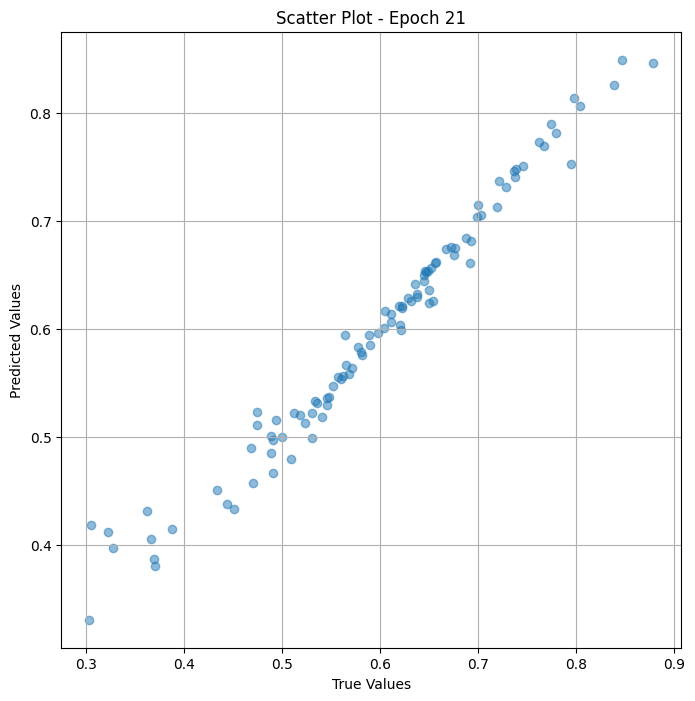

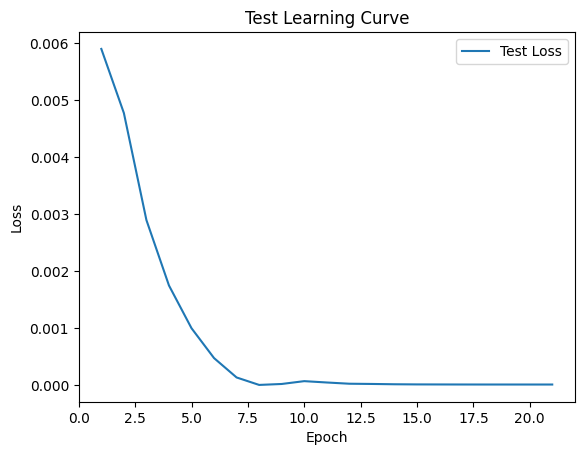


 Epoch: (22/50) Loss = 1.286398219235707e-05

 Epoch: (22/50) Loss_rmse = 0.003586639417335391

 Epoch: (22/50) R^2 = 0.9974753260612488

 Epoch: (22/50) MAE = 0.002905532717704773
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0

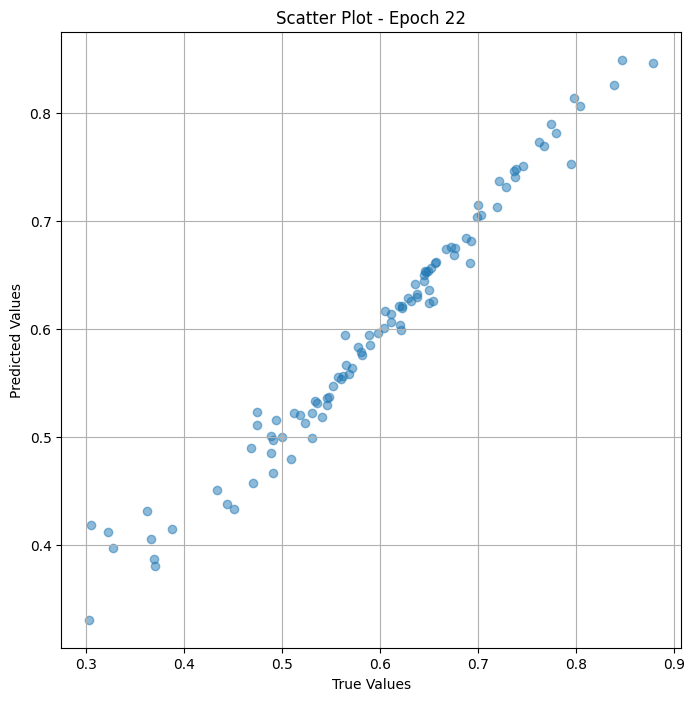

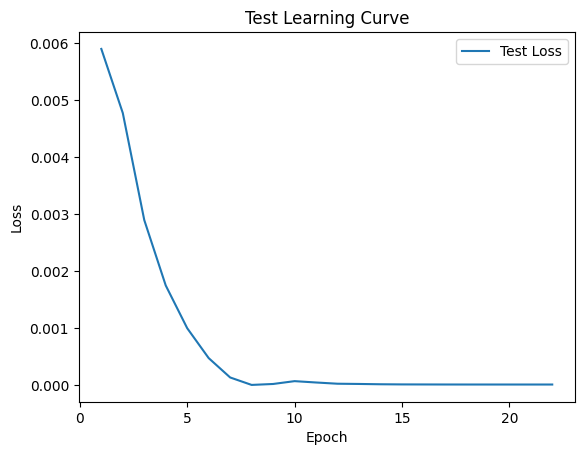


 Epoch: (23/50) Loss = 1.286172482650727e-05

 Epoch: (23/50) Loss_rmse = 0.003586324630305171

 Epoch: (23/50) R^2 = 0.997475802898407

 Epoch: (23/50) MAE = 0.00290515273809433
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.6

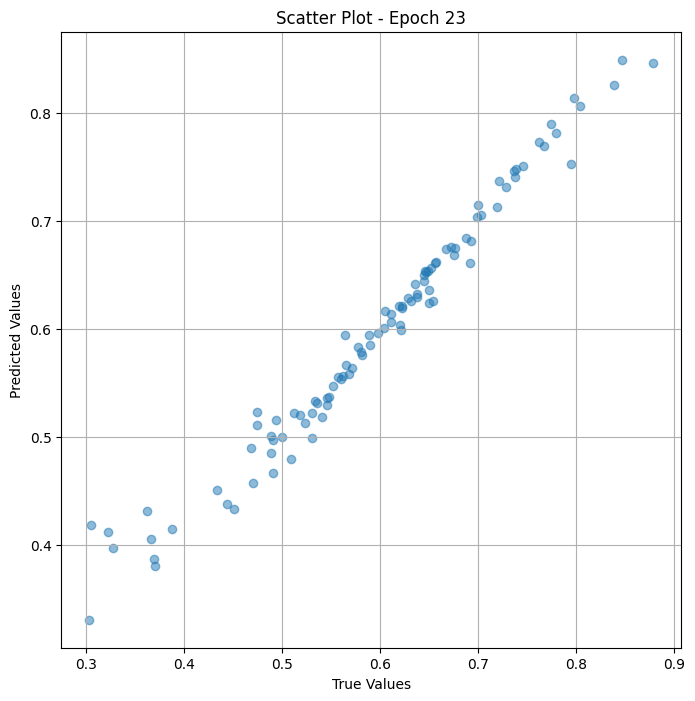

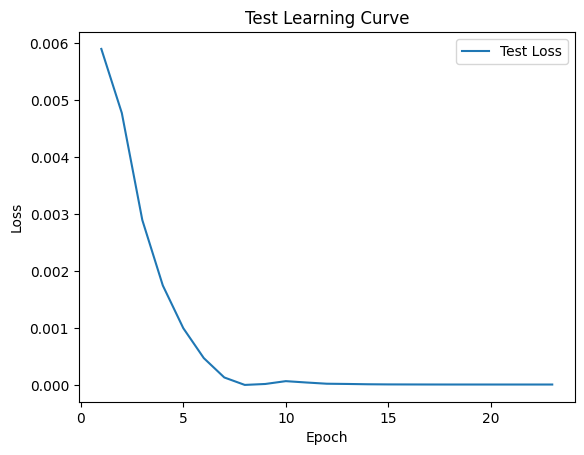


 Epoch: (24/50) Loss = 1.285918551729992e-05

 Epoch: (24/50) Loss_rmse = 0.003585970727726817

 Epoch: (24/50) R^2 = 0.9974762797355652

 Epoch: (24/50) MAE = 0.002904735505580902
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0

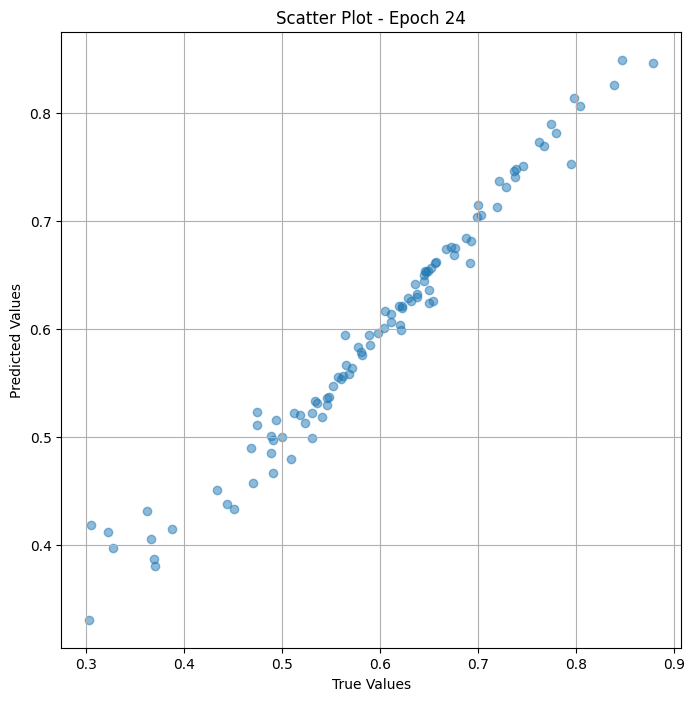

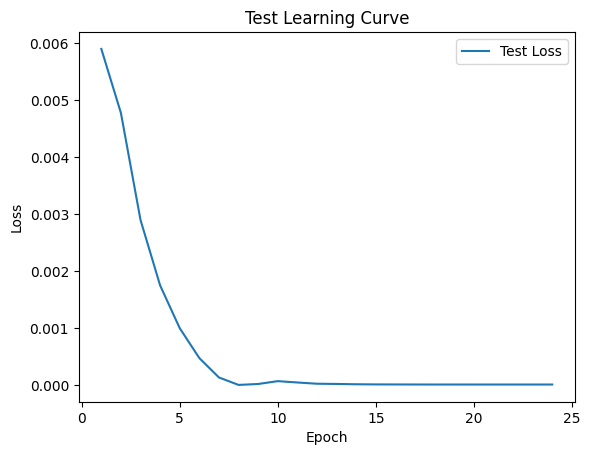


 Epoch: (25/50) Loss = 1.2856581633968744e-05

 Epoch: (25/50) Loss_rmse = 0.003585607511922717

 Epoch: (25/50) R^2 = 0.9974768161773682

 Epoch: (25/50) MAE = 0.0029042959213256836
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

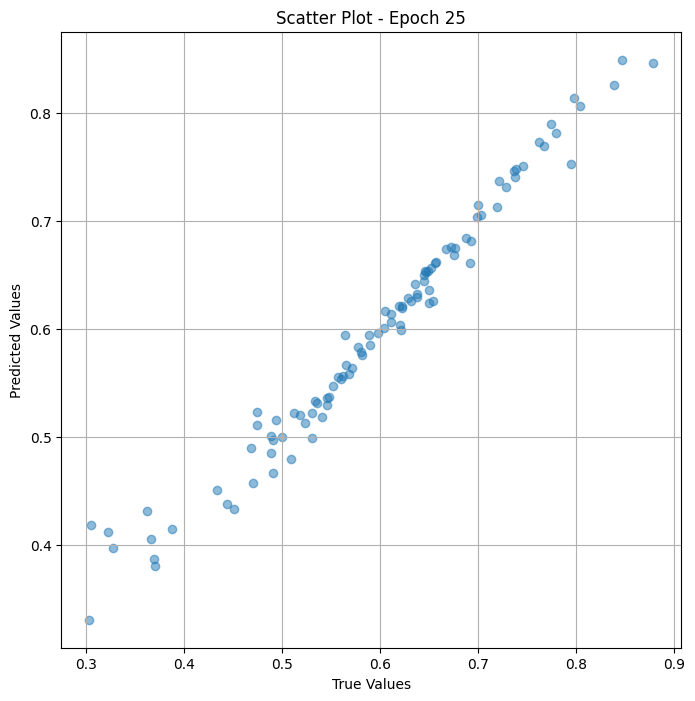

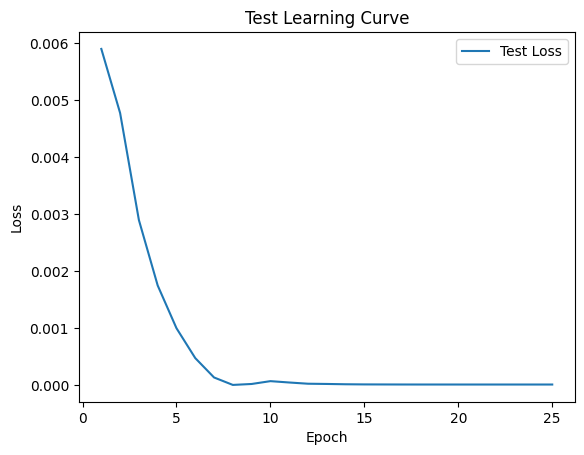


 Epoch: (26/50) Loss = 1.2854010492446832e-05

 Epoch: (26/50) Loss_rmse = 0.00358524895273149

 Epoch: (26/50) R^2 = 0.9974772930145264

 Epoch: (26/50) MAE = 0.002903878688812256
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0

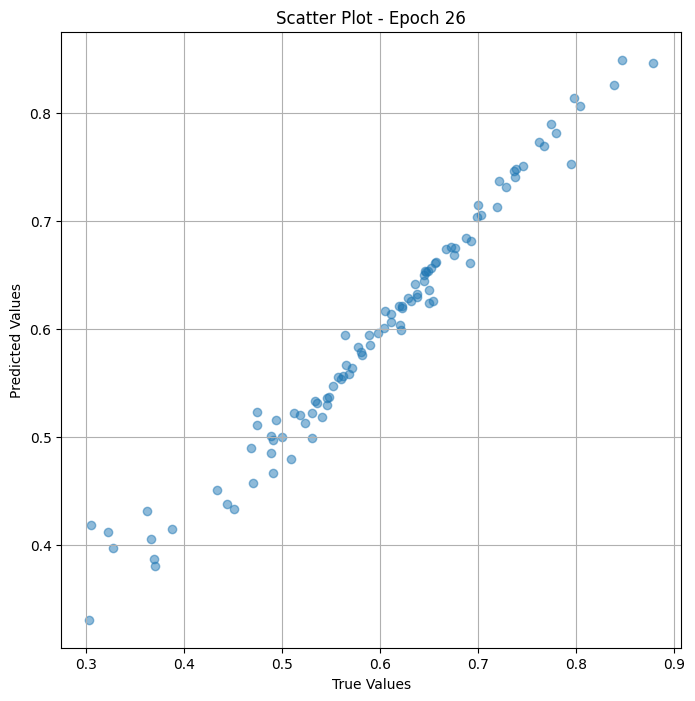

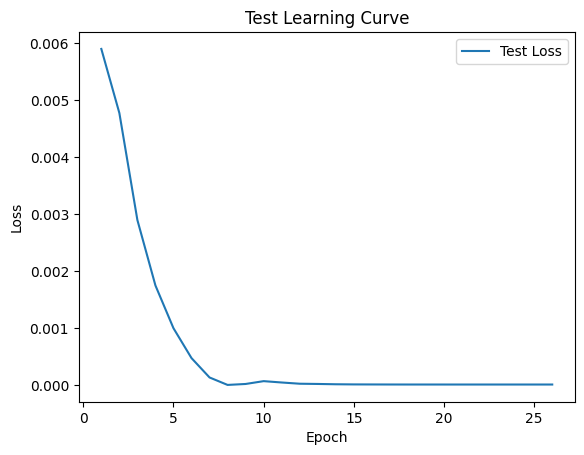


 Epoch: (27/50) Loss = 1.2851120118284598e-05

 Epoch: (27/50) Loss_rmse = 0.0035848459228873253

 Epoch: (27/50) R^2 = 0.9974778890609741

 Epoch: (27/50) MAE = 0.0029034018516540527
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

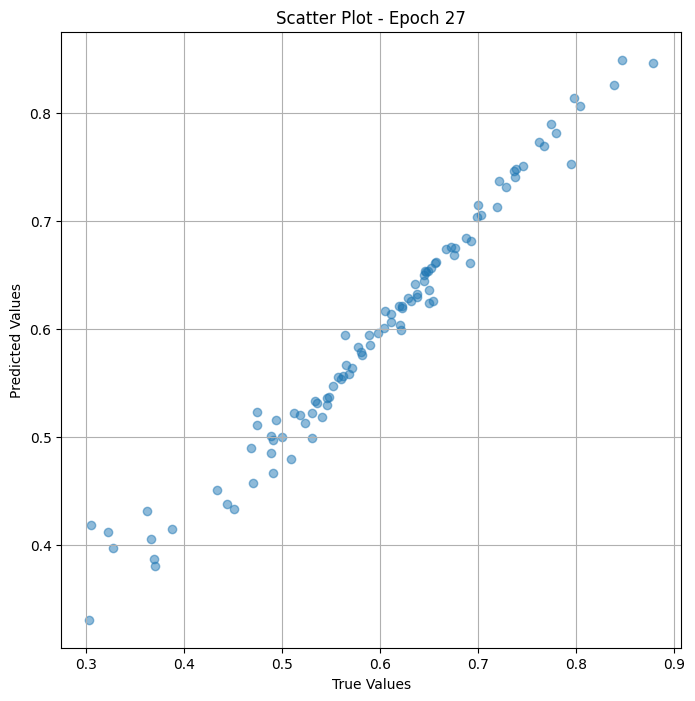

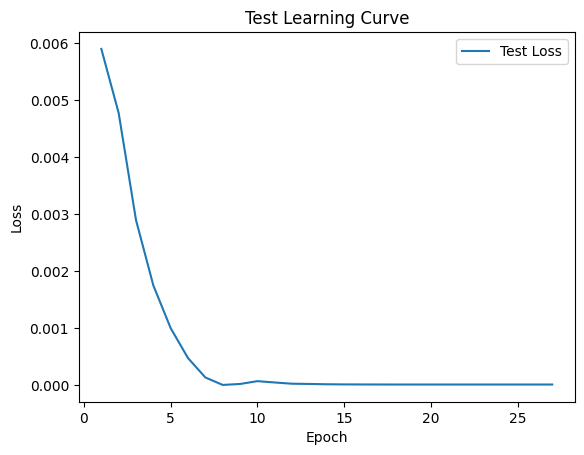


 Epoch: (28/50) Loss = 1.2848313417634927e-05

 Epoch: (28/50) Loss_rmse = 0.0035844543017446995

 Epoch: (28/50) R^2 = 0.9974784255027771

 Epoch: (28/50) MAE = 0.0029029324650764465
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

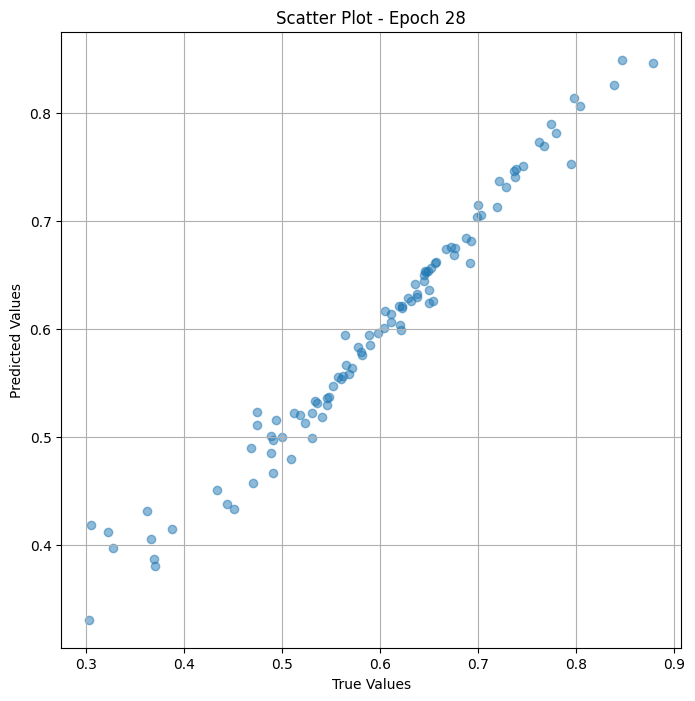

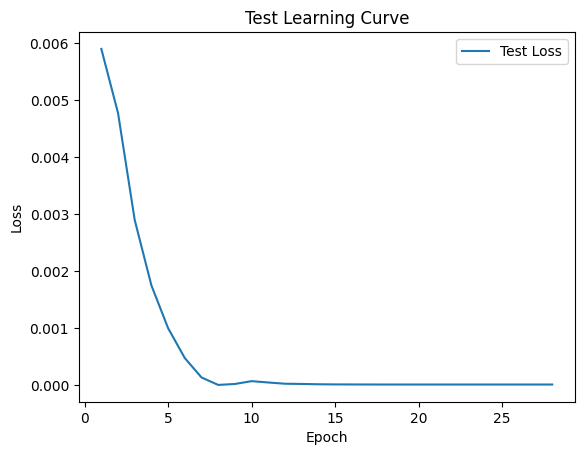


 Epoch: (29/50) Loss = 1.2845348464907147e-05

 Epoch: (29/50) Loss_rmse = 0.00358404079452157

 Epoch: (29/50) R^2 = 0.9974790215492249

 Epoch: (29/50) MAE = 0.0029024481773376465
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 

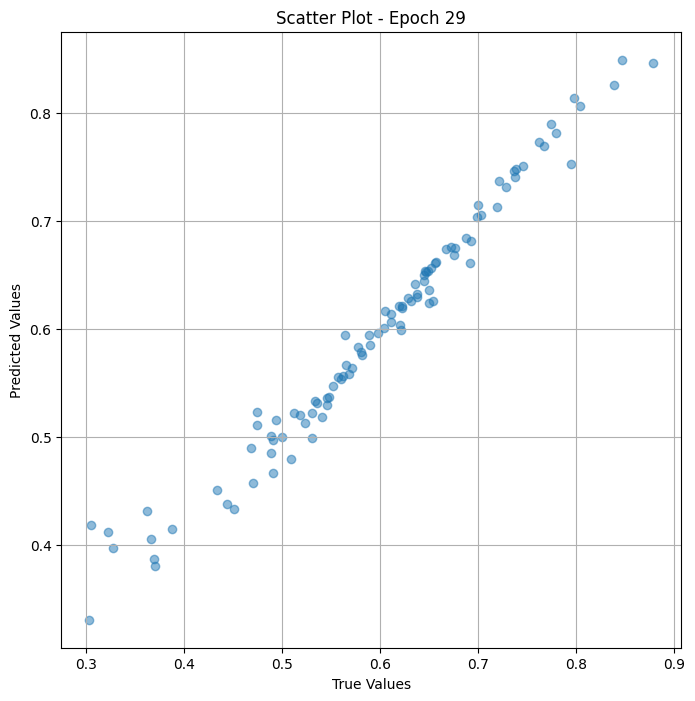

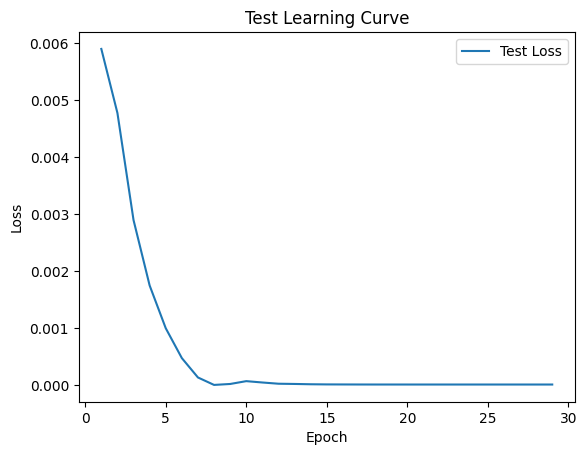


 Epoch: (30/50) Loss = 1.2842370779253542e-05

 Epoch: (30/50) Loss_rmse = 0.0035836254246532917

 Epoch: (30/50) R^2 = 0.9974796175956726

 Epoch: (30/50) MAE = 0.0029019713401794434
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

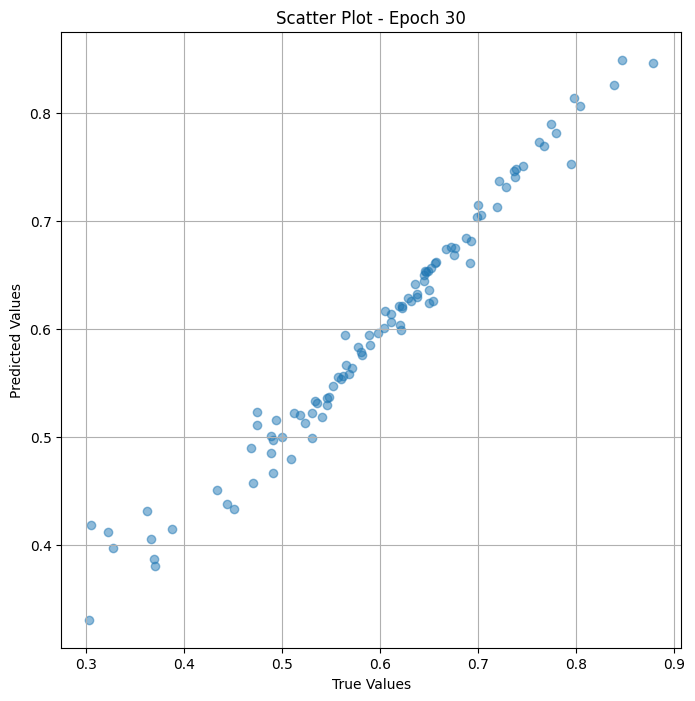

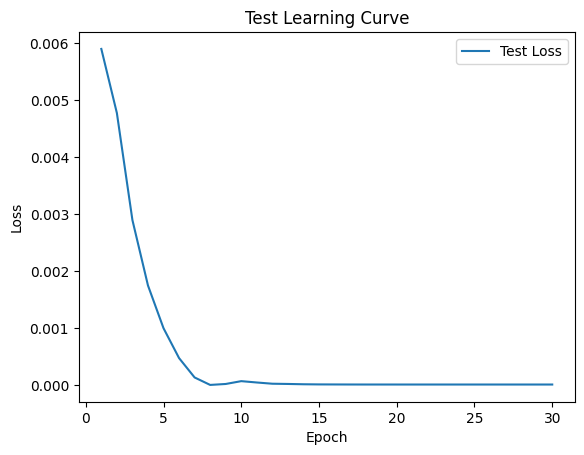


 Epoch: (31/50) Loss = 1.28393221530132e-05

 Epoch: (31/50) Loss_rmse = 0.003583200043067336

 Epoch: (31/50) R^2 = 0.9974802136421204

 Epoch: (31/50) MAE = 0.0029014572501182556
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0

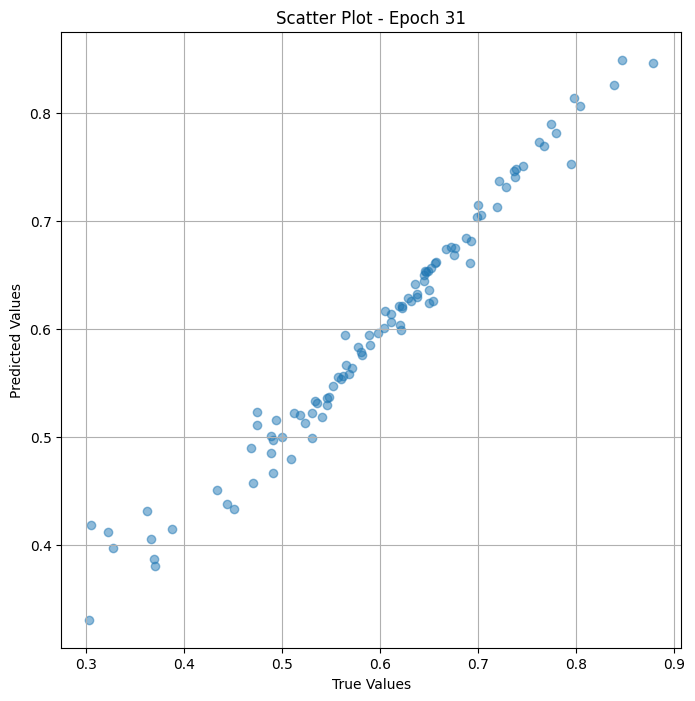

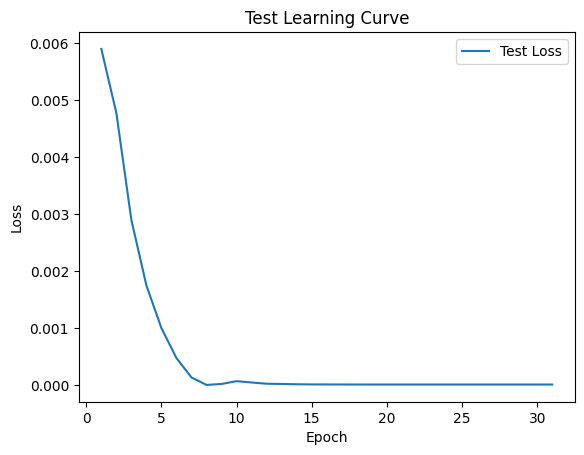


 Epoch: (32/50) Loss = 1.2836184396292083e-05

 Epoch: (32/50) Loss_rmse = 0.003582762088626623

 Epoch: (32/50) R^2 = 0.9974808096885681

 Epoch: (32/50) MAE = 0.002900920808315277
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 

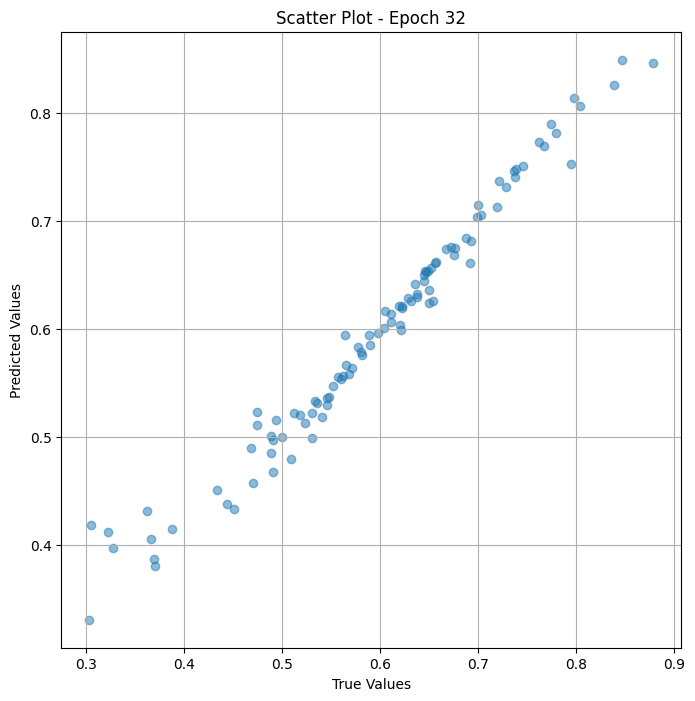

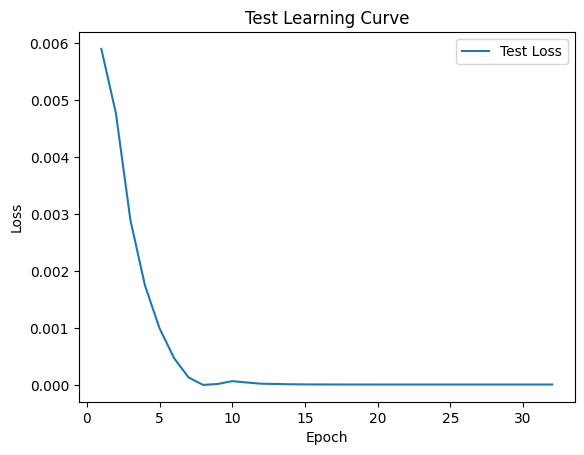


 Epoch: (33/50) Loss = 1.2833255823352374e-05

 Epoch: (33/50) Loss_rmse = 0.0035823534708470106

 Epoch: (33/50) R^2 = 0.9974814057350159

 Epoch: (33/50) MAE = 0.002900451421737671
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

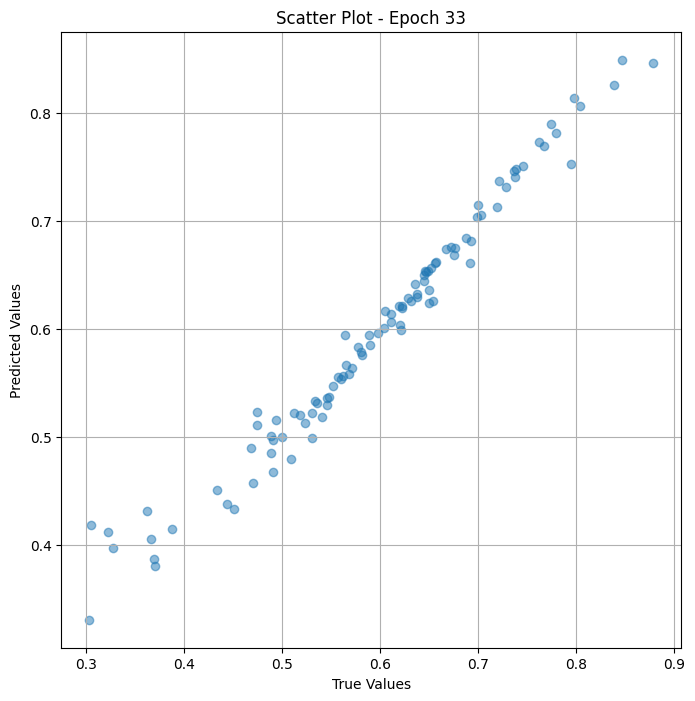

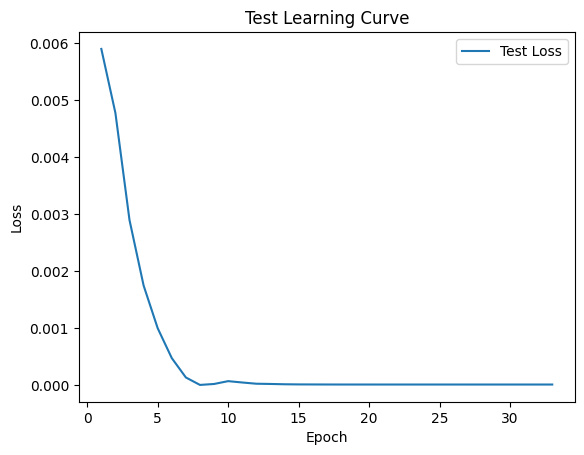


 Epoch: (34/50) Loss = 1.2830030755139887e-05

 Epoch: (34/50) Loss_rmse = 0.003581903176382184

 Epoch: (34/50) R^2 = 0.9974820017814636

 Epoch: (34/50) MAE = 0.0028999149799346924
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

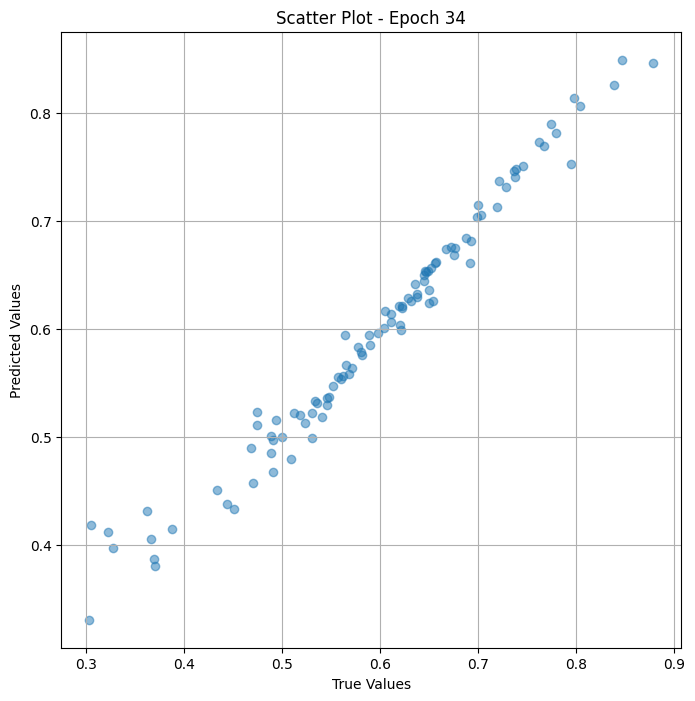

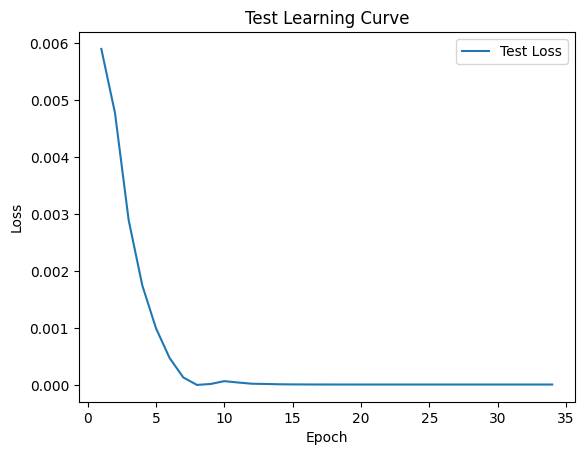


 Epoch: (35/50) Loss = 1.2827104910684284e-05

 Epoch: (35/50) Loss_rmse = 0.003581494791433215

 Epoch: (35/50) R^2 = 0.9974825978279114

 Epoch: (35/50) MAE = 0.0028994232416152954
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

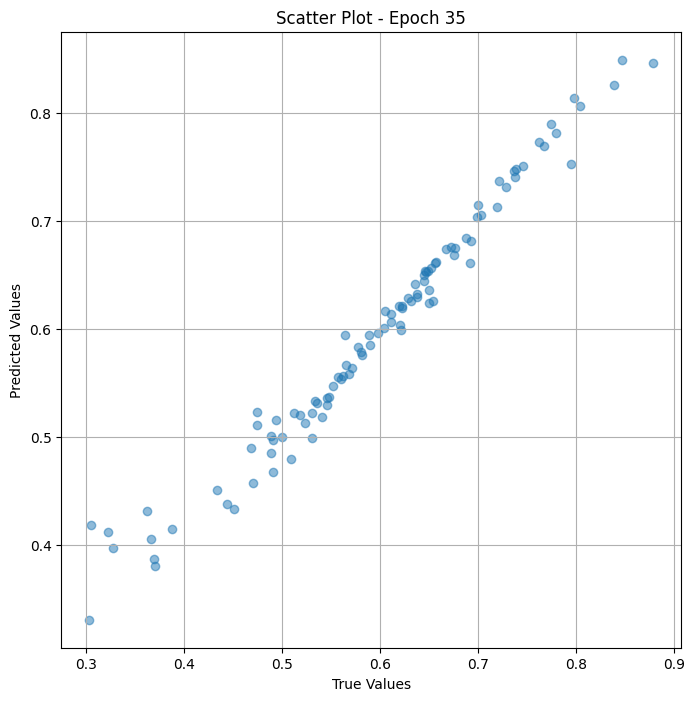

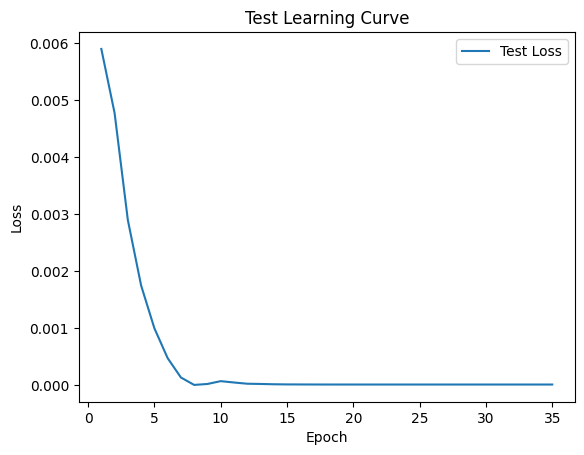


 Epoch: (36/50) Loss = 1.2823292308894452e-05

 Epoch: (36/50) Loss_rmse = 0.0035809625405818224

 Epoch: (36/50) R^2 = 0.9974833130836487

 Epoch: (36/50) MAE = 0.0028988271951675415
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

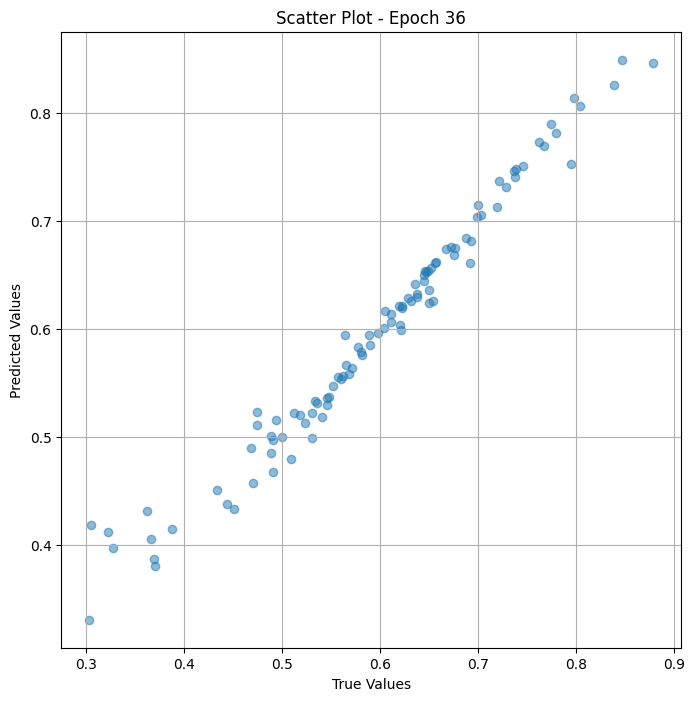

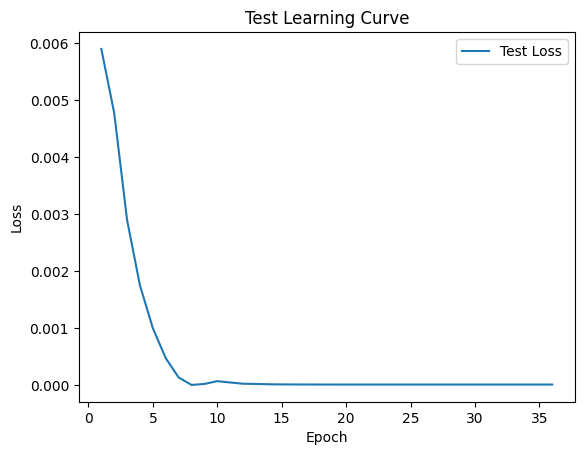


 Epoch: (37/50) Loss = 1.282019820791902e-05

 Epoch: (37/50) Loss_rmse = 0.003580530406907201

 Epoch: (37/50) R^2 = 0.9974839687347412

 Epoch: (37/50) MAE = 0.002898305654525757
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0

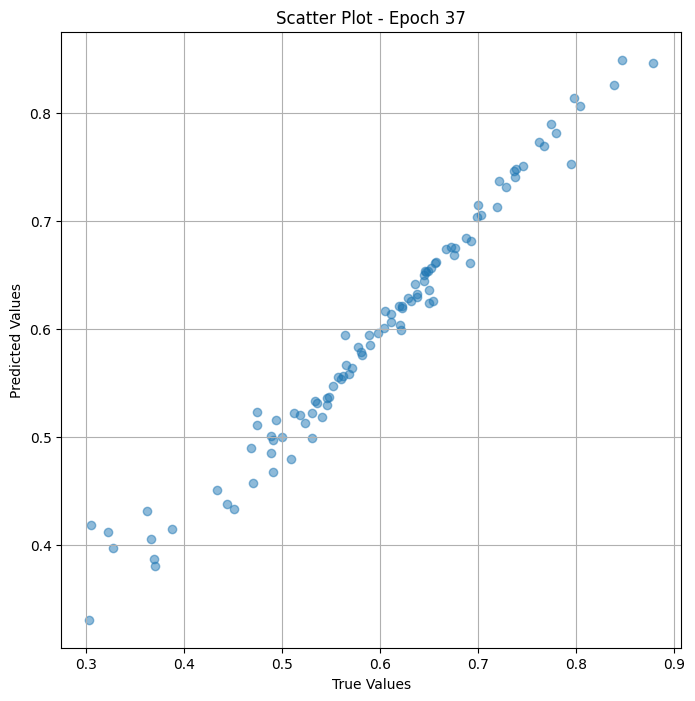

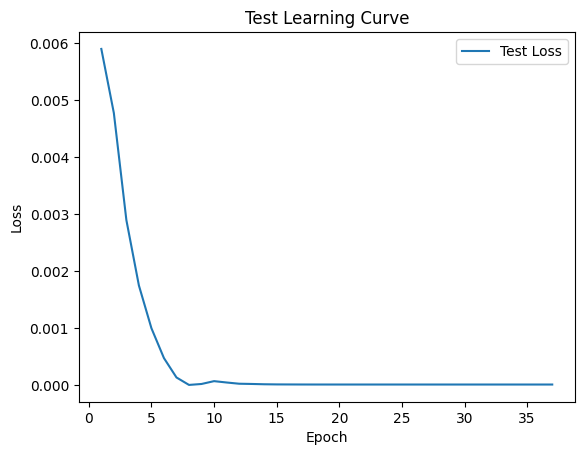


 Epoch: (38/50) Loss = 1.2816773050872143e-05

 Epoch: (38/50) Loss_rmse = 0.0035800521727651358

 Epoch: (38/50) R^2 = 0.9974846243858337

 Epoch: (38/50) MAE = 0.0028977319598197937
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

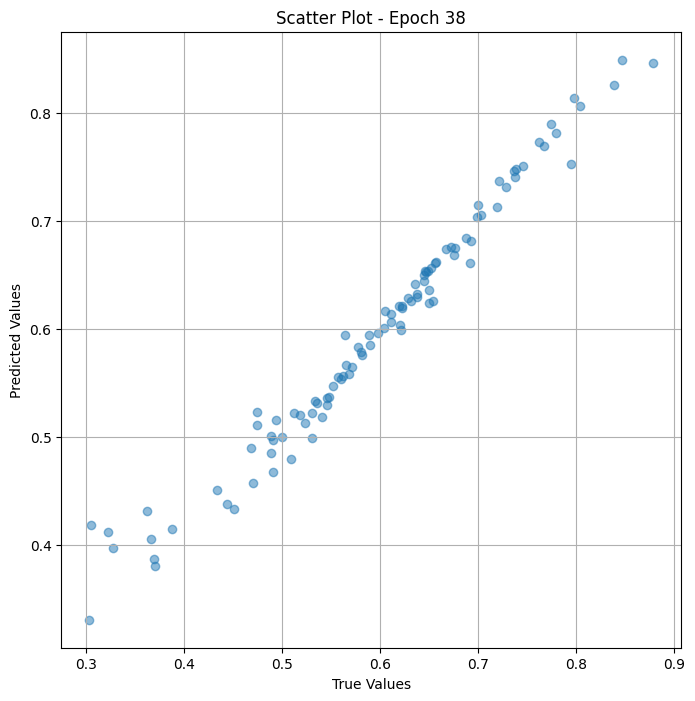

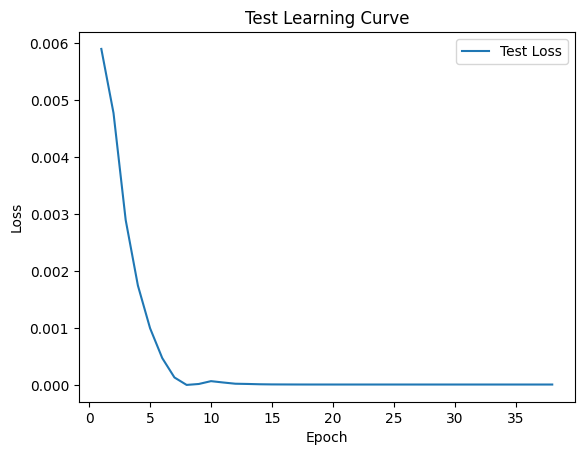


 Epoch: (39/50) Loss = 1.2812989552912768e-05

 Epoch: (39/50) Loss_rmse = 0.0035795236472040415

 Epoch: (39/50) R^2 = 0.997485339641571

 Epoch: (39/50) MAE = 0.0028970912098884583
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

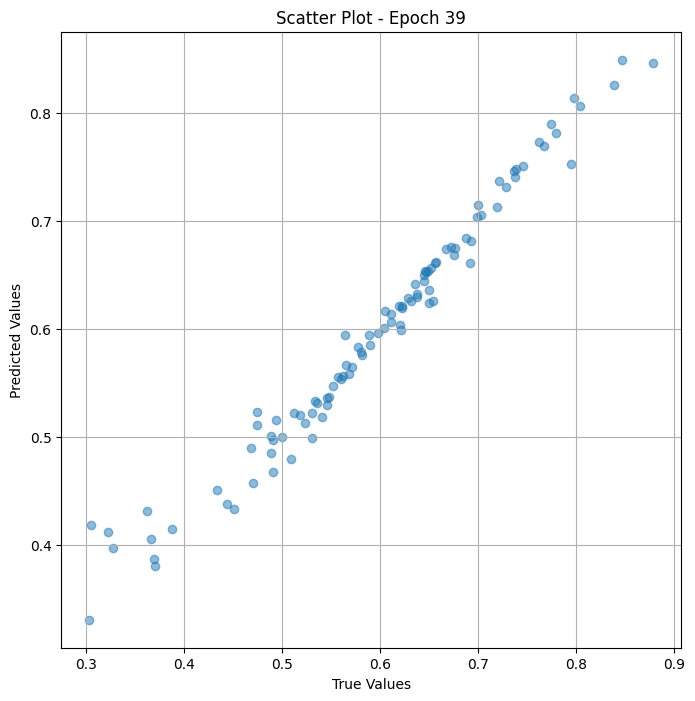

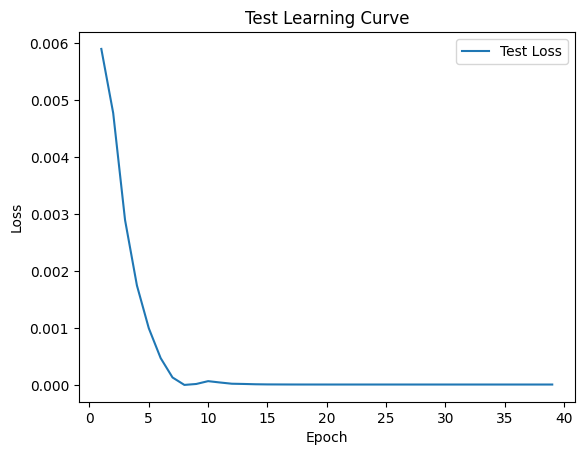


 Epoch: (40/50) Loss = 1.2809266991098411e-05

 Epoch: (40/50) Loss_rmse = 0.0035790037363767624

 Epoch: (40/50) R^2 = 0.9974861145019531

 Epoch: (40/50) MAE = 0.0028964728116989136
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

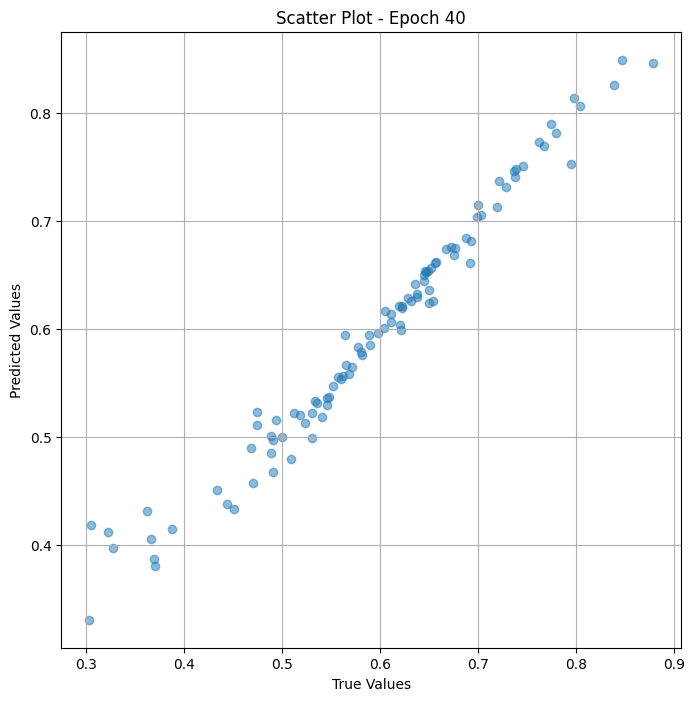

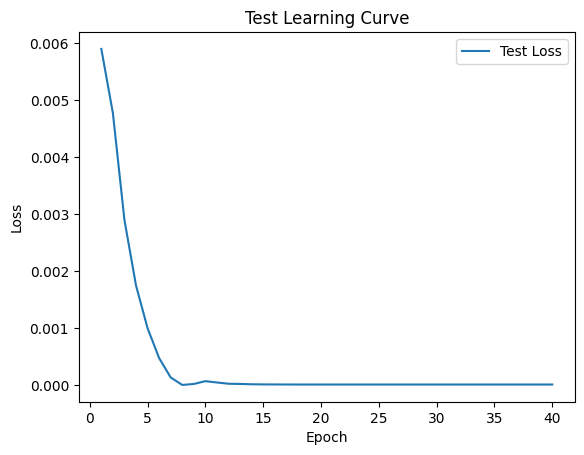


 Epoch: (41/50) Loss = 1.2805799087800551e-05

 Epoch: (41/50) Loss_rmse = 0.0035785192158073187

 Epoch: (41/50) R^2 = 0.9974867701530457

 Epoch: (41/50) MAE = 0.0028959140181541443
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

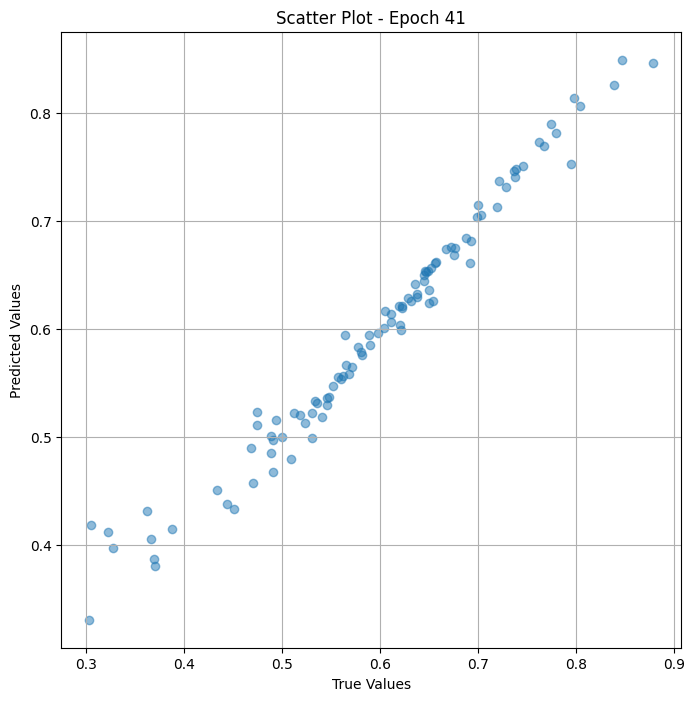

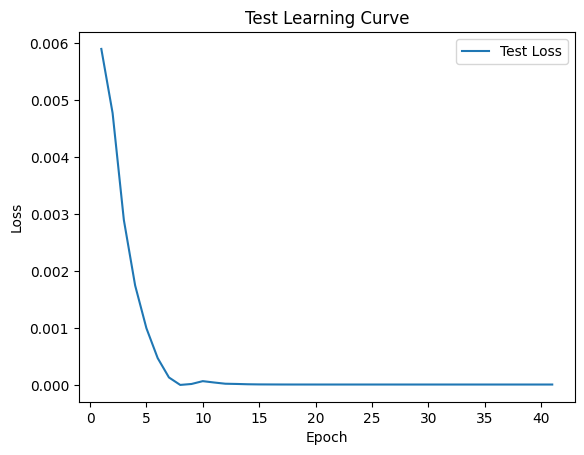


 Epoch: (42/50) Loss = 1.2801901903003454e-05

 Epoch: (42/50) Loss_rmse = 0.0035779746249318123

 Epoch: (42/50) R^2 = 0.9974875450134277

 Epoch: (42/50) MAE = 0.002895265817642212
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

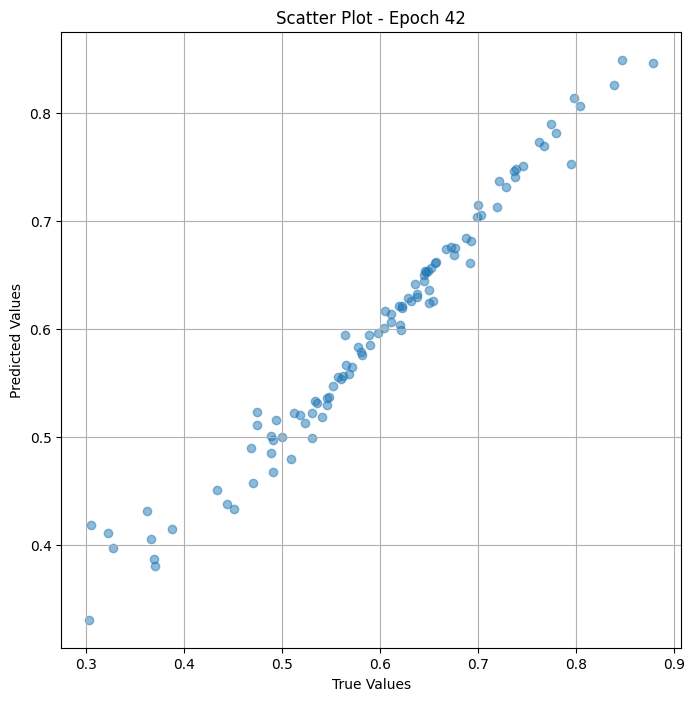

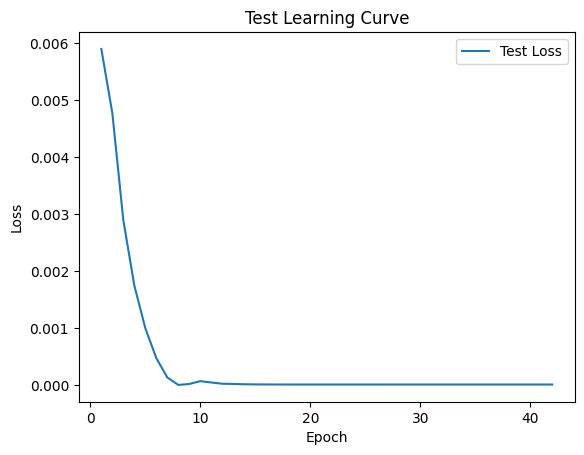


 Epoch: (43/50) Loss = 1.2798266652680468e-05

 Epoch: (43/50) Loss_rmse = 0.0035774665884673595

 Epoch: (43/50) R^2 = 0.997488260269165

 Epoch: (43/50) MAE = 0.002894677221775055
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 

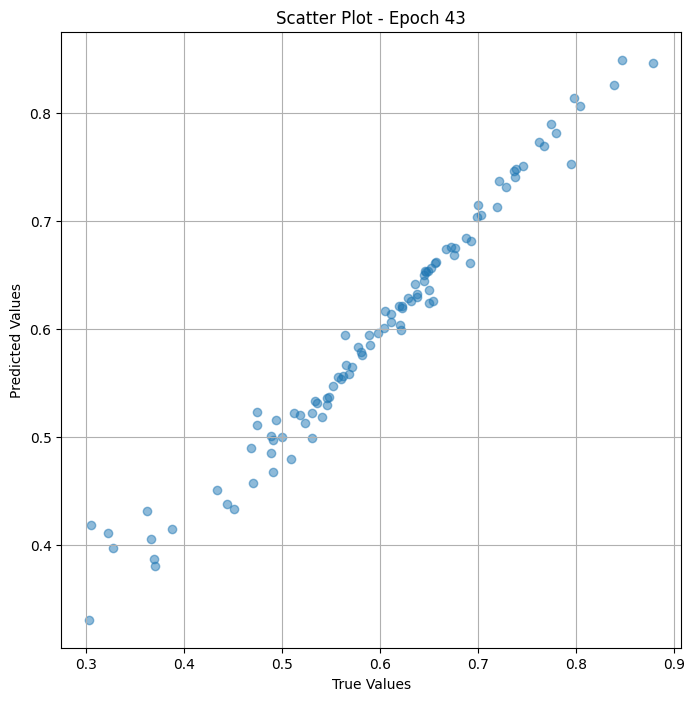

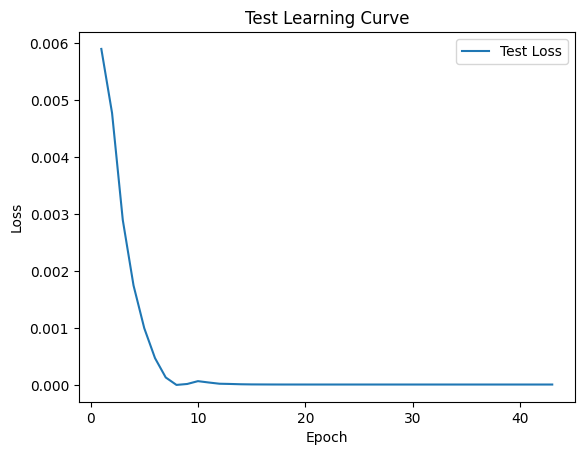


 Epoch: (44/50) Loss = 1.2794575013685971e-05

 Epoch: (44/50) Loss_rmse = 0.003576950402930379

 Epoch: (44/50) R^2 = 0.9974889755249023

 Epoch: (44/50) MAE = 0.0028940588235855103
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

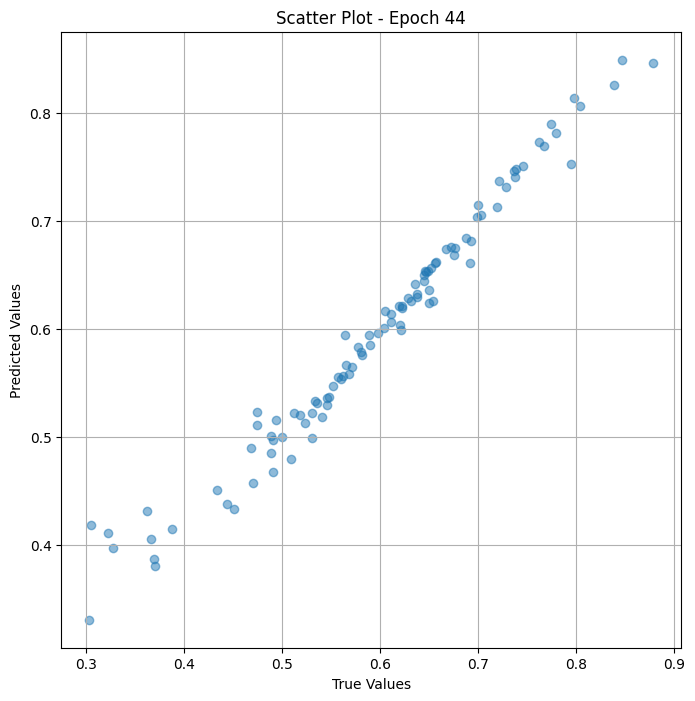

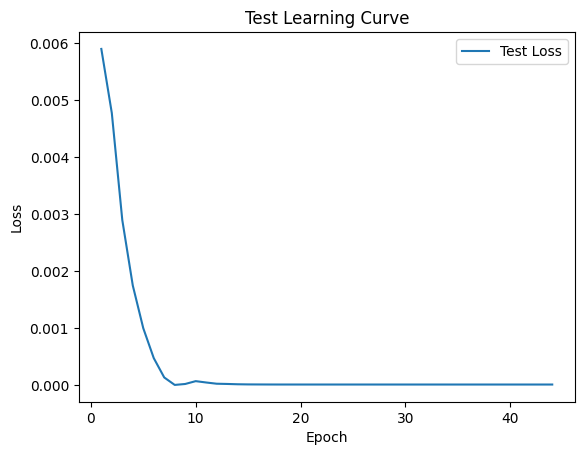


 Epoch: (45/50) Loss = 1.2790766049874946e-05

 Epoch: (45/50) Loss_rmse = 0.003576418152078986

 Epoch: (45/50) R^2 = 0.9974896907806396

 Epoch: (45/50) MAE = 0.0028934404253959656
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

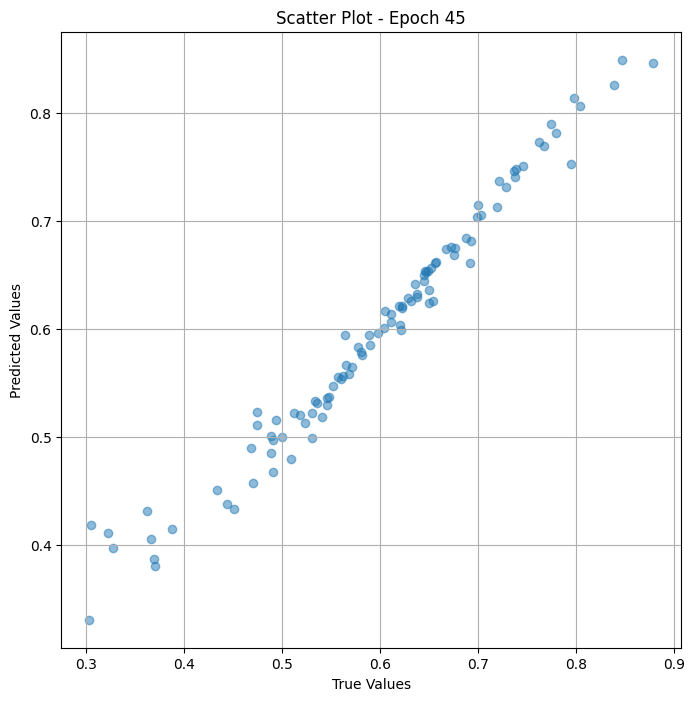

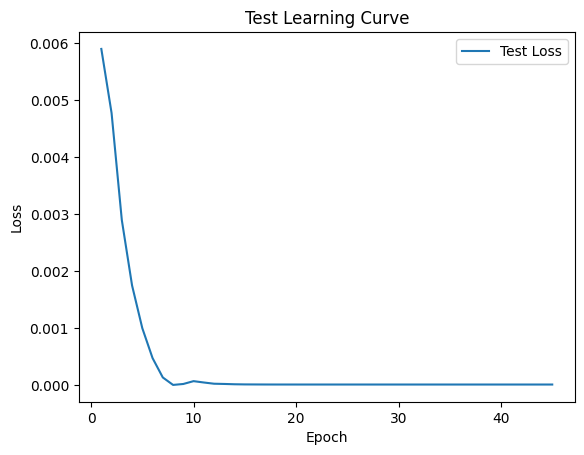


 Epoch: (46/50) Loss = 1.278672516491497e-05

 Epoch: (46/50) Loss_rmse = 0.0035758530721068382

 Epoch: (46/50) R^2 = 0.9974905252456665

 Epoch: (46/50) MAE = 0.002892792224884033
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 

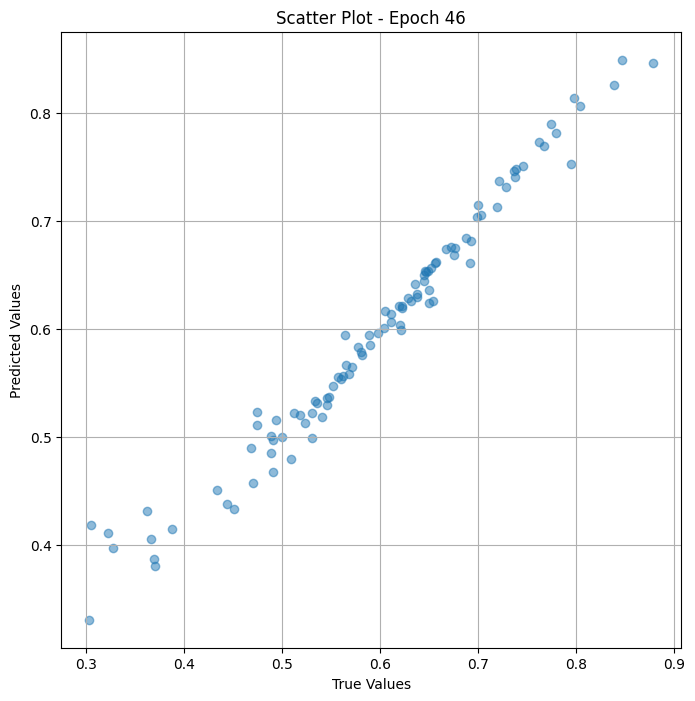

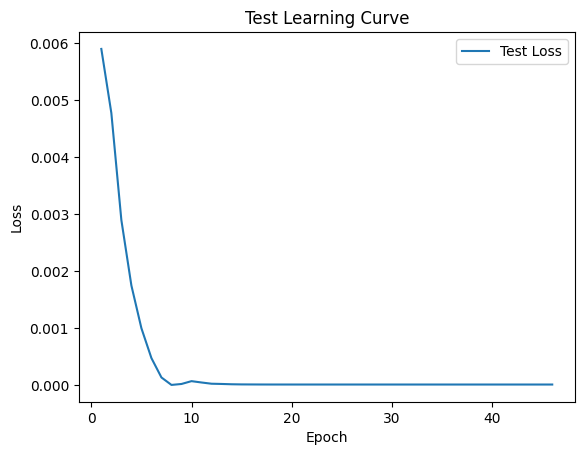


 Epoch: (47/50) Loss = 1.2782705198333133e-05

 Epoch: (47/50) Loss_rmse = 0.003575291018933058

 Epoch: (47/50) R^2 = 0.9974913001060486

 Epoch: (47/50) MAE = 0.002892106771469116
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 

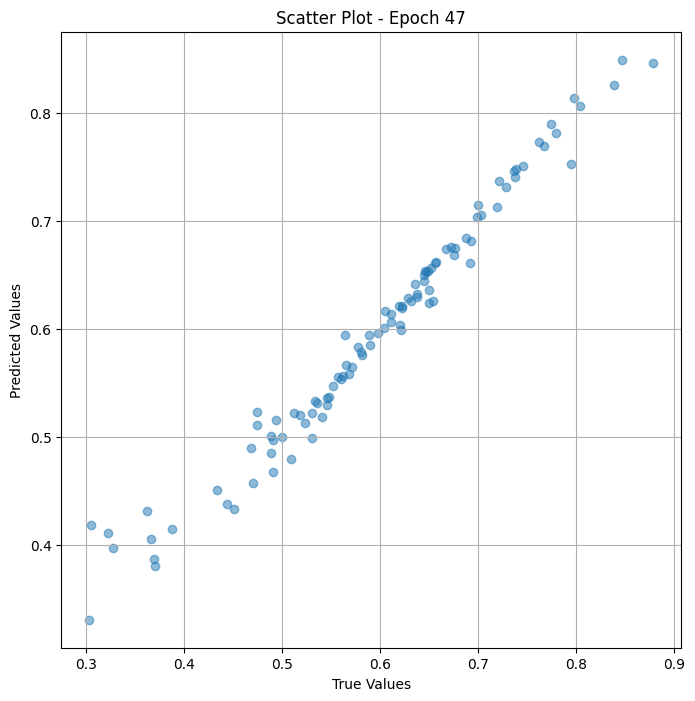

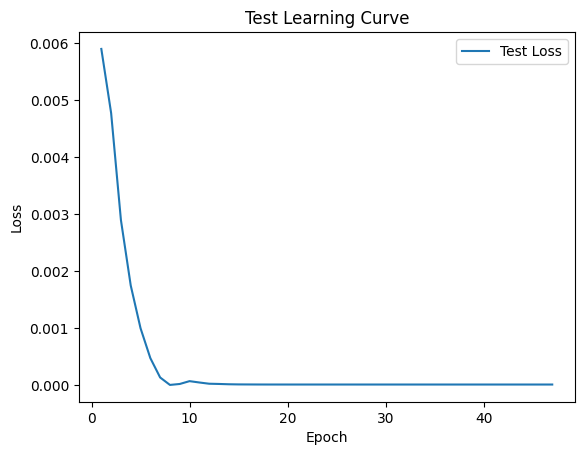


 Epoch: (48/50) Loss = 1.2778644304489717e-05

 Epoch: (48/50) Loss_rmse = 0.0035747229121625423

 Epoch: (48/50) R^2 = 0.9974920749664307

 Epoch: (48/50) MAE = 0.002891428768634796
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

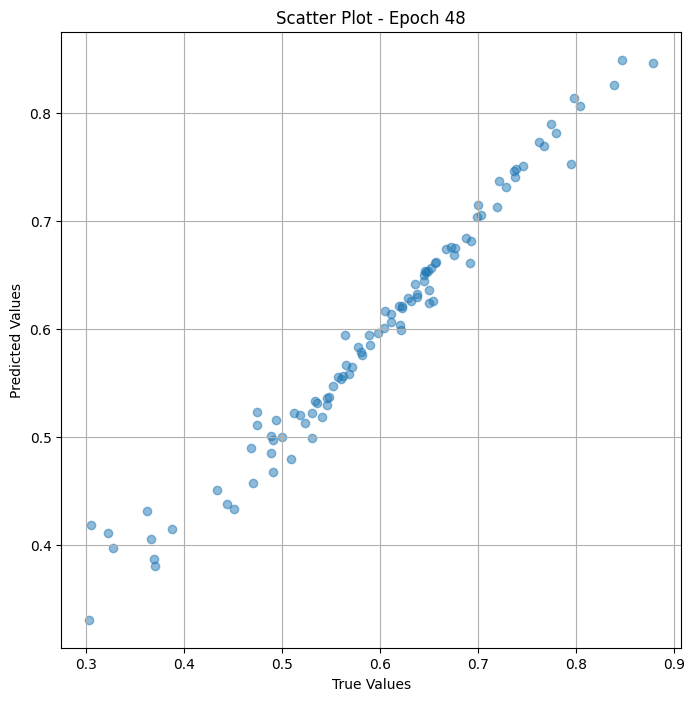

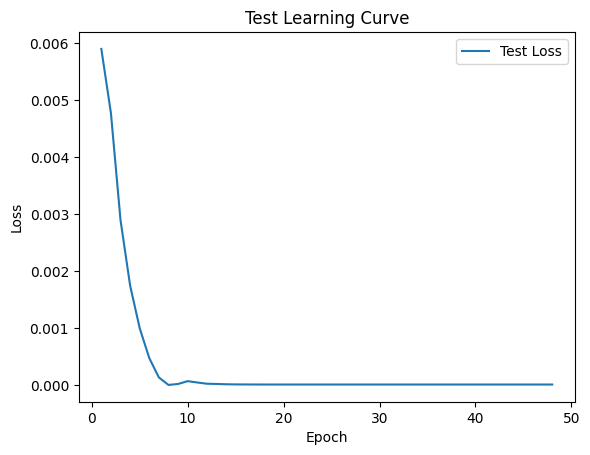


 Epoch: (49/50) Loss = 1.2774778952007182e-05

 Epoch: (49/50) Loss_rmse = 0.003574182279407978

 Epoch: (49/50) R^2 = 0.9974928498268127

 Epoch: (49/50) MAE = 0.0028907880187034607
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

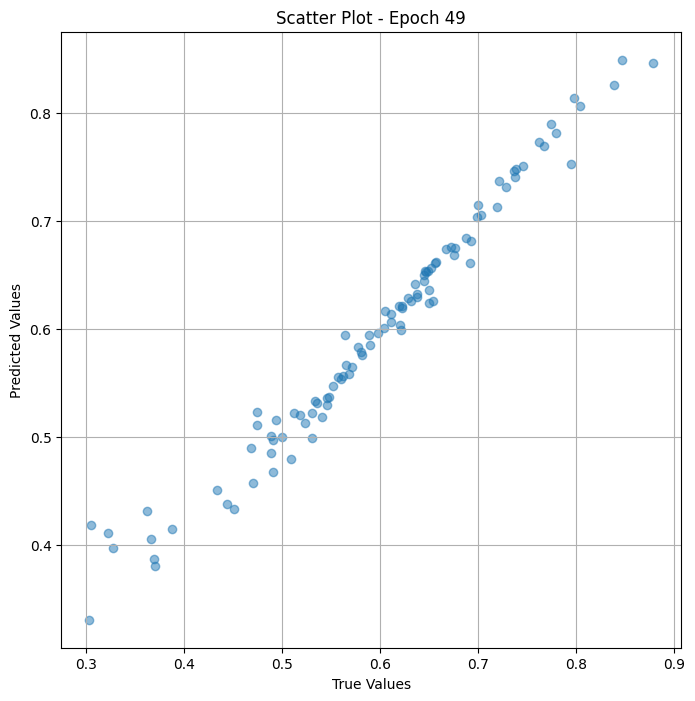

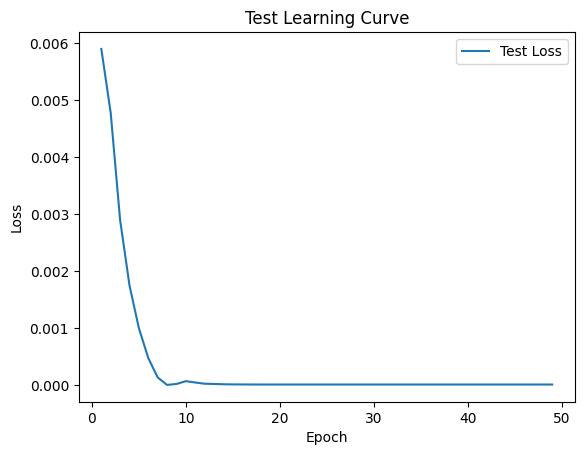


 Epoch: (50/50) Loss = 1.2770618923241273e-05

 Epoch: (50/50) Loss_rmse = 0.0035736002027988434

 Epoch: (50/50) R^2 = 0.9974936842918396

 Epoch: (50/50) MAE = 0.0028900951147079468
Spearman correlation coefficient: SignificanceResult(statistic=0.9919356479857018, pvalue=3.911726511159857e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

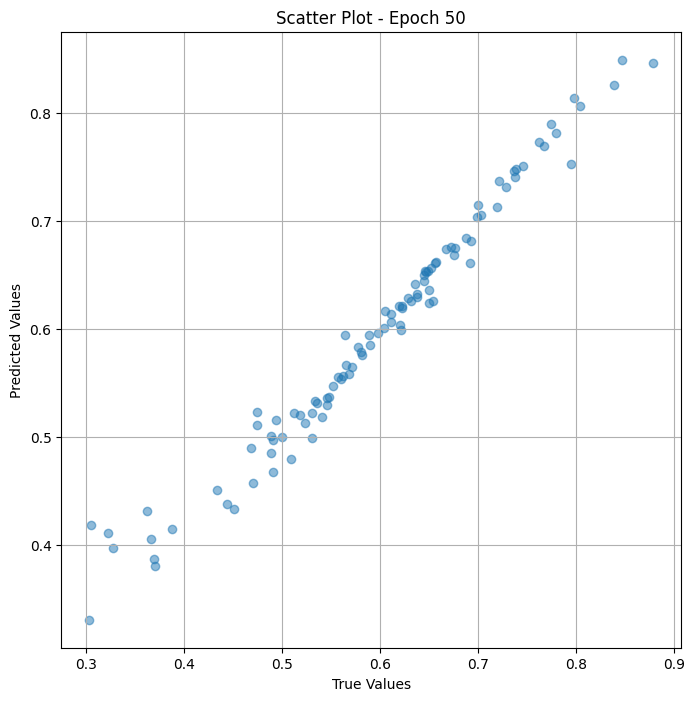

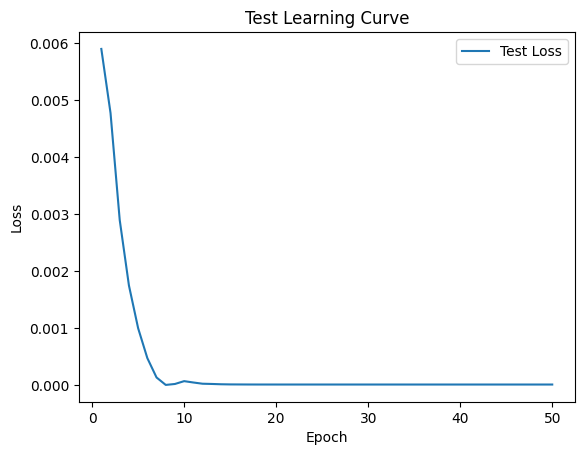

In [ ]:
# val the model and save weights
fit(50, model_res_test , test_dl )
torch.save(model_res_test.state_dict(), "model_weights_s")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds =model_res_test(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_landscape' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_test_landscape['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

                                           Image Path  True Value  \
0   /content/landscape/n07801091_49081_preprocesse...    0.564356   
1   /content/landscape/0ce0499b7f00cb0e_preprocess...    0.511905   
2   /content/landscape/sun_attunurkvvvrpksl_prepro...    0.370000   
3   /content/landscape/5e3a2b6e7943040f_preprocess...    0.474227   
4   /content/landscape/sun_ammlmcnlqojiatxv_prepro...    0.365854   
..                                                ...         ...   
95  /content/landscape/n09468604_15562_preprocesse...    0.774193   
96  /content/landscape/sun_aabtemlmesogqbbp_prepro...    0.533981   
97  /content/landscape/sun_auvwgyllqzsyfdyg_prepro...    0.535714   
98  /content/landscape/n09288635_12929_preprocesse...    0.644860   
99  /content/landscape/sun_afxtgecjnlpwldpz_prepro...    0.443396   

    Predicted Value  
0          0.583633  
1          0.535420  
2          0.508681  
3          0.512891  
4          0.459274  
..              ...  
95         0.7669

#Finetuning

##Train

In [ ]:
class Dataset_train_fine(Dataset):
    def __init__(self, df,res_fine_transform =None):
        self.labels = df_train_landscape["memoscore"]
        self.images = df_train_landscape["preprocessed_image_path"]
        self.res_fine_transform  = res_fine_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.res_fine_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
res_fine_transform   = ConvNextImageProcessor.from_pretrained("facebook/convnext-tiny-224")

# สร้าง Dataset และ DataLoader
train_ds_fine = Dataset_train_fine(df_train_landscape, res_fine_transform =res_fine_transform )
train_dl_fine = DataLoader(train_ds_fine, batch_size=16, shuffle=False)


In [ ]:
class Resmem_model_fine_landscape(torch.nn.Module):
    def __init__(self, arch="resnet50.a1_in1k"):
        super().__init__()
        self.arch = arch
        self.res = timm.create_model(self.arch, pretrained=True, num_classes=1)



    def forward(self, x):
        resfeat = self.res(x)

        out = torch.sigmoid(resfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_res_fine =  Resmem_model_fine_landscape( arch="resnet50.a1_in1k")

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_fine = DeviceDataLoader(train_dl_fine, device)
model_res_fine = to_device(model_res_fine  , device)

In [ ]:
params = [param for param in list(model_res_fine.parameters()) if param.requires_grad == True ]
optimizer = torch.optim.Adam(params, lr=1e-4 ,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res_fine, train_dl_fine):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res_fine.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl_fine:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res_fine(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.010826571844518185

 Epoch: (1/50) Loss_rmse = 0.10405081510543823

 Epoch: (1/50) R^2 = -0.0005184412002563477

 Epoch: (1/50) MAE = 0.07942330837249756
Spearman correlation coefficient: SignificanceResult(statistic=0.1471183746171456, pvalue=3.910730373556933e-10)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5

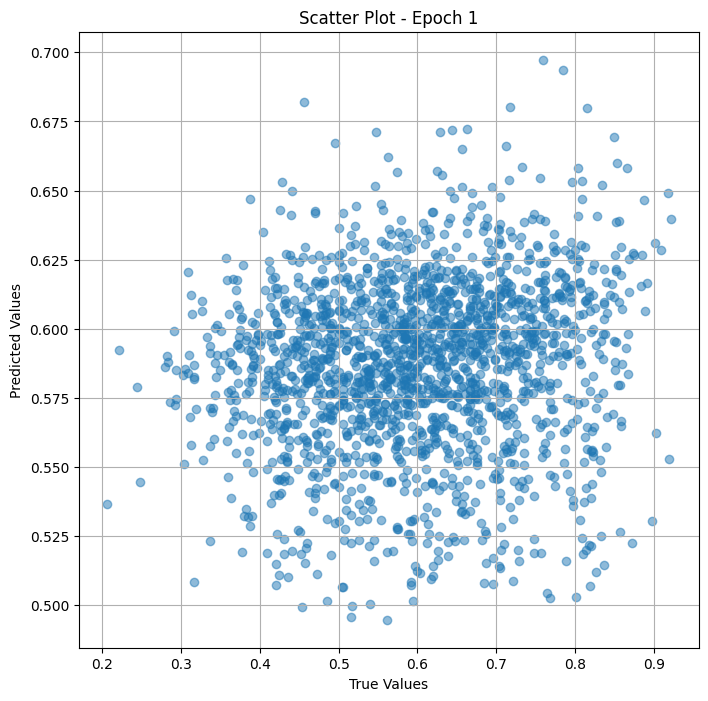

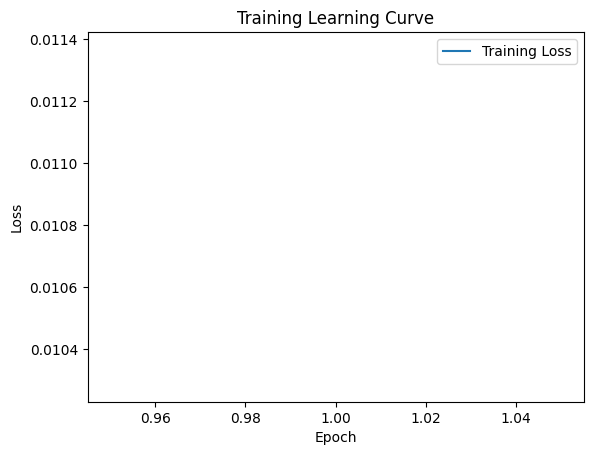


 Epoch: (2/50) Loss = 0.005352080799639225

 Epoch: (2/50) Loss_rmse = 0.0731579139828682

 Epoch: (2/50) R^2 = 0.5053969621658325

 Epoch: (2/50) MAE = 0.052607614547014236
Spearman correlation coefficient: SignificanceResult(statistic=0.7532194833840357, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615386, 0.

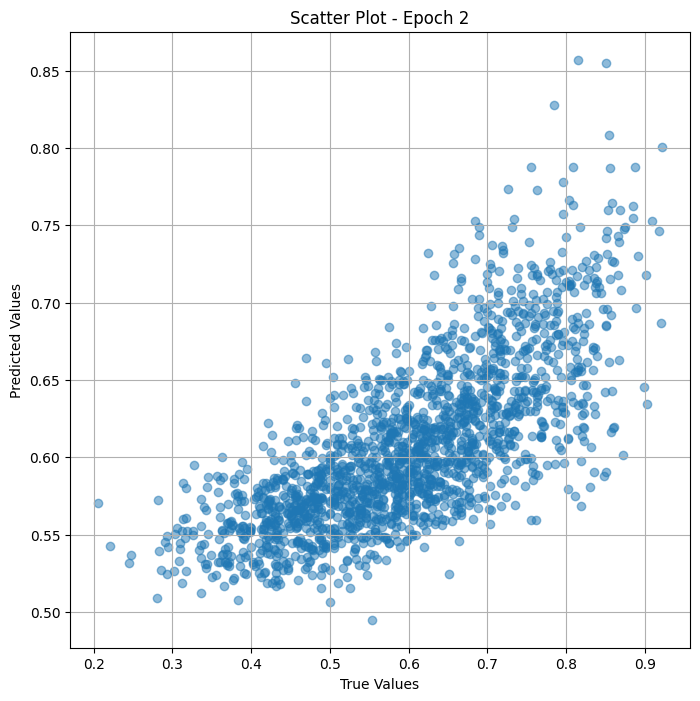

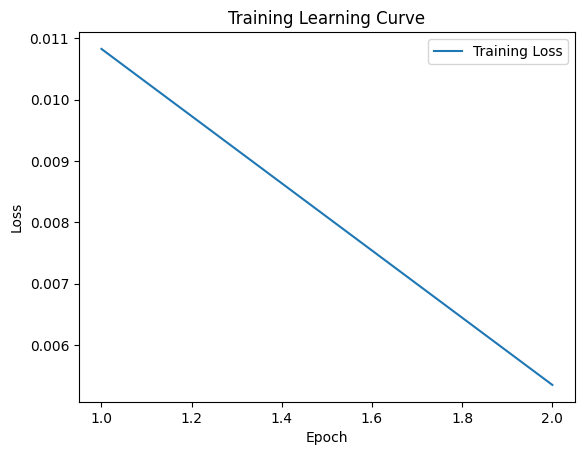


 Epoch: (3/50) Loss = 0.002760436851531267

 Epoch: (3/50) Loss_rmse = 0.05253985896706581

 Epoch: (3/50) R^2 = 0.7448991537094116

 Epoch: (3/50) MAE = 0.03421163931488991
Spearman correlation coefficient: SignificanceResult(statistic=0.8997045343132776, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615386, 0.

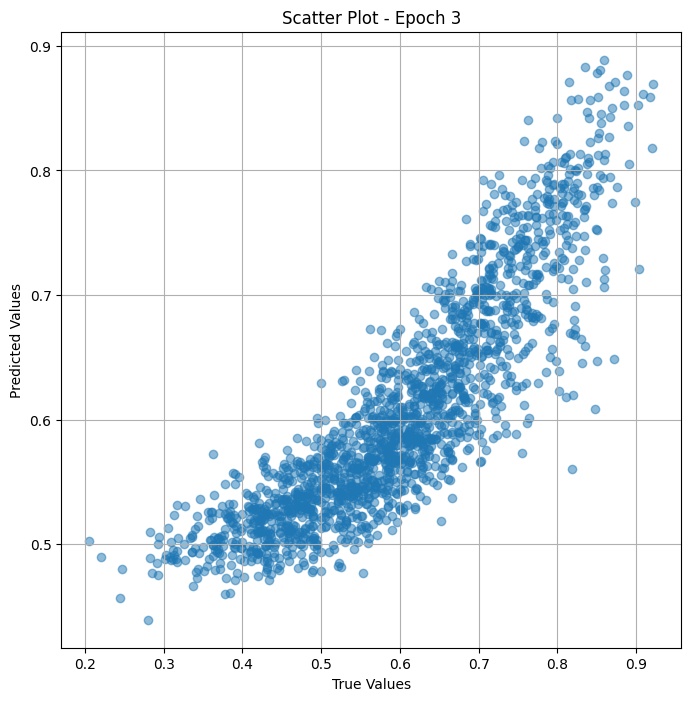

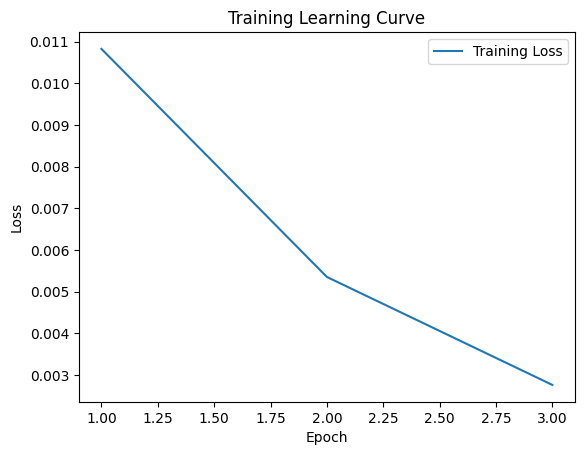


 Epoch: (4/50) Loss = 0.0007250845083035529

 Epoch: (4/50) Loss_rmse = 0.026927392929792404

 Epoch: (4/50) R^2 = 0.9329925775527954

 Epoch: (4/50) MAE = 0.019580252468585968
Spearman correlation coefficient: SignificanceResult(statistic=0.9526562411315049, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615386,

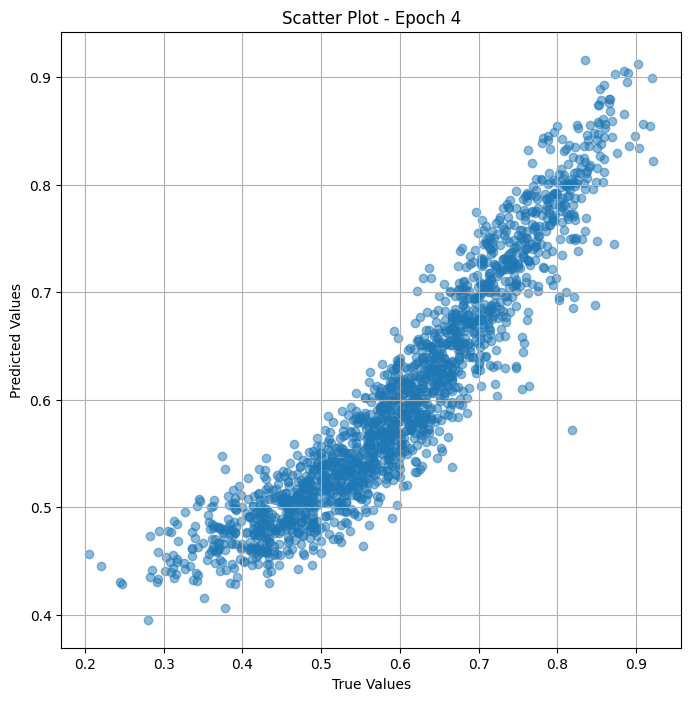

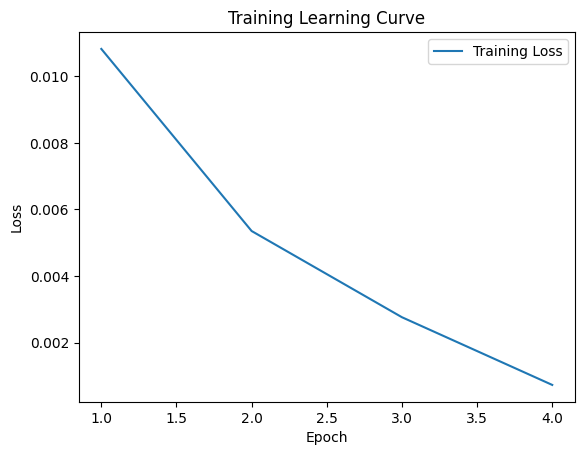


 Epoch: (5/50) Loss = 0.0021688006818294525

 Epoch: (5/50) Loss_rmse = 0.04657038301229477

 Epoch: (5/50) R^2 = 0.7995741367340088

 Epoch: (5/50) MAE = 0.0356929786503315
Spearman correlation coefficient: SignificanceResult(statistic=0.9633091968275822, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615386, 0.

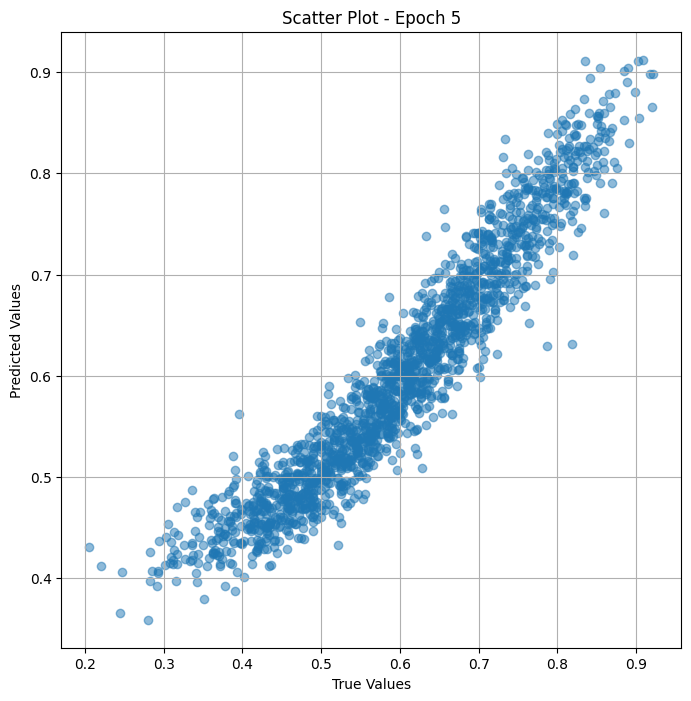

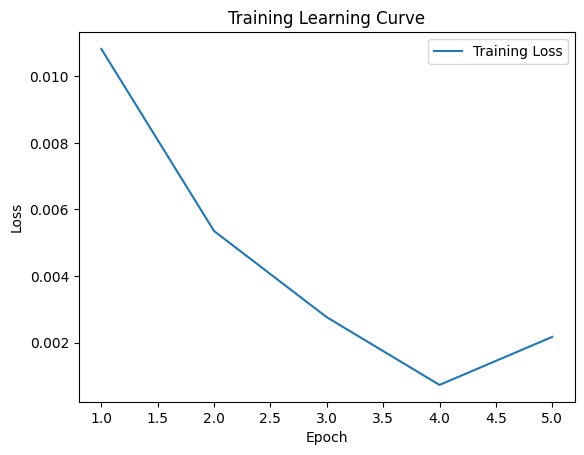


 Epoch: (6/50) Loss = 0.005877879448235035

 Epoch: (6/50) Loss_rmse = 0.07666733115911484

 Epoch: (6/50) R^2 = 0.4568061828613281

 Epoch: (6/50) MAE = 0.06693122535943985
Spearman correlation coefficient: SignificanceResult(statistic=0.9670991938490451, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615386, 0.

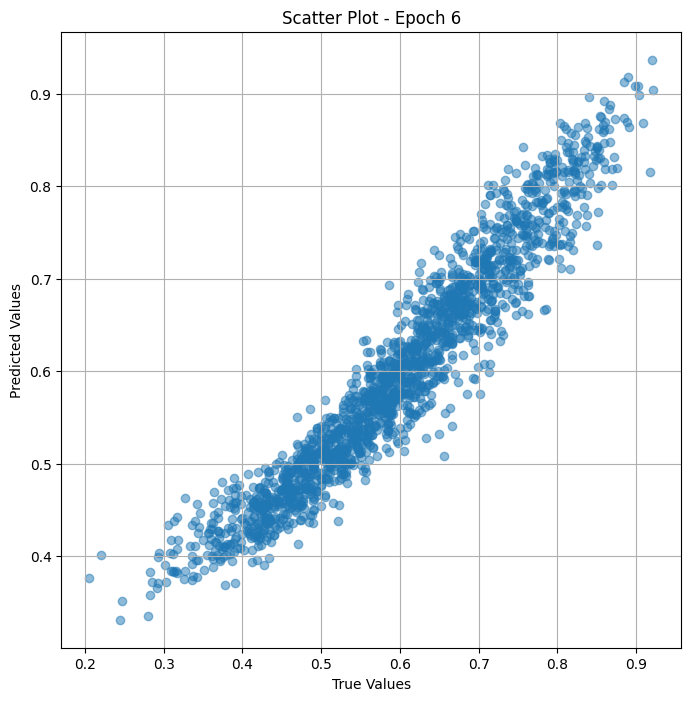

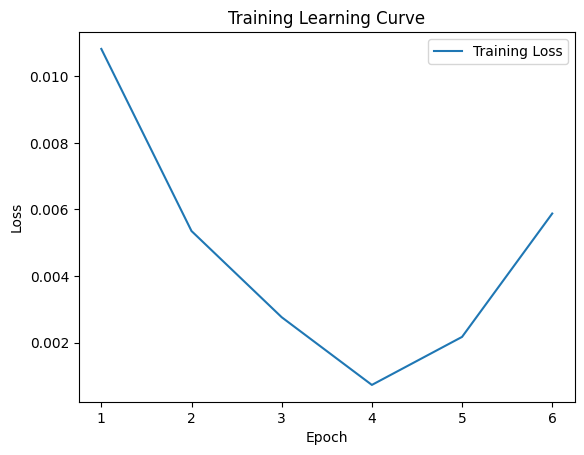

Epoch 0.06: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (7/50) Loss = 0.0032346211373806

 Epoch: (7/50) Loss_rmse = 0.056873731315135956

 Epoch: (7/50) R^2 = 0.7010781764984131

 Epoch: (7/50) MAE = 0.045523956418037415
Spearman correlation coefficient: SignificanceResult(statistic=0.9684006166136055, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.480769

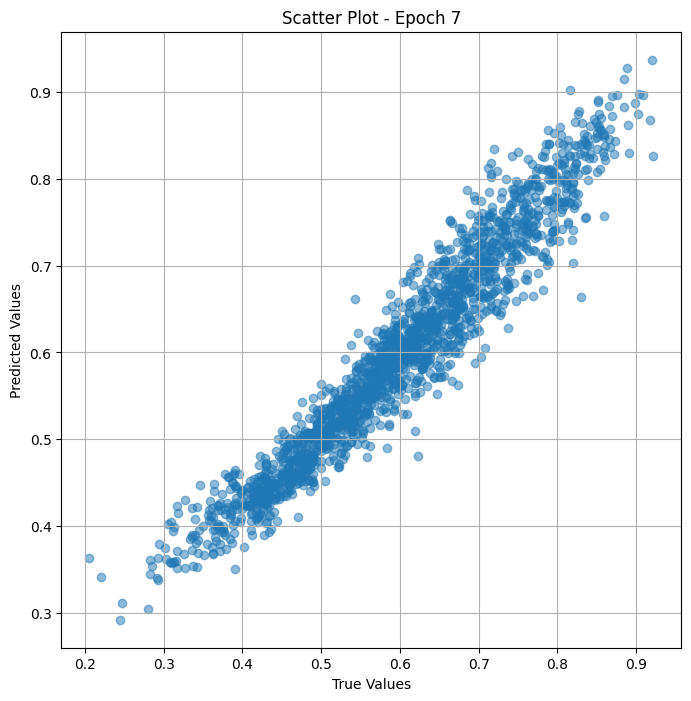

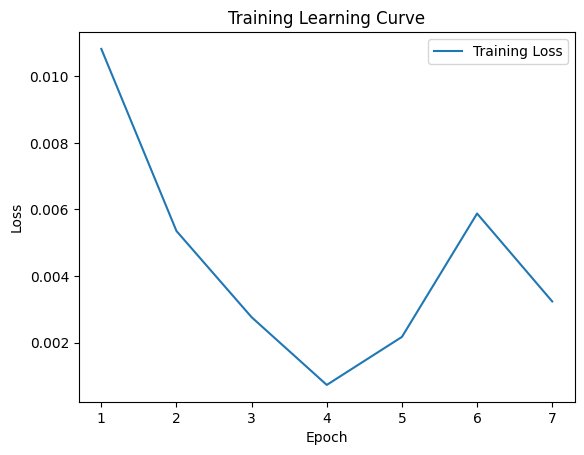


 Epoch: (8/50) Loss = 0.000829824770335108

 Epoch: (8/50) Loss_rmse = 0.02880667895078659

 Epoch: (8/50) R^2 = 0.9233132004737854

 Epoch: (8/50) MAE = 0.02452203258872032
Spearman correlation coefficient: SignificanceResult(statistic=0.9721117351047635, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615386, 0.

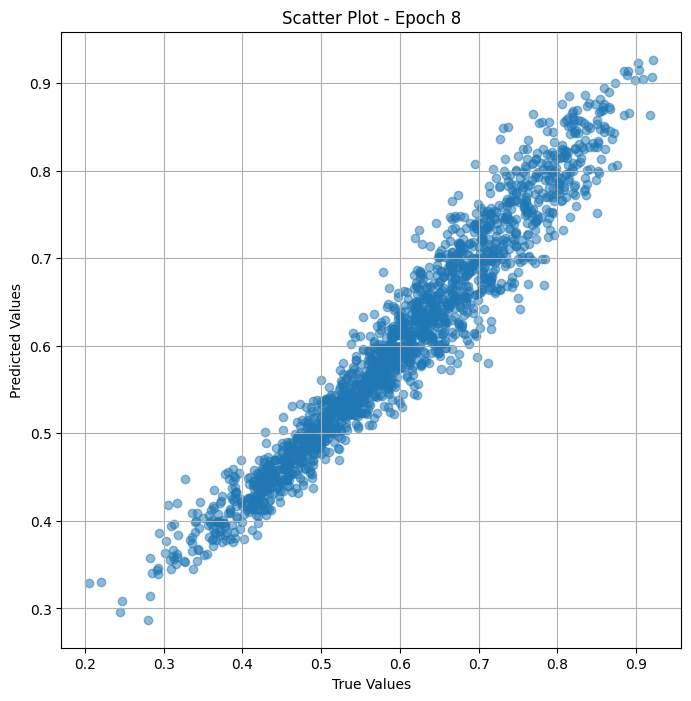

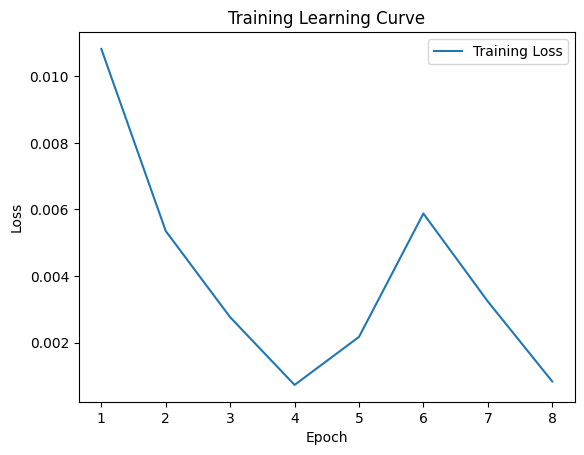


 Epoch: (9/50) Loss = 0.0003699938824865967

 Epoch: (9/50) Loss_rmse = 0.01923522539436817

 Epoch: (9/50) R^2 = 0.9658076763153076

 Epoch: (9/50) MAE = 0.01698208600282669
Spearman correlation coefficient: SignificanceResult(statistic=0.9862487368763794, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615386, 0

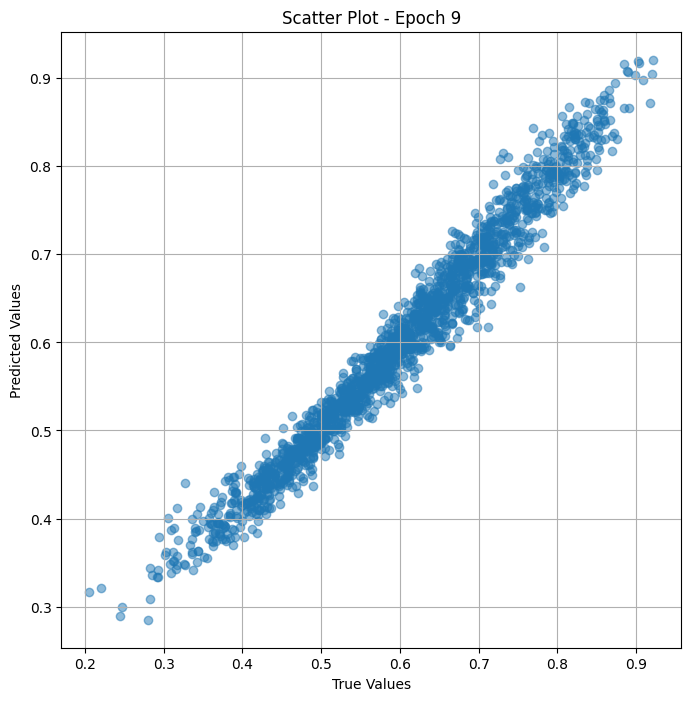

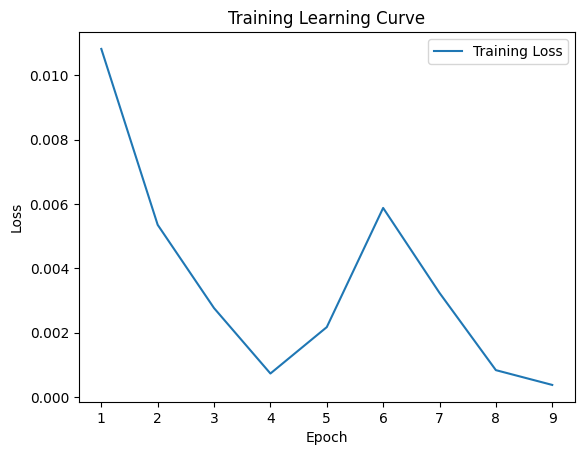


 Epoch: (10/50) Loss = 0.00016457168385386467

 Epoch: (10/50) Loss_rmse = 0.01282854937016964

 Epoch: (10/50) R^2 = 0.9847913980484009

 Epoch: (10/50) MAE = 0.01119246706366539
Spearman correlation coefficient: SignificanceResult(statistic=0.992151182732022, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5961538

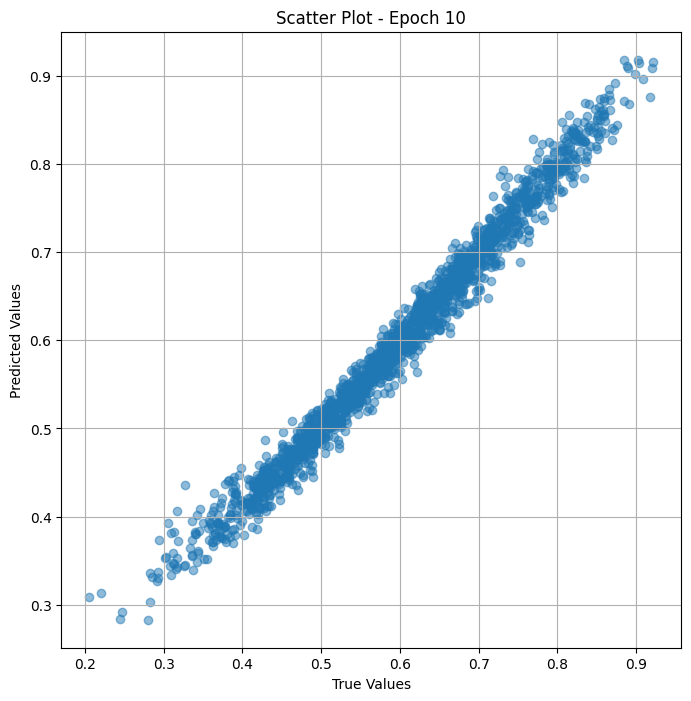

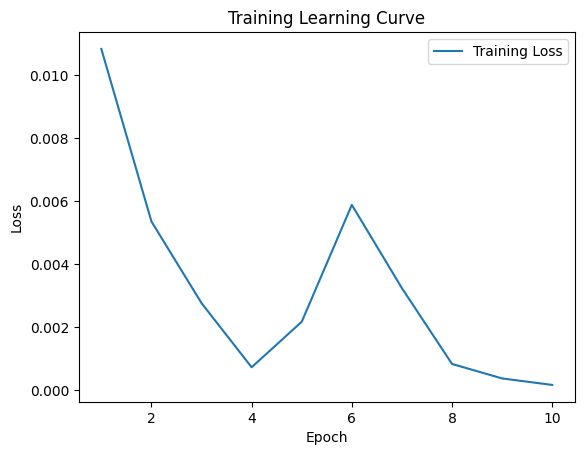


 Epoch: (11/50) Loss = 8.212561078835279e-05

 Epoch: (11/50) Loss_rmse = 0.009062318131327629

 Epoch: (11/50) R^2 = 0.9924104809761047

 Epoch: (11/50) MAE = 0.007951527833938599
Spearman correlation coefficient: SignificanceResult(statistic=0.9950495089122464, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615

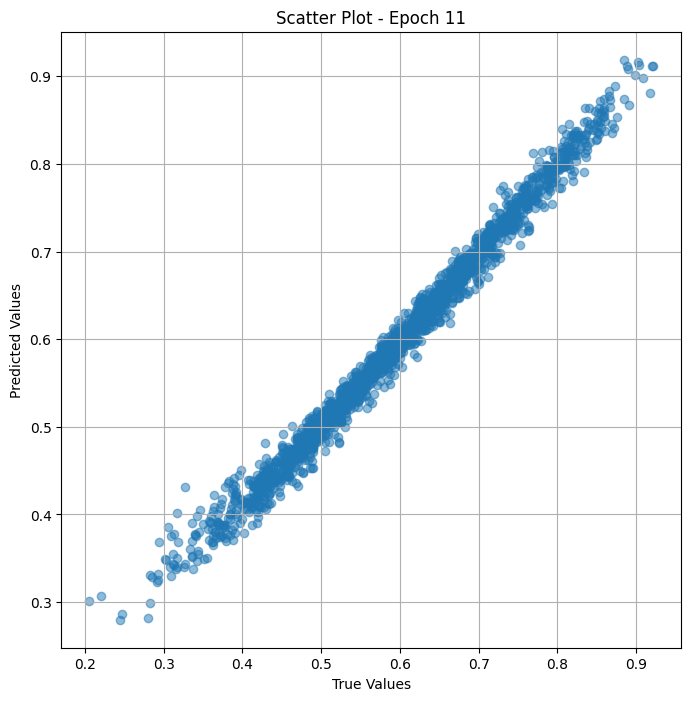

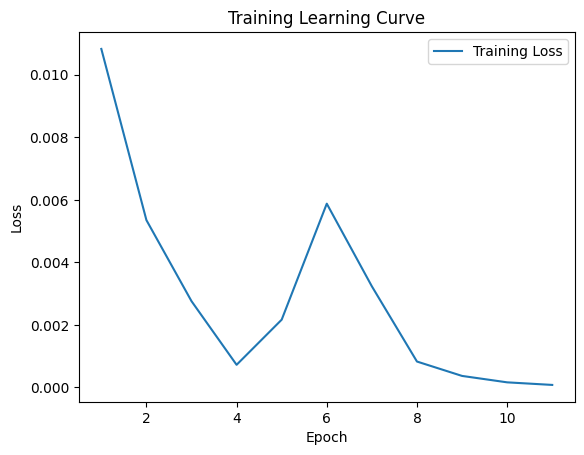


 Epoch: (12/50) Loss = 4.264862946001813e-05

 Epoch: (12/50) Loss_rmse = 0.006530591752380133

 Epoch: (12/50) R^2 = 0.9960587024688721

 Epoch: (12/50) MAE = 0.005841545760631561
Spearman correlation coefficient: SignificanceResult(statistic=0.9966058678541431, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615

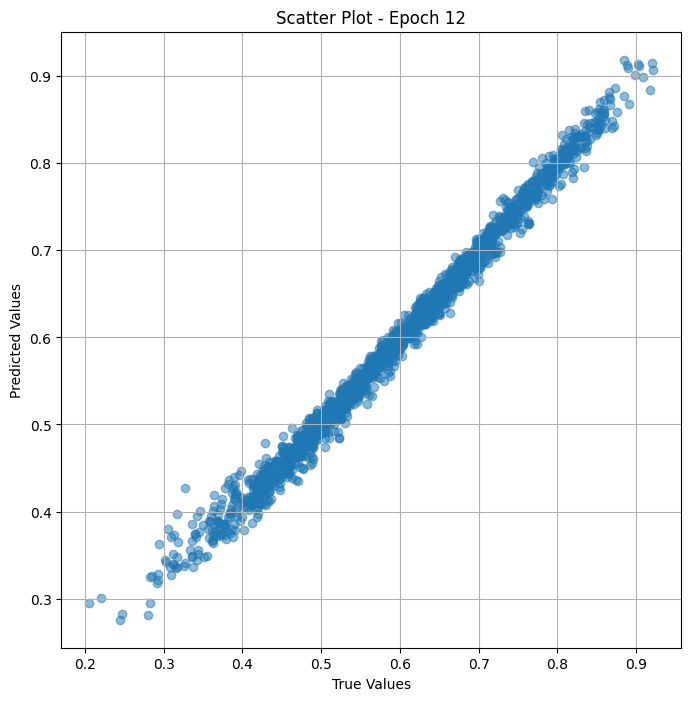

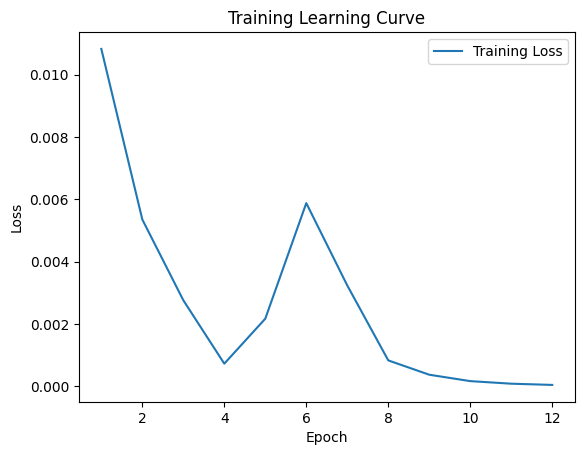


 Epoch: (13/50) Loss = 2.461324584146496e-05

 Epoch: (13/50) Loss_rmse = 0.004961173981428146

 Epoch: (13/50) R^2 = 0.9977254271507263

 Epoch: (13/50) MAE = 0.004445619881153107
Spearman correlation coefficient: SignificanceResult(statistic=0.997529591307895, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596153

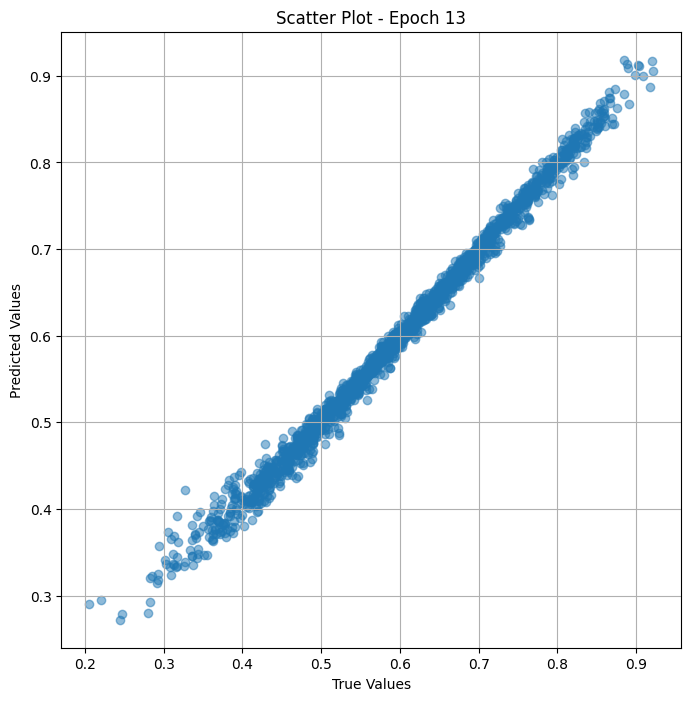

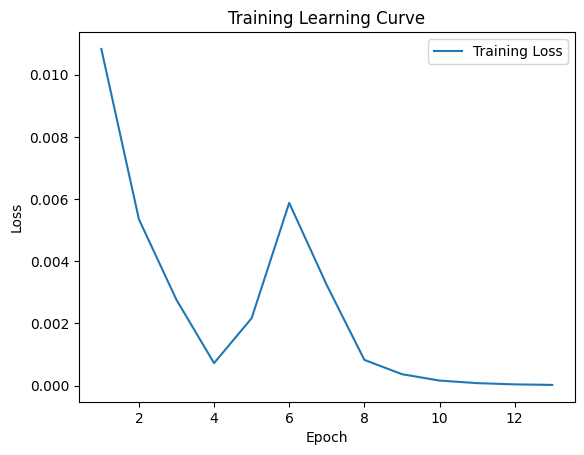


 Epoch: (14/50) Loss = 1.4685985661344603e-05

 Epoch: (14/50) Loss_rmse = 0.0038322298787534237

 Epoch: (14/50) R^2 = 0.9986428022384644

 Epoch: (14/50) MAE = 0.003354378044605255
Spearman correlation coefficient: SignificanceResult(statistic=0.9981034557639759, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

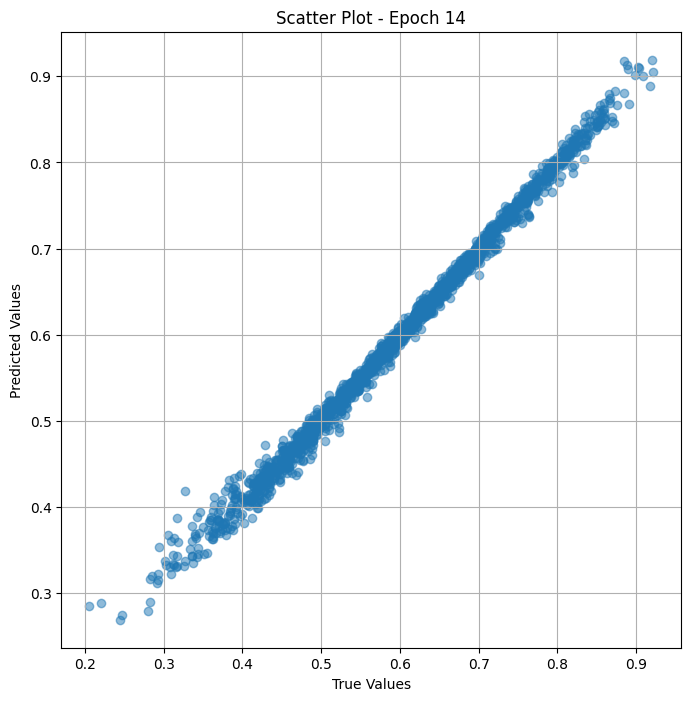

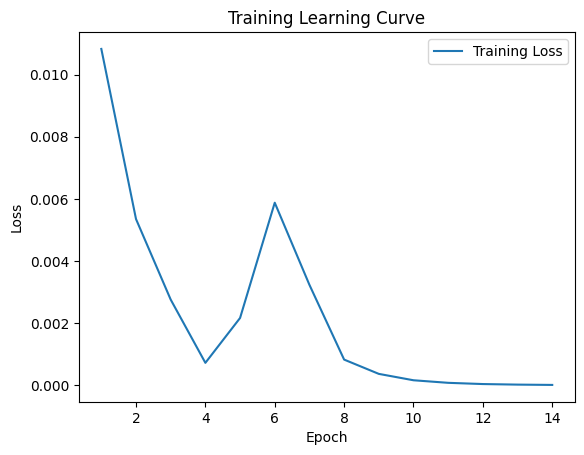


 Epoch: (15/50) Loss = 9.755364771990571e-06

 Epoch: (15/50) Loss_rmse = 0.003123357892036438

 Epoch: (15/50) R^2 = 0.9990984797477722

 Epoch: (15/50) MAE = 0.0026510320603847504
Spearman correlation coefficient: SignificanceResult(statistic=0.9985025372109171, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5961

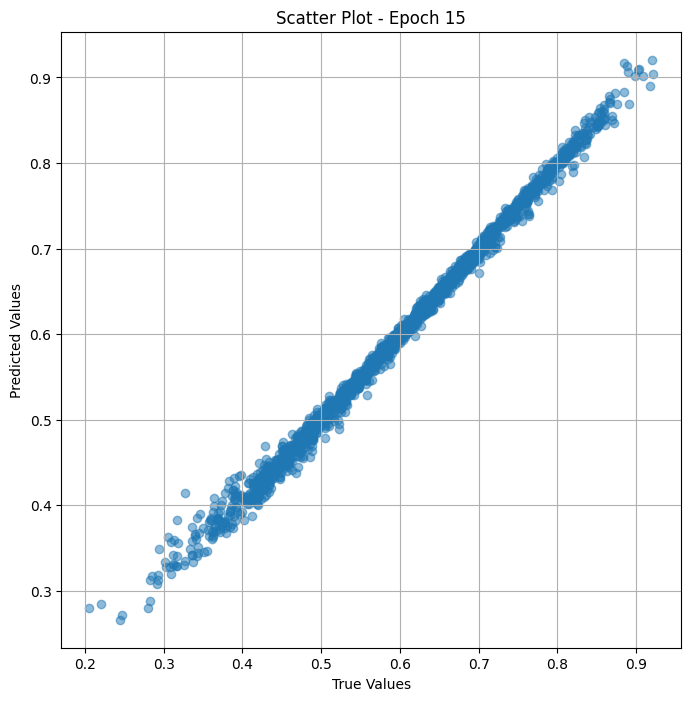

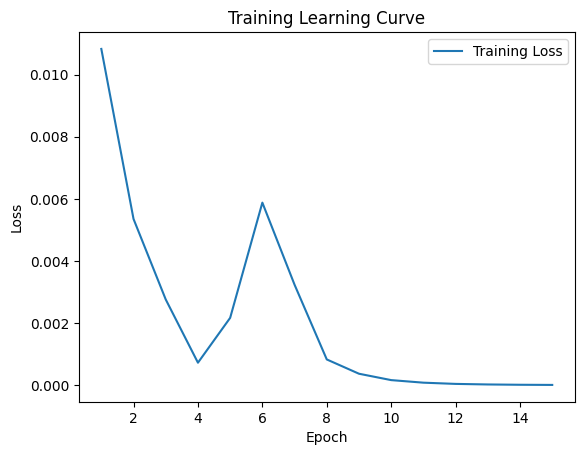


 Epoch: (16/50) Loss = 6.868616310384823e-06

 Epoch: (16/50) Loss_rmse = 0.002620804589241743

 Epoch: (16/50) R^2 = 0.9993652701377869

 Epoch: (16/50) MAE = 0.002100188285112381
Spearman correlation coefficient: SignificanceResult(statistic=0.9988032936691819, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615

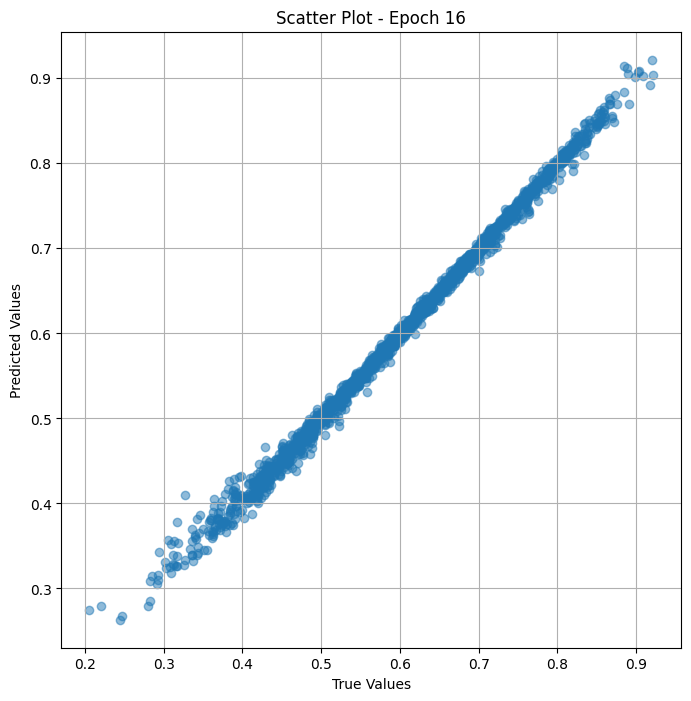

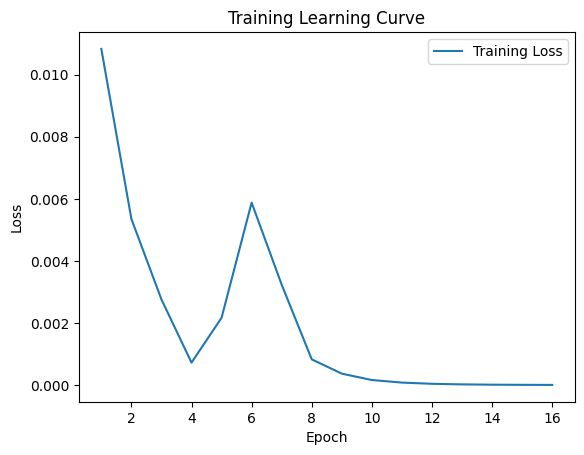


 Epoch: (17/50) Loss = 5.055313067714451e-06

 Epoch: (17/50) Loss_rmse = 0.002248402452096343

 Epoch: (17/50) R^2 = 0.9995328187942505

 Epoch: (17/50) MAE = 0.001733202487230301
Spearman correlation coefficient: SignificanceResult(statistic=0.9990396977918781, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615

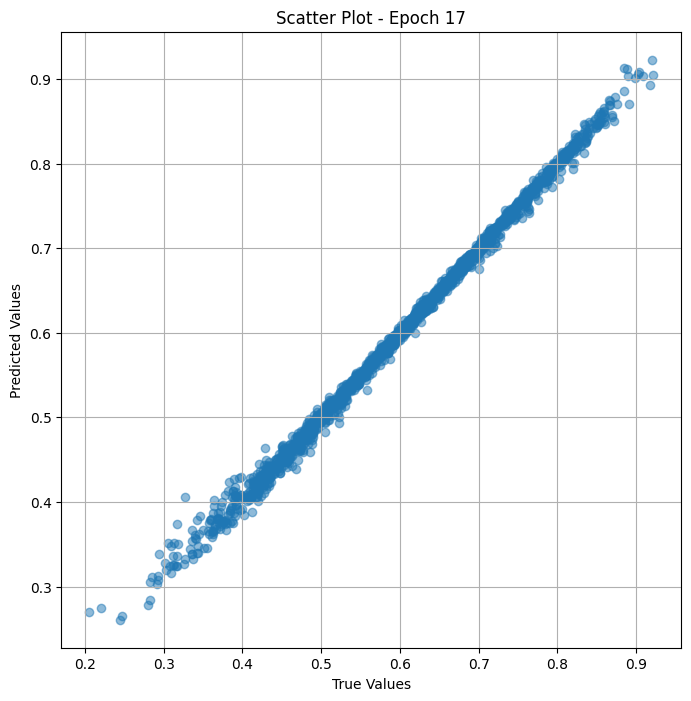

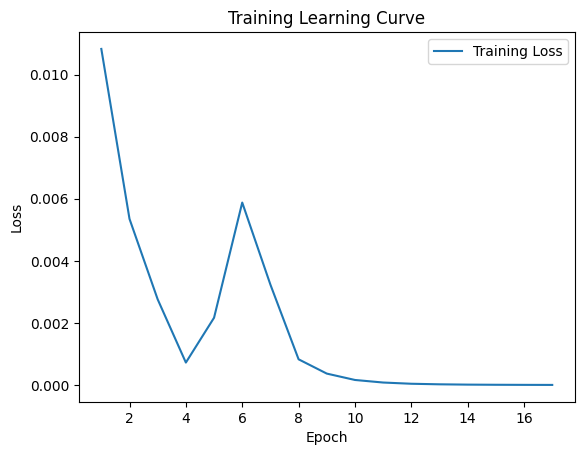


 Epoch: (18/50) Loss = 3.806038421316771e-06

 Epoch: (18/50) Loss_rmse = 0.0019509070552885532

 Epoch: (18/50) R^2 = 0.9996482729911804

 Epoch: (18/50) MAE = 0.0014070309698581696
Spearman correlation coefficient: SignificanceResult(statistic=0.9992237014717895, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

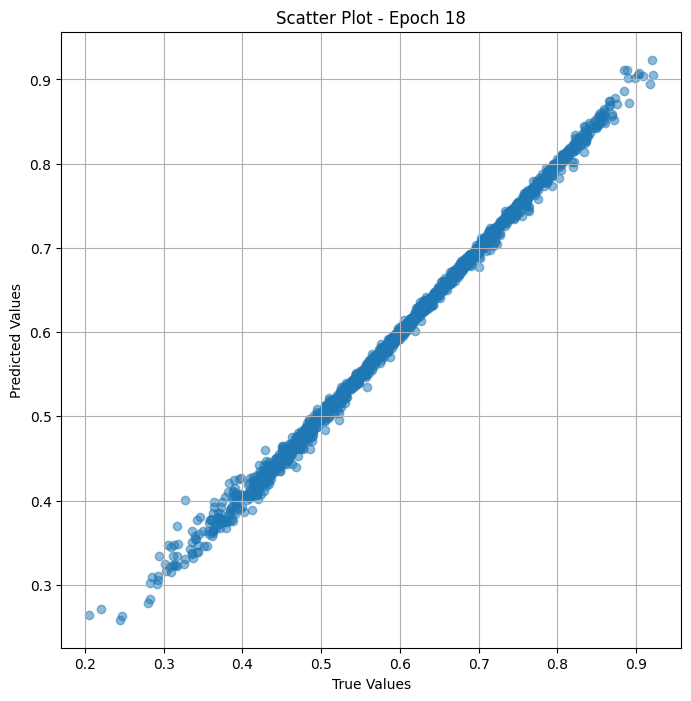

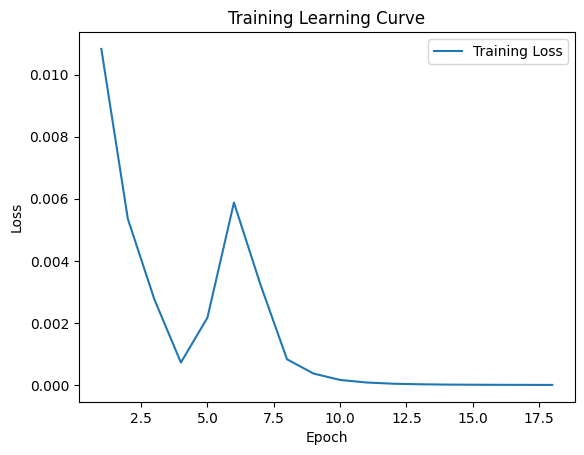


 Epoch: (19/50) Loss = 2.9374659789027646e-06

 Epoch: (19/50) Loss_rmse = 0.0017139037372544408

 Epoch: (19/50) R^2 = 0.9997285604476929

 Epoch: (19/50) MAE = 0.0011785291135311127
Spearman correlation coefficient: SignificanceResult(statistic=0.9993812447892243, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

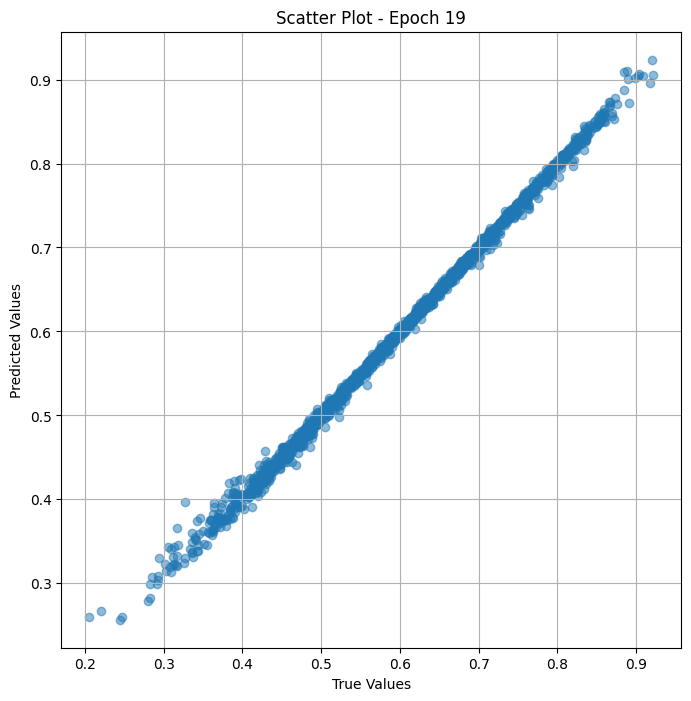

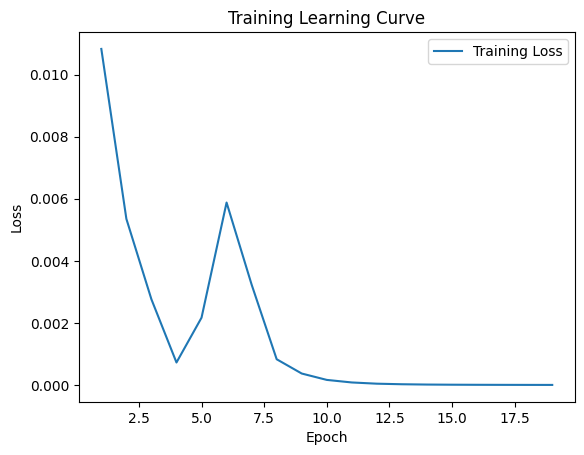


 Epoch: (20/50) Loss = 2.333194061066024e-06

 Epoch: (20/50) Loss_rmse = 0.0015274796169251204

 Epoch: (20/50) R^2 = 0.9997844099998474

 Epoch: (20/50) MAE = 0.0010372400283813477
Spearman correlation coefficient: SignificanceResult(statistic=0.9995083469078698, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

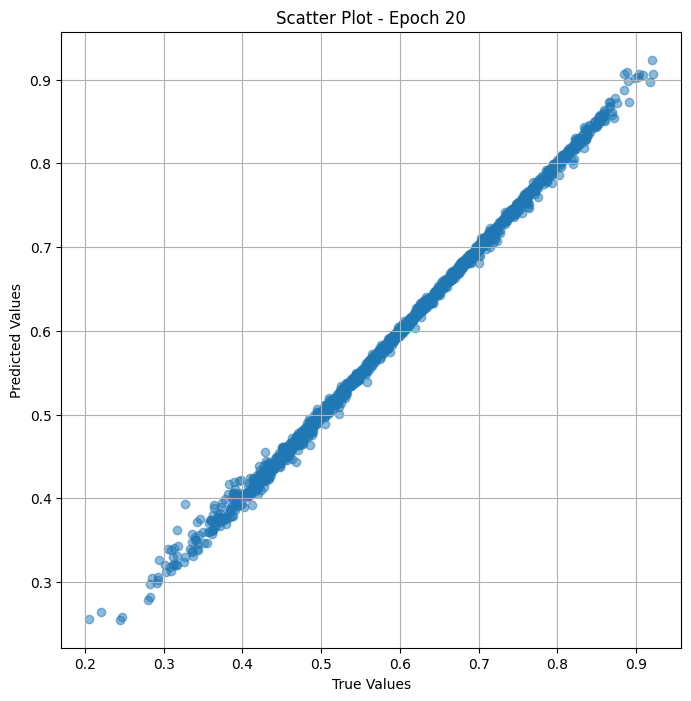

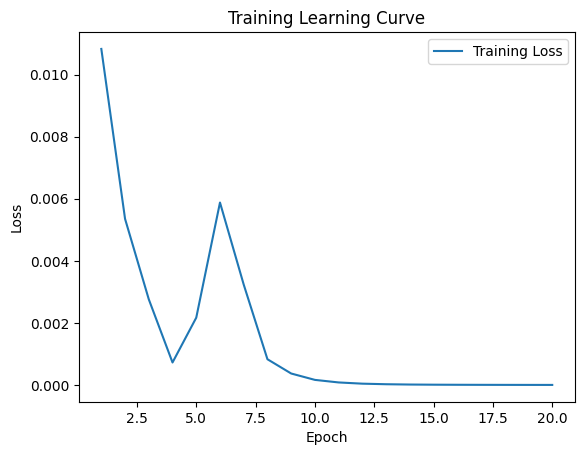


 Epoch: (21/50) Loss = 1.76791411377053e-06

 Epoch: (21/50) Loss_rmse = 0.0013296293327584863

 Epoch: (21/50) R^2 = 0.9998366236686707

 Epoch: (21/50) MAE = 0.0008254237473011017
Spearman correlation coefficient: SignificanceResult(statistic=0.9996119435327022, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5961

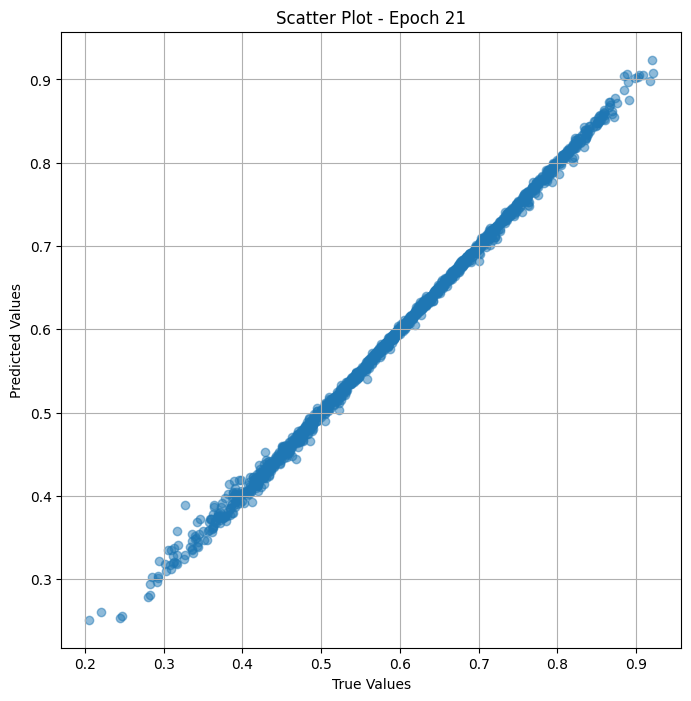

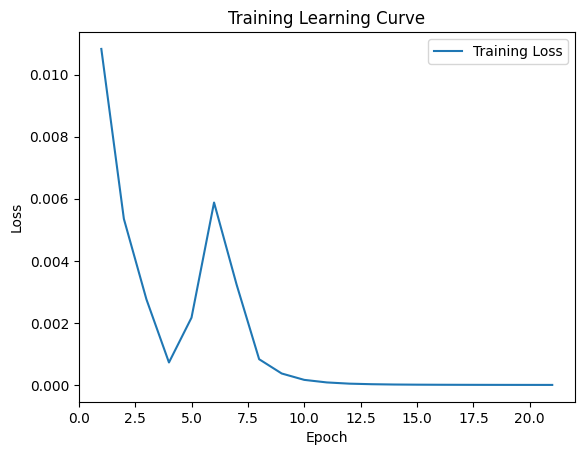


 Epoch: (22/50) Loss = 1.3426761142909527e-06

 Epoch: (22/50) Loss_rmse = 0.001158738974481821

 Epoch: (22/50) R^2 = 0.9998759031295776

 Epoch: (22/50) MAE = 0.0007440820336341858
Spearman correlation coefficient: SignificanceResult(statistic=0.9996933921947683, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

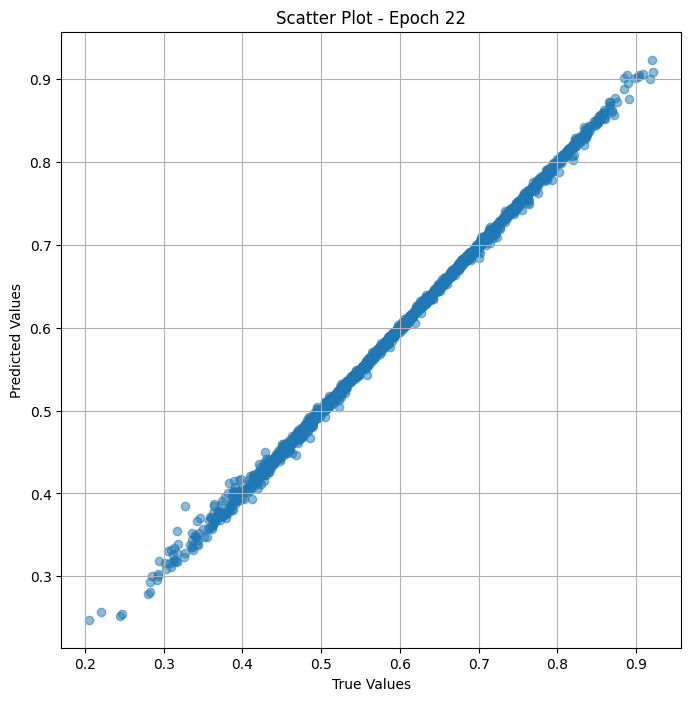

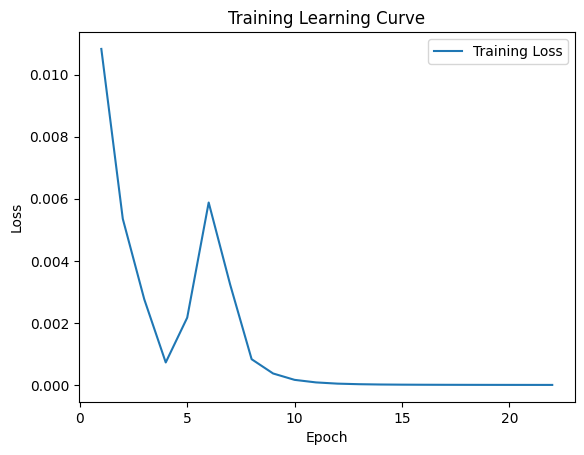


 Epoch: (23/50) Loss = 9.735354069562163e-07

 Epoch: (23/50) Loss_rmse = 0.0009866789914667606

 Epoch: (23/50) R^2 = 0.9999100565910339

 Epoch: (23/50) MAE = 0.0006045065820217133
Spearman correlation coefficient: SignificanceResult(statistic=0.9997558406521007, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

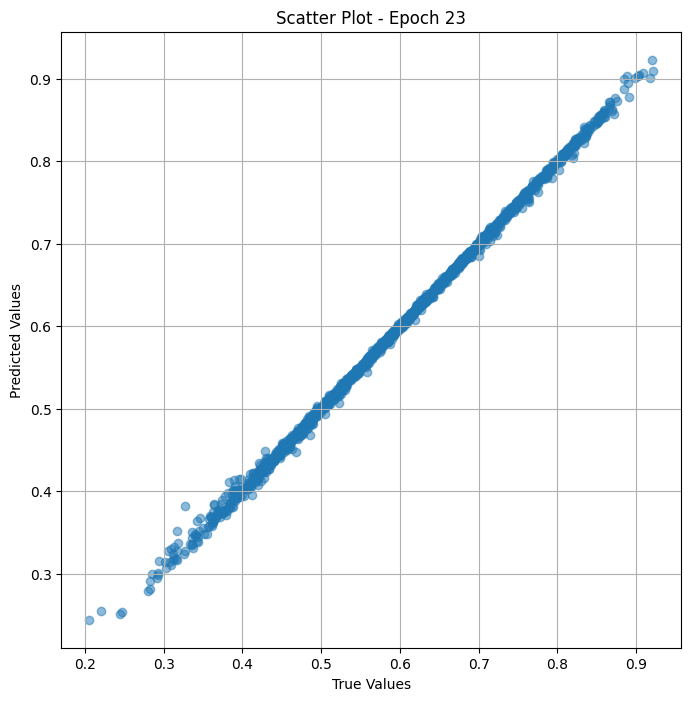

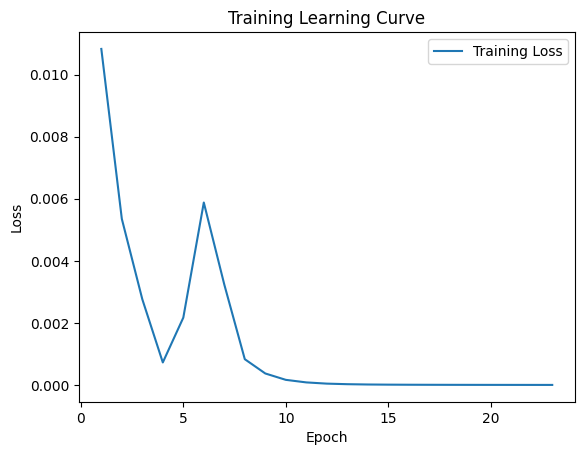


 Epoch: (24/50) Loss = 7.180373700066411e-07

 Epoch: (24/50) Loss_rmse = 0.0008473708294332027

 Epoch: (24/50) R^2 = 0.999933660030365

 Epoch: (24/50) MAE = 0.0005435273051261902
Spearman correlation coefficient: SignificanceResult(statistic=0.9998069899151176, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5961

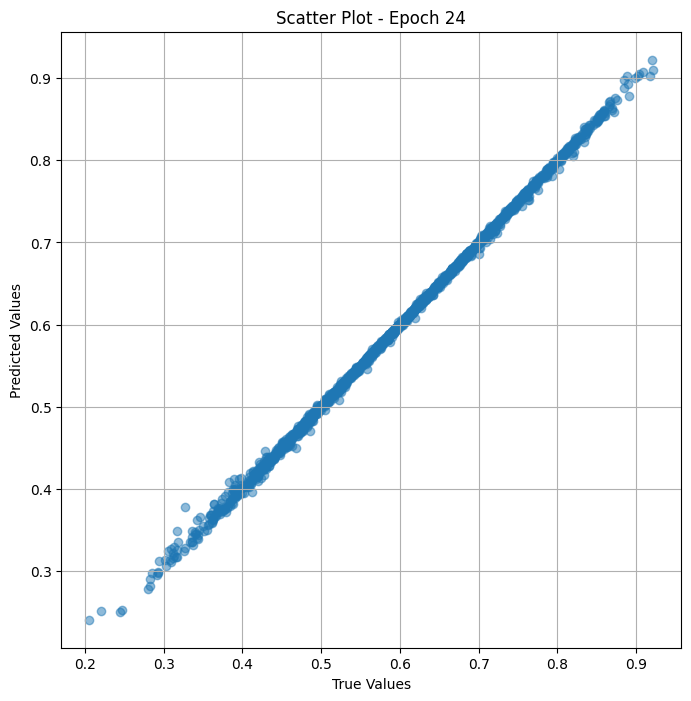

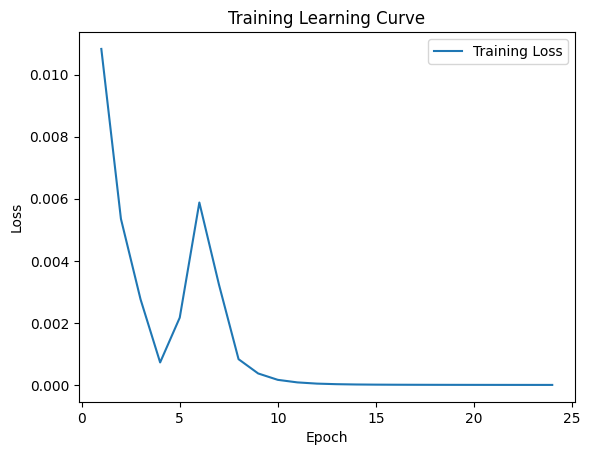


 Epoch: (25/50) Loss = 4.6987753421490197e-07

 Epoch: (25/50) Loss_rmse = 0.0006854761159047484

 Epoch: (25/50) R^2 = 0.9999565482139587

 Epoch: (25/50) MAE = 0.00046325474977493286
Spearman correlation coefficient: SignificanceResult(statistic=0.9998496895458876, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5

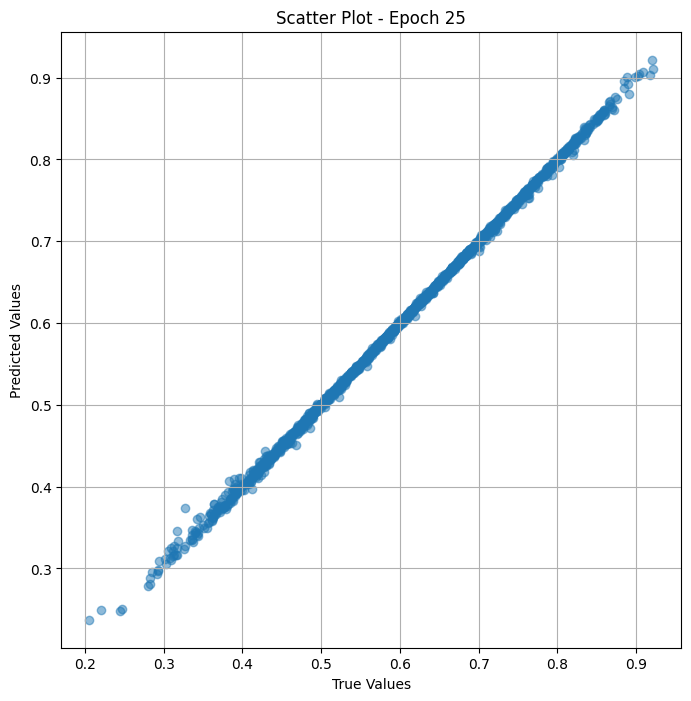

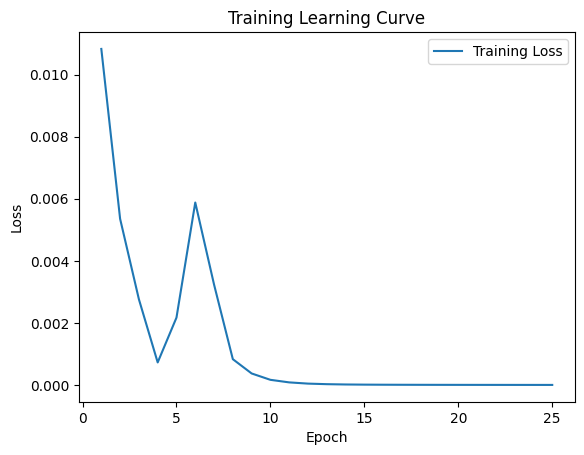


 Epoch: (26/50) Loss = 3.4482209798625263e-07

 Epoch: (26/50) Loss_rmse = 0.0005872155306860805

 Epoch: (26/50) R^2 = 0.9999681115150452

 Epoch: (26/50) MAE = 0.00042270123958587646
Spearman correlation coefficient: SignificanceResult(statistic=0.9998821753806137, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5

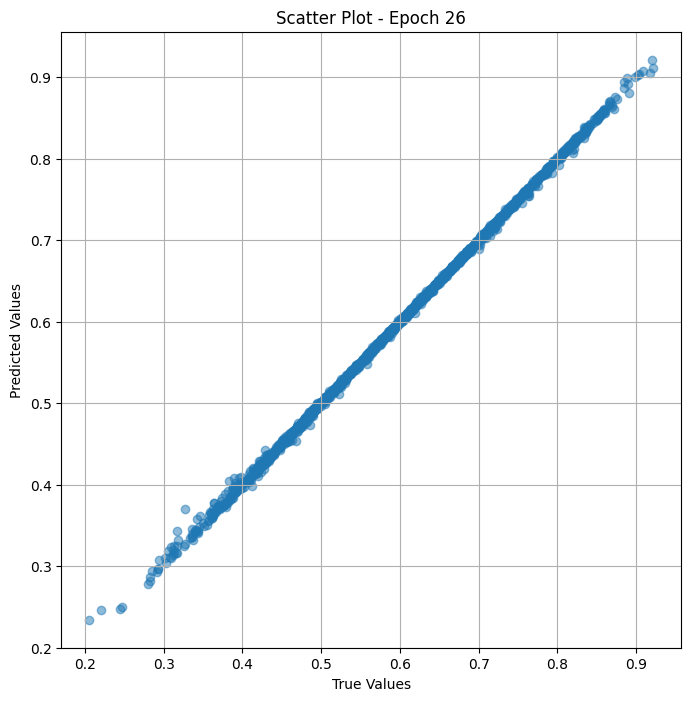

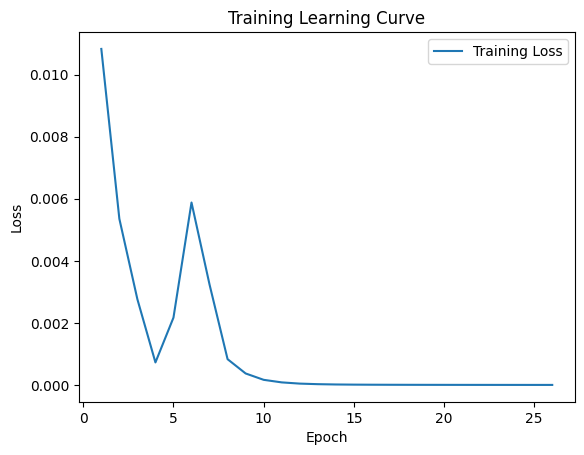


 Epoch: (27/50) Loss = 2.5956188665077207e-07

 Epoch: (27/50) Loss_rmse = 0.0005094721564091742

 Epoch: (27/50) R^2 = 0.9999760389328003

 Epoch: (27/50) MAE = 0.00037857890129089355
Spearman correlation coefficient: SignificanceResult(statistic=0.9999086503401855, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5

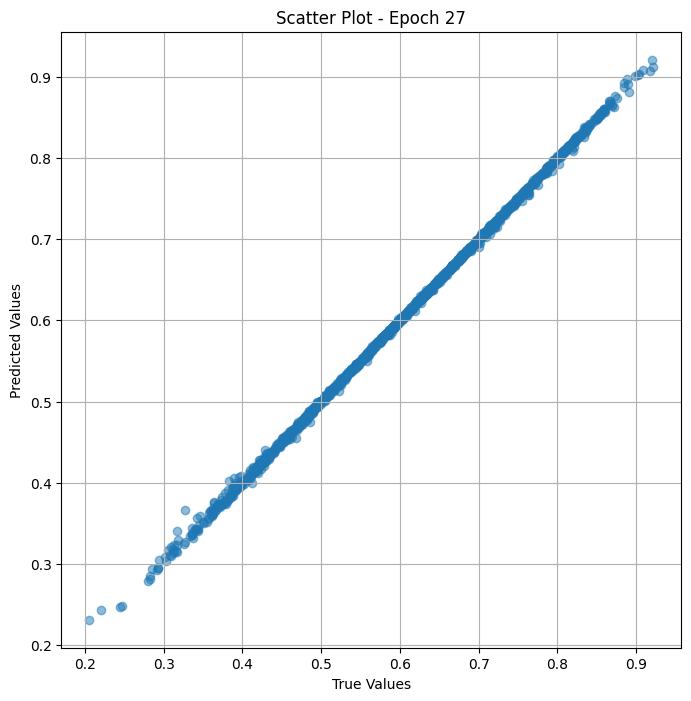

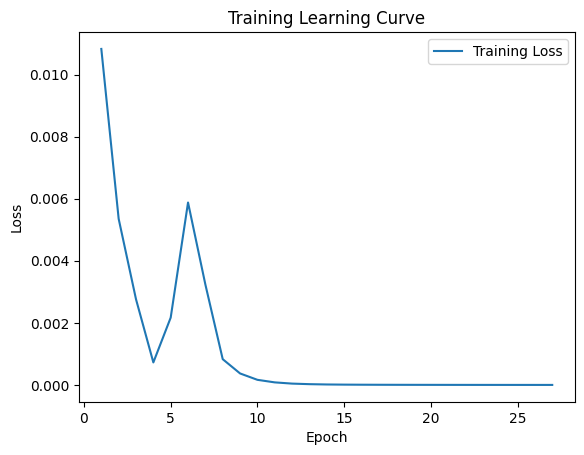


 Epoch: (28/50) Loss = 1.763506531915482e-07

 Epoch: (28/50) Loss_rmse = 0.00041994123603217304

 Epoch: (28/50) R^2 = 0.9999837279319763

 Epoch: (28/50) MAE = 0.00033295154571533203
Spearman correlation coefficient: SignificanceResult(statistic=0.9999294167929969, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5

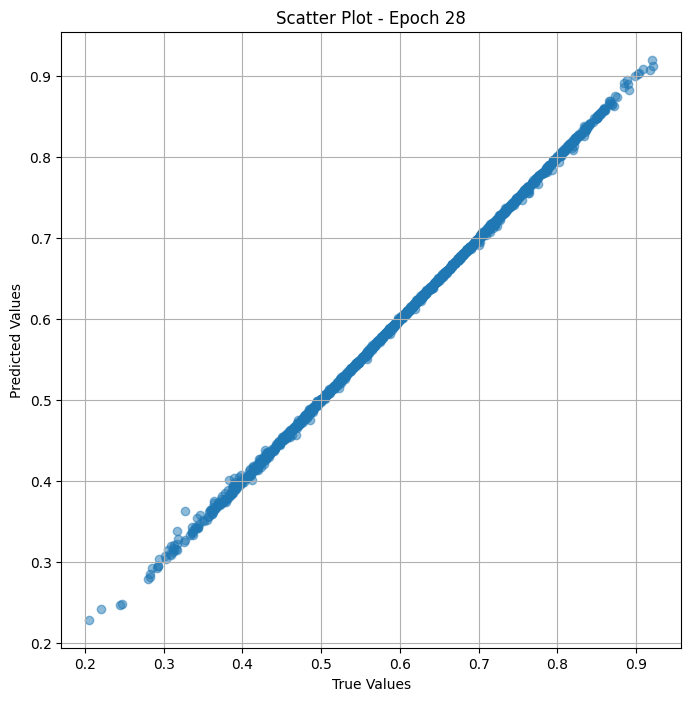

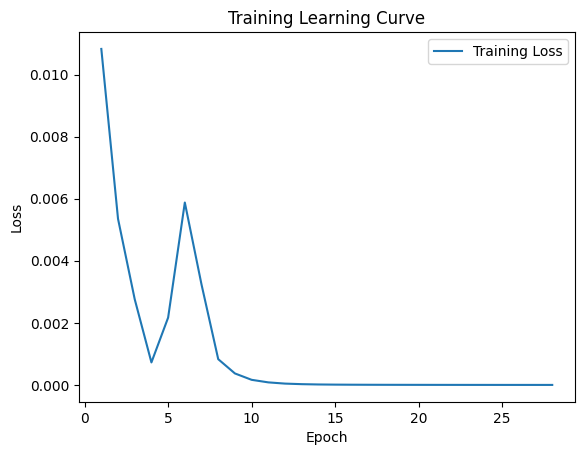


 Epoch: (29/50) Loss = 3.8177194028321537e-07

 Epoch: (29/50) Loss_rmse = 0.0006178769399411976

 Epoch: (29/50) R^2 = 0.999964714050293

 Epoch: (29/50) MAE = 0.0005178190767765045
Spearman correlation coefficient: SignificanceResult(statistic=0.9999451847834208, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

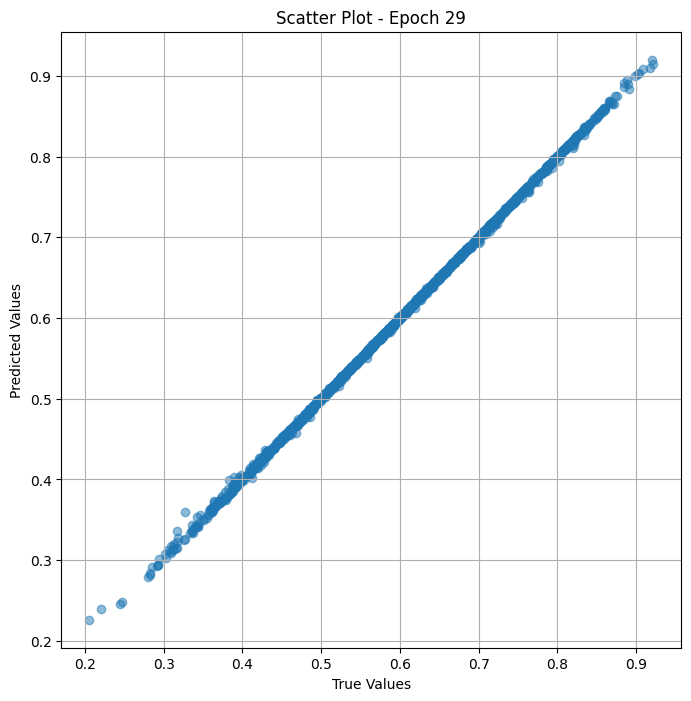

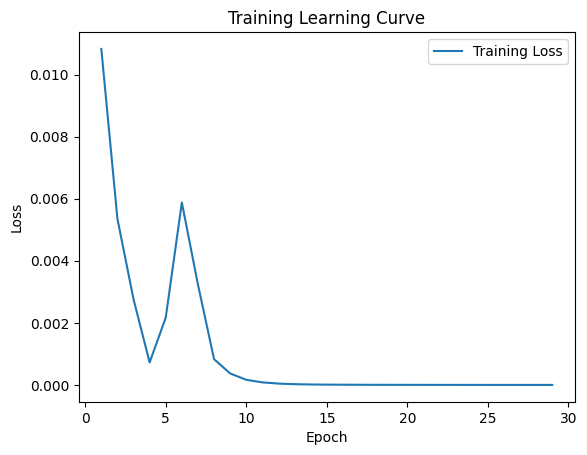


 Epoch: (30/50) Loss = 1.3137653240846703e-06

 Epoch: (30/50) Loss_rmse = 0.0011461960384622216

 Epoch: (30/50) R^2 = 0.9998785853385925

 Epoch: (30/50) MAE = 0.0006937533617019653
Spearman correlation coefficient: SignificanceResult(statistic=0.9999531016221409, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

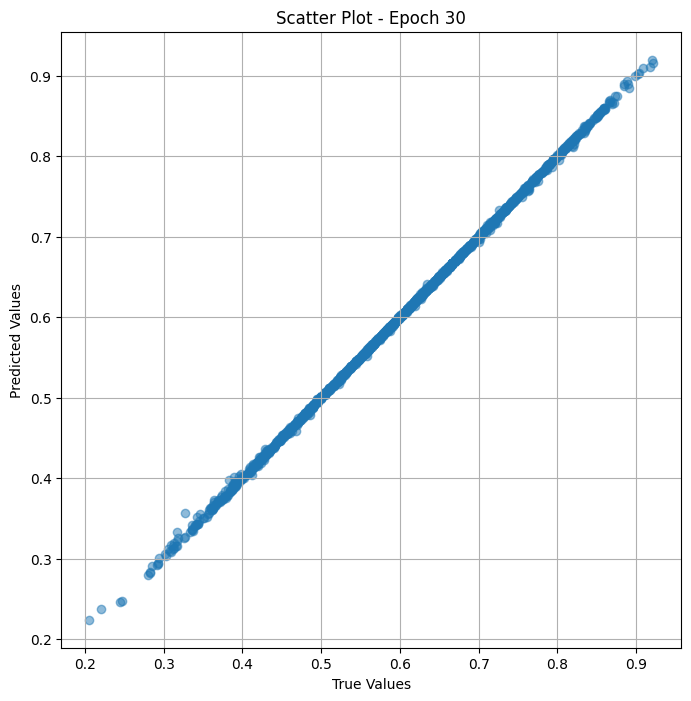

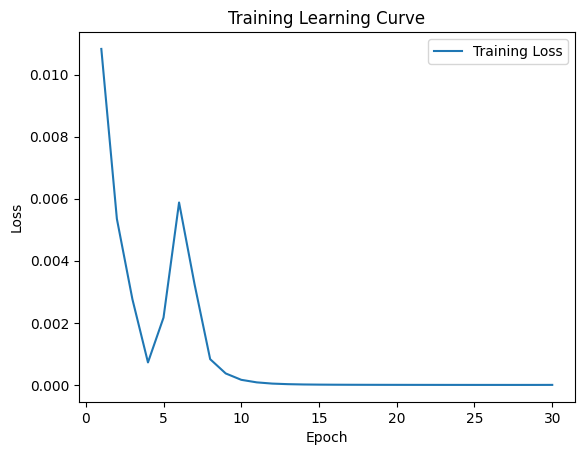

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (31/50) Loss = 1.4735183867742307e-05

 Epoch: (31/50) Loss_rmse = 0.003838643431663513

 Epoch: (31/50) R^2 = 0.9986382722854614

 Epoch: (31/50) MAE = 0.002459794282913208
Spearman correlation coefficient: SignificanceResult(statistic=0.9999466476208907, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 

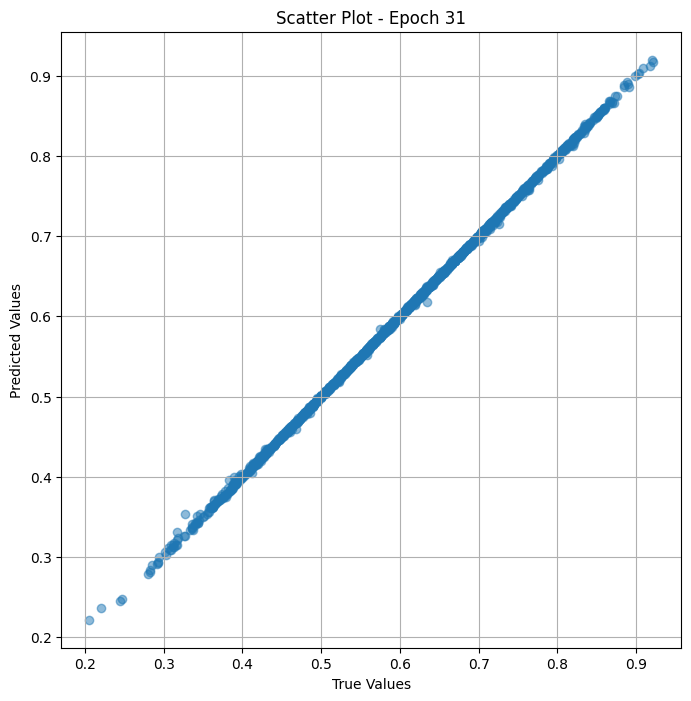

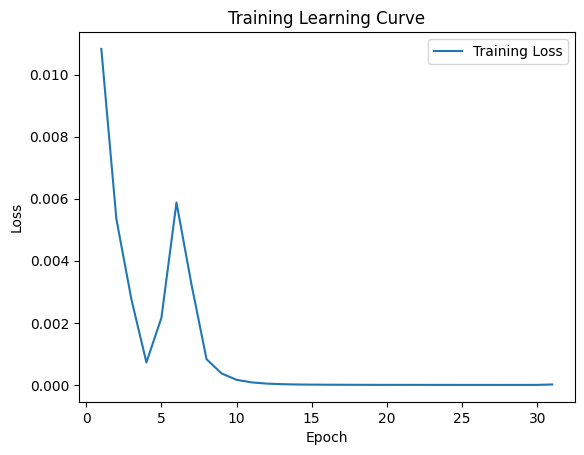


 Epoch: (32/50) Loss = 1.4251533002607175e-06

 Epoch: (32/50) Loss_rmse = 0.001193797797895968

 Epoch: (32/50) R^2 = 0.9998682737350464

 Epoch: (32/50) MAE = 0.0009756200015544891
Spearman correlation coefficient: SignificanceResult(statistic=0.999903091974973, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5961

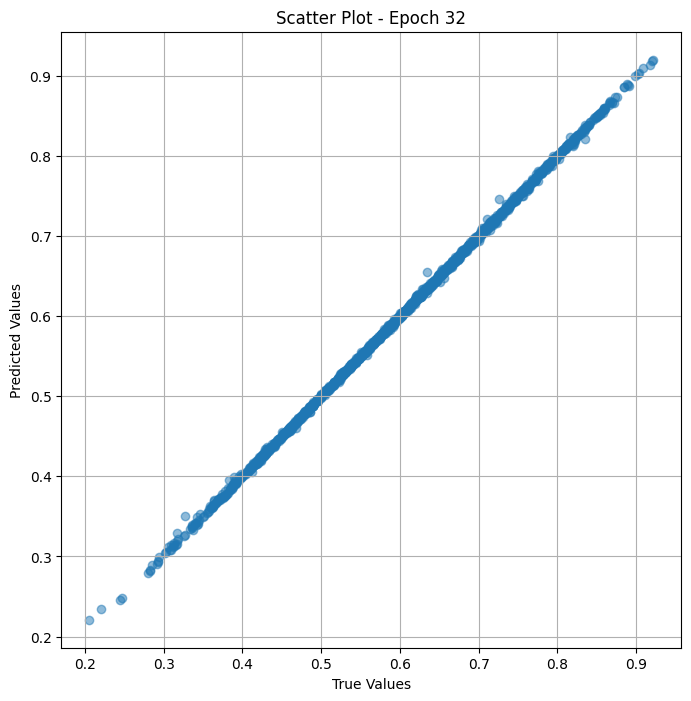

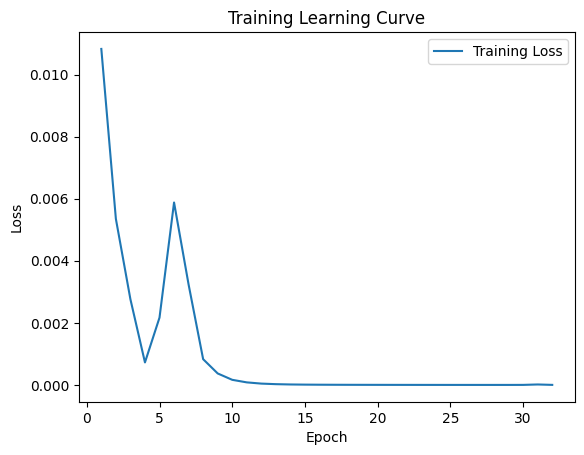


 Epoch: (33/50) Loss = 1.0262984915243578e-06

 Epoch: (33/50) Loss_rmse = 0.0010130639420822263

 Epoch: (33/50) R^2 = 0.9999051690101624

 Epoch: (33/50) MAE = 0.0008722841739654541
Spearman correlation coefficient: SignificanceResult(statistic=0.9999516007279627, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

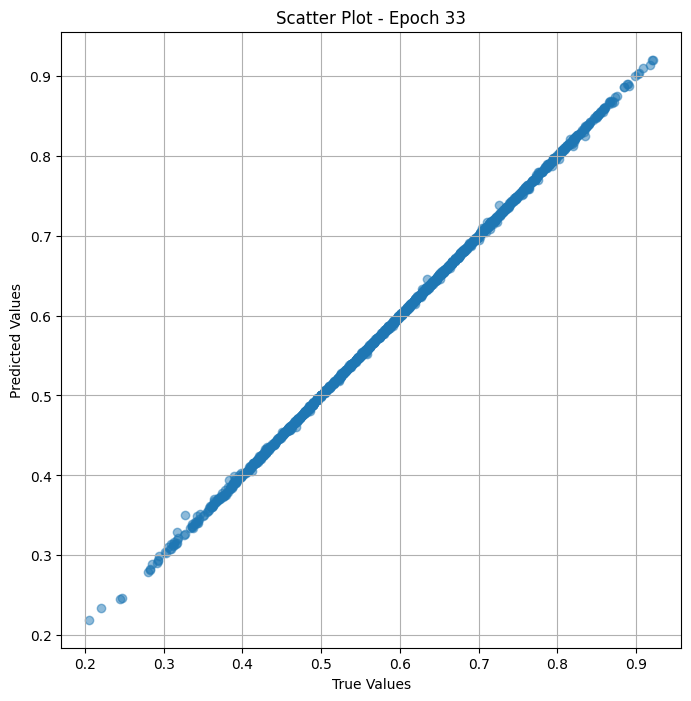

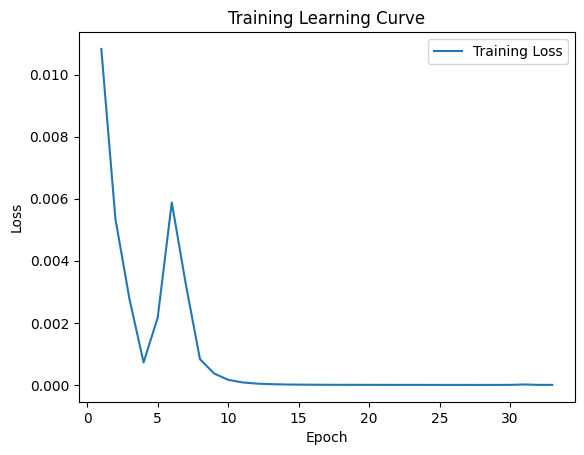

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (34/50) Loss = 5.086588998892694e-07

 Epoch: (34/50) Loss_rmse = 0.0007132032769732177

 Epoch: (34/50) R^2 = 0.9999529719352722

 Epoch: (34/50) MAE = 0.0006093792617321014
Spearman correlation coefficient: SignificanceResult(statistic=0.9999642600585513, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889,

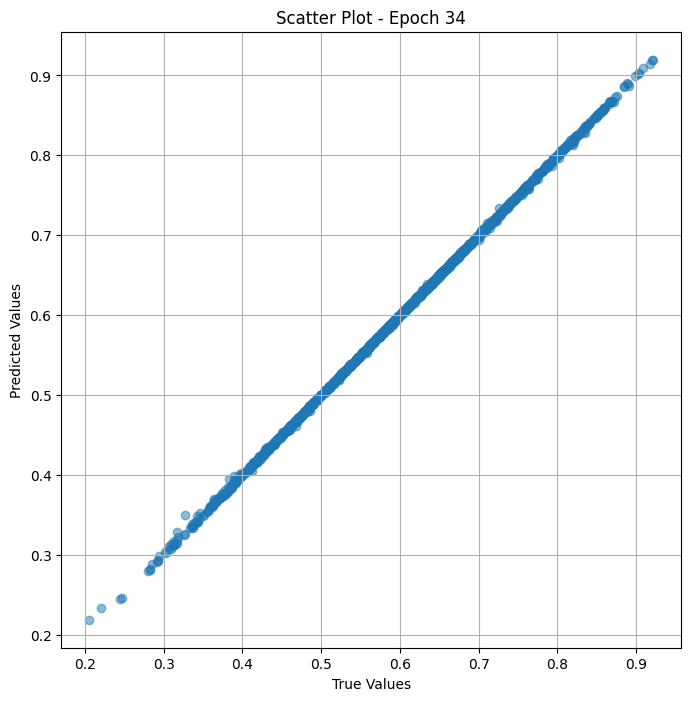

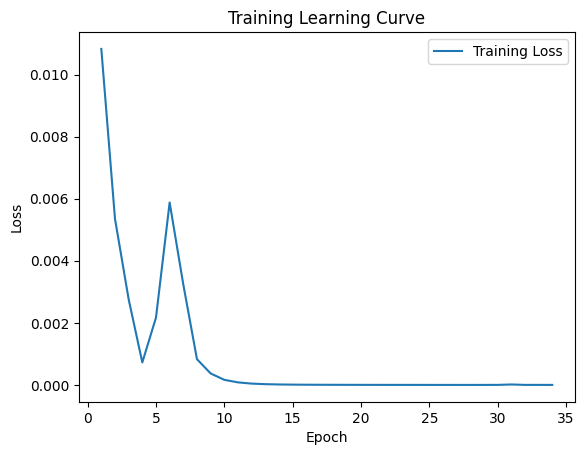


 Epoch: (35/50) Loss = 4.642292310563789e-07

 Epoch: (35/50) Loss_rmse = 0.0006813437212258577

 Epoch: (35/50) R^2 = 0.9999570846557617

 Epoch: (35/50) MAE = 0.0005802027881145477
Spearman correlation coefficient: SignificanceResult(statistic=0.9999707349127944, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

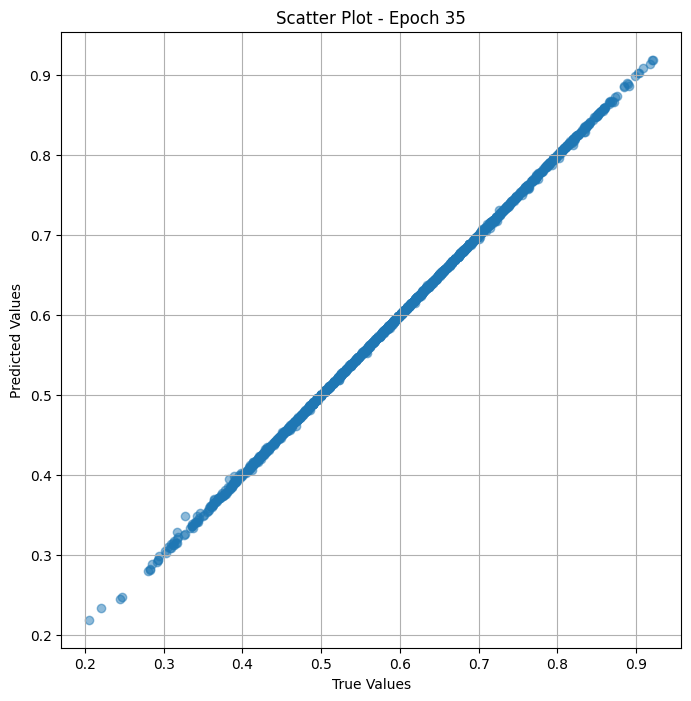

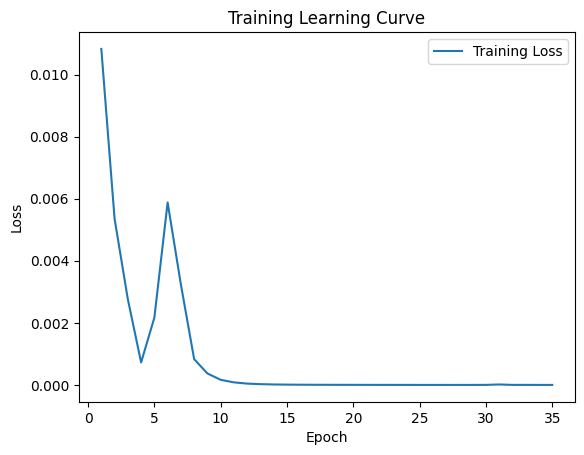


 Epoch: (36/50) Loss = 4.582176700296259e-07

 Epoch: (36/50) Loss_rmse = 0.0006769177853129804

 Epoch: (36/50) R^2 = 0.9999576807022095

 Epoch: (36/50) MAE = 0.0005751848220825195
Spearman correlation coefficient: SignificanceResult(statistic=0.9999710278973261, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

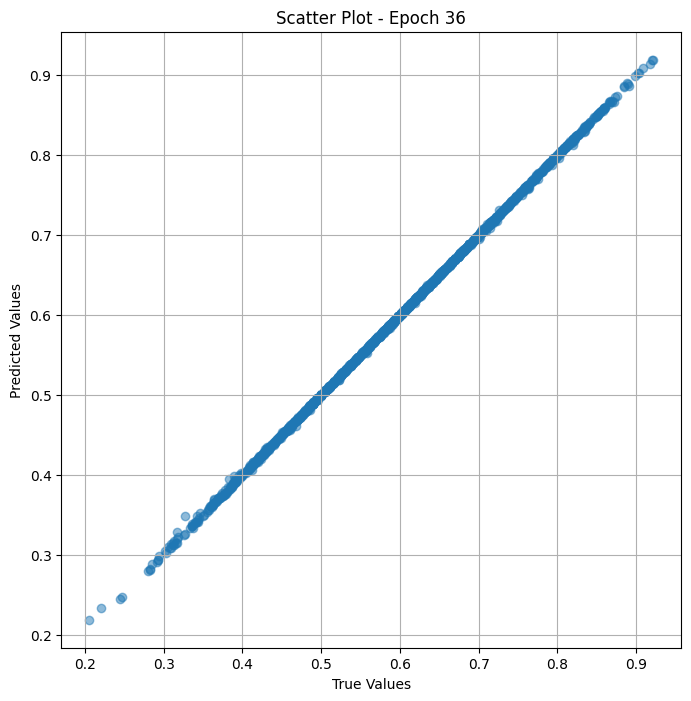

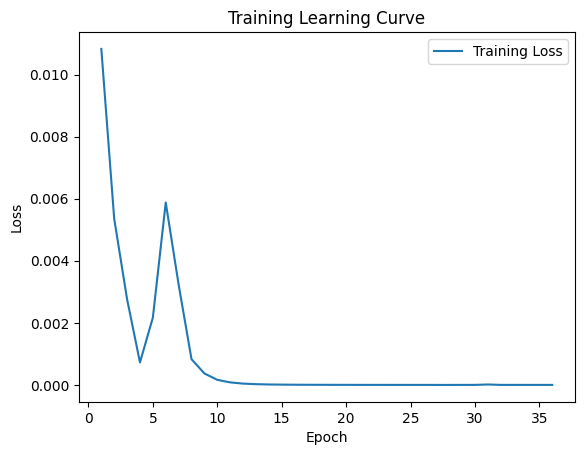

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (37/50) Loss = 4.480624511415954e-07

 Epoch: (37/50) Loss_rmse = 0.0006693746545352042

 Epoch: (37/50) R^2 = 0.9999585747718811

 Epoch: (37/50) MAE = 0.0005675144493579865
Spearman correlation coefficient: SignificanceResult(statistic=0.9999713375642844, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889,

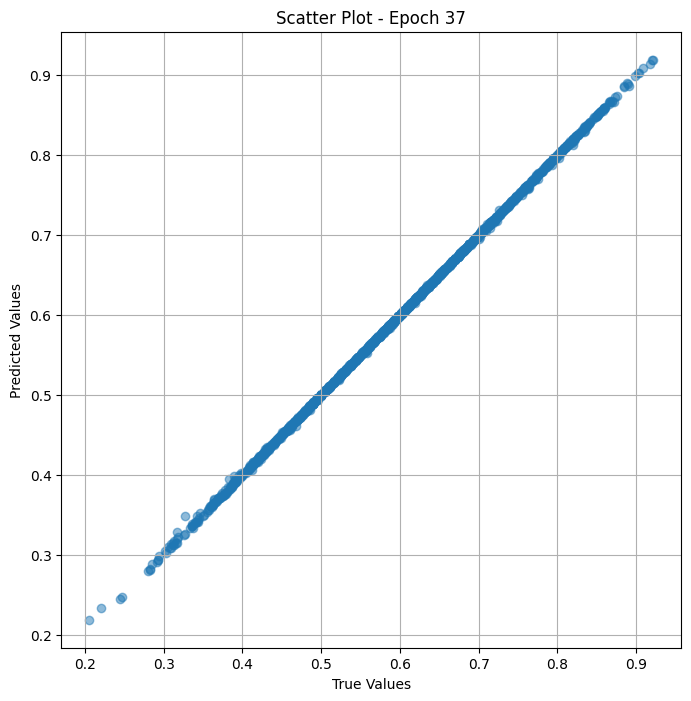

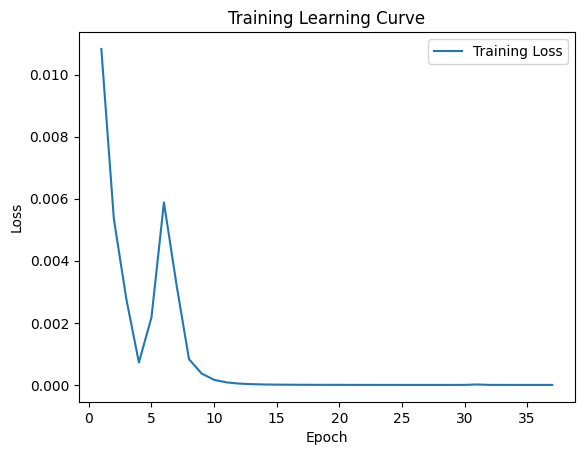


 Epoch: (38/50) Loss = 4.4499822138277523e-07

 Epoch: (38/50) Loss_rmse = 0.0006670818547718227

 Epoch: (38/50) R^2 = 0.999958872795105

 Epoch: (38/50) MAE = 0.0005654767155647278
Spearman correlation coefficient: SignificanceResult(statistic=0.9999715919707957, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

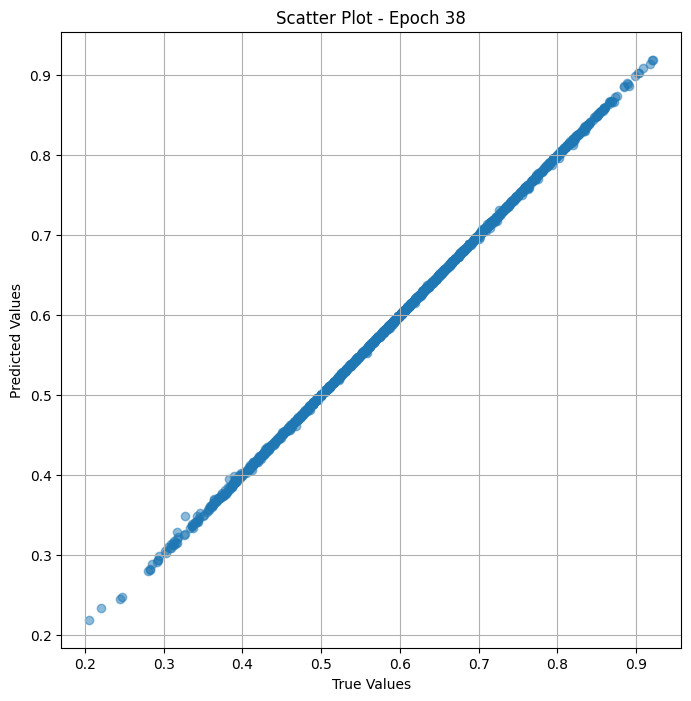

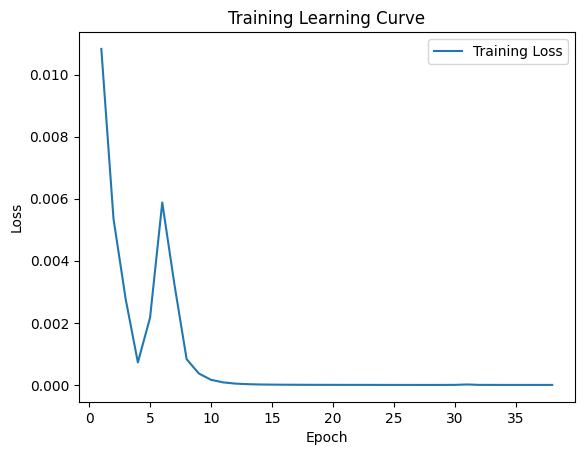


 Epoch: (39/50) Loss = 4.451162567420397e-07

 Epoch: (39/50) Loss_rmse = 0.0006671703304164112

 Epoch: (39/50) R^2 = 0.999958872795105

 Epoch: (39/50) MAE = 0.0005654804408550262
Spearman correlation coefficient: SignificanceResult(statistic=0.9999715919707957, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5961

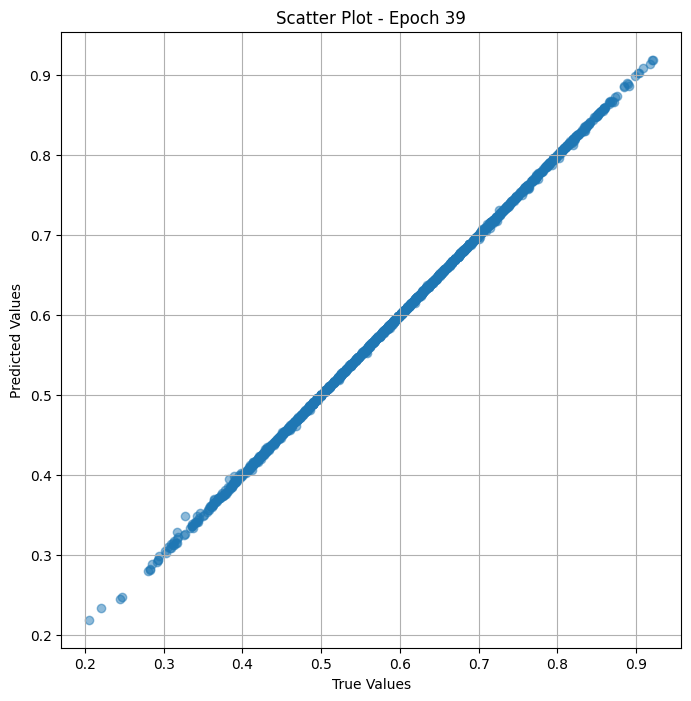

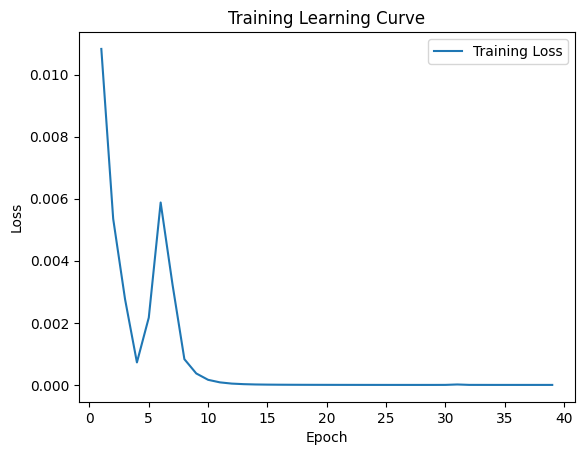


 Epoch: (40/50) Loss = 4.4556603029377584e-07

 Epoch: (40/50) Loss_rmse = 0.0006675073527731001

 Epoch: (40/50) R^2 = 0.9999588131904602

 Epoch: (40/50) MAE = 0.0005657374858856201
Spearman correlation coefficient: SignificanceResult(statistic=0.999971616994371, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

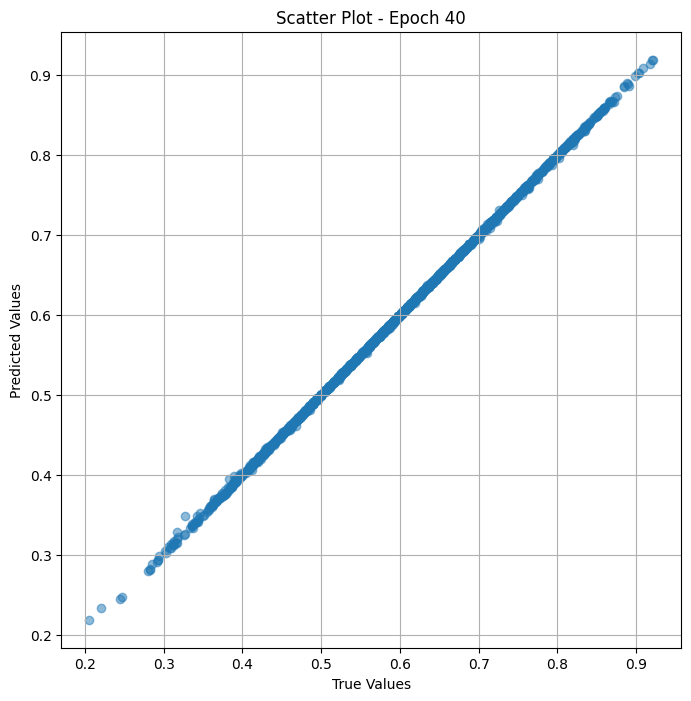

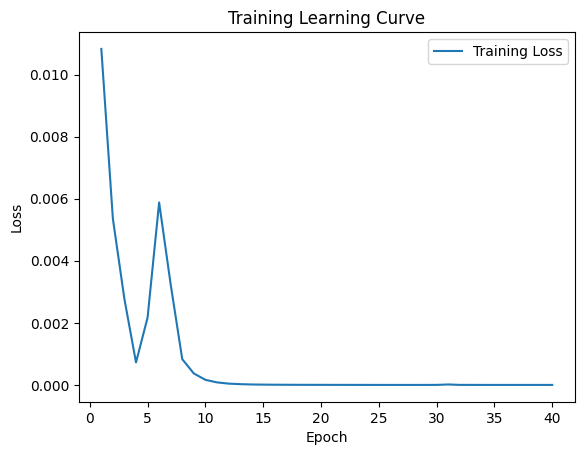


 Epoch: (41/50) Loss = 4.4585732439372805e-07

 Epoch: (41/50) Loss_rmse = 0.0006677254568785429

 Epoch: (41/50) R^2 = 0.9999588131904602

 Epoch: (41/50) MAE = 0.0005657821893692017
Spearman correlation coefficient: SignificanceResult(statistic=0.9999716133450973, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

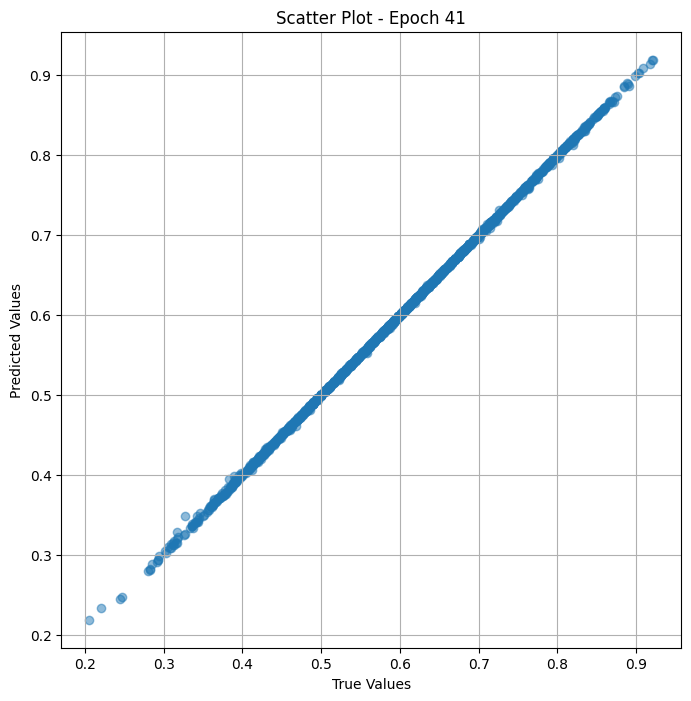

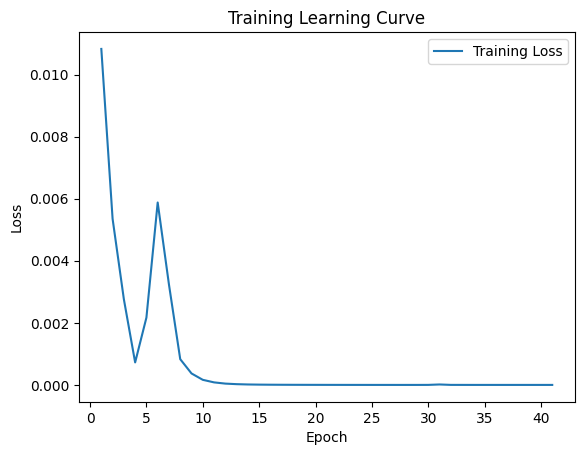


 Epoch: (42/50) Loss = 4.4579945779332775e-07

 Epoch: (42/50) Loss_rmse = 0.0006676821503788233

 Epoch: (42/50) R^2 = 0.9999588131904602

 Epoch: (42/50) MAE = 0.0005655661225318909
Spearman correlation coefficient: SignificanceResult(statistic=0.9999716013546426, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

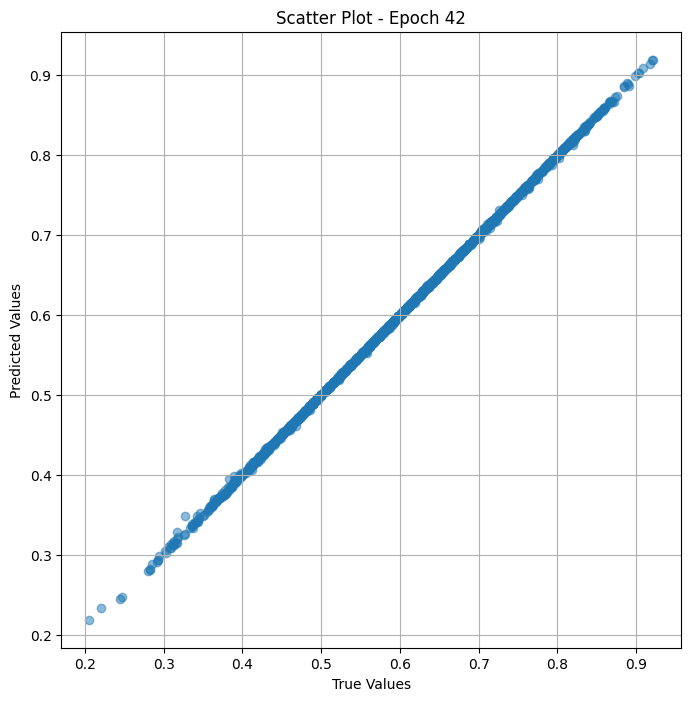

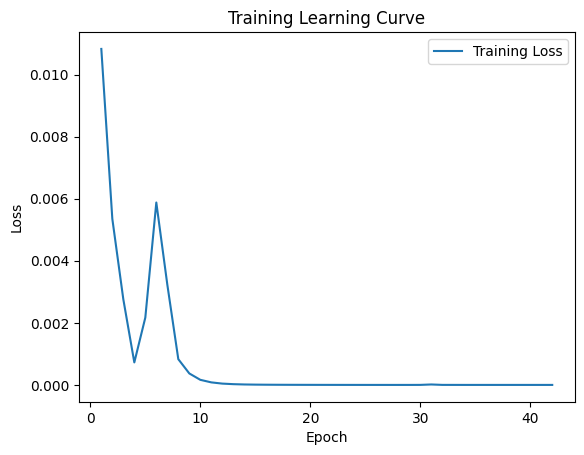


 Epoch: (43/50) Loss = 4.462480092115584e-07

 Epoch: (43/50) Loss_rmse = 0.0006680179503746331

 Epoch: (43/50) R^2 = 0.9999587535858154

 Epoch: (43/50) MAE = 0.0005658119916915894
Spearman correlation coefficient: SignificanceResult(statistic=0.9999715888428468, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

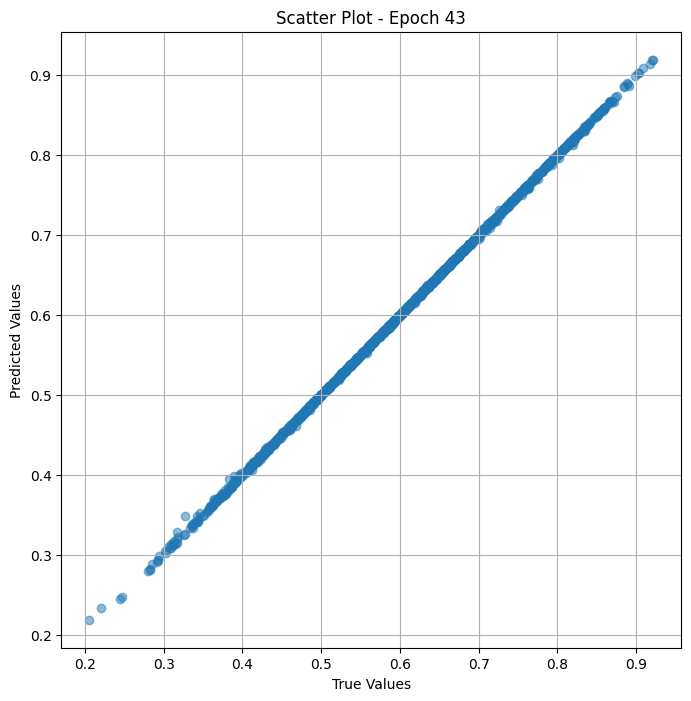

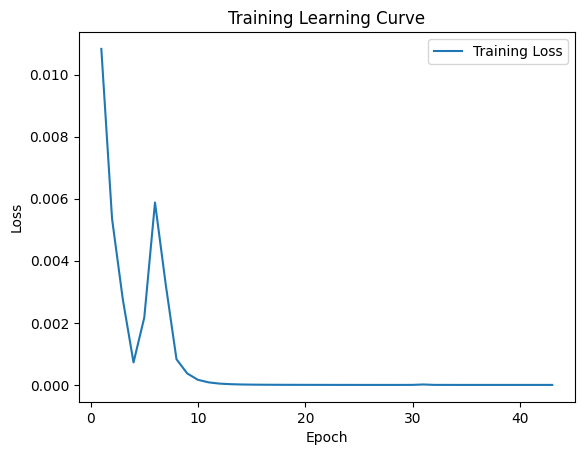


 Epoch: (44/50) Loss = 4.463963705347851e-07

 Epoch: (44/50) Loss_rmse = 0.000668129010591656

 Epoch: (44/50) R^2 = 0.9999587535858154

 Epoch: (44/50) MAE = 0.000565841794013977
Spearman correlation coefficient: SignificanceResult(statistic=0.9999715888428468, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59615

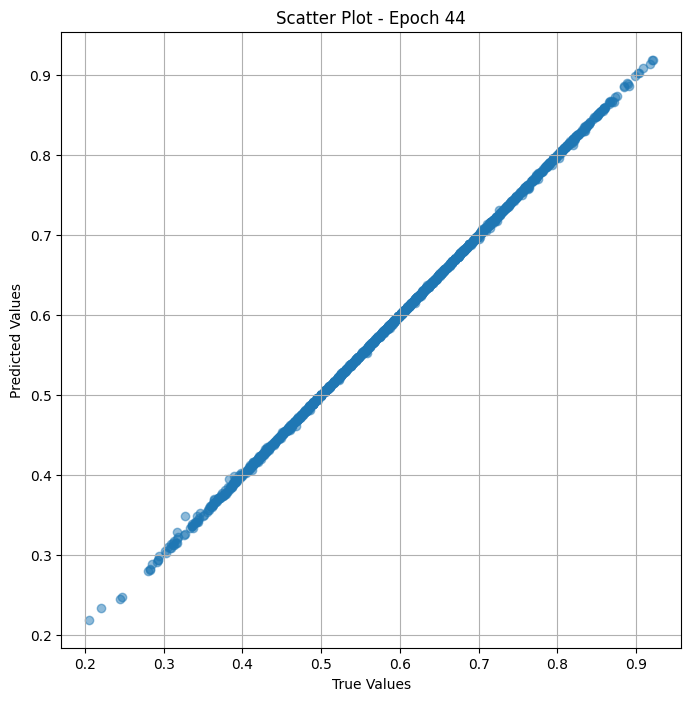

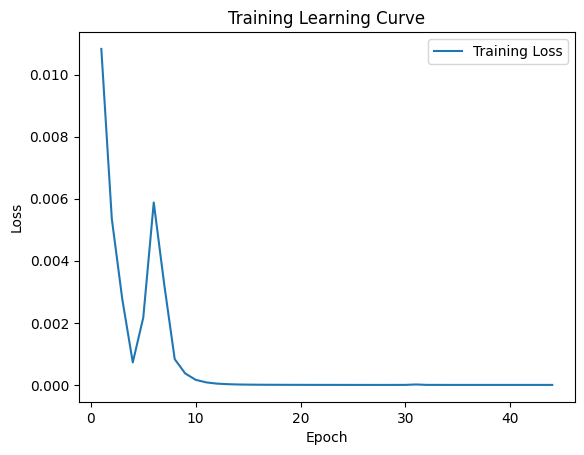


 Epoch: (45/50) Loss = 4.465956067178922e-07

 Epoch: (45/50) Loss_rmse = 0.0006682780804112554

 Epoch: (45/50) R^2 = 0.9999587535858154

 Epoch: (45/50) MAE = 0.0005657859146595001
Spearman correlation coefficient: SignificanceResult(statistic=0.9999715862362067, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

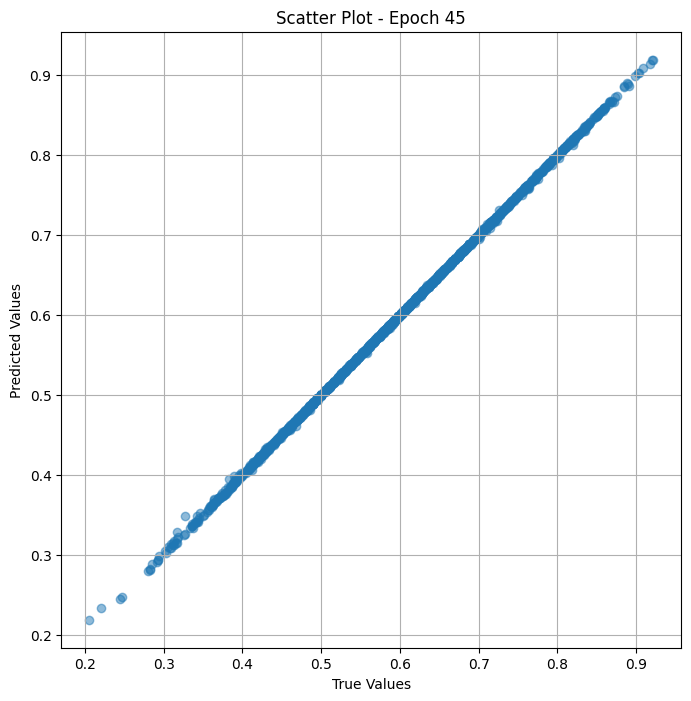

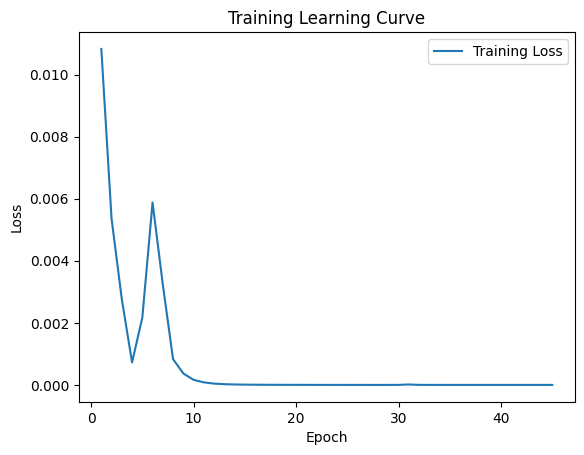


 Epoch: (46/50) Loss = 4.4663957510238106e-07

 Epoch: (46/50) Loss_rmse = 0.0006683109677396715

 Epoch: (46/50) R^2 = 0.9999587535858154

 Epoch: (46/50) MAE = 0.000565744936466217
Spearman correlation coefficient: SignificanceResult(statistic=0.9999715586060073, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

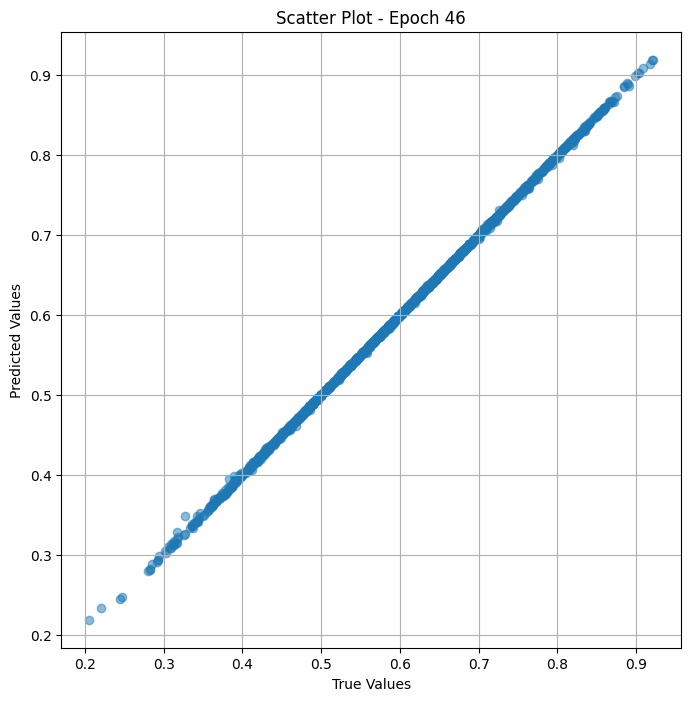

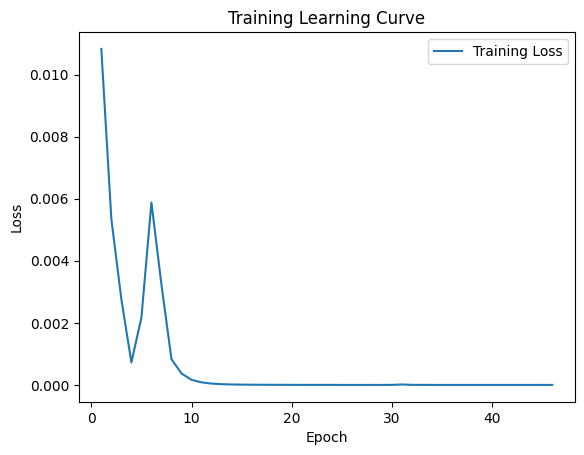


 Epoch: (47/50) Loss = 4.463838649826357e-07

 Epoch: (47/50) Loss_rmse = 0.0006681196391582489

 Epoch: (47/50) R^2 = 0.9999587535858154

 Epoch: (47/50) MAE = 0.0005655065178871155
Spearman correlation coefficient: SignificanceResult(statistic=0.9999715930134453, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

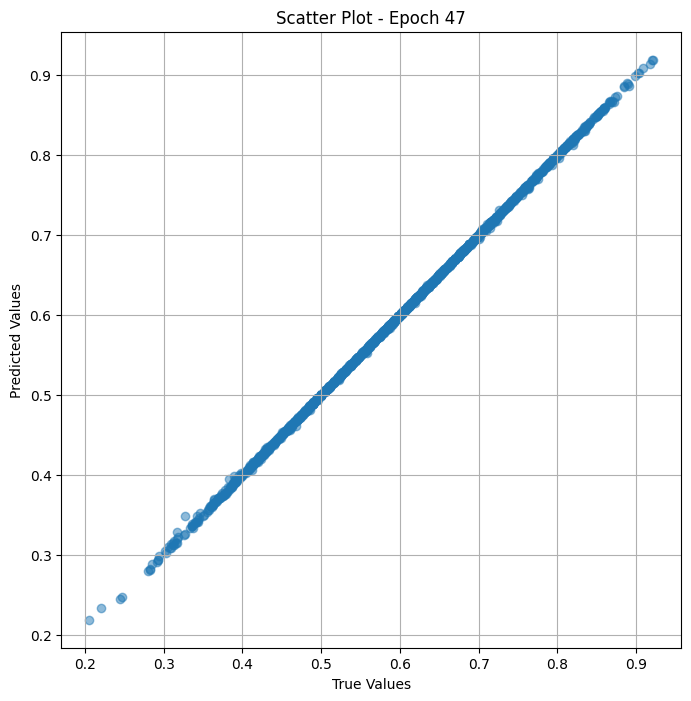

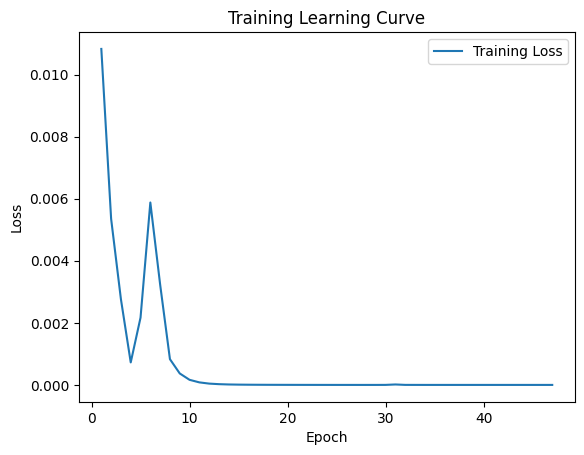


 Epoch: (48/50) Loss = 4.4681829081127944e-07

 Epoch: (48/50) Loss_rmse = 0.0006684446707367897

 Epoch: (48/50) R^2 = 0.9999586939811707

 Epoch: (48/50) MAE = 0.0005657076835632324
Spearman correlation coefficient: SignificanceResult(statistic=0.9999716242929347, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.59

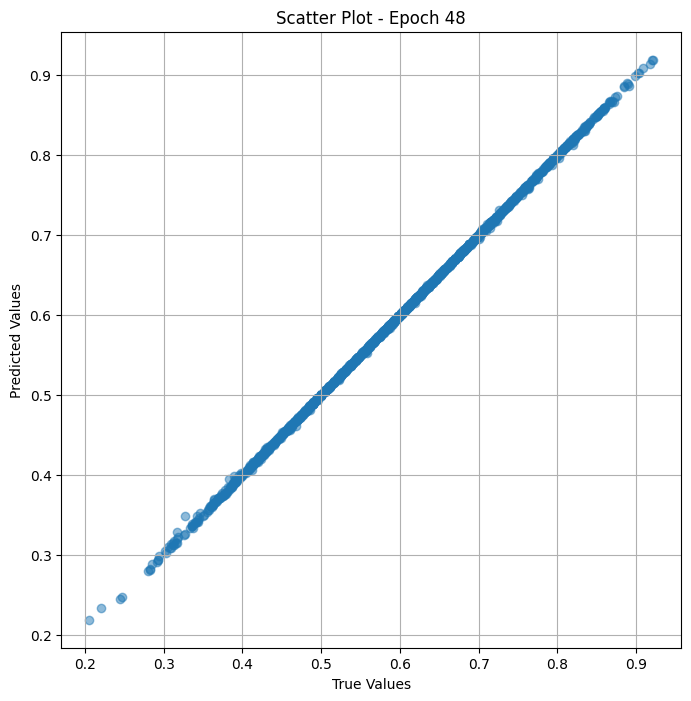

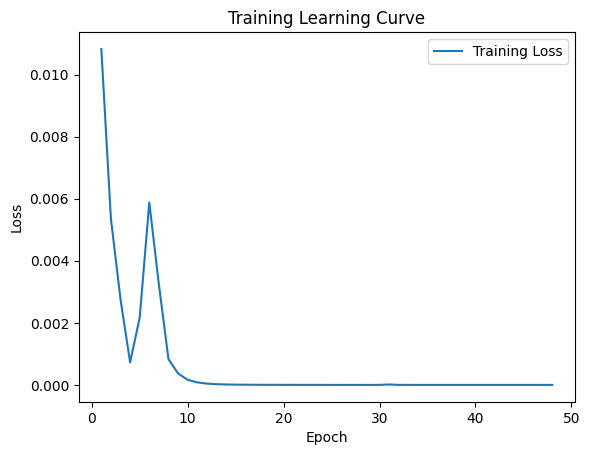


 Epoch: (49/50) Loss = 4.4687115519082e-07

 Epoch: (49/50) Loss_rmse = 0.00066848419373855

 Epoch: (49/50) R^2 = 0.9999586939811707

 Epoch: (49/50) MAE = 0.0005656443536281586
Spearman correlation coefficient: SignificanceResult(statistic=0.9999716701695184, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.5961538

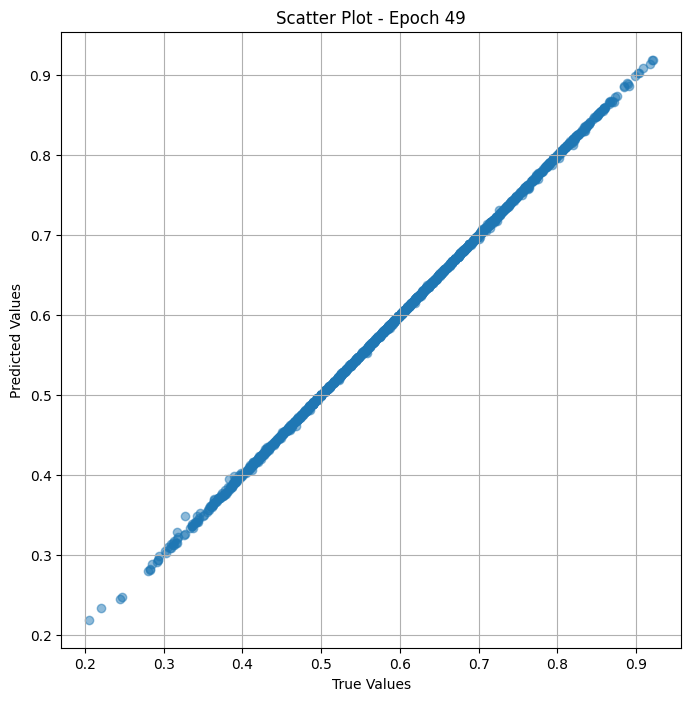

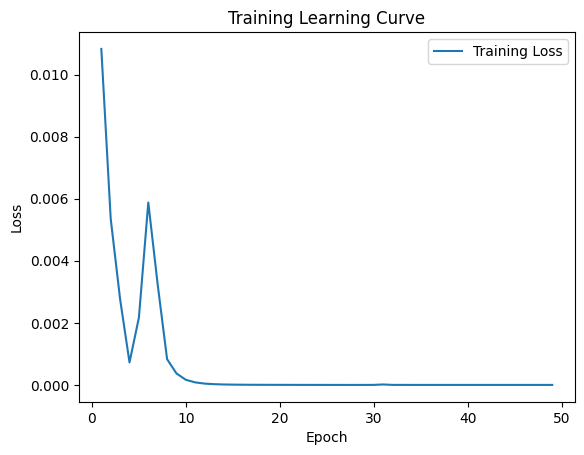


 Epoch: (50/50) Loss = 4.4673257093563734e-07

 Epoch: (50/50) Loss_rmse = 0.000668380584102124

 Epoch: (50/50) R^2 = 0.9999586939811707

 Epoch: (50/50) MAE = 0.0005653798580169678
Spearman correlation coefficient: SignificanceResult(statistic=0.9999717014490076, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.5619048, 0.63917524, 0.31683168, 0.5980392, 0.6203704, 0.47272727, 0.7570093, 0.61946905, 0.51648355, 0.4528302, 0.53061223, 0.53932583, 0.56122446, 0.5445545, 0.6, 0.43, 0.6964286, 0.8018018, 0.6262626, 0.61165047, 0.33653846, 0.5252525, 0.45714286, 0.82608694, 0.59375, 0.44827586, 0.61764705, 0.5154639, 0.70642203, 0.8103448, 0.42105263, 0.81914896, 0.3877551, 0.8372093, 0.70526314, 0.43564355, 0.5913978, 0.814433, 0.72839504, 0.53636366, 0.40860215, 0.6037736, 0.7029703, 0.5904762, 0.6960784, 0.6236559, 0.74766356, 0.6632653, 0.6847826, 0.5051546, 0.7888889, 0.48076922, 0.6875, 0.45918366, 0.43010753, 0.5934066, 0.596

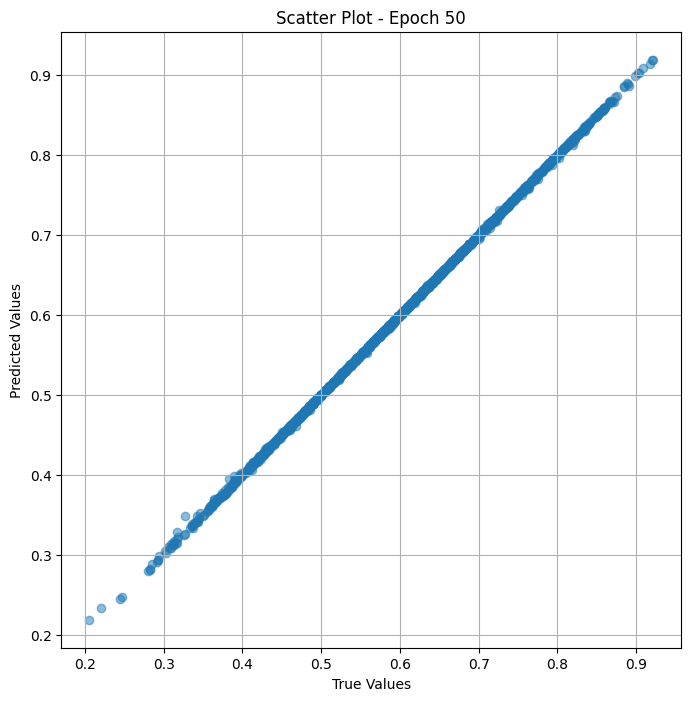

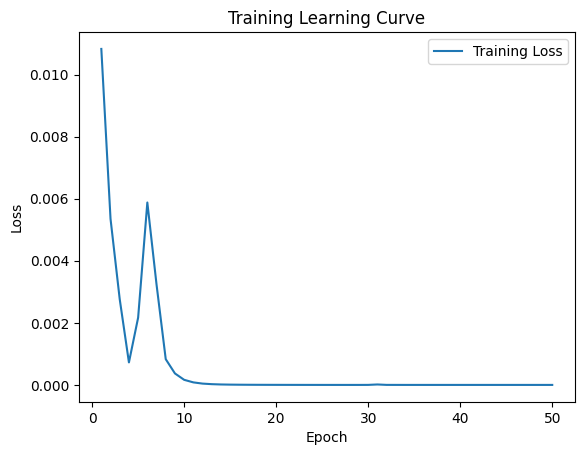

In [ ]:
# Training the model and save weights
fit(50,model_res_fine , train_dl_fine)
torch.save(model_res_fine.state_dict(), "model_weights_fine")

## valid

In [ ]:
params = [param for param in list(model_res_val .parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-4,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Val Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res_val, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res_val.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res_val(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 2.0269439119147137e-05

 Epoch: (1/50) Loss_rmse = 0.004502159543335438

 Epoch: (1/50) R^2 = 0.999251663684845

 Epoch: (1/50) MAE = 0.004201270639896393
Spearman correlation coefficient: SignificanceResult(statistic=0.9989486967511584, pvalue=1.1845739316392545e-127)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3168

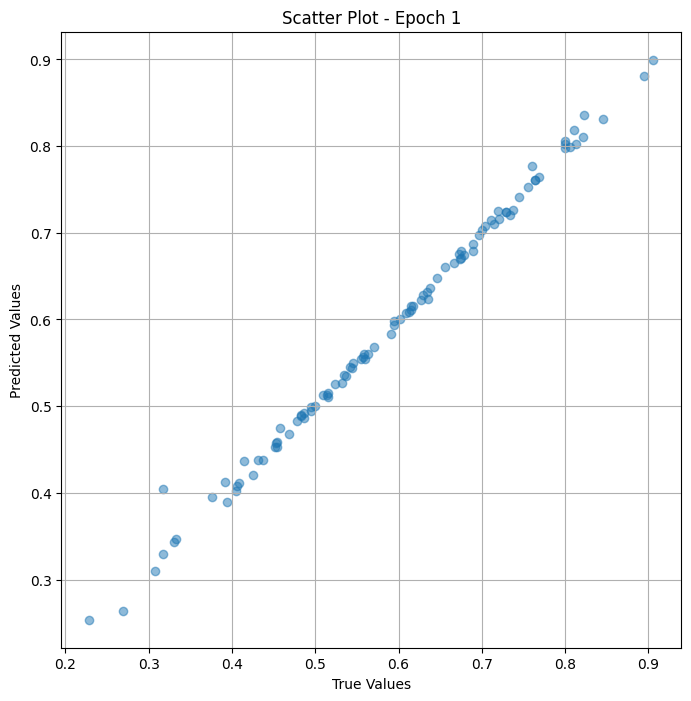

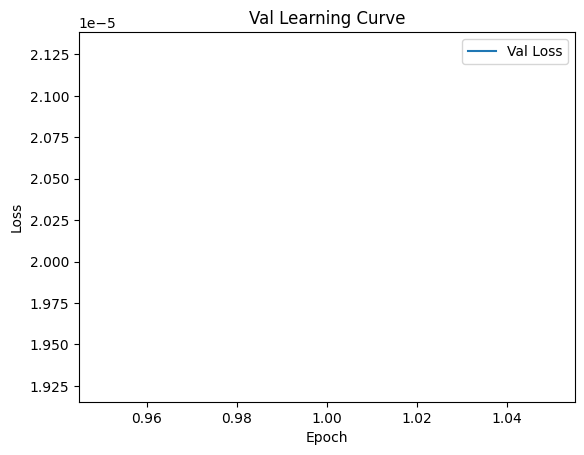


 Epoch: (2/50) Loss = 0.0028994777239859104

 Epoch: (2/50) Loss_rmse = 0.053846798837184906

 Epoch: (2/50) R^2 = 0.8929568529129028

 Epoch: (2/50) MAE = 0.05171230435371399
Spearman correlation coefficient: SignificanceResult(statistic=0.9955913077811499, pvalue=2.0045871504938614e-98)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.316831

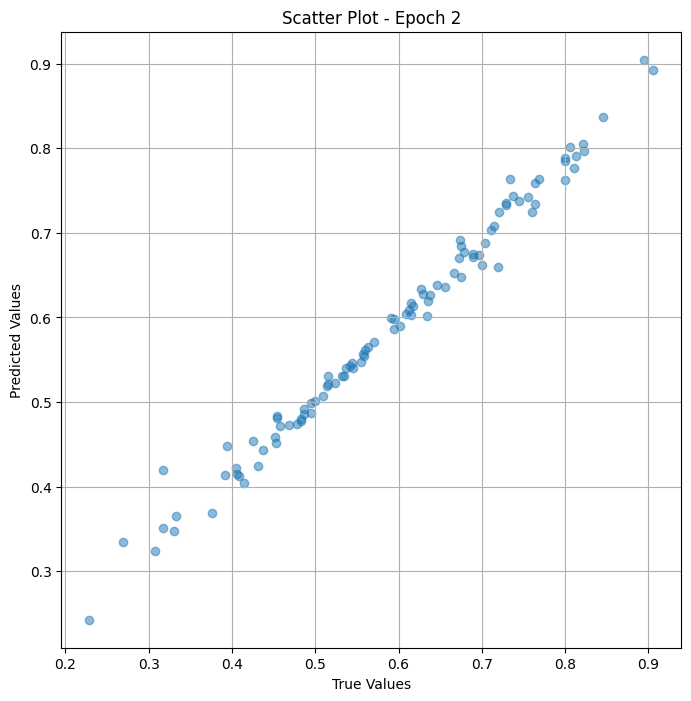

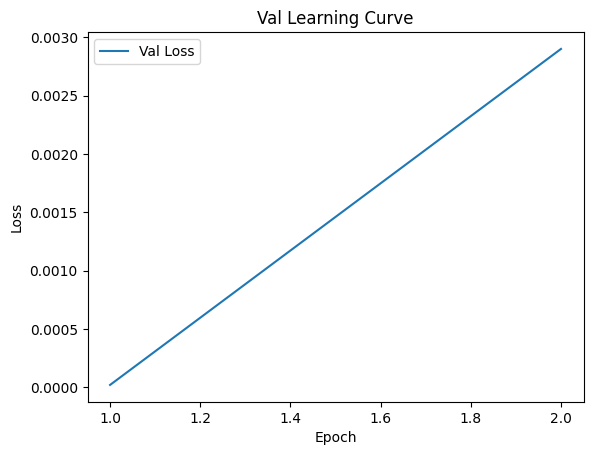


 Epoch: (3/50) Loss = 0.002517830580472946

 Epoch: (3/50) Loss_rmse = 0.05017798766493797

 Epoch: (3/50) R^2 = 0.9070465564727783

 Epoch: (3/50) MAE = 0.04870627820491791
Spearman correlation coefficient: SignificanceResult(statistic=0.998372175412874, pvalue=9.823377938030671e-119)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31683168,

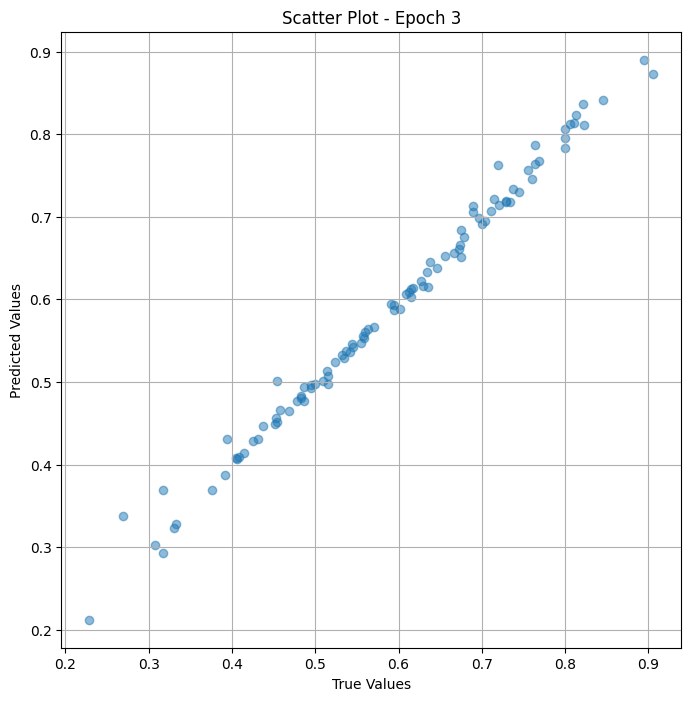

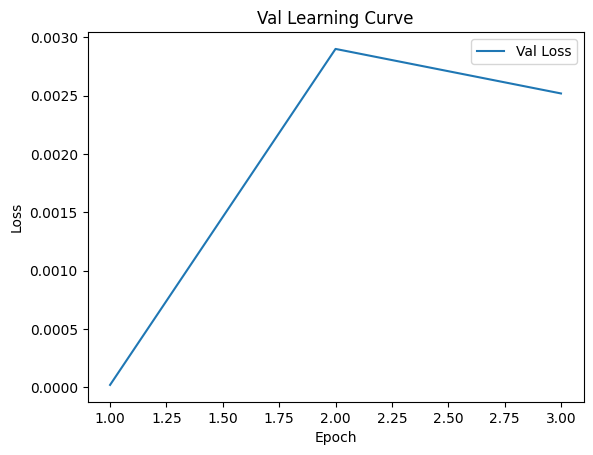

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (4/50) Loss = 0.0004984869156032801

 Epoch: (4/50) Loss_rmse = 0.022326821461319923

 Epoch: (4/50) R^2 = 0.981596827507019

 Epoch: (4/50) MAE = 0.01960190385580063
Spearman correlation coefficient: SignificanceResult(statistic=0.9989486967511584, pvalue=1.1845739316392545e-127)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5

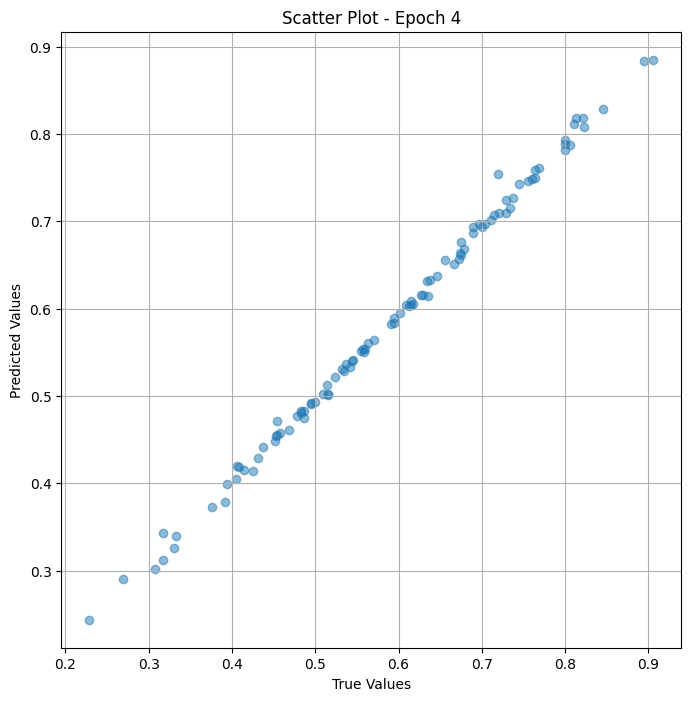

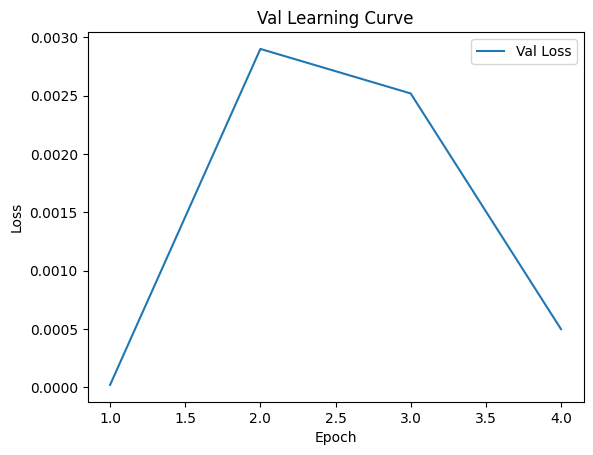


 Epoch: (5/50) Loss = 0.00019959031487815082

 Epoch: (5/50) Loss_rmse = 0.014127643778920174

 Epoch: (5/50) R^2 = 0.9926314949989319

 Epoch: (5/50) MAE = 0.013570457696914673
Spearman correlation coefficient: SignificanceResult(statistic=0.9991657400785124, pvalue=2.2679554888627212e-132)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.316

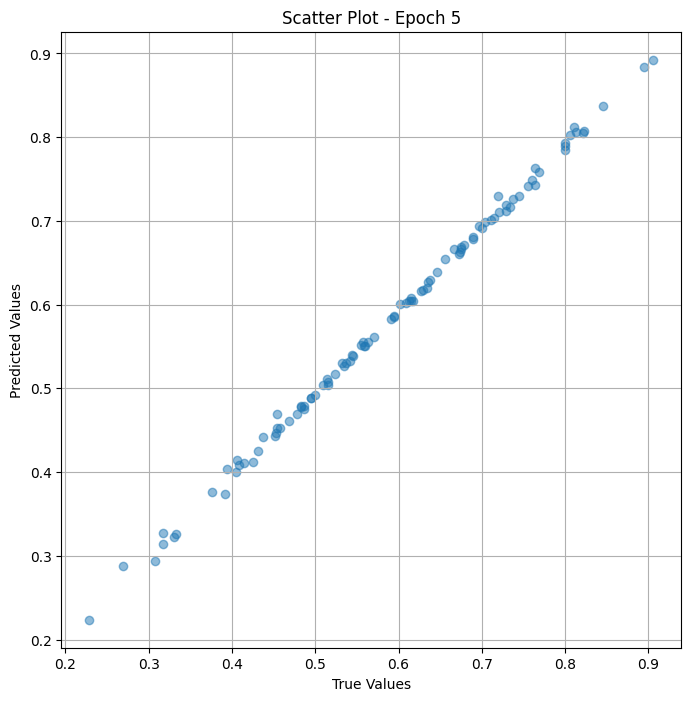

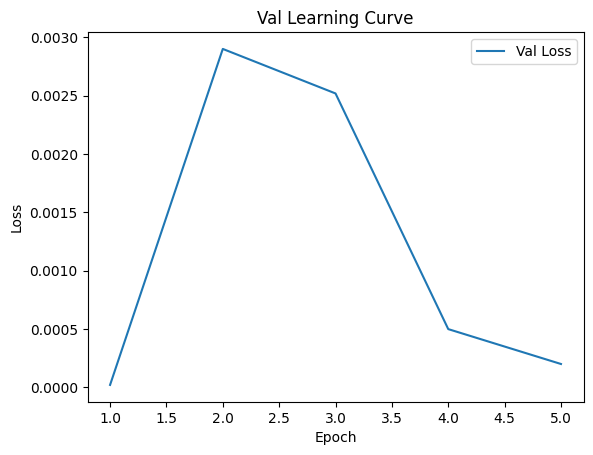


 Epoch: (6/50) Loss = 0.0001361251197522506

 Epoch: (6/50) Loss_rmse = 0.011667267419397831

 Epoch: (6/50) R^2 = 0.9949744939804077

 Epoch: (6/50) MAE = 0.011137664318084717
Spearman correlation coefficient: SignificanceResult(statistic=0.9992742617421896, pvalue=3.252312785109503e-135)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31683

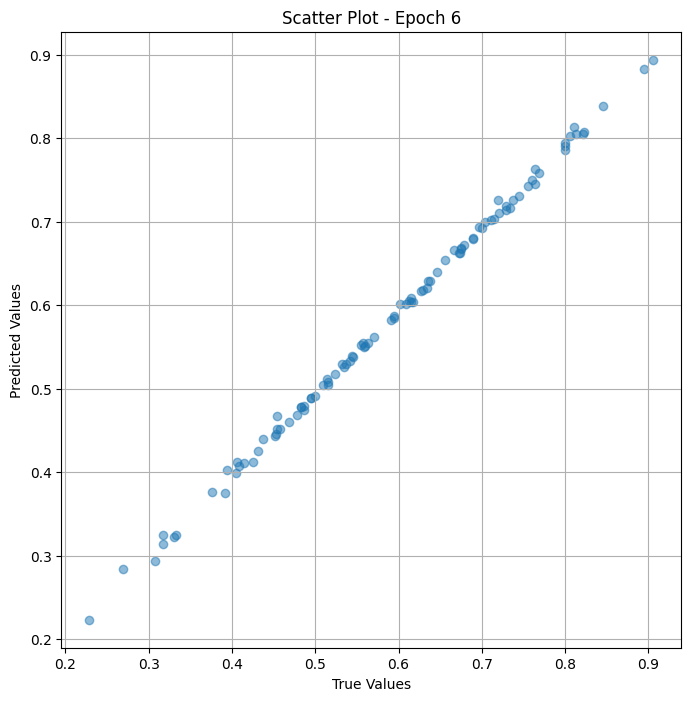

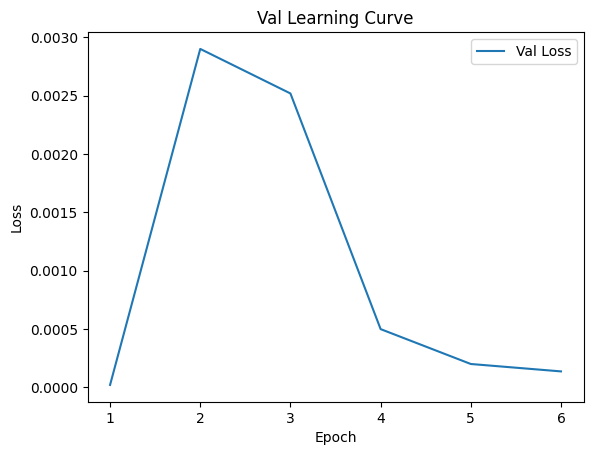

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (7/50) Loss = 7.698617991991341e-05

 Epoch: (7/50) Loss_rmse = 0.00877417717128992

 Epoch: (7/50) R^2 = 0.9971578121185303

 Epoch: (7/50) MAE = 0.008393436670303345
Spearman correlation coefficient: SignificanceResult(statistic=0.9994099138217859, pvalue=1.949325825551002e-139)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5

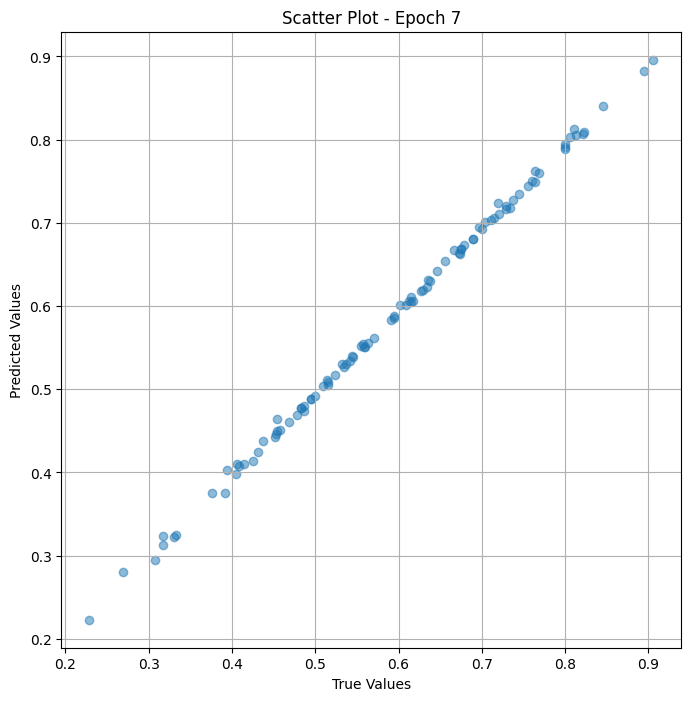

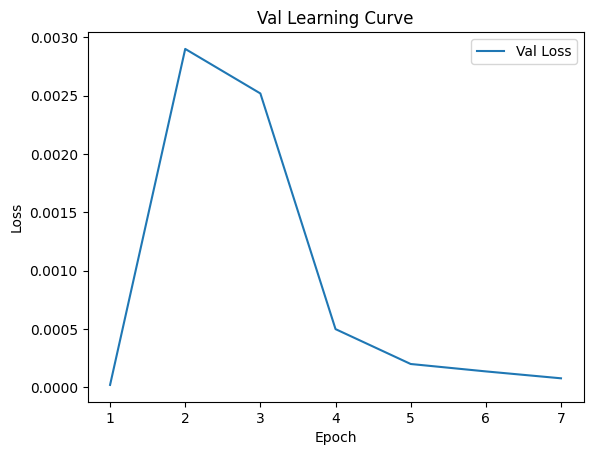


 Epoch: (8/50) Loss = 5.923294520471245e-05

 Epoch: (8/50) Loss_rmse = 0.007696294225752354

 Epoch: (8/50) R^2 = 0.9978132247924805

 Epoch: (8/50) MAE = 0.007399469614028931
Spearman correlation coefficient: SignificanceResult(statistic=0.9994234790297455, pvalue=6.535841122575985e-140)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31683

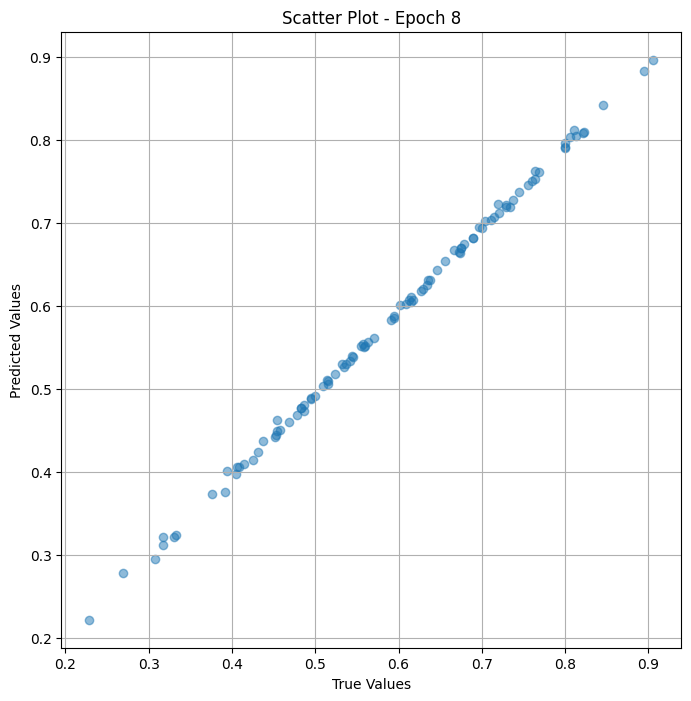

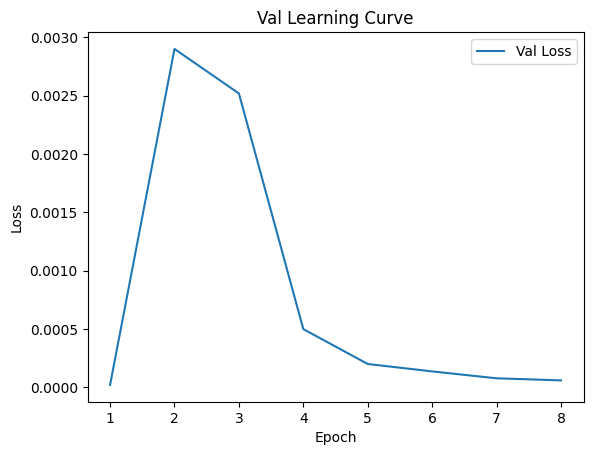


 Epoch: (9/50) Loss = 5.478199454955757e-05

 Epoch: (9/50) Loss_rmse = 0.007401485927402973

 Epoch: (9/50) R^2 = 0.9979775547981262

 Epoch: (9/50) MAE = 0.00713348388671875
Spearman correlation coefficient: SignificanceResult(statistic=0.999443826841685, pvalue=1.207985253657063e-140)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3168316

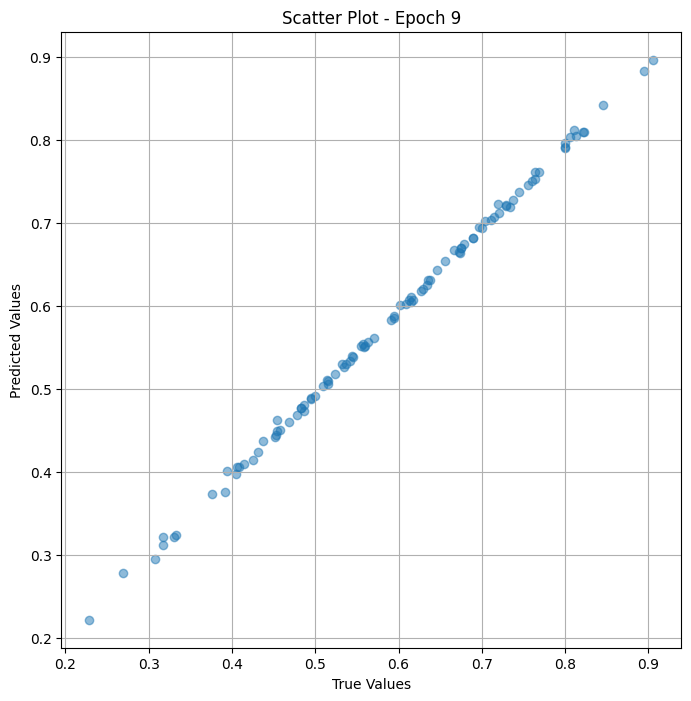

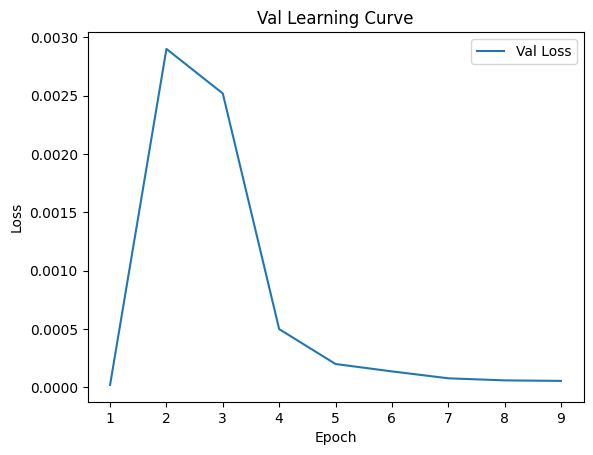

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (10/50) Loss = 5.0506205298006535e-05

 Epoch: (10/50) Loss_rmse = 0.007106771692633629

 Epoch: (10/50) R^2 = 0.9981353878974915

 Epoch: (10/50) MAE = 0.006870262324810028
Spearman correlation coefficient: SignificanceResult(statistic=0.9994573920496445, pvalue=3.785927852884927e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.

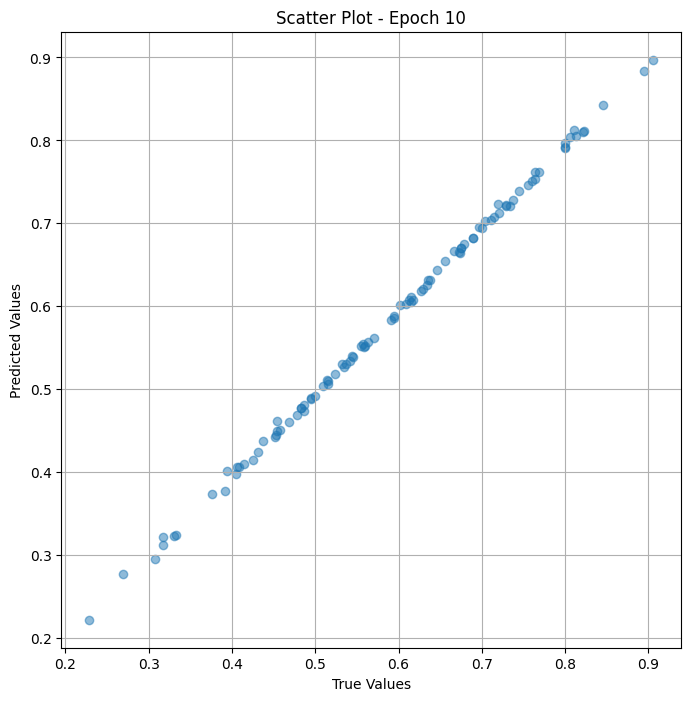

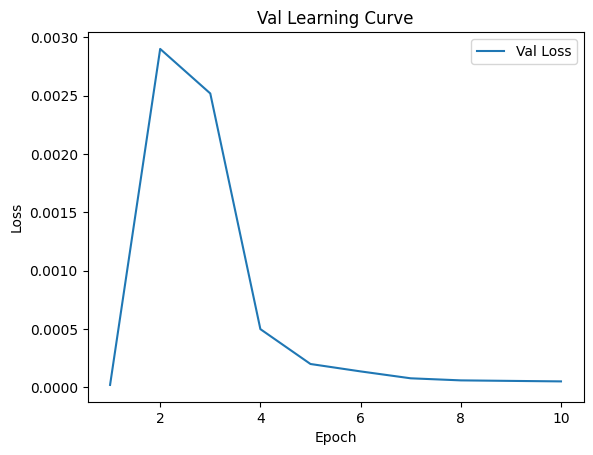


 Epoch: (11/50) Loss = 4.9010064685717225e-05

 Epoch: (11/50) Loss_rmse = 0.007000718731433153

 Epoch: (11/50) R^2 = 0.9981906414031982

 Epoch: (11/50) MAE = 0.0067756325006484985
Spearman correlation coefficient: SignificanceResult(statistic=0.9994573920496445, pvalue=3.785927852884927e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0

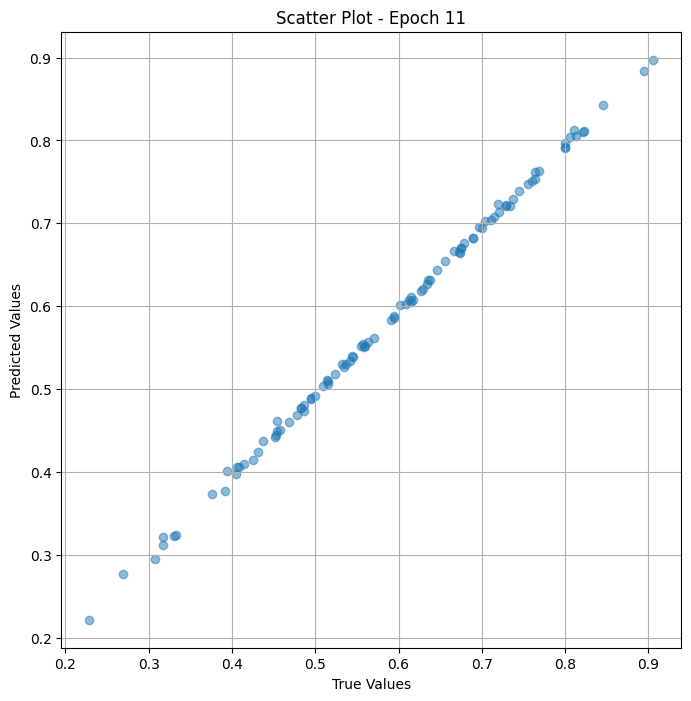

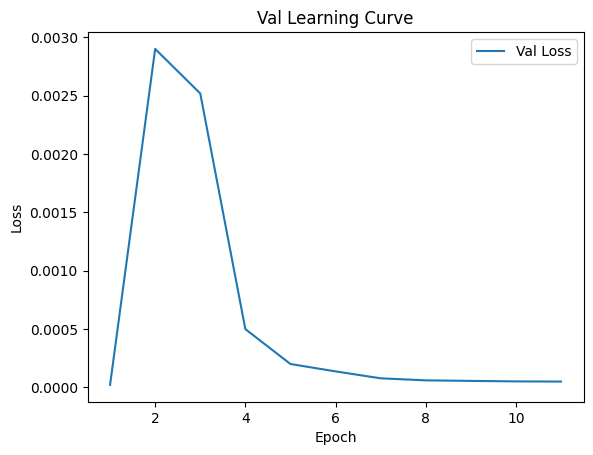


 Epoch: (12/50) Loss = 4.861624620389193e-05

 Epoch: (12/50) Loss_rmse = 0.0069725350476801395

 Epoch: (12/50) R^2 = 0.9982051849365234

 Epoch: (12/50) MAE = 0.006750568747520447
Spearman correlation coefficient: SignificanceResult(statistic=0.9994573920496445, pvalue=3.785927852884927e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

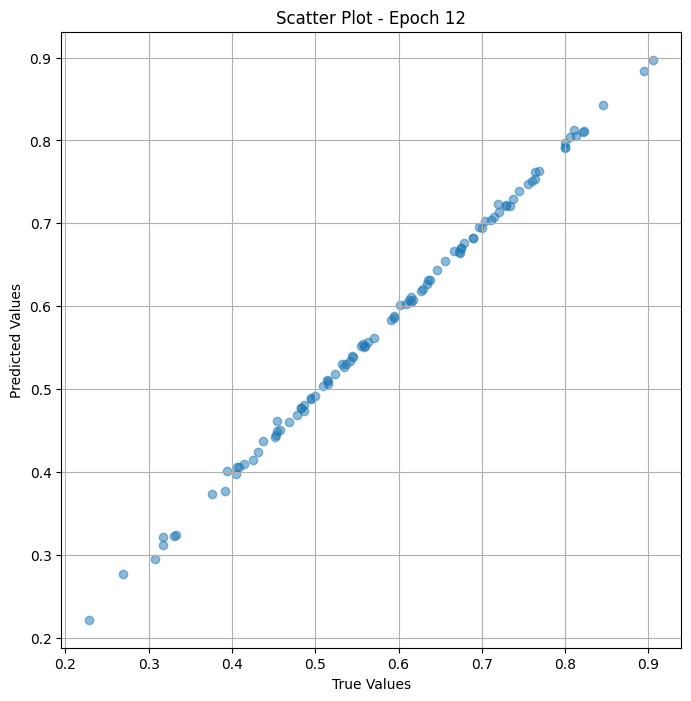

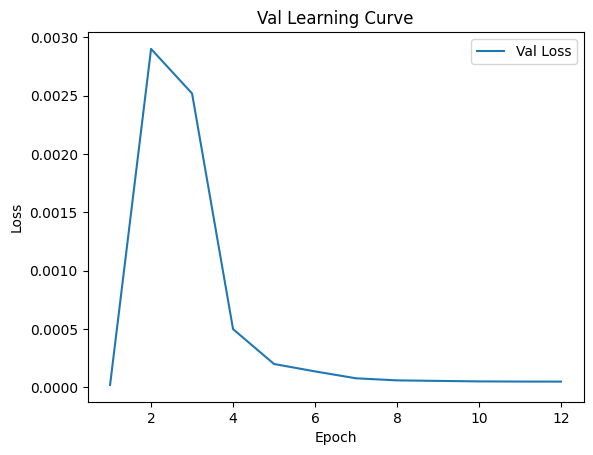

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (13/50) Loss = 4.8223122576018795e-05

 Epoch: (13/50) Loss_rmse = 0.0069442871026694775

 Epoch: (13/50) R^2 = 0.9982196688652039

 Epoch: (13/50) MAE = 0.006725534796714783
Spearman correlation coefficient: SignificanceResult(statistic=0.9994573920496445, pvalue=3.785927852884927e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0

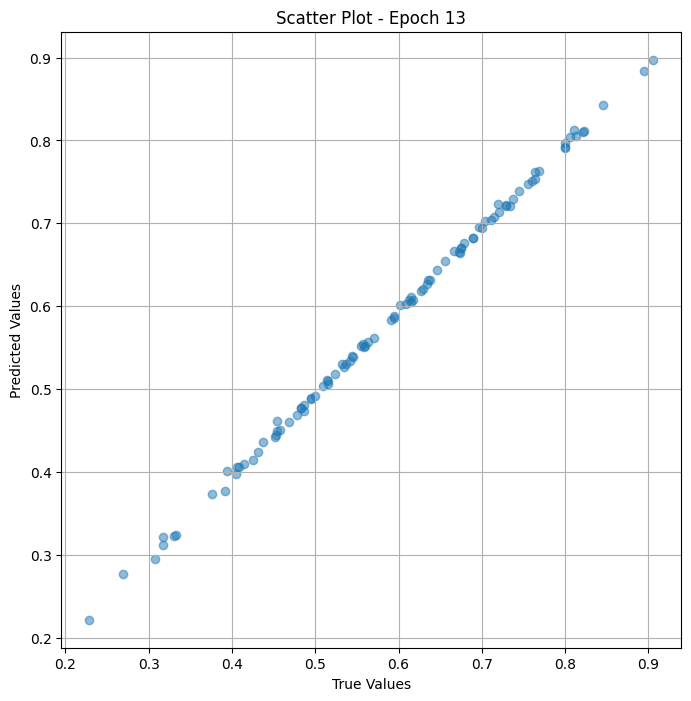

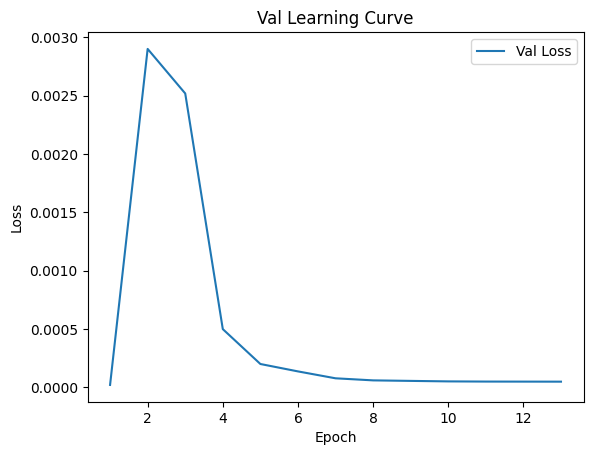


 Epoch: (14/50) Loss = 4.8095720558194444e-05

 Epoch: (14/50) Loss_rmse = 0.006935107987374067

 Epoch: (14/50) R^2 = 0.9982243776321411

 Epoch: (14/50) MAE = 0.006717398762702942
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

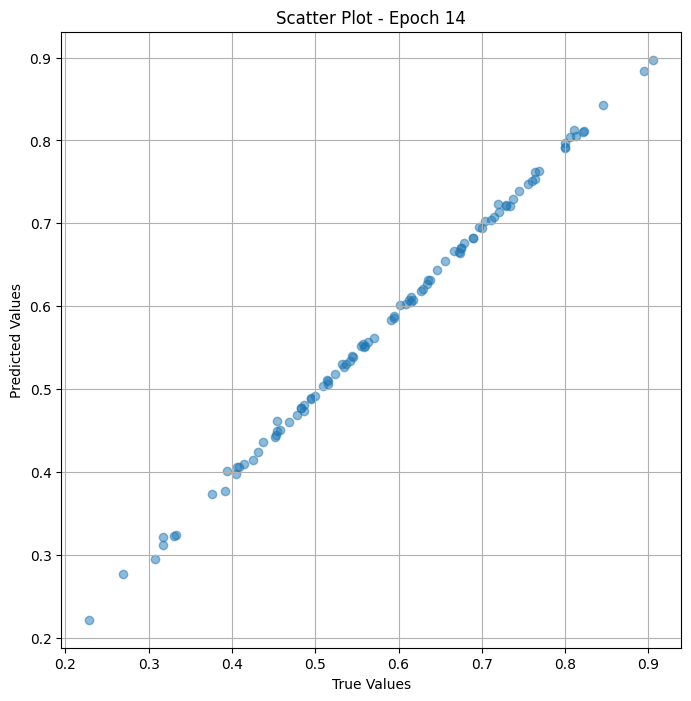

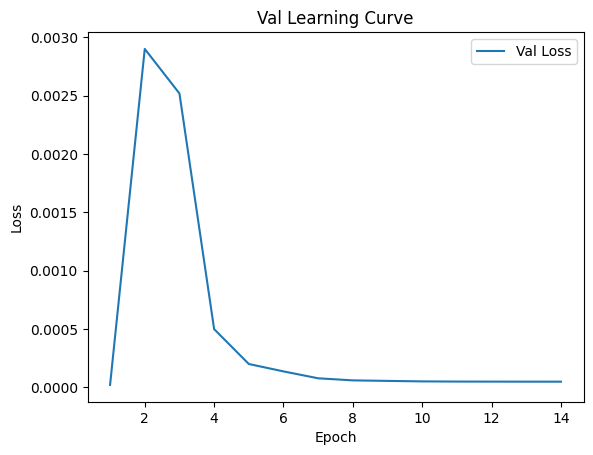


 Epoch: (15/50) Loss = 4.808316225535236e-05

 Epoch: (15/50) Loss_rmse = 0.006934202276170254

 Epoch: (15/50) R^2 = 0.9982248544692993

 Epoch: (15/50) MAE = 0.006716631352901459
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

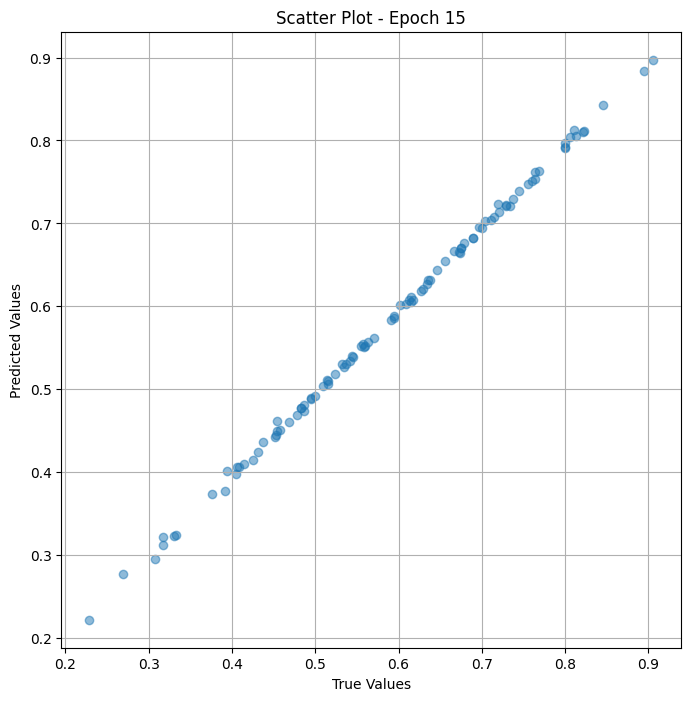

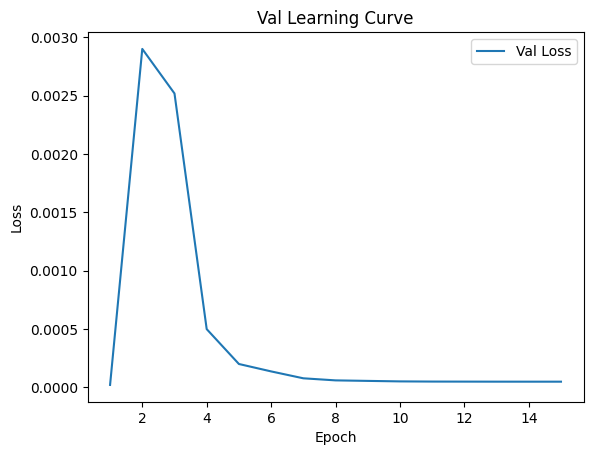


 Epoch: (16/50) Loss = 4.8069814511109143e-05

 Epoch: (16/50) Loss_rmse = 0.006933239754289389

 Epoch: (16/50) R^2 = 0.9982253313064575

 Epoch: (16/50) MAE = 0.006715826690196991
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

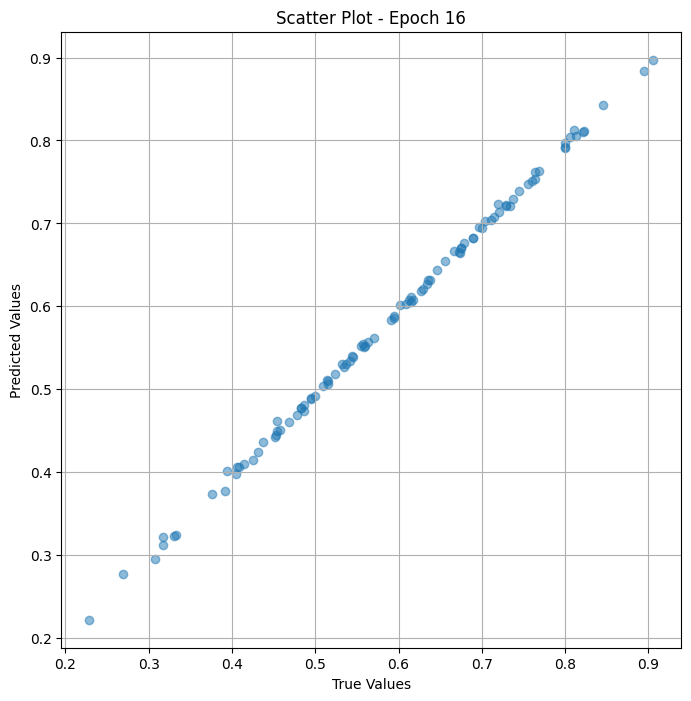

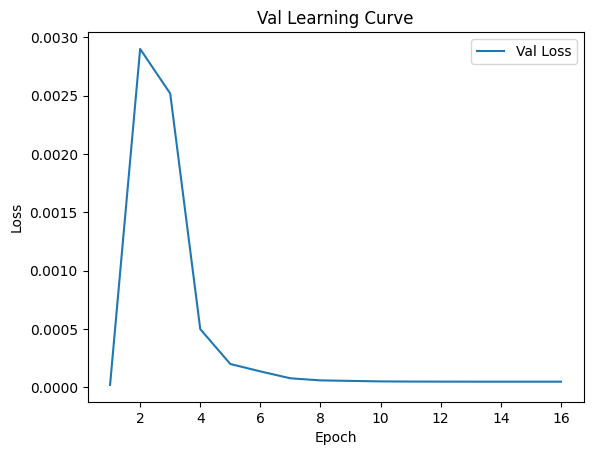


 Epoch: (17/50) Loss = 4.805738717550412e-05

 Epoch: (17/50) Loss_rmse = 0.006932343356311321

 Epoch: (17/50) R^2 = 0.9982258081436157

 Epoch: (17/50) MAE = 0.006715096533298492
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

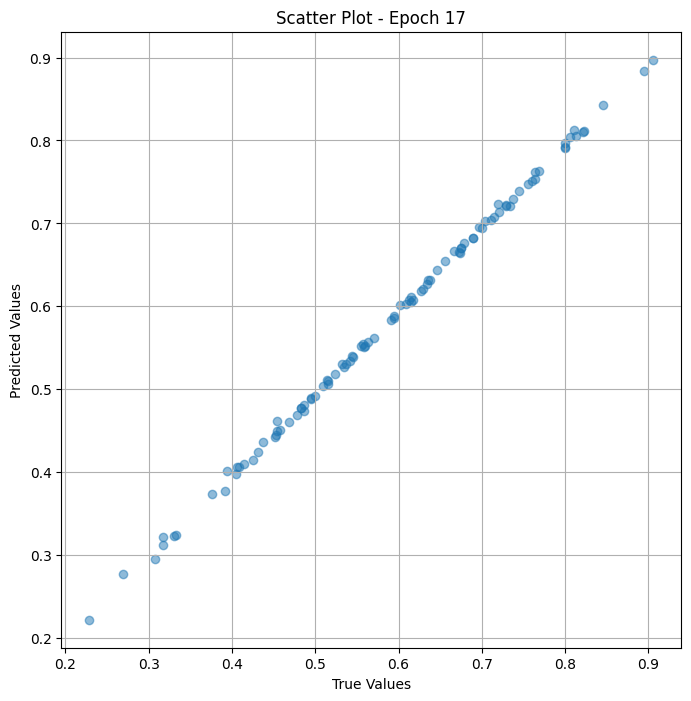

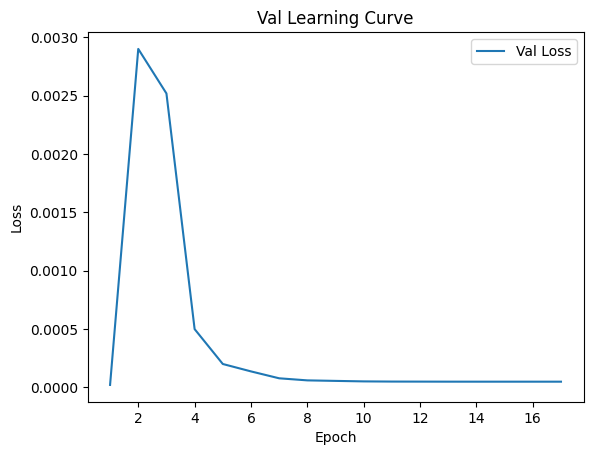


 Epoch: (18/50) Loss = 4.804403579328209e-05

 Epoch: (18/50) Loss_rmse = 0.006931380368769169

 Epoch: (18/50) R^2 = 0.9982262849807739

 Epoch: (18/50) MAE = 0.006714276969432831
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

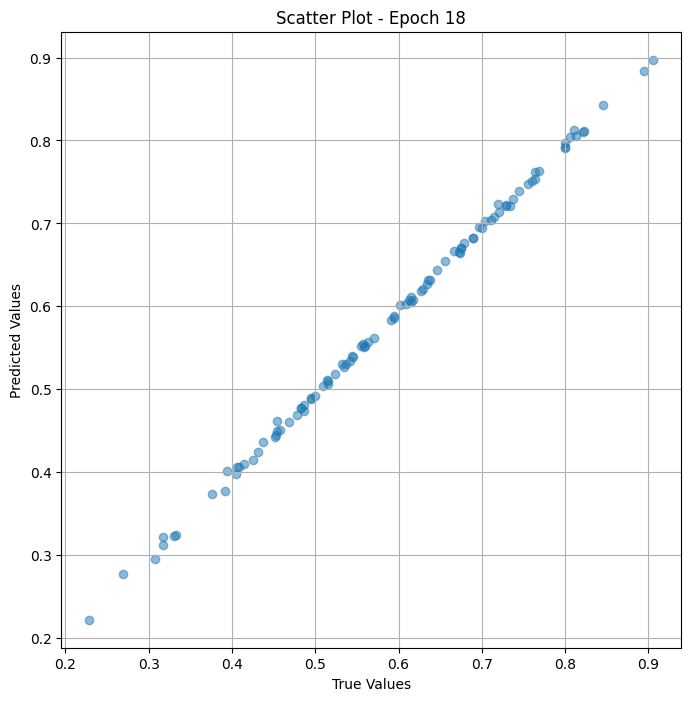

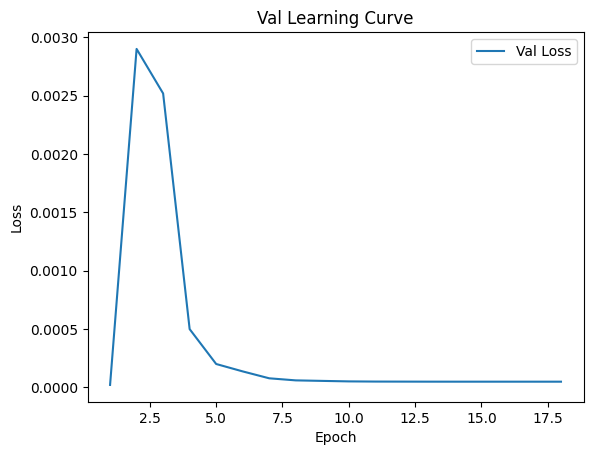


 Epoch: (19/50) Loss = 4.803069168701768e-05

 Epoch: (19/50) Loss_rmse = 0.006930417846888304

 Epoch: (19/50) R^2 = 0.9982268214225769

 Epoch: (19/50) MAE = 0.006713472306728363
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

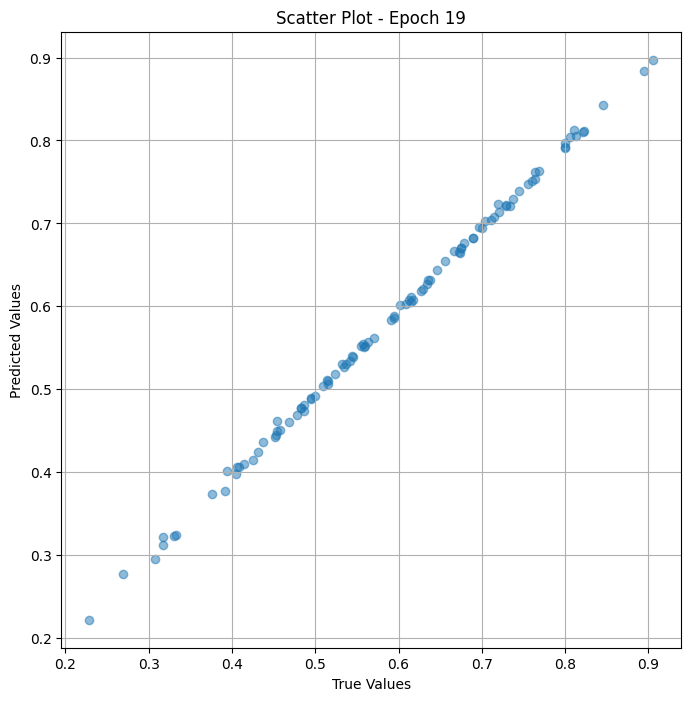

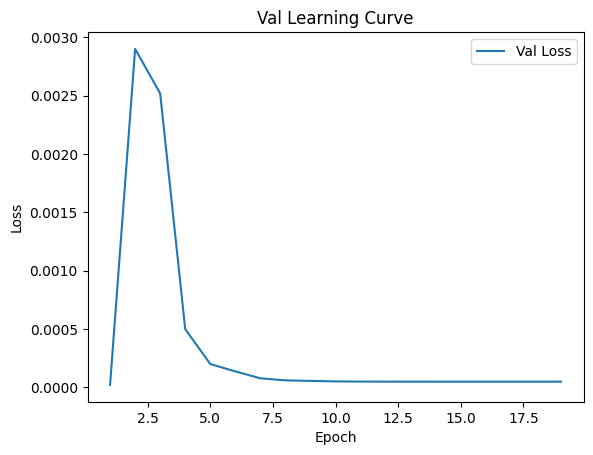


 Epoch: (20/50) Loss = 4.801500836038031e-05

 Epoch: (20/50) Loss_rmse = 0.006929286289960146

 Epoch: (20/50) R^2 = 0.9982273578643799

 Epoch: (20/50) MAE = 0.006712533533573151
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

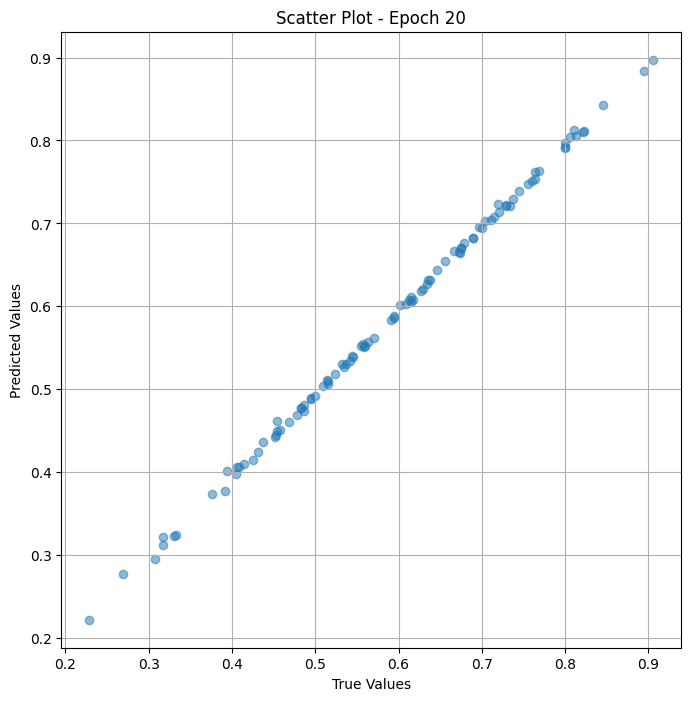

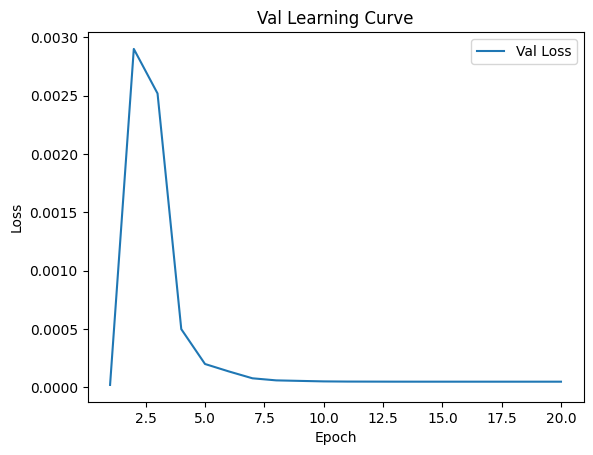


 Epoch: (21/50) Loss = 4.800147144123912e-05

 Epoch: (21/50) Loss_rmse = 0.006928309332579374

 Epoch: (21/50) R^2 = 0.9982278943061829

 Epoch: (21/50) MAE = 0.006711684167385101
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

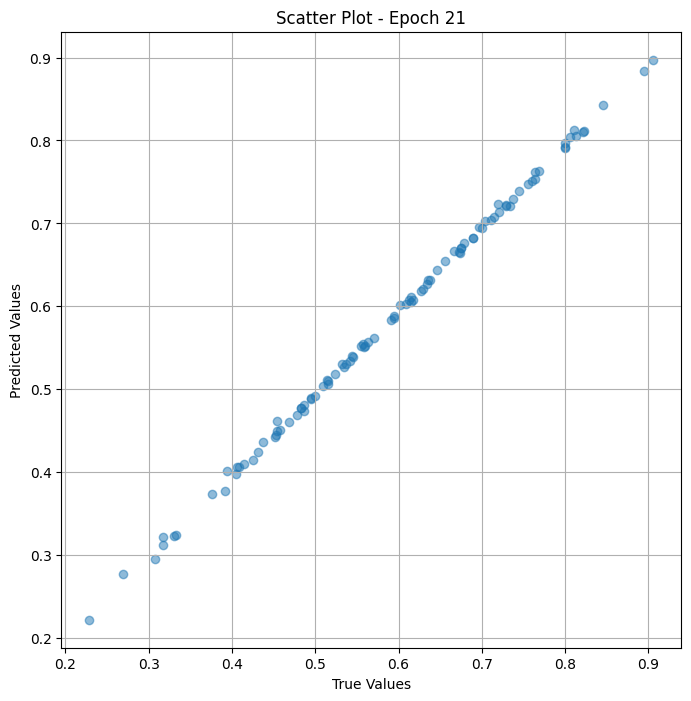

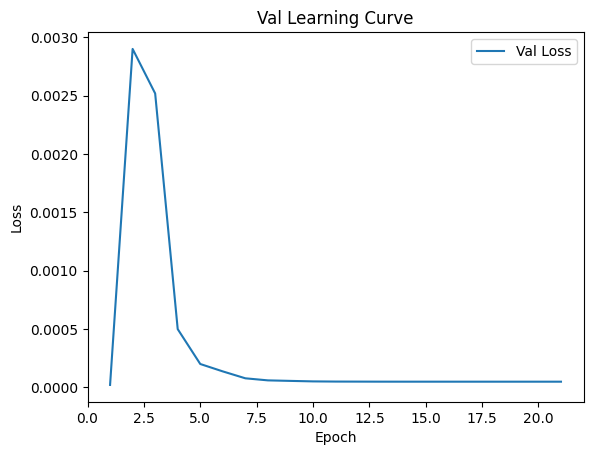


 Epoch: (22/50) Loss = 4.798559893970378e-05

 Epoch: (22/50) Loss_rmse = 0.006927163805812597

 Epoch: (22/50) R^2 = 0.9982284903526306

 Epoch: (22/50) MAE = 0.006710745394229889
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

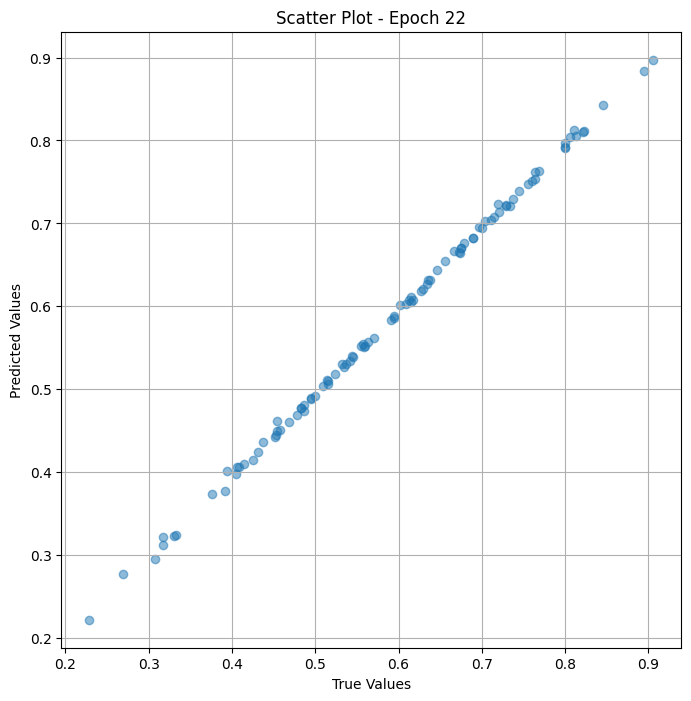

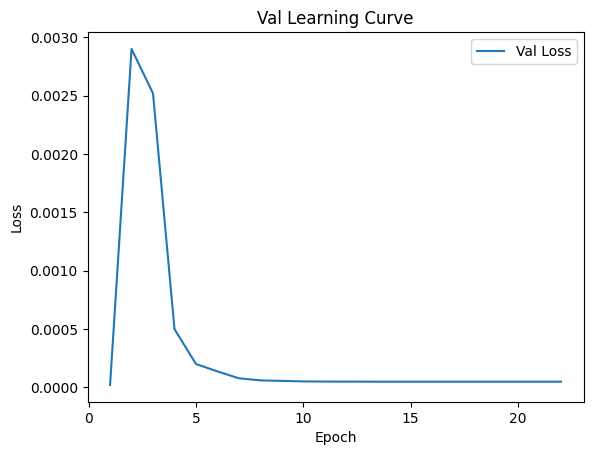


 Epoch: (23/50) Loss = 4.796866778633557e-05

 Epoch: (23/50) Loss_rmse = 0.0069259414449334145

 Epoch: (23/50) R^2 = 0.9982290863990784

 Epoch: (23/50) MAE = 0.00670972466468811
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

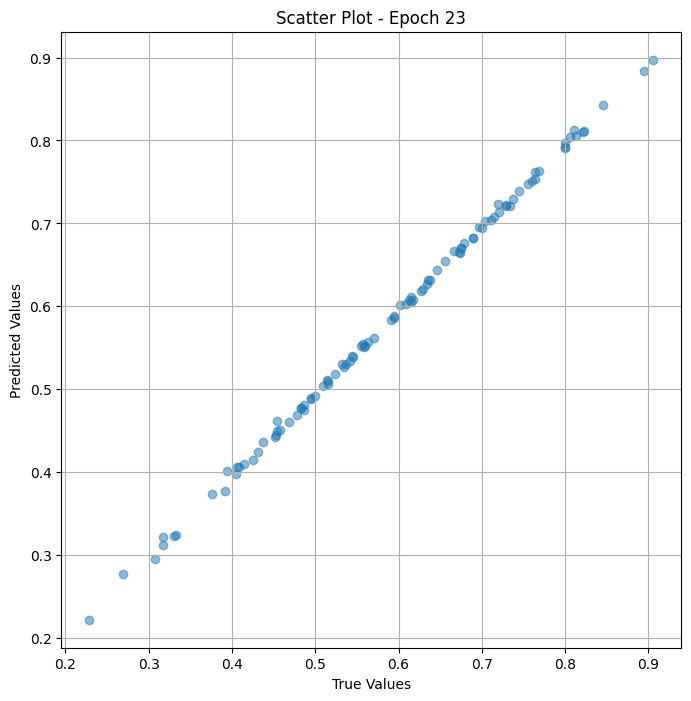

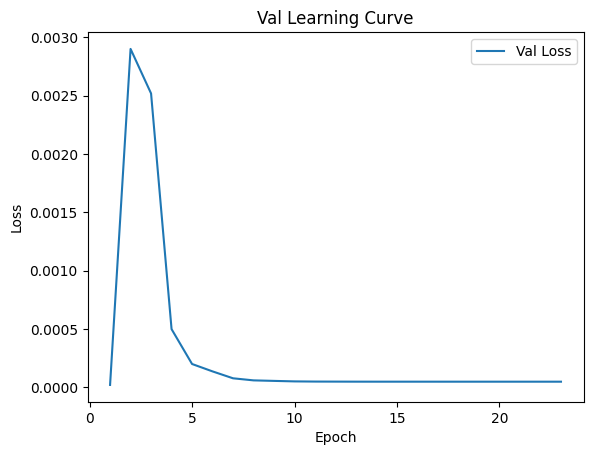


 Epoch: (24/50) Loss = 4.795216955244541e-05

 Epoch: (24/50) Loss_rmse = 0.006924750283360481

 Epoch: (24/50) R^2 = 0.9982296824455261

 Epoch: (24/50) MAE = 0.0067087262868881226
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

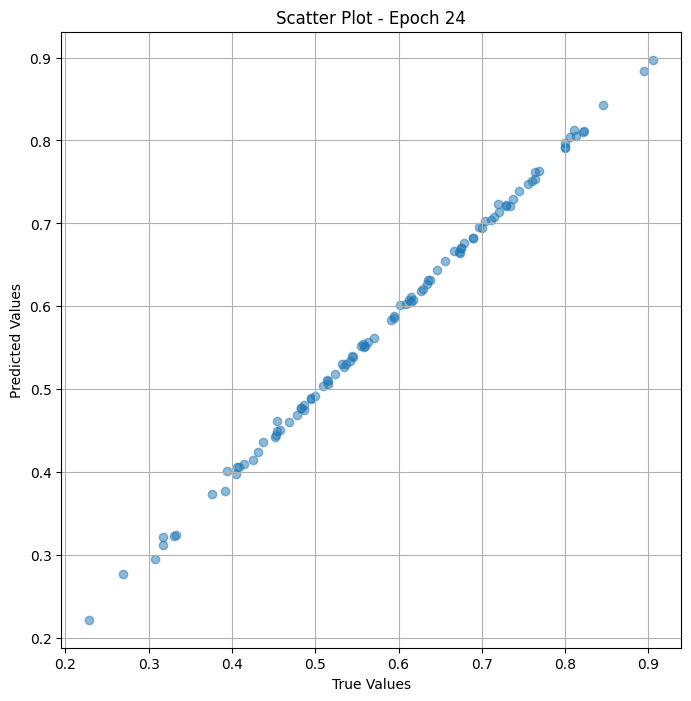

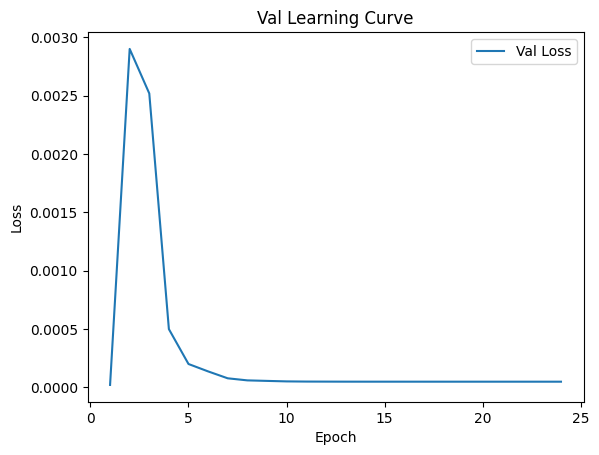


 Epoch: (25/50) Loss = 4.7935667680576444e-05

 Epoch: (25/50) Loss_rmse = 0.006923558656126261

 Epoch: (25/50) R^2 = 0.9982302784919739

 Epoch: (25/50) MAE = 0.006707705557346344
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

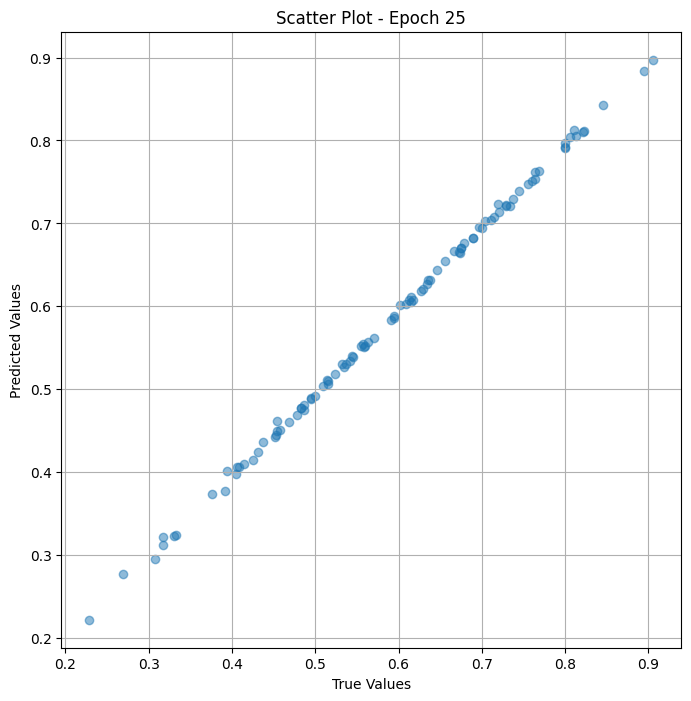

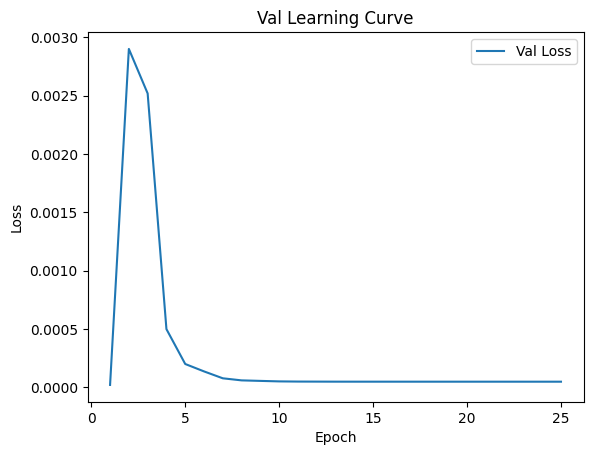


 Epoch: (26/50) Loss = 4.792124673258513e-05

 Epoch: (26/50) Loss_rmse = 0.006922517437487841

 Epoch: (26/50) R^2 = 0.9982308149337769

 Epoch: (26/50) MAE = 0.006706833839416504
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

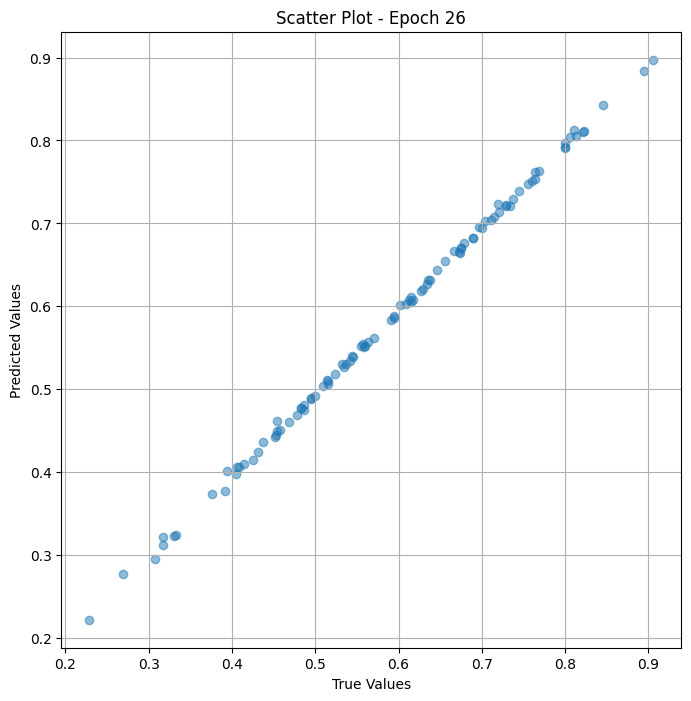

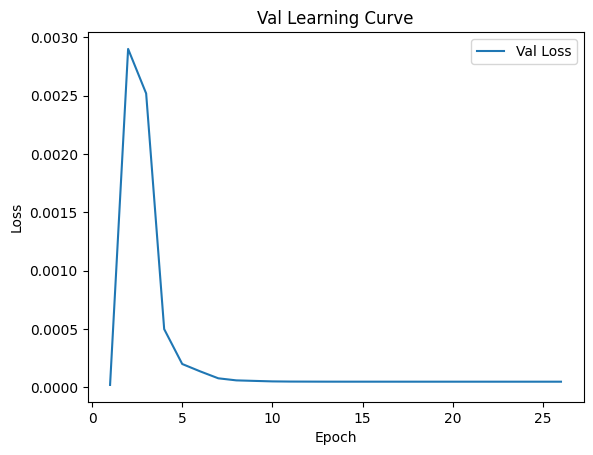


 Epoch: (27/50) Loss = 4.790296225110069e-05

 Epoch: (27/50) Loss_rmse = 0.006921196822077036

 Epoch: (27/50) R^2 = 0.9982315301895142

 Epoch: (27/50) MAE = 0.006705708801746368
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

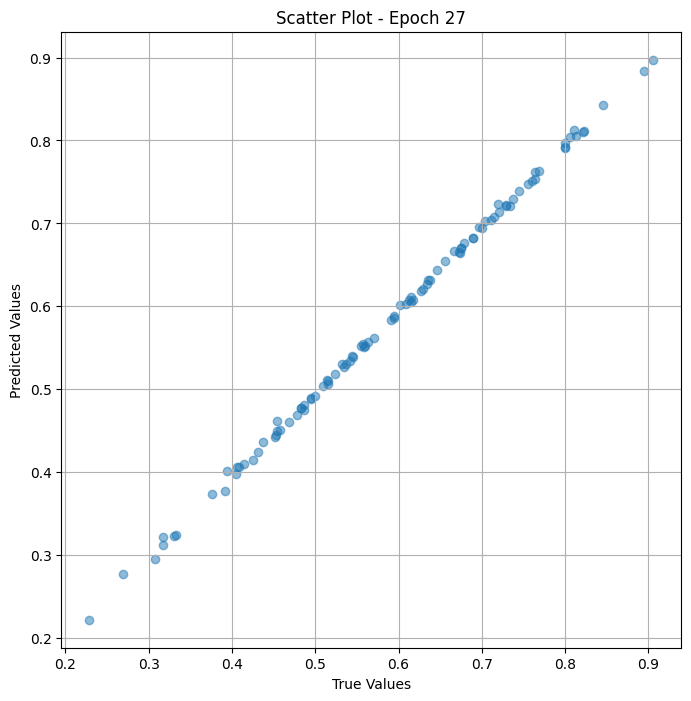

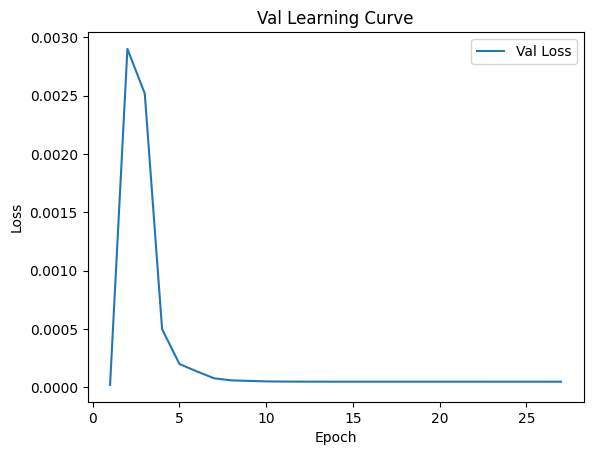


 Epoch: (28/50) Loss = 4.7886303946143016e-05

 Epoch: (28/50) Loss_rmse = 0.006919993087649345

 Epoch: (28/50) R^2 = 0.9982321262359619

 Epoch: (28/50) MAE = 0.006704680621623993
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

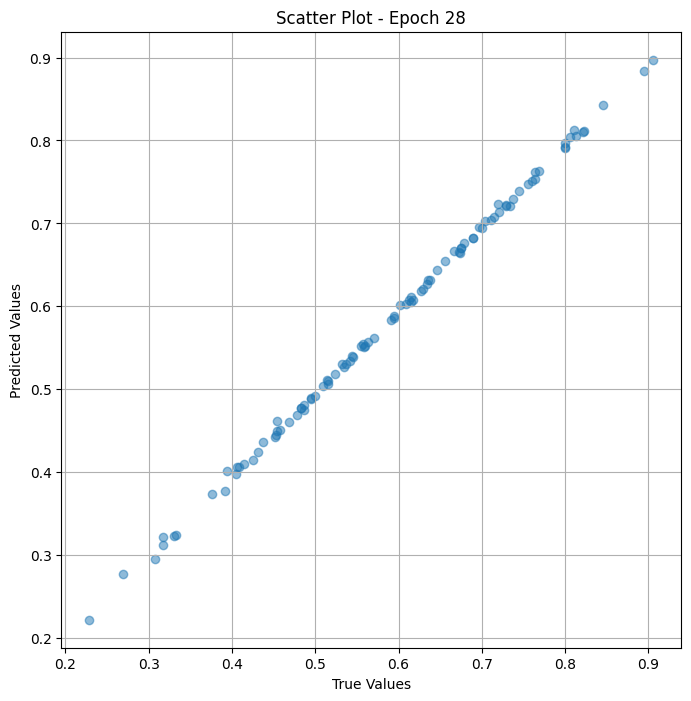

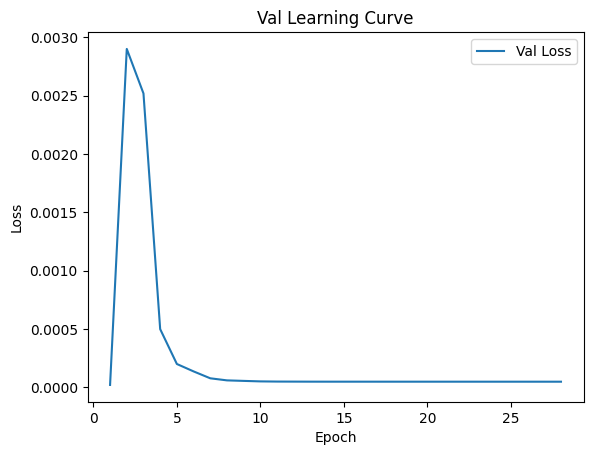


 Epoch: (29/50) Loss = 4.7867390094324946e-05

 Epoch: (29/50) Loss_rmse = 0.006918626371771097

 Epoch: (29/50) R^2 = 0.9982328414916992

 Epoch: (29/50) MAE = 0.006703518331050873
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

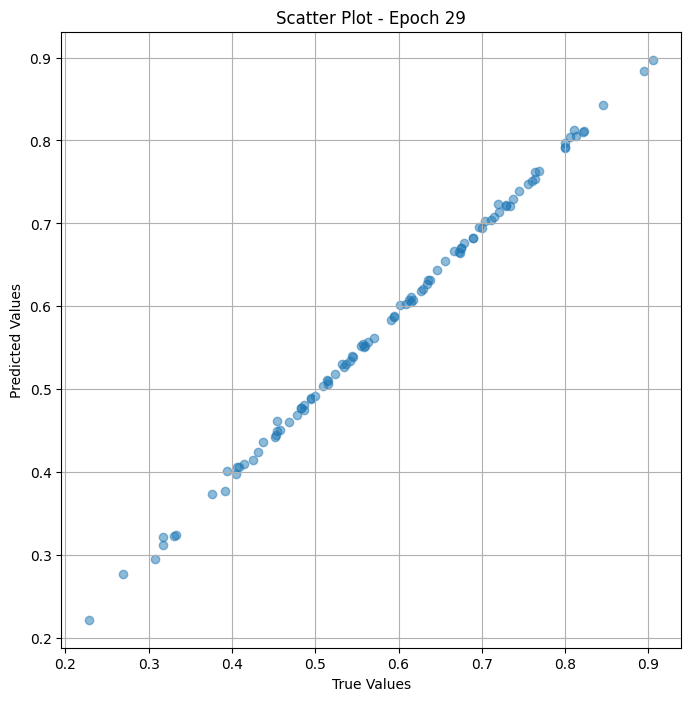

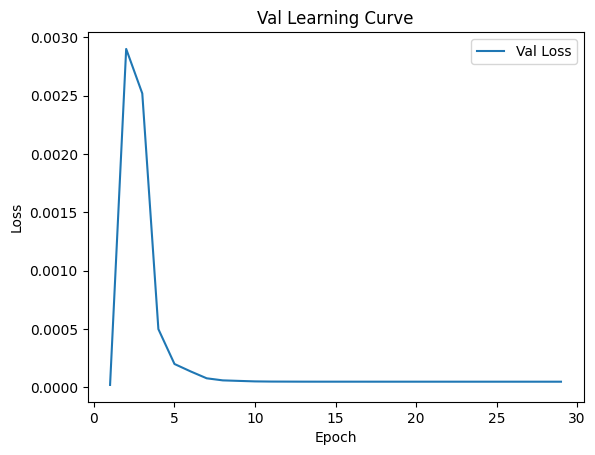


 Epoch: (30/50) Loss = 4.784686097991653e-05

 Epoch: (30/50) Loss_rmse = 0.006917142774909735

 Epoch: (30/50) R^2 = 0.9982335567474365

 Epoch: (30/50) MAE = 0.006702251732349396
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

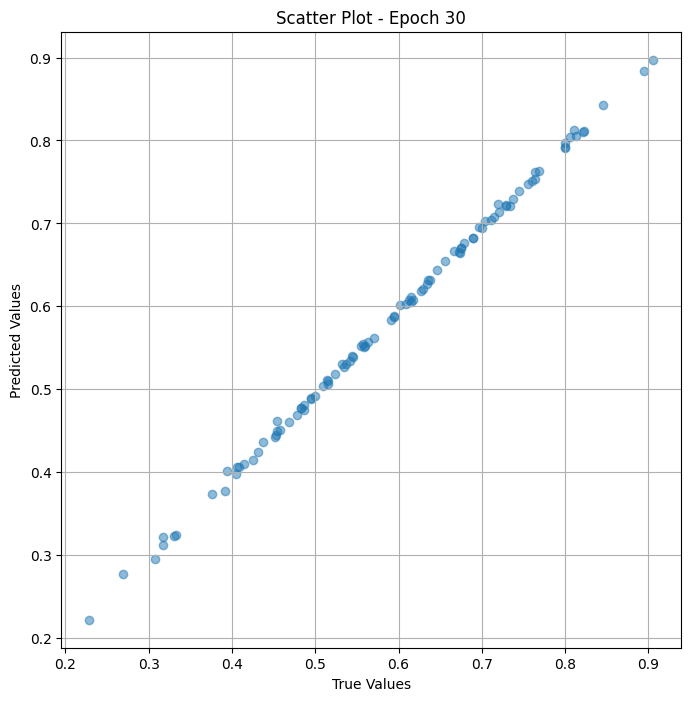

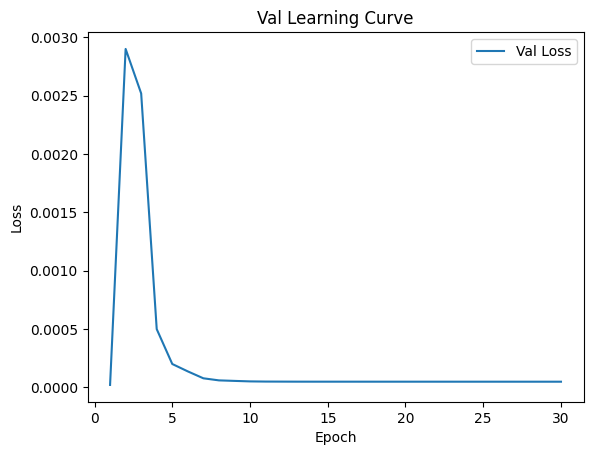


 Epoch: (31/50) Loss = 4.782971882377751e-05

 Epoch: (31/50) Loss_rmse = 0.0069159031845629215

 Epoch: (31/50) R^2 = 0.998234212398529

 Epoch: (31/50) MAE = 0.006701208651065826
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

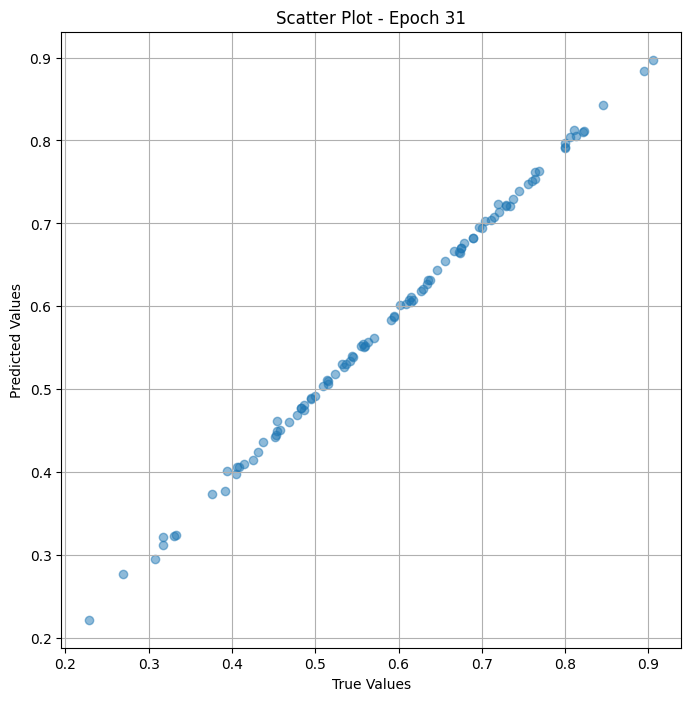

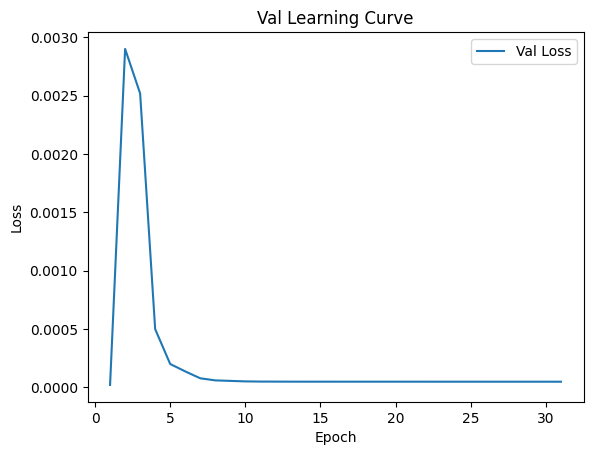


 Epoch: (32/50) Loss = 4.781036841450259e-05

 Epoch: (32/50) Loss_rmse = 0.006914504338055849

 Epoch: (32/50) R^2 = 0.9982349276542664

 Epoch: (32/50) MAE = 0.006699979305267334
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

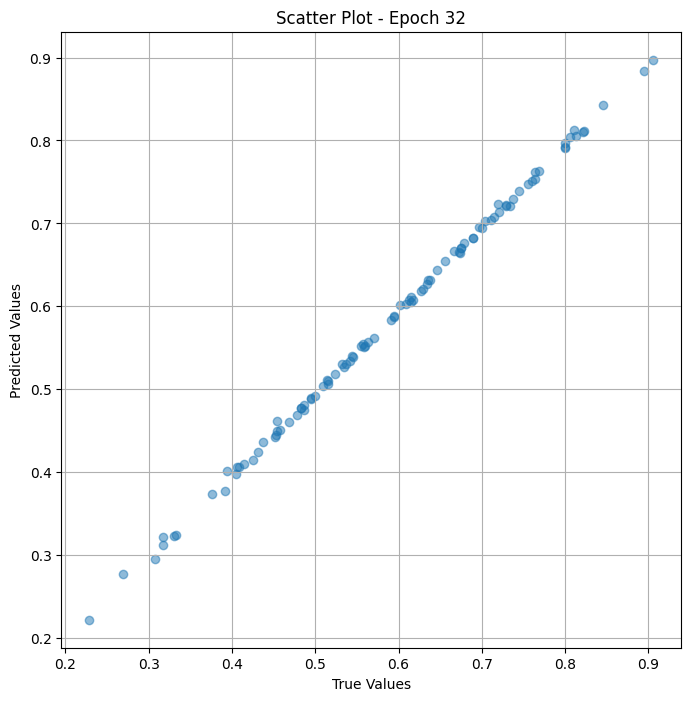

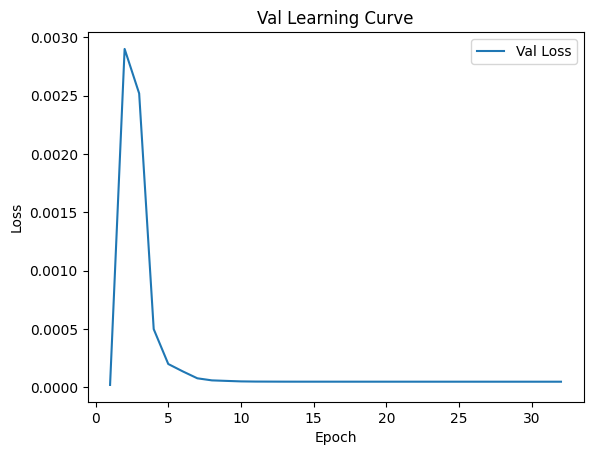


 Epoch: (33/50) Loss = 4.779024311574176e-05

 Epoch: (33/50) Loss_rmse = 0.006913048680871725

 Epoch: (33/50) R^2 = 0.9982357025146484

 Epoch: (33/50) MAE = 0.0066987574100494385
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

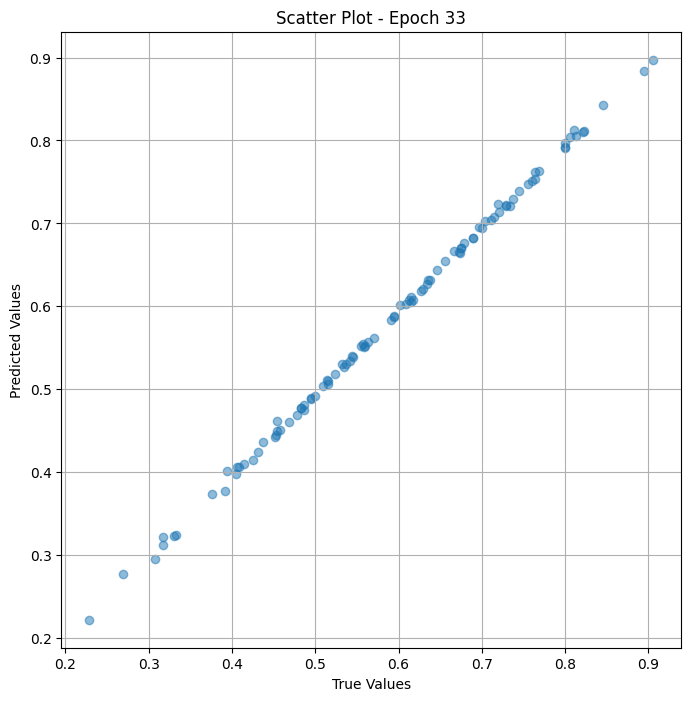

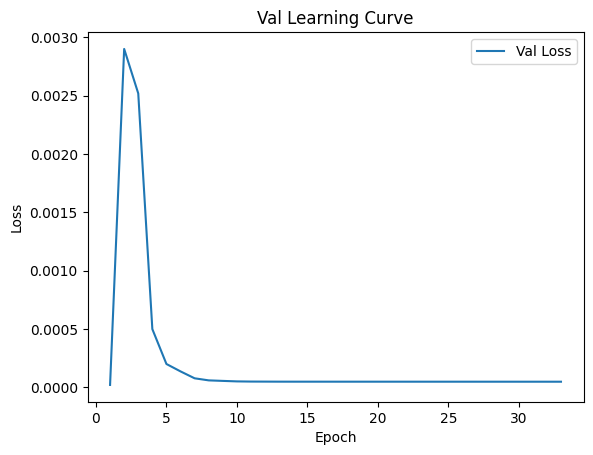


 Epoch: (34/50) Loss = 4.776992864208296e-05

 Epoch: (34/50) Loss_rmse = 0.006911579519510269

 Epoch: (34/50) R^2 = 0.9982364177703857

 Epoch: (34/50) MAE = 0.0066974833607673645
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

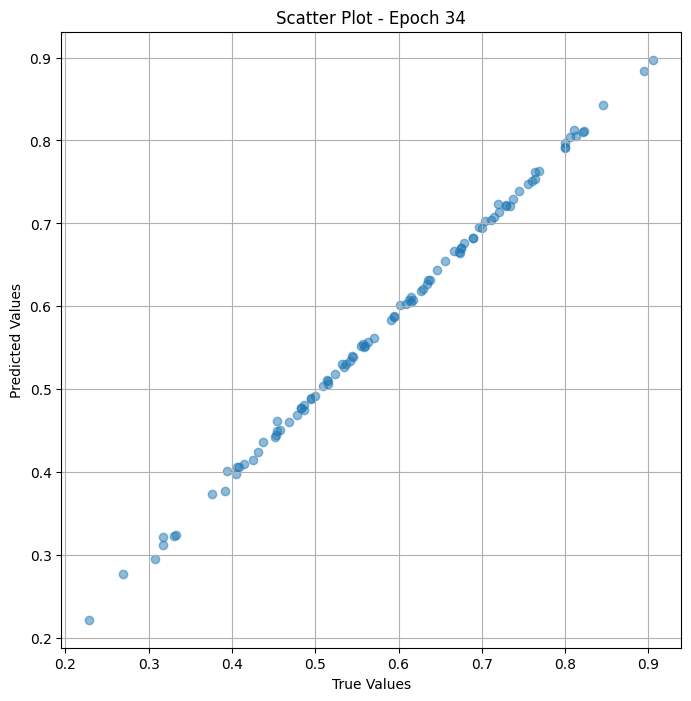

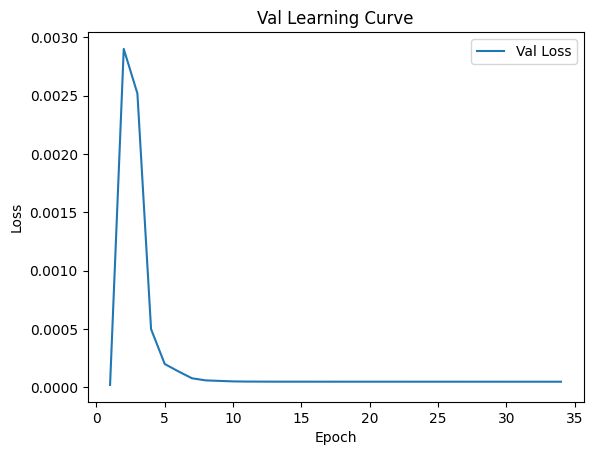


 Epoch: (35/50) Loss = 4.775065099238418e-05

 Epoch: (35/50) Loss_rmse = 0.006910184398293495

 Epoch: (35/50) R^2 = 0.998237133026123

 Epoch: (35/50) MAE = 0.006696328520774841
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31

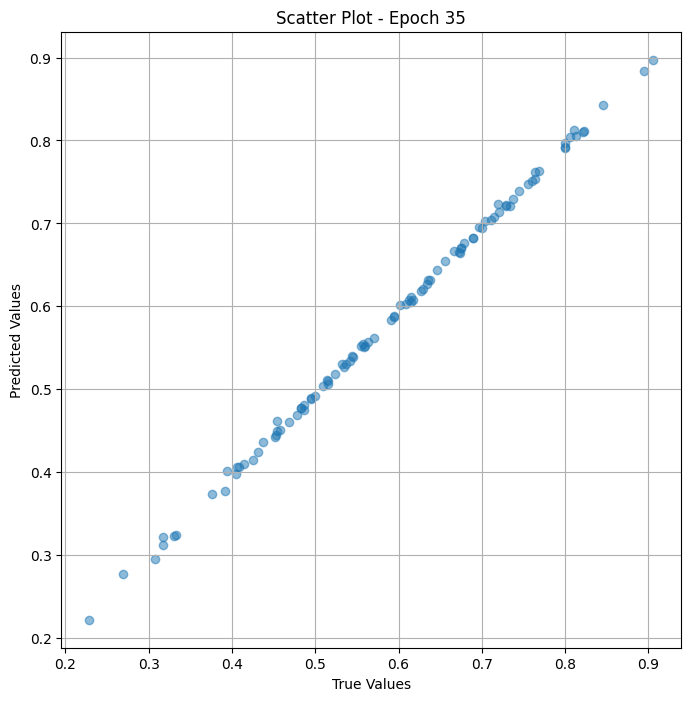

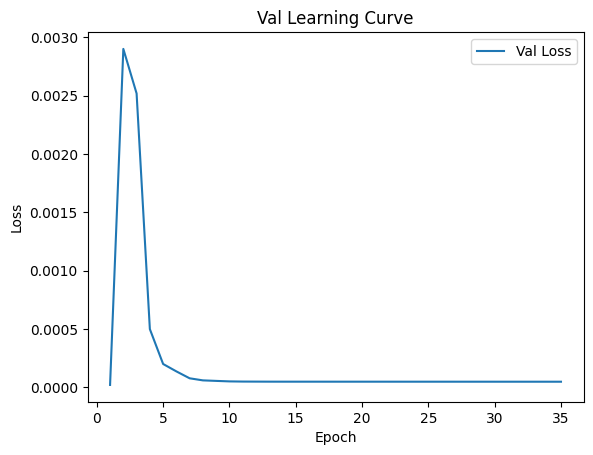


 Epoch: (36/50) Loss = 4.772848478751257e-05

 Epoch: (36/50) Loss_rmse = 0.006908580660820007

 Epoch: (36/50) R^2 = 0.9982379674911499

 Epoch: (36/50) MAE = 0.006694912910461426
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

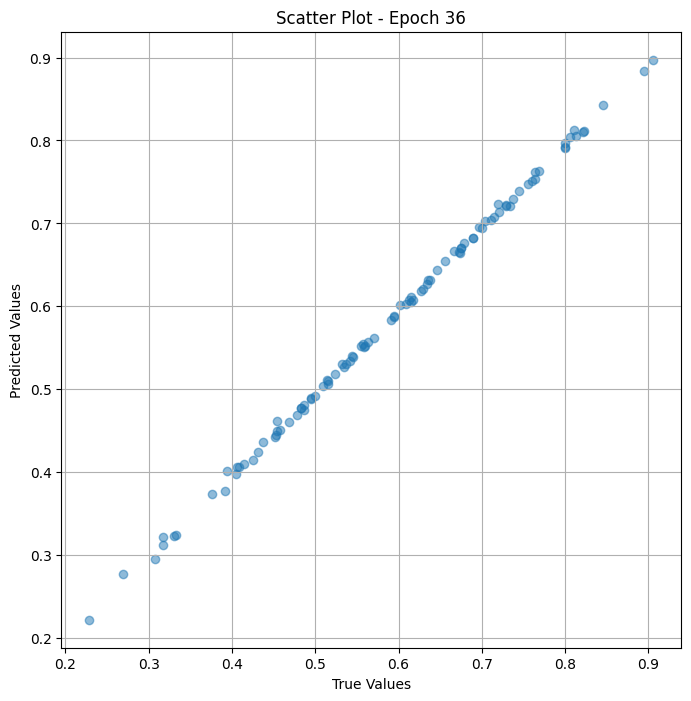

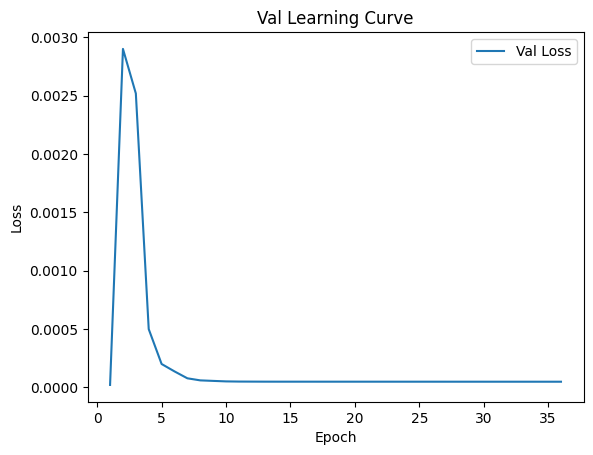


 Epoch: (37/50) Loss = 4.7707449994049966e-05

 Epoch: (37/50) Loss_rmse = 0.006907057948410511

 Epoch: (37/50) R^2 = 0.998238742351532

 Epoch: (37/50) MAE = 0.006693601608276367
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

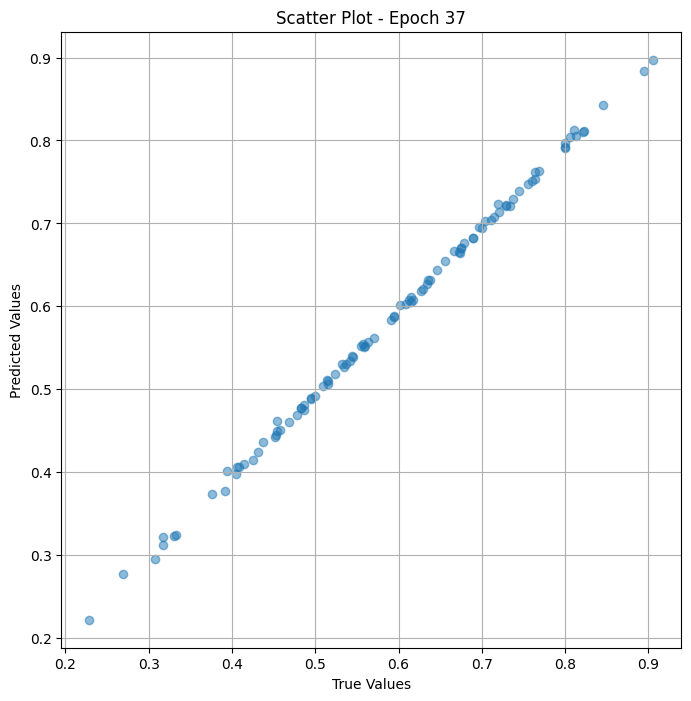

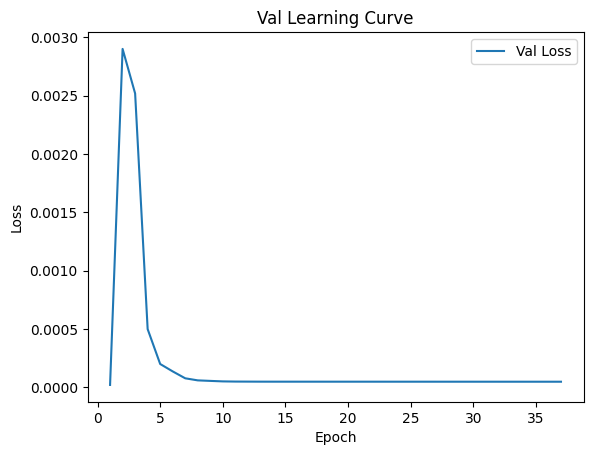


 Epoch: (38/50) Loss = 4.768568032886833e-05

 Epoch: (38/50) Loss_rmse = 0.006905481684952974

 Epoch: (38/50) R^2 = 0.9982395172119141

 Epoch: (38/50) MAE = 0.006692230701446533
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

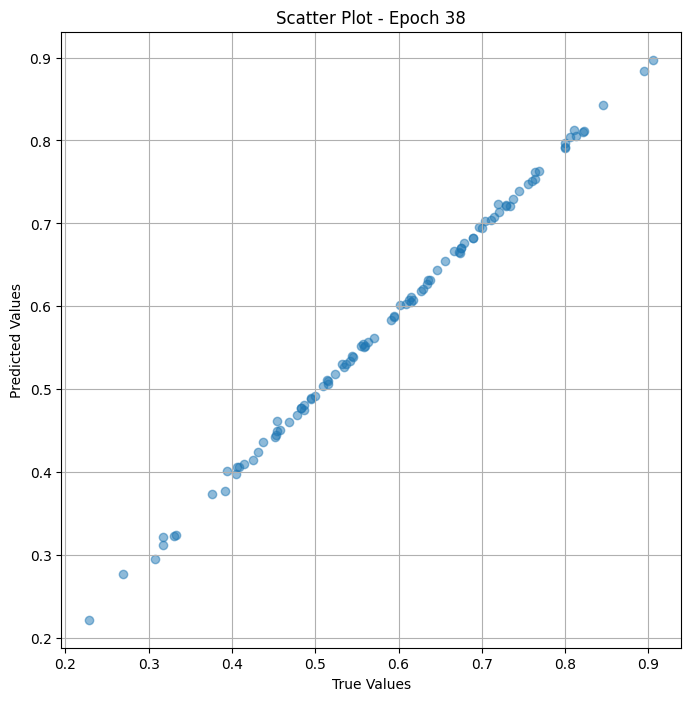

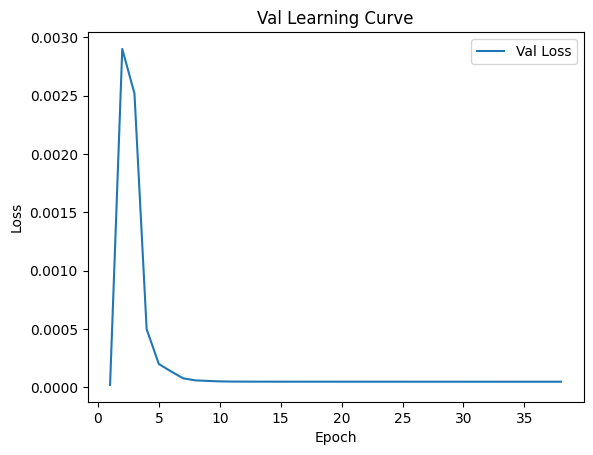


 Epoch: (39/50) Loss = 4.766281199408695e-05

 Epoch: (39/50) Loss_rmse = 0.006903825793415308

 Epoch: (39/50) R^2 = 0.9982403516769409

 Epoch: (39/50) MAE = 0.006690822541713715
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

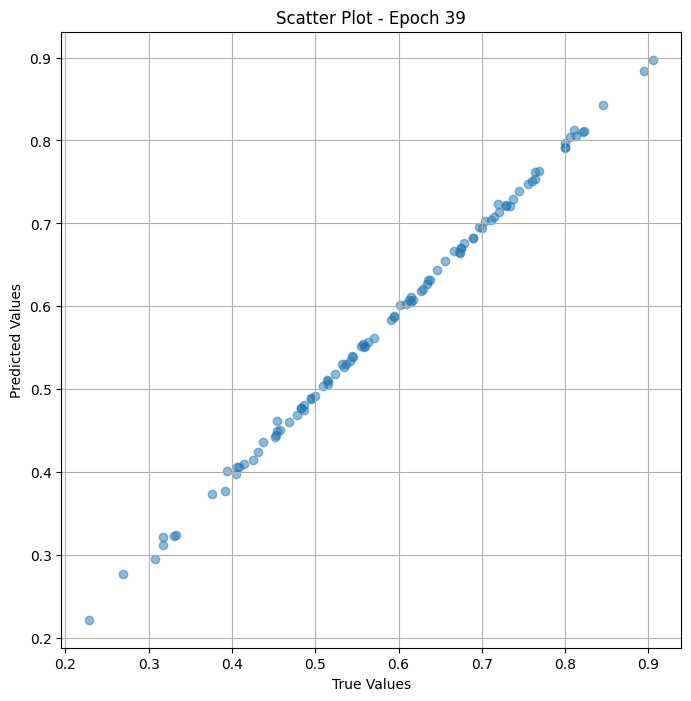

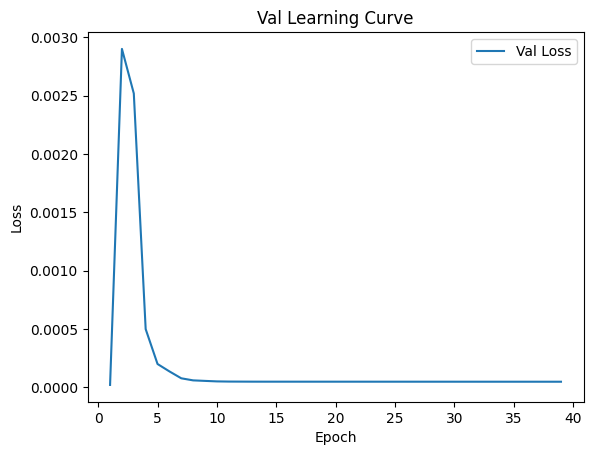


 Epoch: (40/50) Loss = 4.764183177030645e-05

 Epoch: (40/50) Loss_rmse = 0.006902306340634823

 Epoch: (40/50) R^2 = 0.998241126537323

 Epoch: (40/50) MAE = 0.006689503788948059
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31

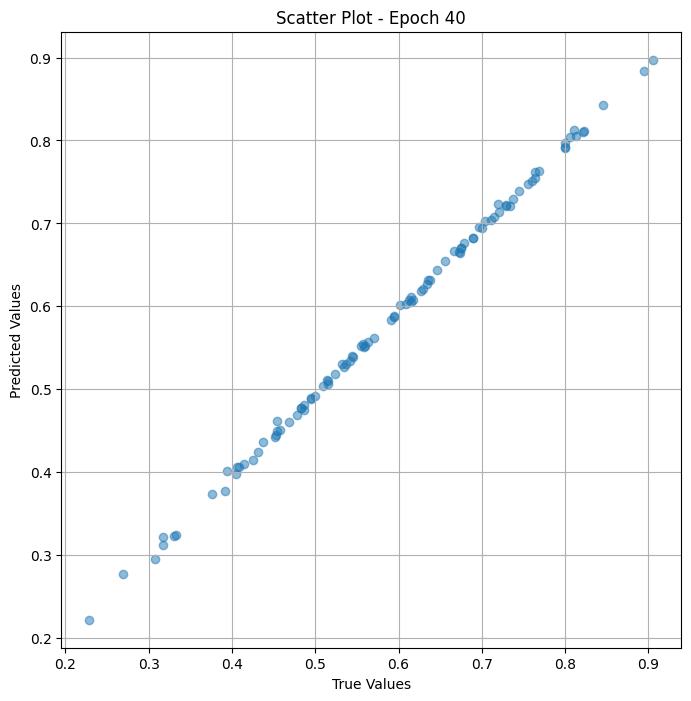

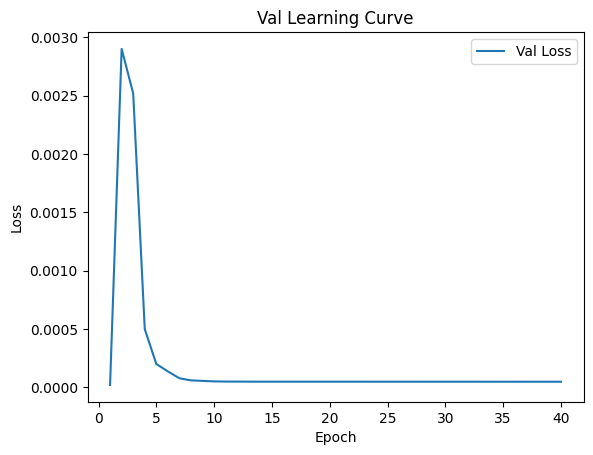


 Epoch: (41/50) Loss = 4.761945456266403e-05

 Epoch: (41/50) Loss_rmse = 0.006900684908032417

 Epoch: (41/50) R^2 = 0.9982419610023499

 Epoch: (41/50) MAE = 0.006688132882118225
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

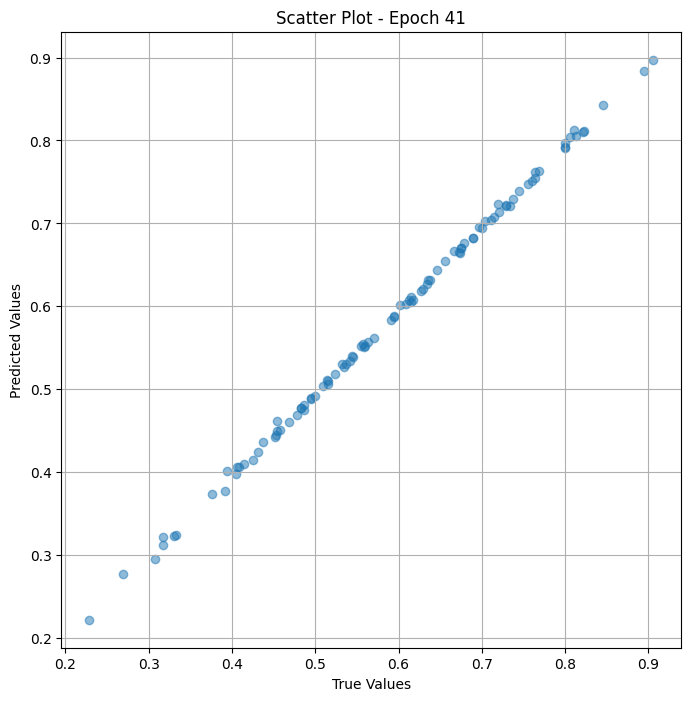

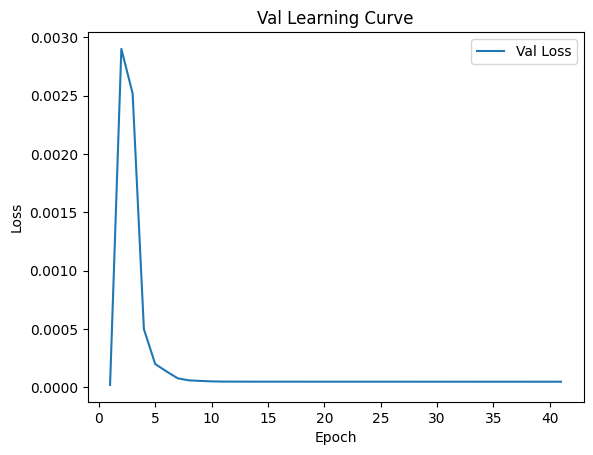


 Epoch: (42/50) Loss = 4.75975321023725e-05

 Epoch: (42/50) Loss_rmse = 0.006899096537381411

 Epoch: (42/50) R^2 = 0.9982427954673767

 Epoch: (42/50) MAE = 0.006686776876449585
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31

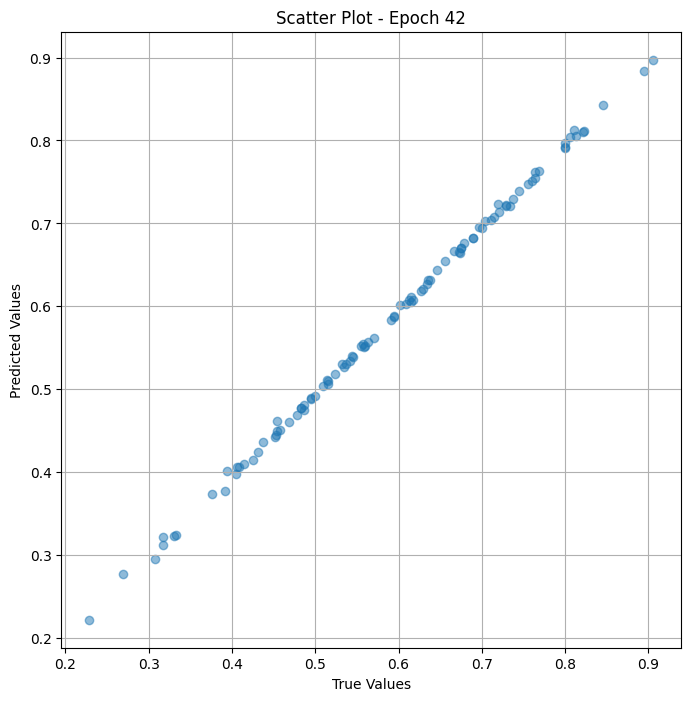

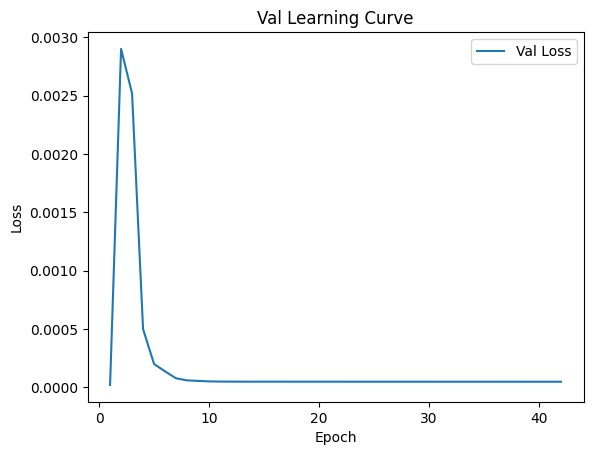


 Epoch: (43/50) Loss = 4.757518763653934e-05

 Epoch: (43/50) Loss_rmse = 0.006897476967424154

 Epoch: (43/50) R^2 = 0.9982436299324036

 Epoch: (43/50) MAE = 0.006685368716716766
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

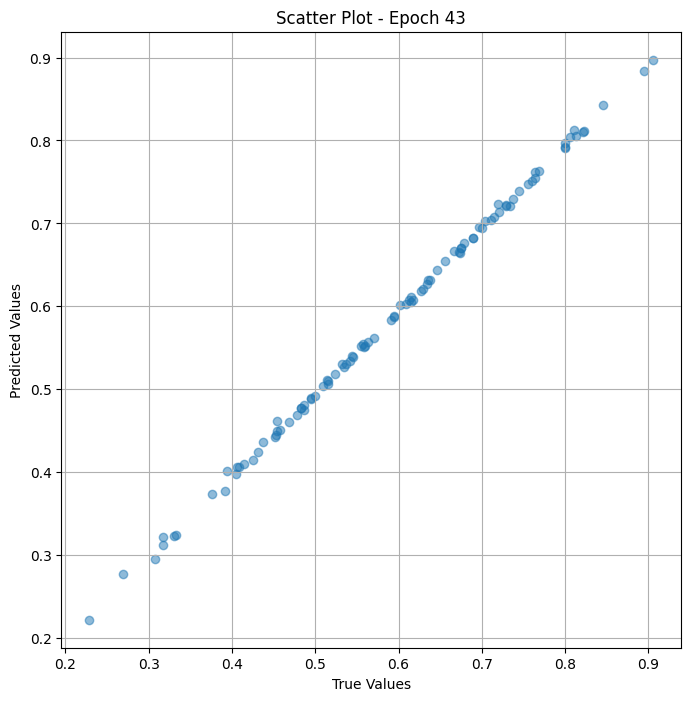

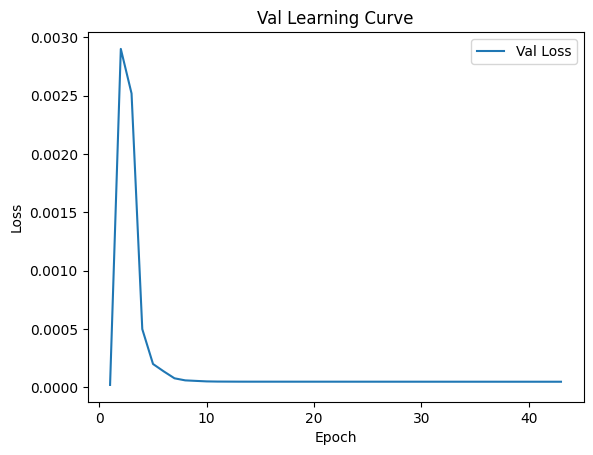


 Epoch: (44/50) Loss = 4.755049667437561e-05

 Epoch: (44/50) Loss_rmse = 0.006895686965435743

 Epoch: (44/50) R^2 = 0.9982445240020752

 Epoch: (44/50) MAE = 0.006683811545372009
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

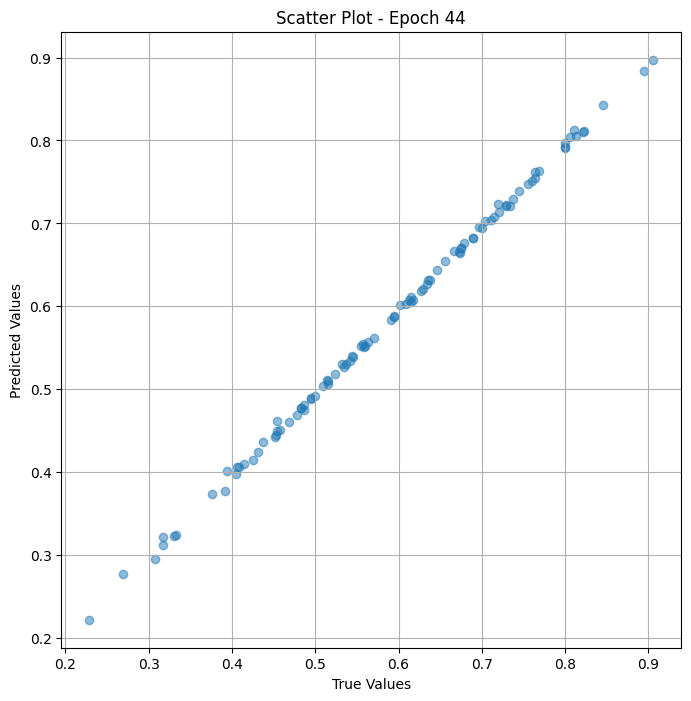

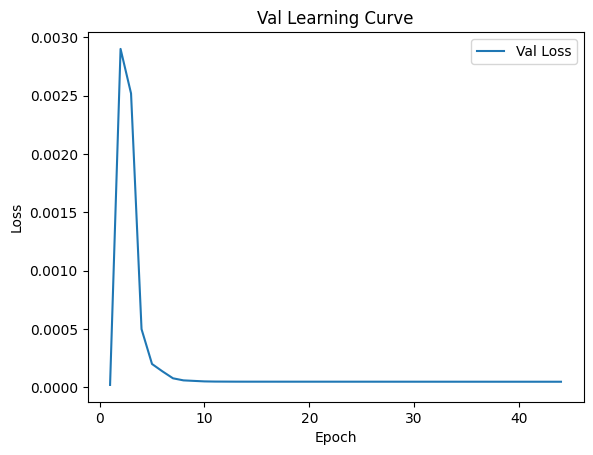


 Epoch: (45/50) Loss = 4.7526635171379894e-05

 Epoch: (45/50) Loss_rmse = 0.006893956568092108

 Epoch: (45/50) R^2 = 0.9982454180717468

 Epoch: (45/50) MAE = 0.0066823288798332214
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0

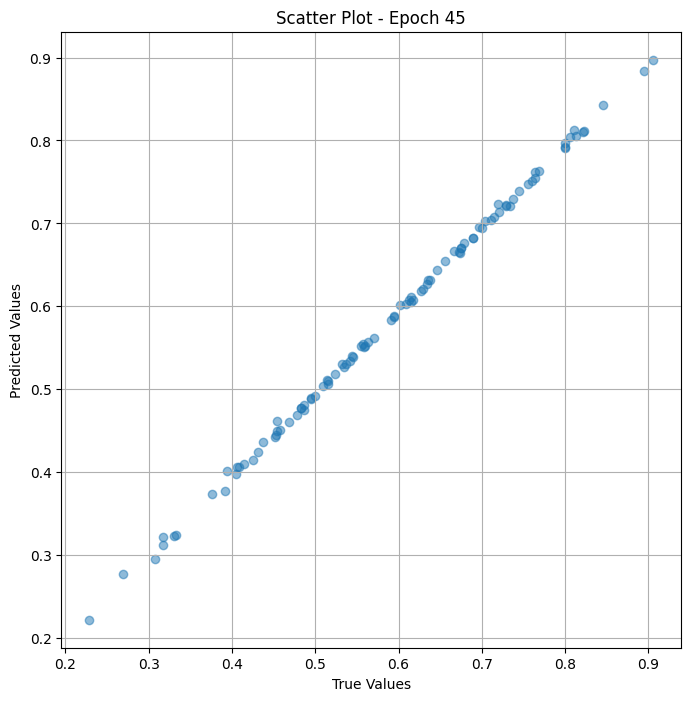

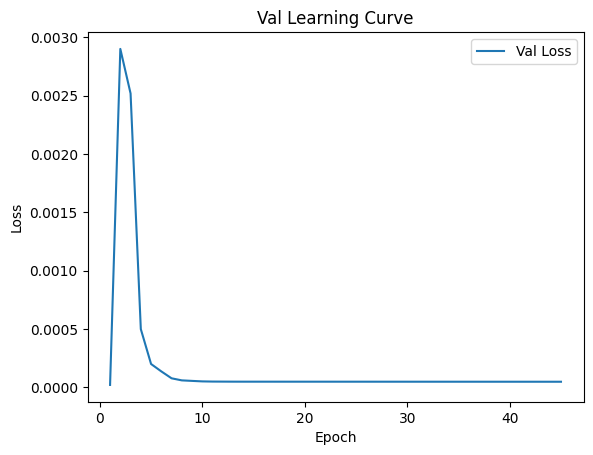


 Epoch: (46/50) Loss = 4.750337029690854e-05

 Epoch: (46/50) Loss_rmse = 0.0068922690115869045

 Epoch: (46/50) R^2 = 0.9982462525367737

 Epoch: (46/50) MAE = 0.006680883467197418
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

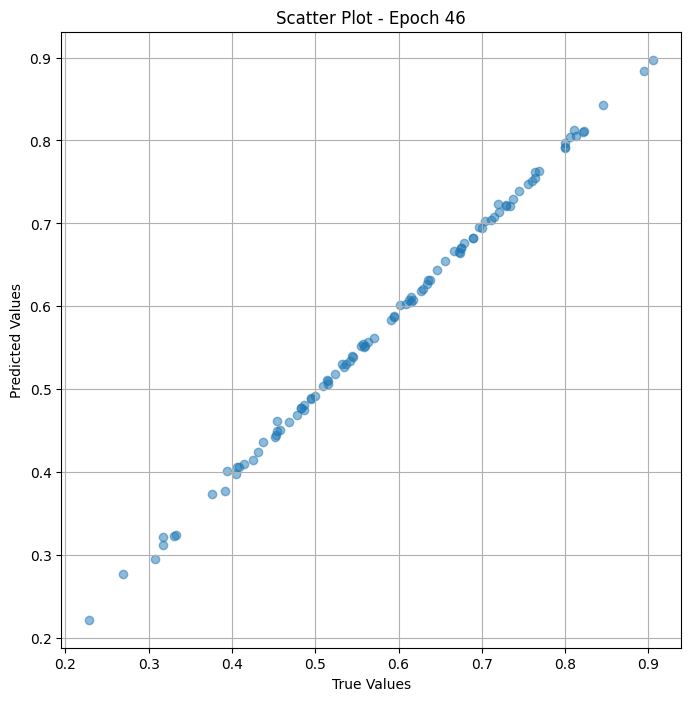

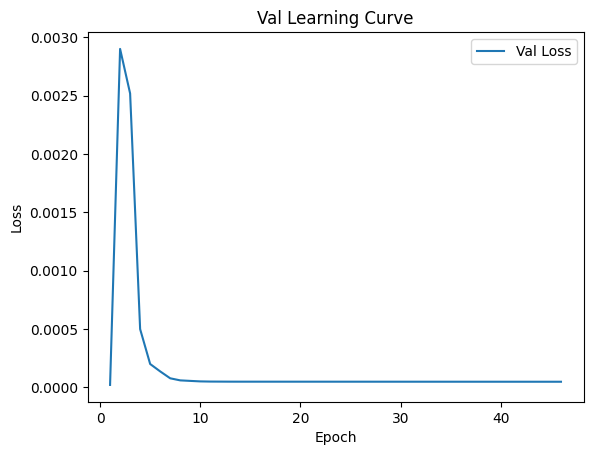


 Epoch: (47/50) Loss = 4.747968341689557e-05

 Epoch: (47/50) Loss_rmse = 0.006890550255775452

 Epoch: (47/50) R^2 = 0.9982471466064453

 Epoch: (47/50) MAE = 0.0066793859004974365
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

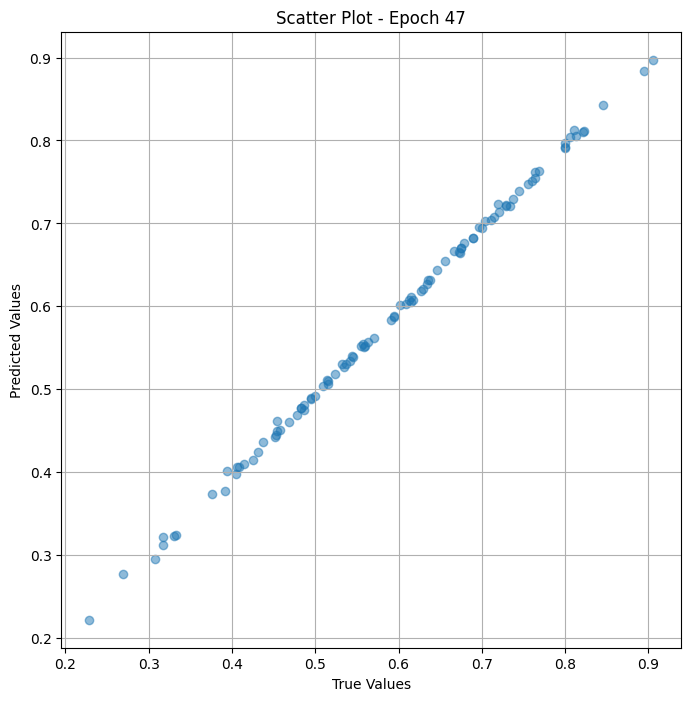

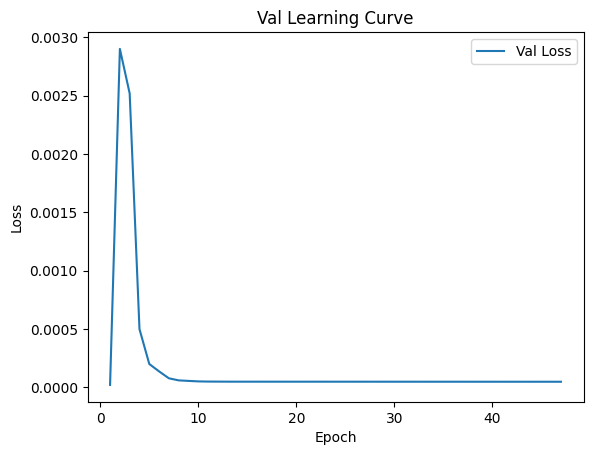


 Epoch: (48/50) Loss = 4.745584010379389e-05

 Epoch: (48/50) Loss_rmse = 0.006888819858431816

 Epoch: (48/50) R^2 = 0.9982480406761169

 Epoch: (48/50) MAE = 0.0066779255867004395
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.

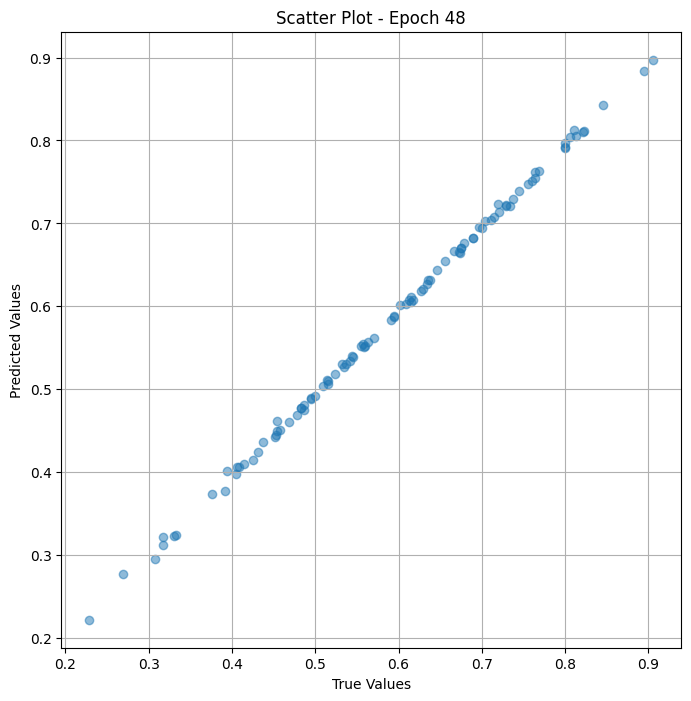

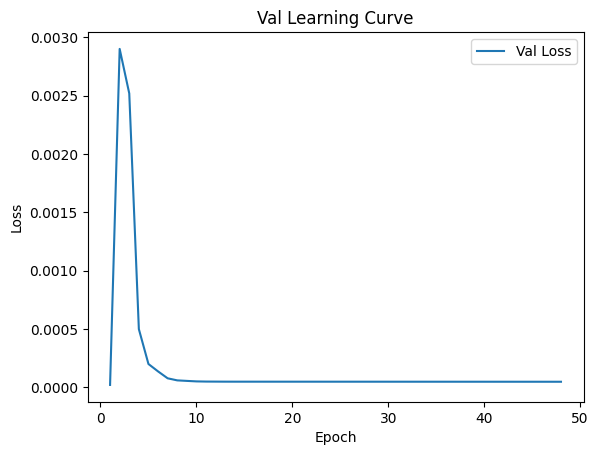


 Epoch: (49/50) Loss = 4.743006138596684e-05

 Epoch: (49/50) Loss_rmse = 0.006886948831379414

 Epoch: (49/50) R^2 = 0.9982489943504333

 Epoch: (49/50) MAE = 0.00667630136013031
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.31

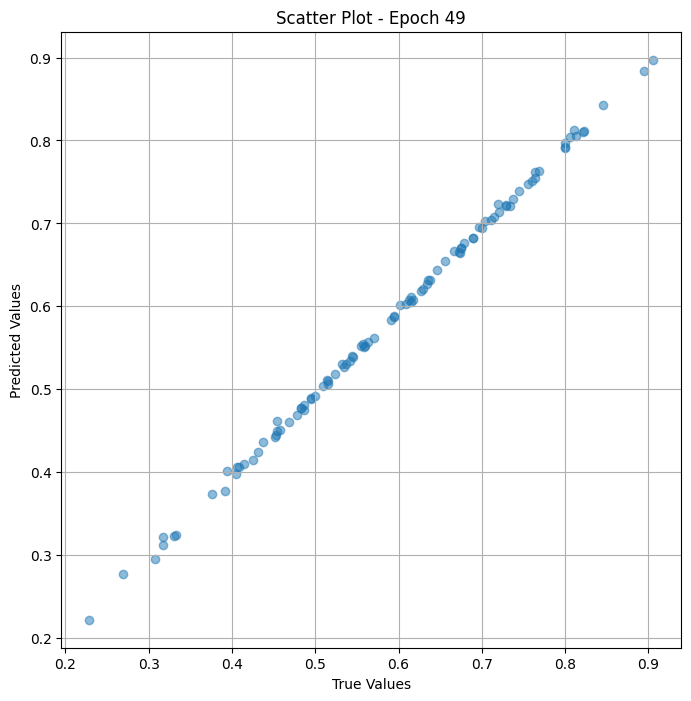

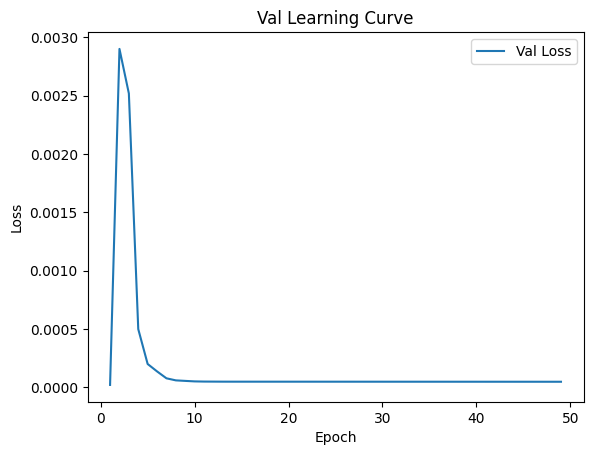


 Epoch: (50/50) Loss = 4.7405057557625696e-05

 Epoch: (50/50) Loss_rmse = 0.006885133218020201

 Epoch: (50/50) R^2 = 0.998249888420105

 Epoch: (50/50) MAE = 0.006674729287624359
Spearman correlation coefficient: SignificanceResult(statistic=0.9994709572576042, pvalue=1.152183435773322e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.76363635, 0.76404494, 0.7692308, 0.3764706, 0.5638298, 0.8125, 0.4827586, 0.40860215, 0.72115386, 0.4059406, 0.33333334, 0.627451, 0.8455882, 0.6122449, 0.8947368, 0.72897196, 0.67469877, 0.6344086, 0.49425286, 0.30701753, 0.71428573, 0.41489363, 0.6896552, 0.80582523, 0.52427185, 0.7294118, 0.45238096, 0.67391306, 0.6788991, 0.47826087, 0.22881356, 0.57009345, 0.3301887, 0.73333335, 0.5326087, 0.63529414, 0.59090906, 0.6091954, 0.5945946, 0.60194176, 0.6145833, 0.7446808, 0.45217392, 0.61538464, 0.4827586, 0.43103448, 0.75490195, 0.39175257, 0.7, 0.5339806, 0.6969697, 0.50961536, 0.7368421, 0.5543478, 0.3

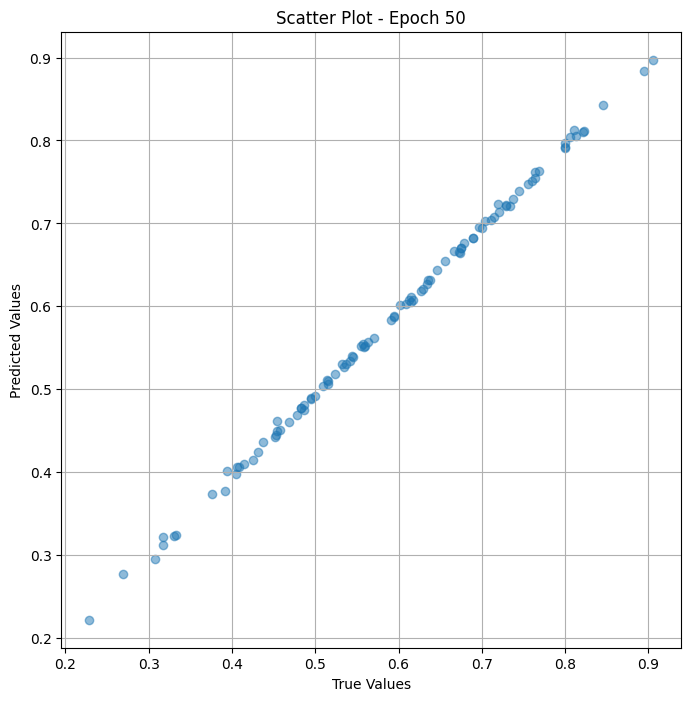

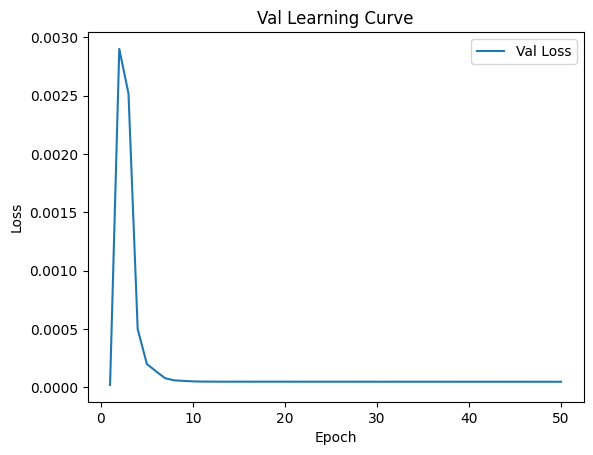

In [ ]:
# val the model and save weights
fit(50, model_res_val  , val_dl )
torch.save(model_res_val.state_dict(), "model_weights_s")

## Test

In [ ]:
params = [param for param in list(model_res_test.parameters()) if param.requires_grad == True ]
optimizer = torch.optim.Adam(params, lr=1e-4 ,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.00013305727043189108

 Epoch: (1/50) Loss_rmse = 0.011535045690834522

 Epoch: (1/50) R^2 = 0.9738865494728088

 Epoch: (1/50) MAE = 0.010367803275585175
Spearman correlation coefficient: SignificanceResult(statistic=0.971500078020704, pvalue=1.444147125844892e-60)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.644

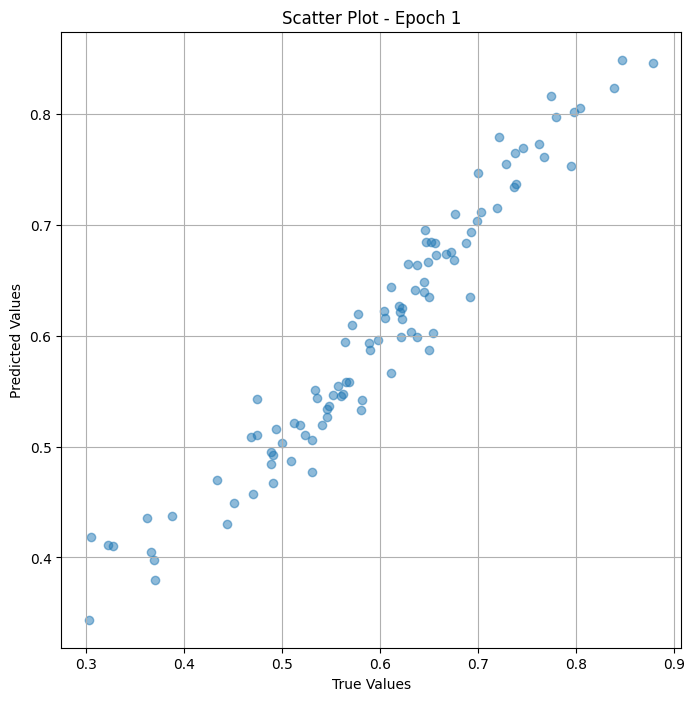

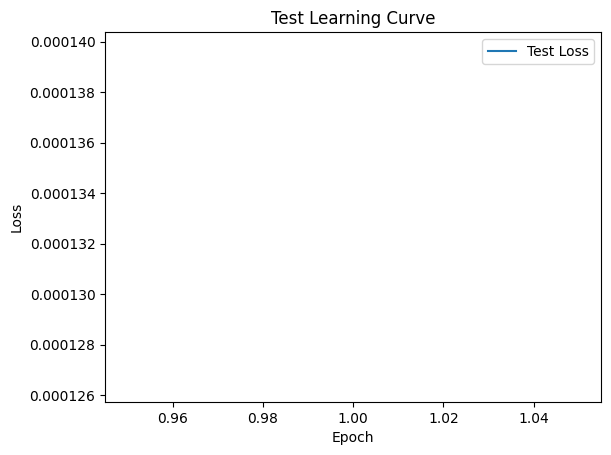


 Epoch: (2/50) Loss = 0.001340845599770546

 Epoch: (2/50) Loss_rmse = 0.03661755844950676

 Epoch: (2/50) R^2 = 0.736849308013916

 Epoch: (2/50) MAE = 0.02722916752099991
Spearman correlation coefficient: SignificanceResult(statistic=0.9648736087688611, pvalue=2.2957212520938313e-56)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.644736

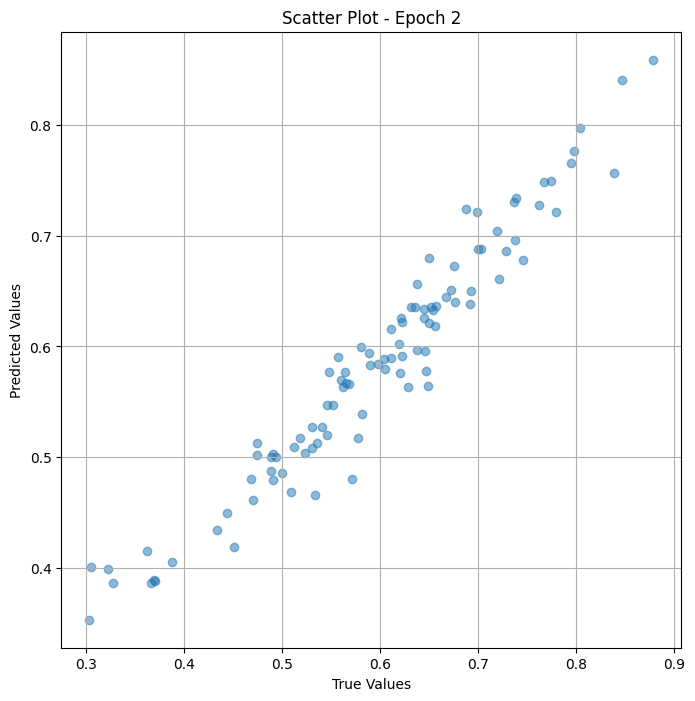

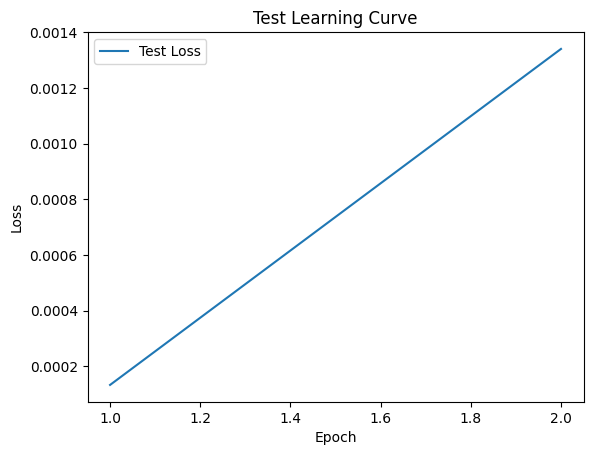


 Epoch: (3/50) Loss = 0.0004098805657122284

 Epoch: (3/50) Loss_rmse = 0.0202455073595047

 Epoch: (3/50) R^2 = 0.9195579886436462

 Epoch: (3/50) MAE = 0.01736895740032196
Spearman correlation coefficient: SignificanceResult(statistic=0.9665624427951752, pvalue=2.3548359694516155e-57)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.64473

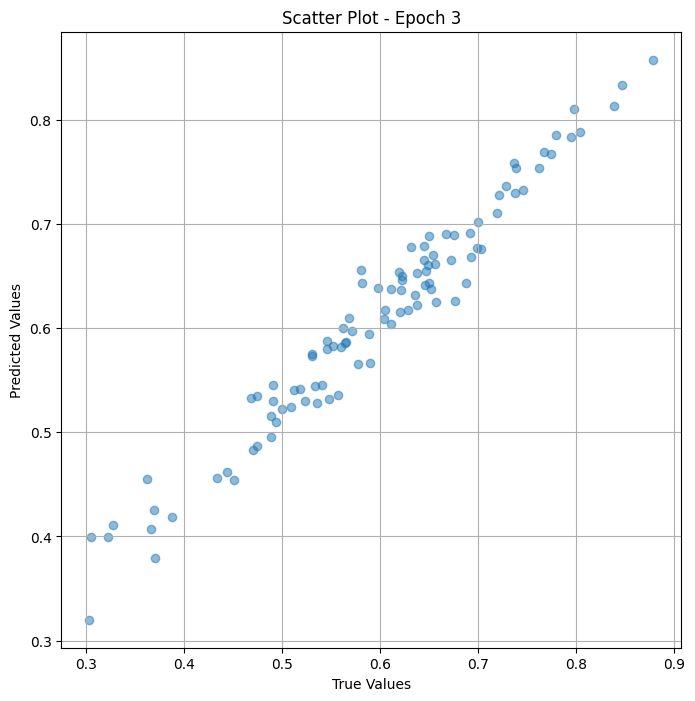

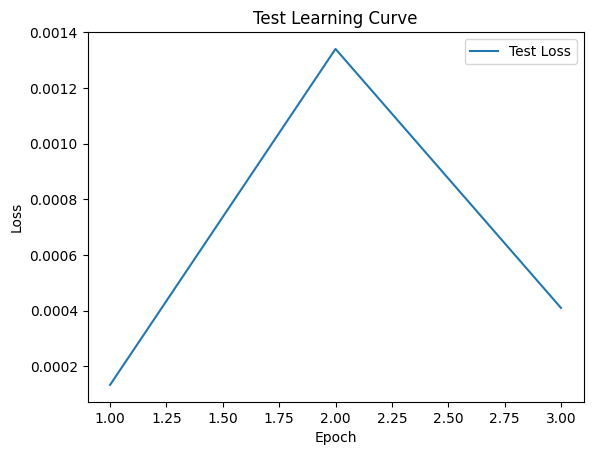

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (4/50) Loss = 0.0003679936926346272

 Epoch: (4/50) Loss_rmse = 0.019183162599802017

 Epoch: (4/50) R^2 = 0.9277786016464233

 Epoch: (4/50) MAE = 0.01532580703496933
Spearman correlation coefficient: SignificanceResult(statistic=0.9899687328546533, pvalue=1.0666055700978902e-81)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308

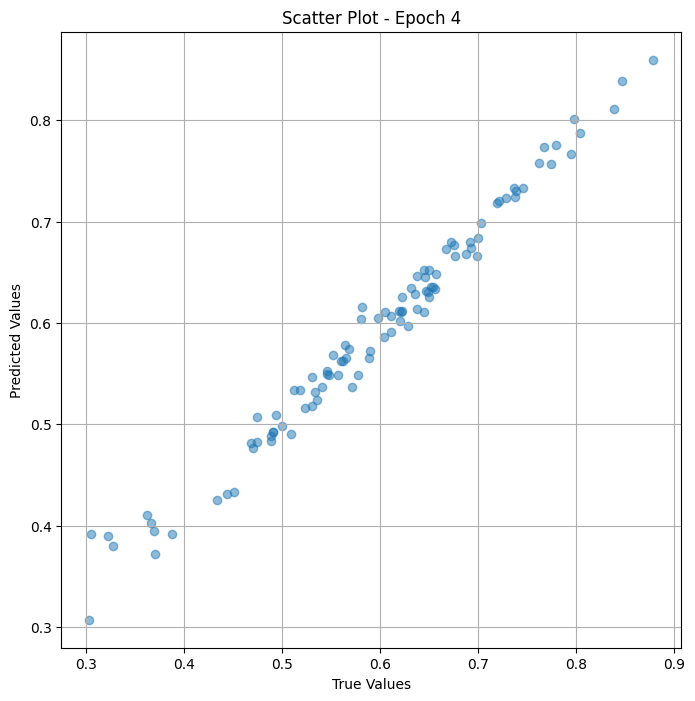

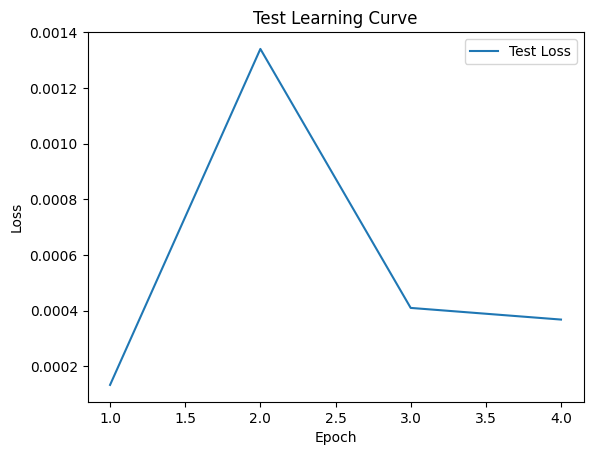


 Epoch: (5/50) Loss = 0.00019759660062845796

 Epoch: (5/50) Loss_rmse = 0.01405690610408783

 Epoch: (5/50) R^2 = 0.9612202644348145

 Epoch: (5/50) MAE = 0.01041720062494278
Spearman correlation coefficient: SignificanceResult(statistic=0.9911014046714984, pvalue=3.9221008553988524e-84)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.644

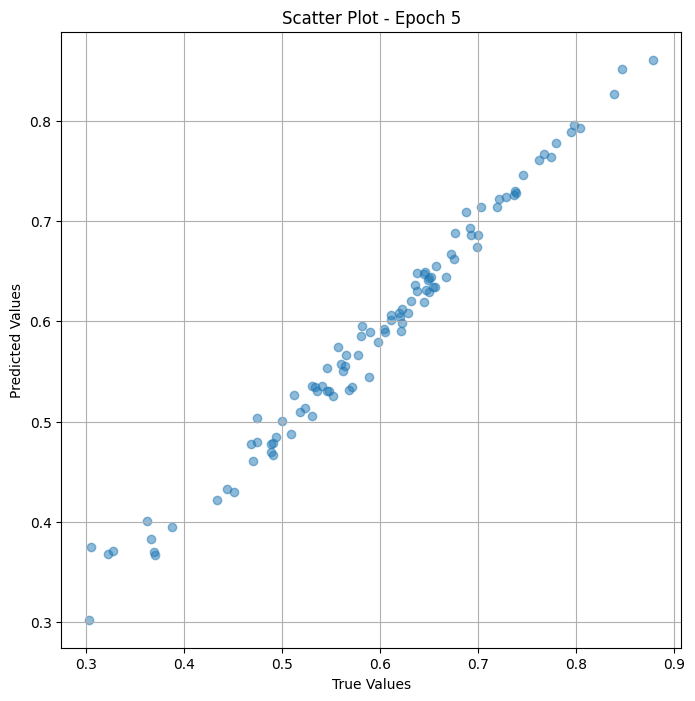

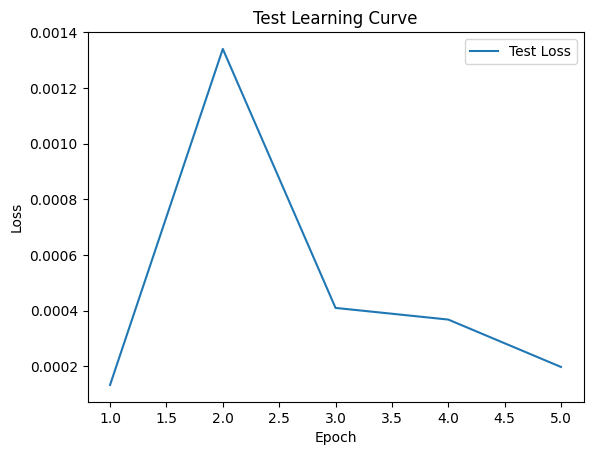


 Epoch: (6/50) Loss = 0.00010955172183457762

 Epoch: (6/50) Loss_rmse = 0.01046669576317072

 Epoch: (6/50) R^2 = 0.9784996509552002

 Epoch: (6/50) MAE = 0.007987312972545624
Spearman correlation coefficient: SignificanceResult(statistic=0.9922340764883437, pvalue=6.692820078801408e-87)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.644

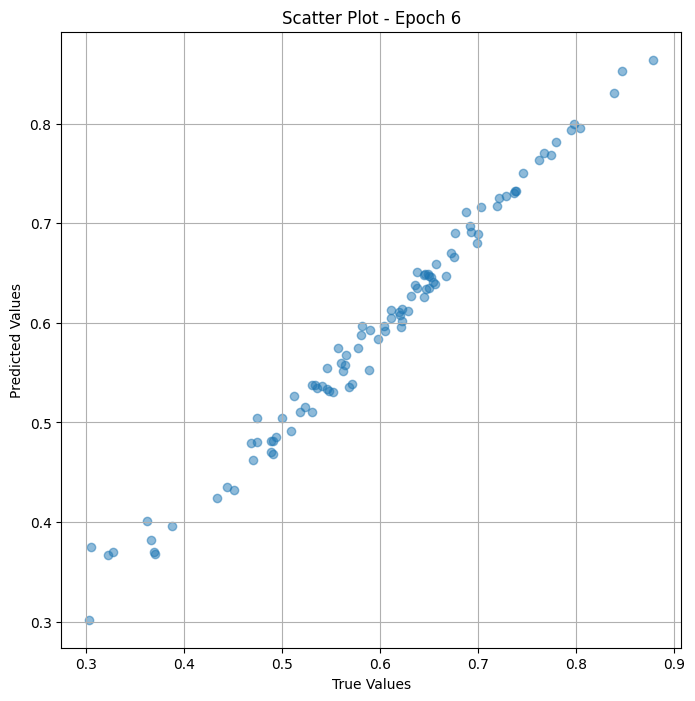

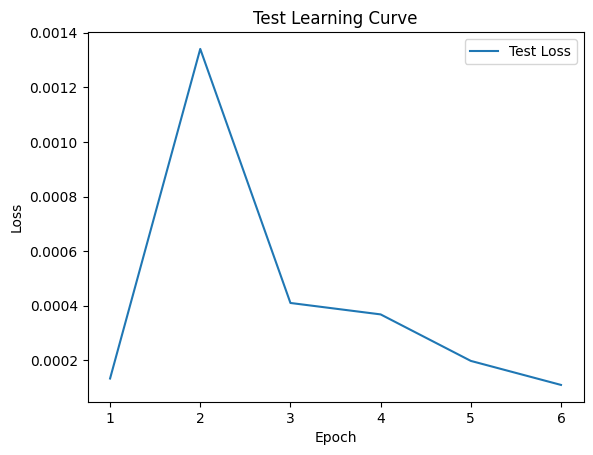


 Epoch: (7/50) Loss = 5.139739005244337e-05

 Epoch: (7/50) Loss_rmse = 0.00716919731348753

 Epoch: (7/50) R^2 = 0.9899128675460815

 Epoch: (7/50) MAE = 0.006327815353870392
Spearman correlation coefficient: SignificanceResult(statistic=0.9938211735251208, pvalue=1.4951679466139714e-91)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.644

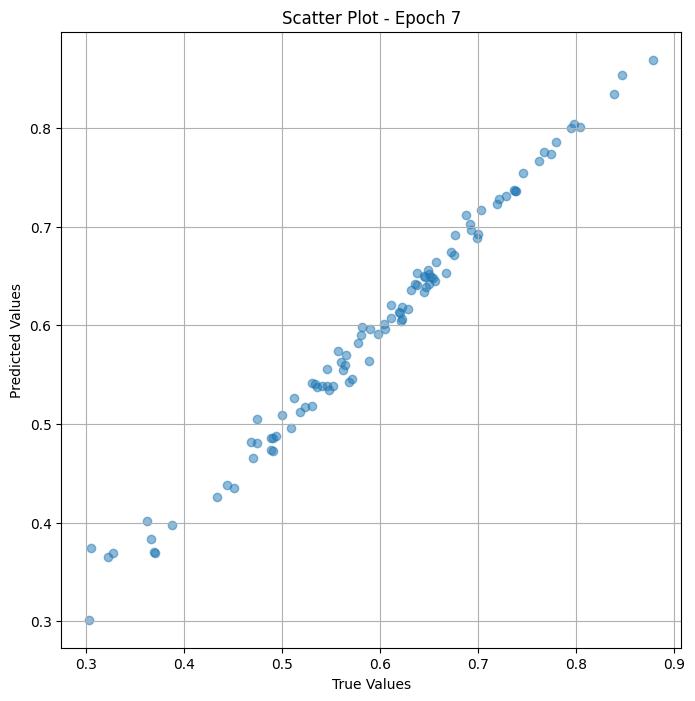

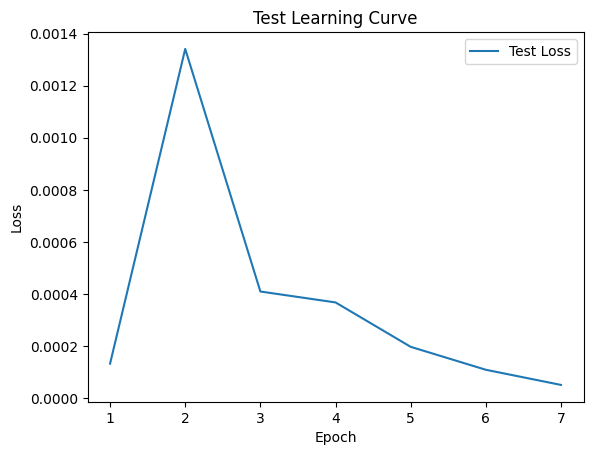


 Epoch: (8/50) Loss = 2.6064964913530275e-05

 Epoch: (8/50) Loss_rmse = 0.005105386022478342

 Epoch: (8/50) R^2 = 0.9948845505714417

 Epoch: (8/50) MAE = 0.004878319799900055
Spearman correlation coefficient: SignificanceResult(statistic=0.995306533572361, pvalue=3.7746657725891527e-97)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 0.64

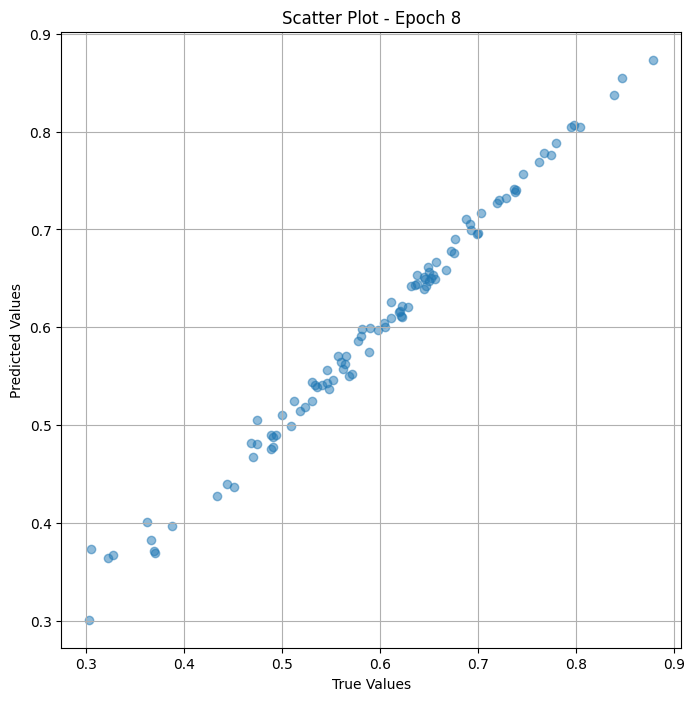

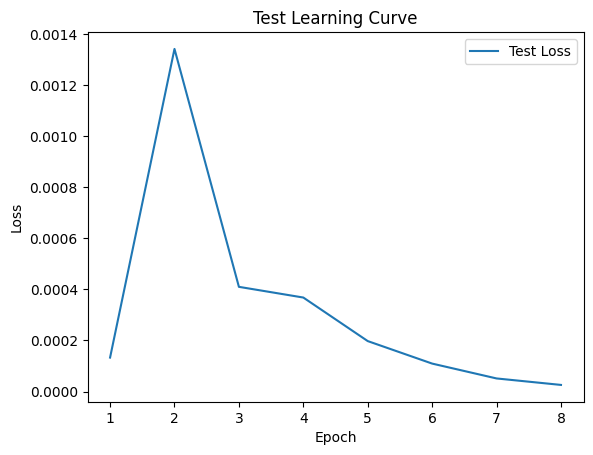


 Epoch: (9/50) Loss = 1.3252287317300215e-05

 Epoch: (9/50) Loss_rmse = 0.0036403690464794636

 Epoch: (9/50) R^2 = 0.9973991513252258

 Epoch: (9/50) MAE = 0.0033414065837860107
Spearman correlation coefficient: SignificanceResult(statistic=0.9963374683996692, pvalue=3.3458174784028444e-102)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 

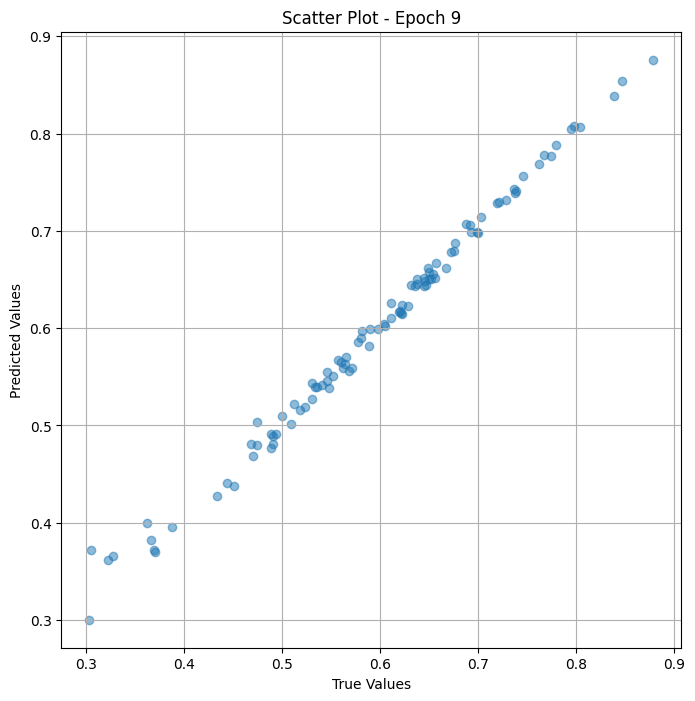

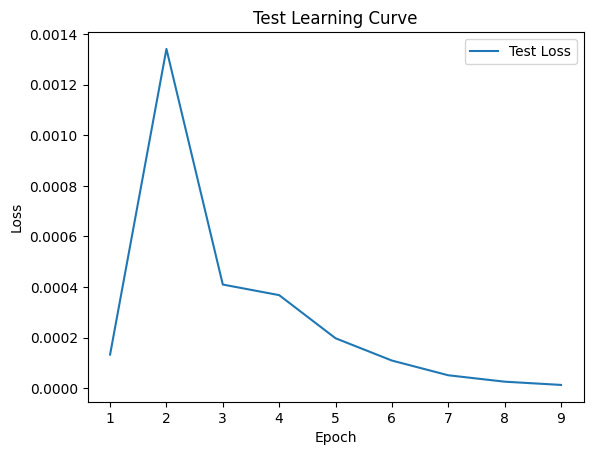


 Epoch: (10/50) Loss = 5.188973773329053e-06

 Epoch: (10/50) Loss_rmse = 0.002277931896969676

 Epoch: (10/50) R^2 = 0.9989816546440125

 Epoch: (10/50) MAE = 0.001967616379261017
Spearman correlation coefficient: SignificanceResult(statistic=0.9974904876144217, pvalue=6.588257126167508e-110)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876, 

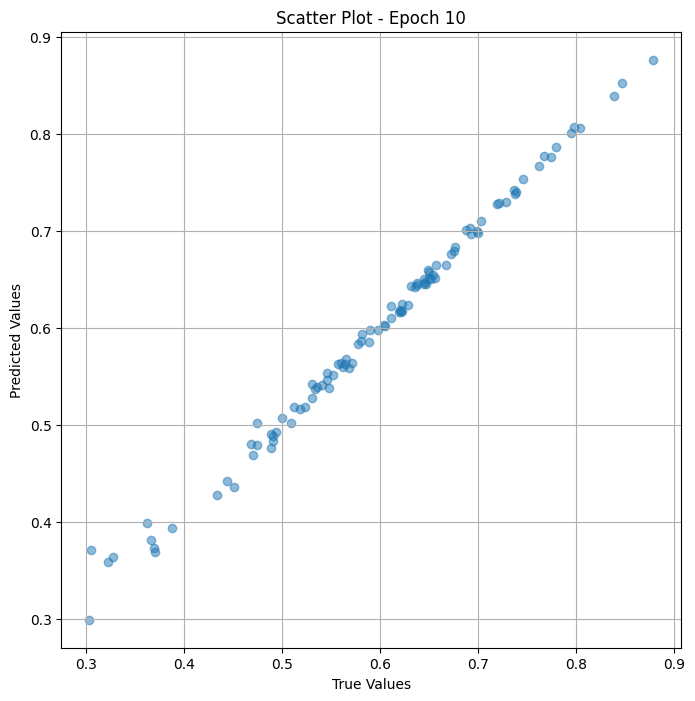

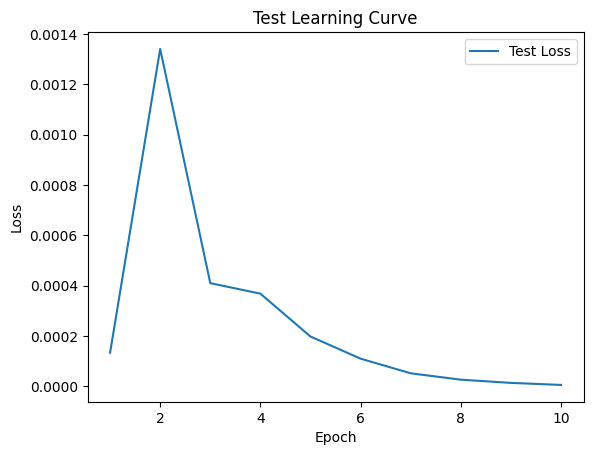


 Epoch: (11/50) Loss = 1.524768777017016e-06

 Epoch: (11/50) Loss_rmse = 0.0012348152231425047

 Epoch: (11/50) R^2 = 0.9997007250785828

 Epoch: (11/50) MAE = 0.0010293424129486084
Spearman correlation coefficient: SignificanceResult(statistic=0.9982026465411808, pvalue=1.029954670918194e-116)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

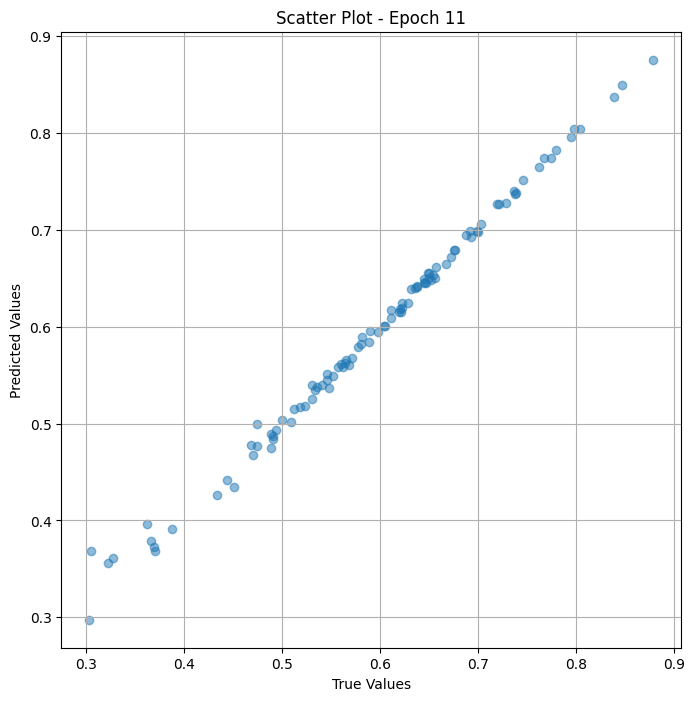

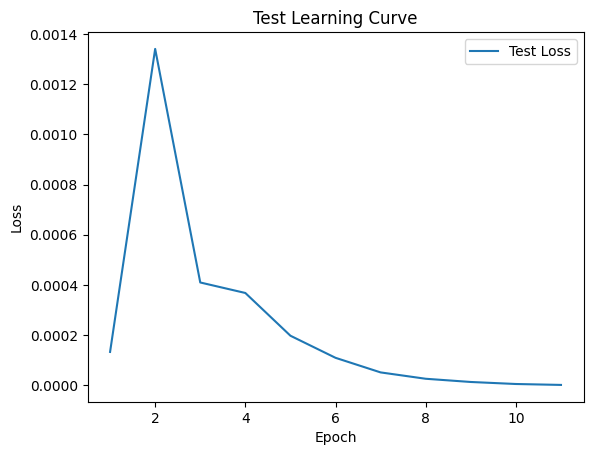


 Epoch: (12/50) Loss = 1.3866817880625604e-06

 Epoch: (12/50) Loss_rmse = 0.0011775745078921318

 Epoch: (12/50) R^2 = 0.9997278451919556

 Epoch: (12/50) MAE = 0.0010653287172317505
Spearman correlation coefficient: SignificanceResult(statistic=0.9985417698396373, pvalue=5.6000130582194755e-121)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.621848

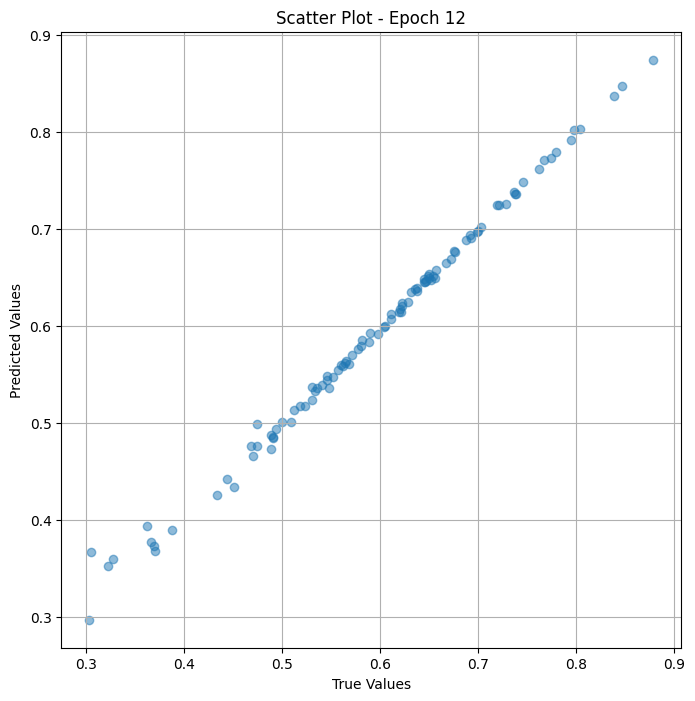

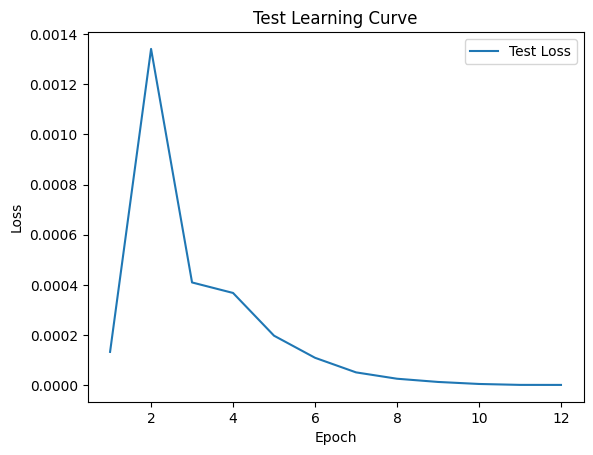


 Epoch: (13/50) Loss = 1.5884082813499845e-06

 Epoch: (13/50) Loss_rmse = 0.0012603206560015678

 Epoch: (13/50) R^2 = 0.9996882677078247

 Epoch: (13/50) MAE = 0.0010630041360855103
Spearman correlation coefficient: SignificanceResult(statistic=0.9987520262846804, pvalue=3.733162005092928e-124)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.6218487

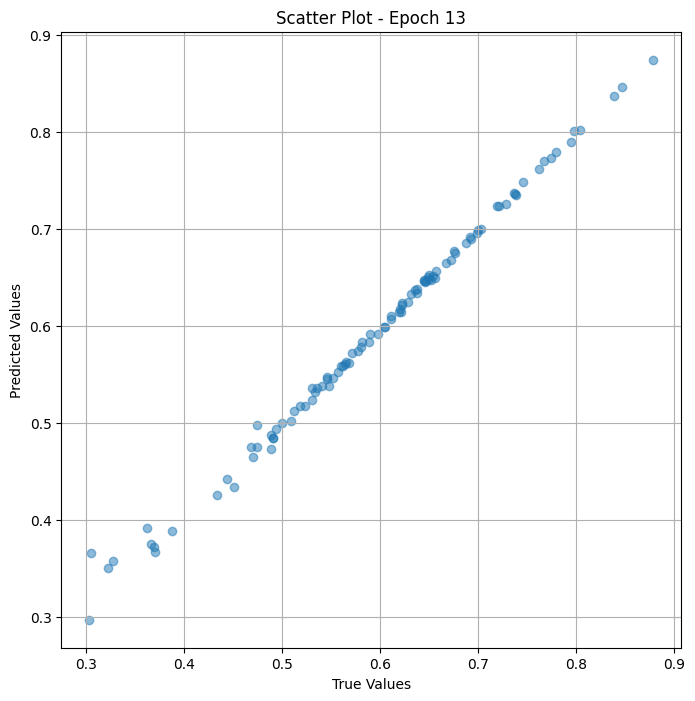

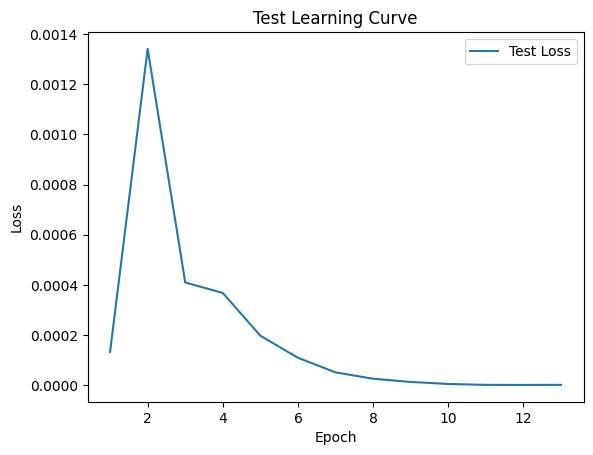


 Epoch: (14/50) Loss = 1.1860620361403562e-06

 Epoch: (14/50) Loss_rmse = 0.001089064753614366

 Epoch: (14/50) R^2 = 0.9997672438621521

 Epoch: (14/50) MAE = 0.0009140223264694214
Spearman correlation coefficient: SignificanceResult(statistic=0.9988537632742175, pvalue=6.875588356770278e-126)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

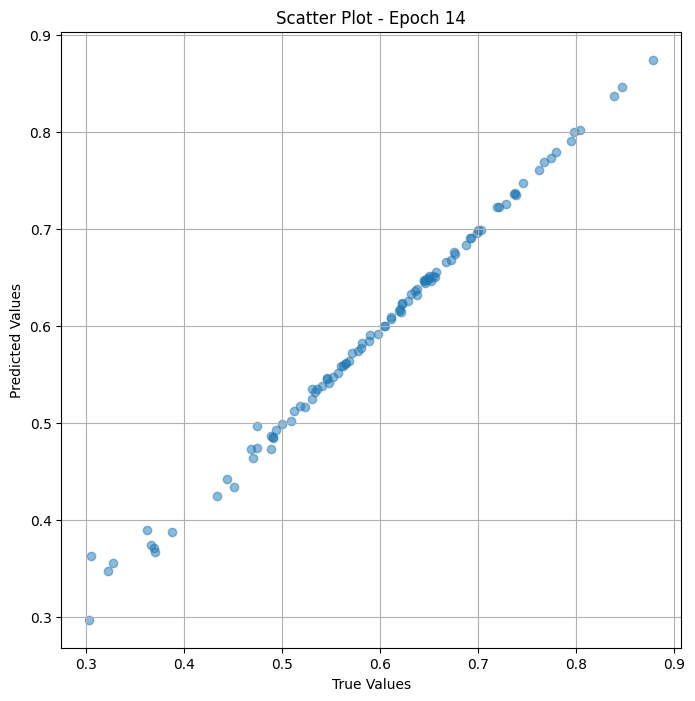

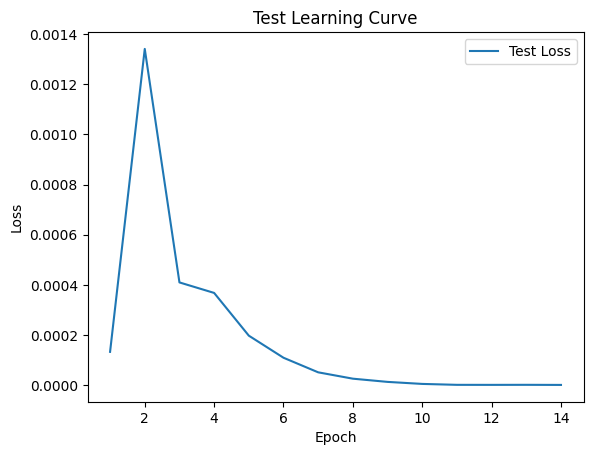


 Epoch: (15/50) Loss = 1.0173876034968998e-06

 Epoch: (15/50) Loss_rmse = 0.0010086563415825367

 Epoch: (15/50) R^2 = 0.9998003244400024

 Epoch: (15/50) MAE = 0.0006267577409744263
Spearman correlation coefficient: SignificanceResult(statistic=0.9990504547873224, pvalue=9.921494279158153e-130)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.6218487

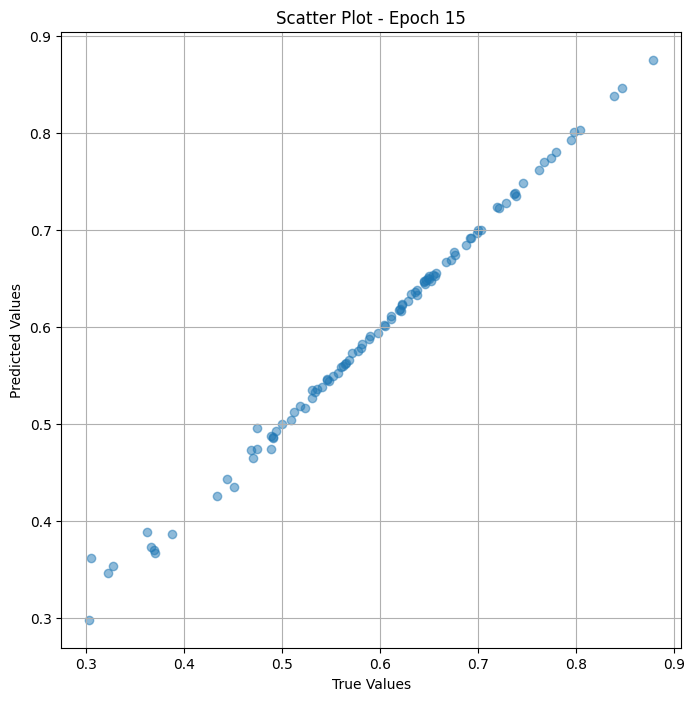

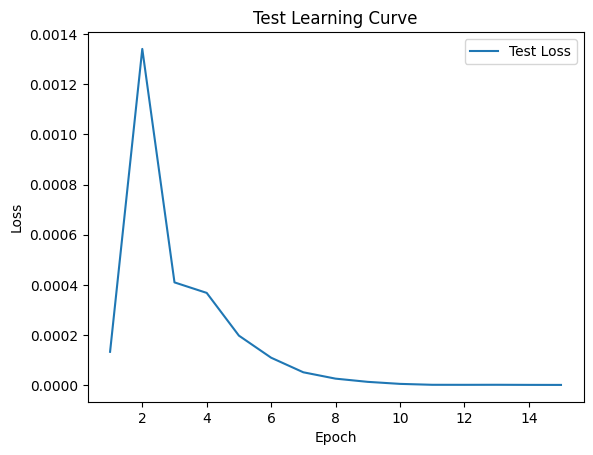


 Epoch: (16/50) Loss = 9.156640317087295e-07

 Epoch: (16/50) Loss_rmse = 0.0009569033281877637

 Epoch: (16/50) R^2 = 0.9998202919960022

 Epoch: (16/50) MAE = 0.0006461665034294128
Spearman correlation coefficient: SignificanceResult(statistic=0.999131844378952, pvalue=1.473073202133389e-131)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

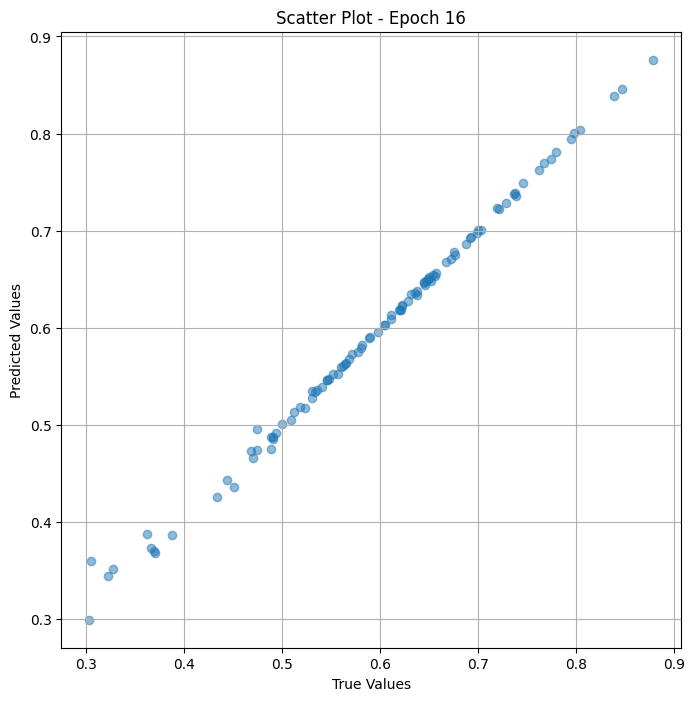

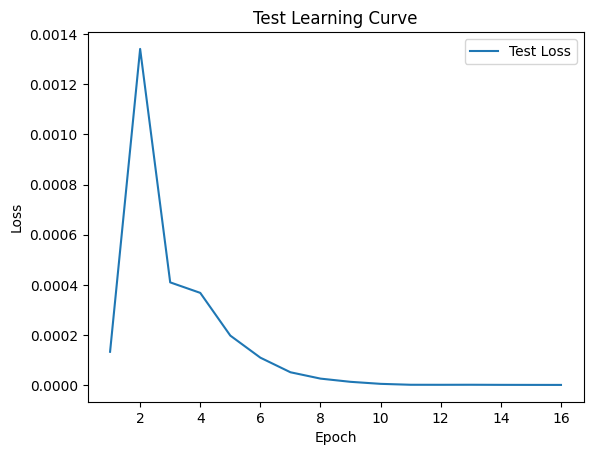


 Epoch: (17/50) Loss = 3.907109942247189e-07

 Epoch: (17/50) Loss_rmse = 0.0006250687874853611

 Epoch: (17/50) R^2 = 0.9999233484268188

 Epoch: (17/50) MAE = 0.00047950446605682373
Spearman correlation coefficient: SignificanceResult(statistic=0.9992674936983346, pvalue=5.030364033538953e-135)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.6218487

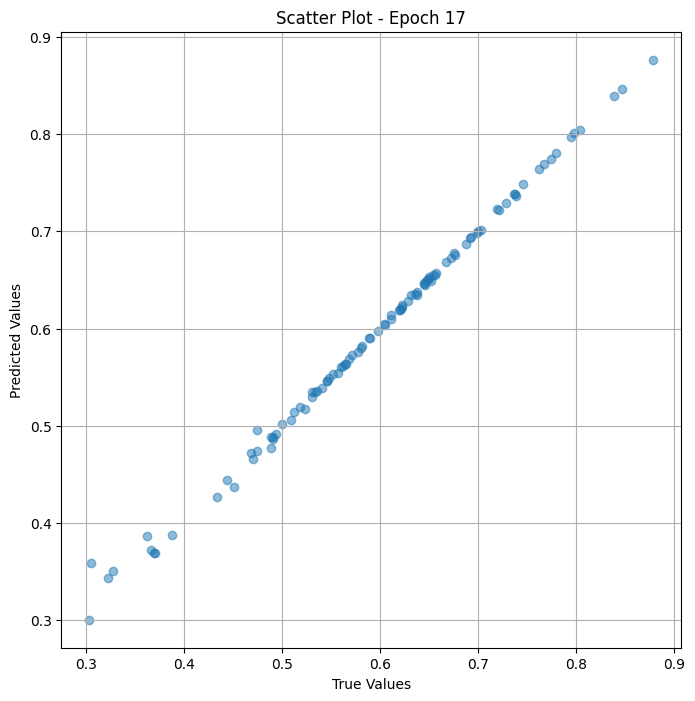

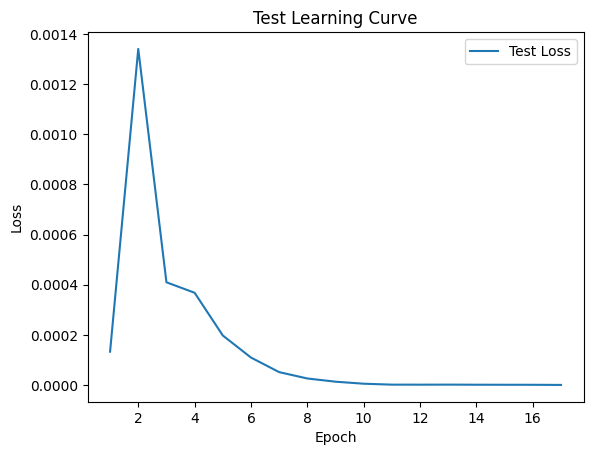


 Epoch: (18/50) Loss = 2.162451018250522e-08

 Epoch: (18/50) Loss_rmse = 0.00014705274952575564

 Epoch: (18/50) R^2 = 0.999995768070221

 Epoch: (18/50) MAE = 0.0001367330551147461
Spearman correlation coefficient: SignificanceResult(statistic=0.9992946235622112, pvalue=8.541128765931422e-136)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

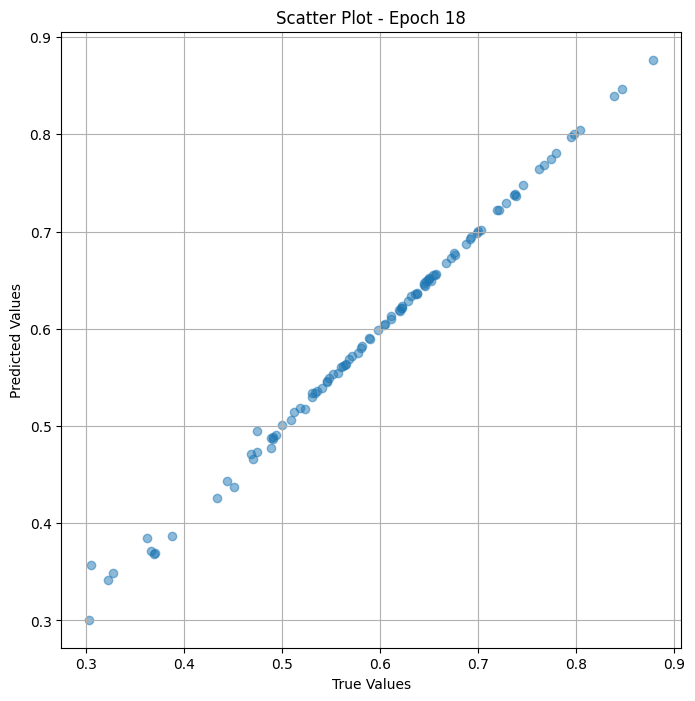

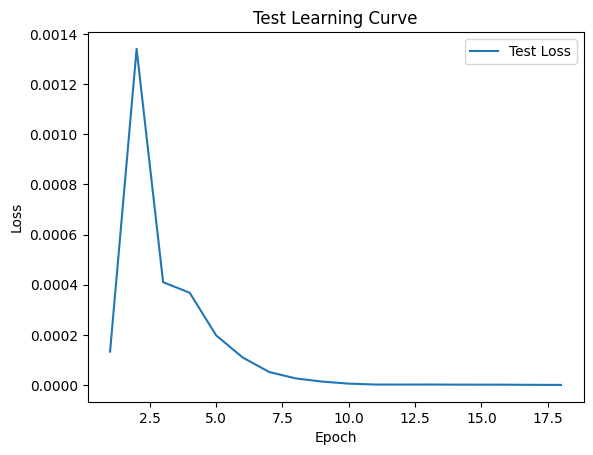


 Epoch: (19/50) Loss = 1.2614665934052027e-07

 Epoch: (19/50) Loss_rmse = 0.00035517130163498223

 Epoch: (19/50) R^2 = 0.9999752640724182

 Epoch: (19/50) MAE = 0.0003080293536186218
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.6218487

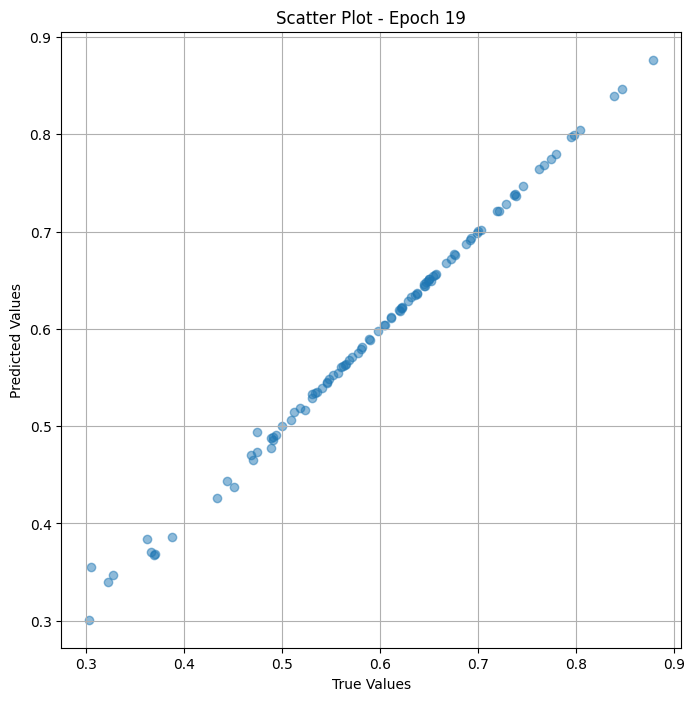

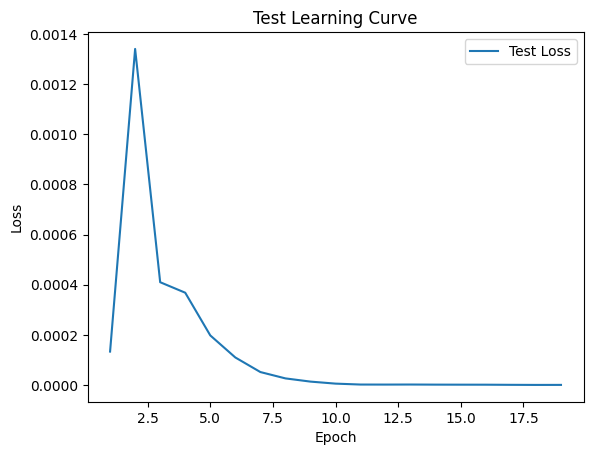


 Epoch: (20/50) Loss = 2.694348211207398e-07

 Epoch: (20/50) Loss_rmse = 0.0005190711235627532

 Epoch: (20/50) R^2 = 0.9999471306800842

 Epoch: (20/50) MAE = 0.0004393532872200012
Spearman correlation coefficient: SignificanceResult(statistic=0.9993624482219025, pvalue=7.389600421947962e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

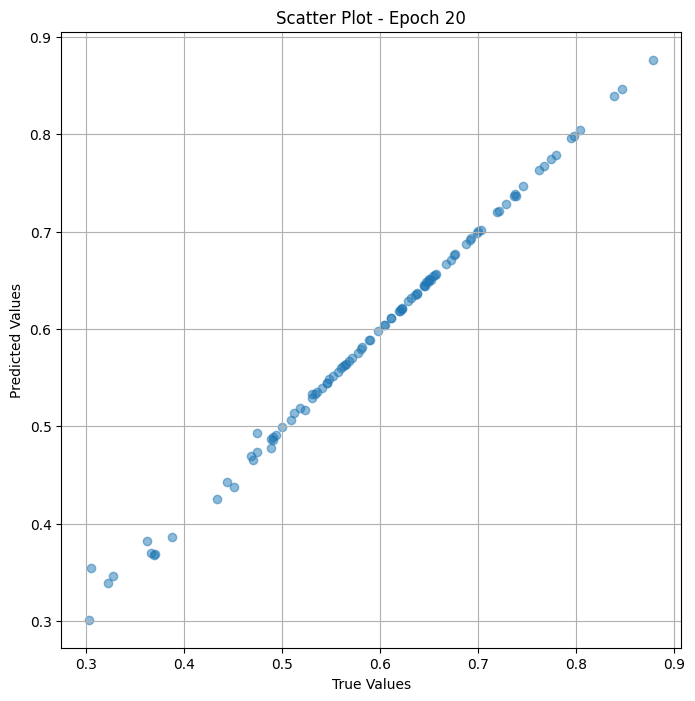

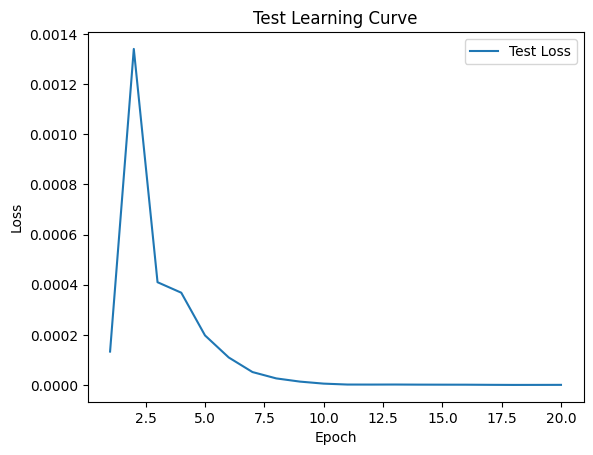

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (21/50) Loss = 1.6461878260543017e-07

 Epoch: (21/50) Loss_rmse = 0.00040573239675723016

 Epoch: (21/50) R^2 = 0.9999676942825317

 Epoch: (21/50) MAE = 0.00030003488063812256
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.581632

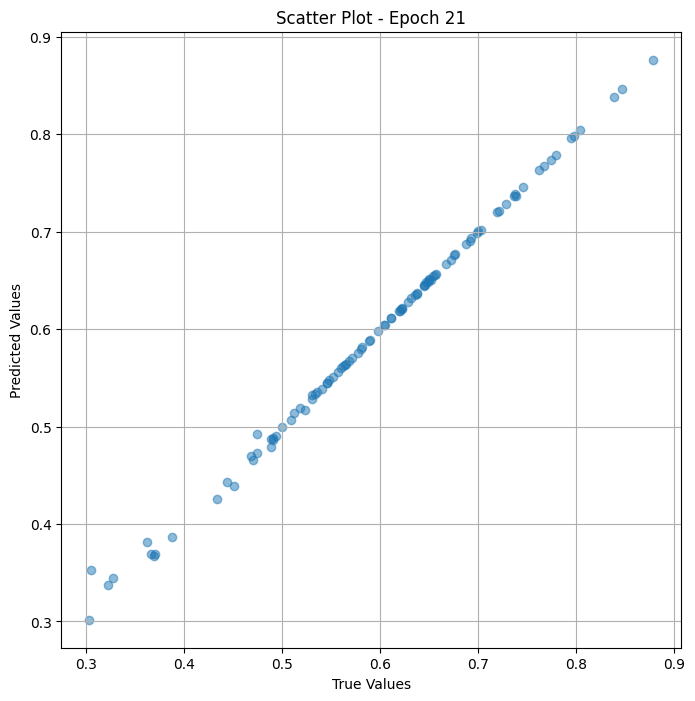

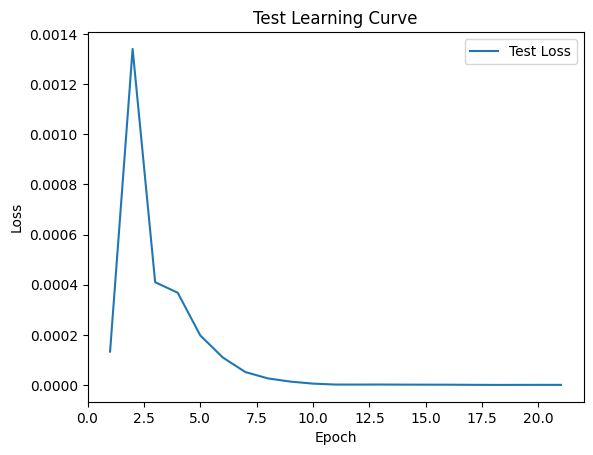


 Epoch: (22/50) Loss = 1.0505141290195752e-07

 Epoch: (22/50) Loss_rmse = 0.0003241163503844291

 Epoch: (22/50) R^2 = 0.9999793767929077

 Epoch: (22/50) MAE = 0.0002150014042854309
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

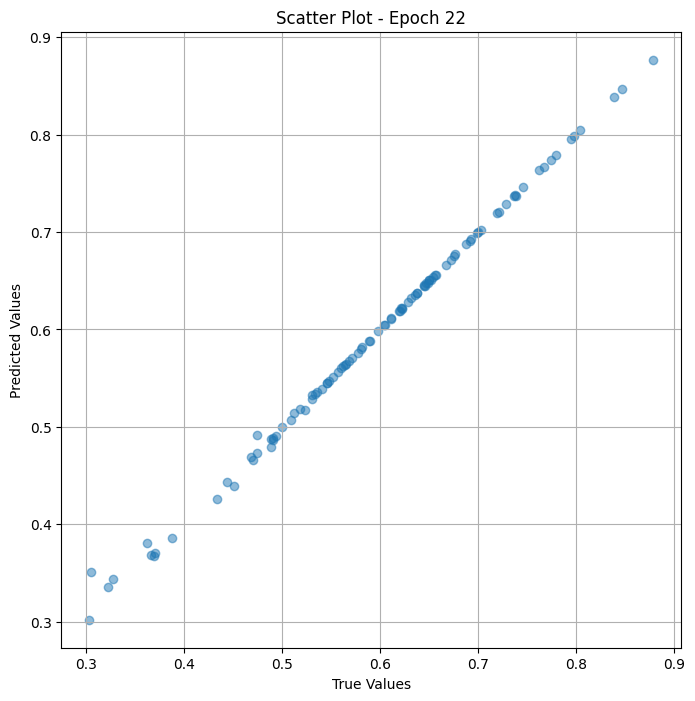

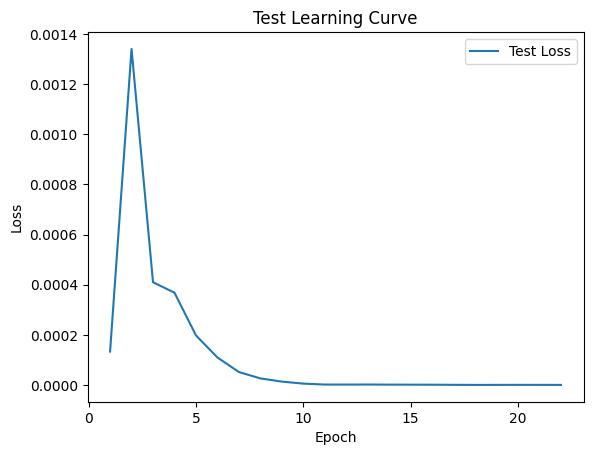


 Epoch: (23/50) Loss = 8.840027732048839e-08

 Epoch: (23/50) Loss_rmse = 0.0002973218506667763

 Epoch: (23/50) R^2 = 0.9999826550483704

 Epoch: (23/50) MAE = 0.0001986473798751831
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

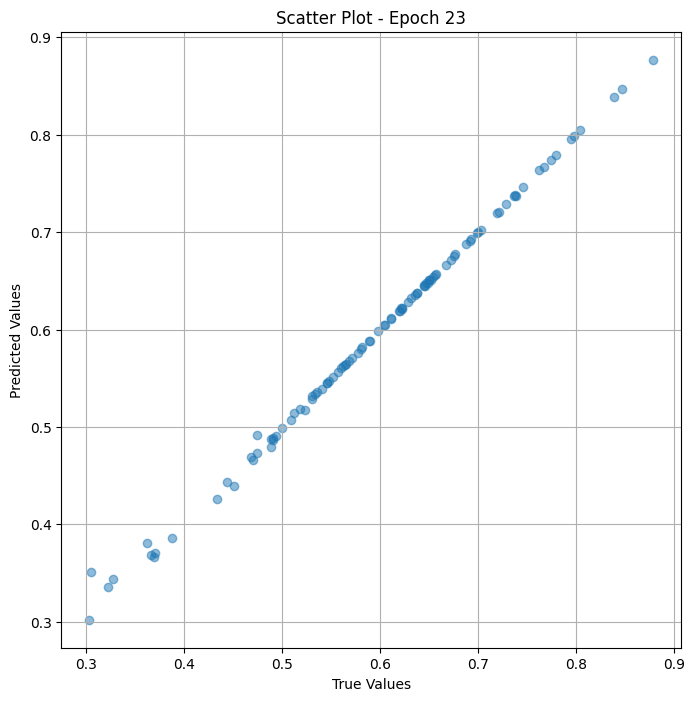

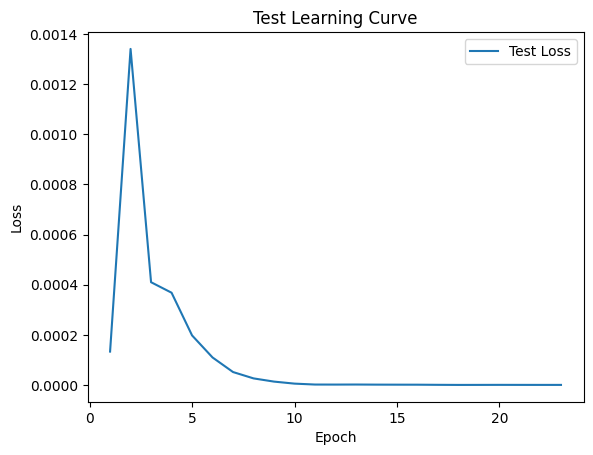

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (24/50) Loss = 7.251984612821616e-08

 Epoch: (24/50) Loss_rmse = 0.0002692950947675854

 Epoch: (24/50) R^2 = 0.9999857544898987

 Epoch: (24/50) MAE = 0.00019166618585586548
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327,

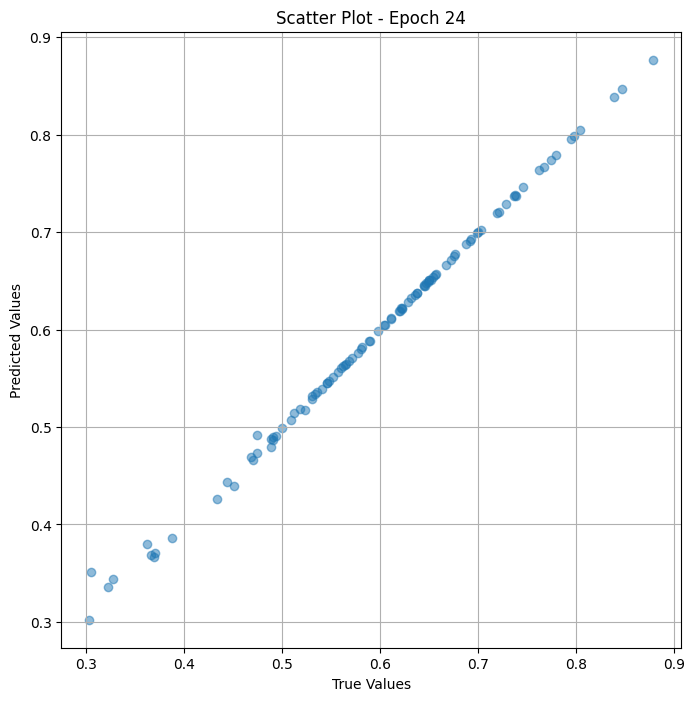

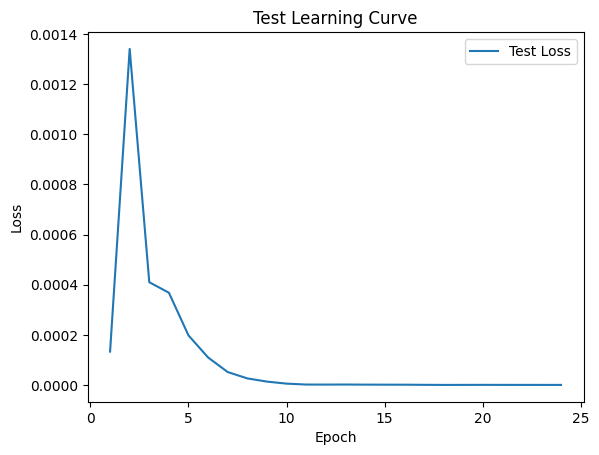


 Epoch: (25/50) Loss = 6.74570515002415e-08

 Epoch: (25/50) Loss_rmse = 0.00025972494040615857

 Epoch: (25/50) R^2 = 0.9999867677688599

 Epoch: (25/50) MAE = 0.00018817931413650513
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

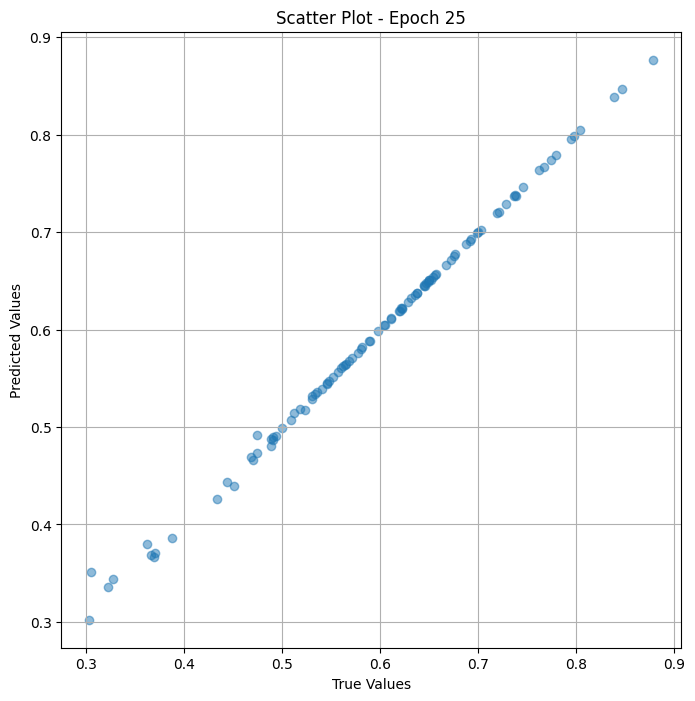

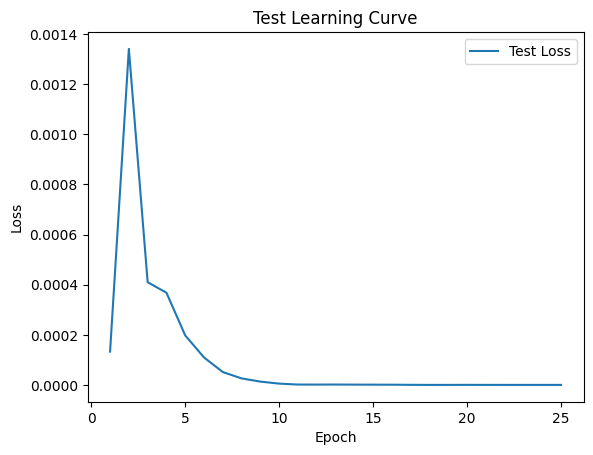


 Epoch: (26/50) Loss = 6.637804972342565e-08

 Epoch: (26/50) Loss_rmse = 0.0002576393890194595

 Epoch: (26/50) R^2 = 0.9999869465827942

 Epoch: (26/50) MAE = 0.00018728524446487427
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

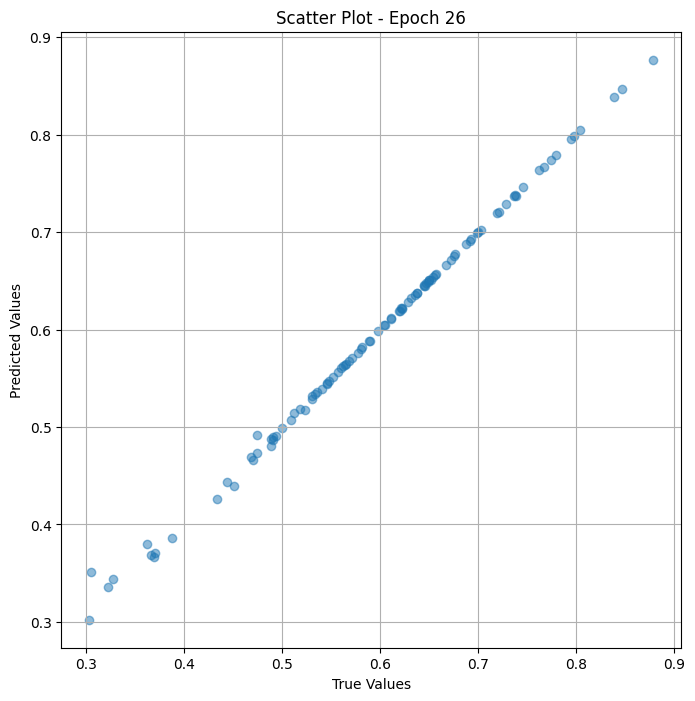

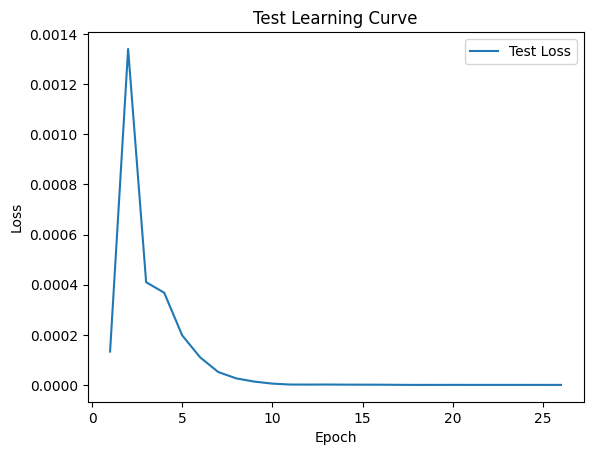

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (27/50) Loss = 6.528854612497526e-08

 Epoch: (27/50) Loss_rmse = 0.0002555162354838103

 Epoch: (27/50) R^2 = 0.9999871850013733

 Epoch: (27/50) MAE = 0.00018630176782608032
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327,

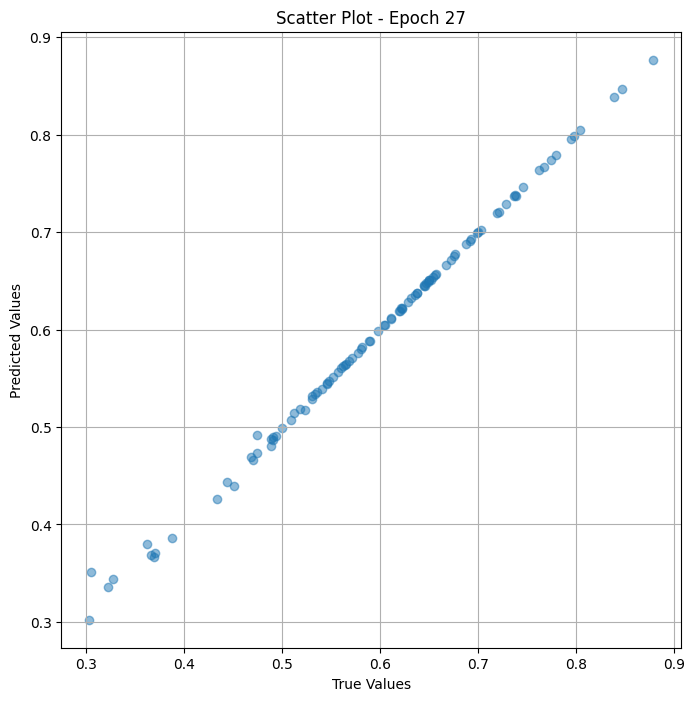

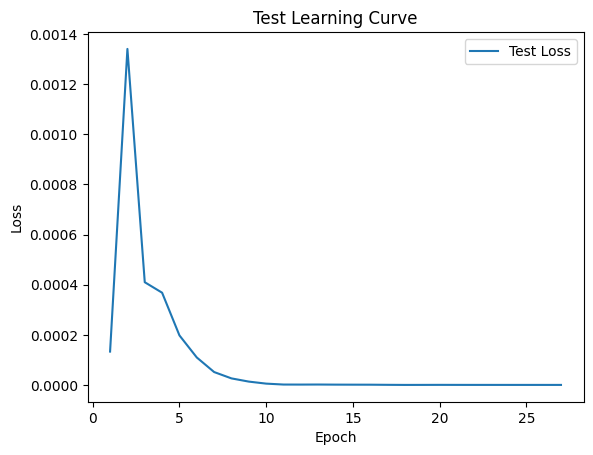


 Epoch: (28/50) Loss = 6.498268589893996e-08

 Epoch: (28/50) Loss_rmse = 0.0002549170167185366

 Epoch: (28/50) R^2 = 0.9999872446060181

 Epoch: (28/50) MAE = 0.00018600374460220337
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

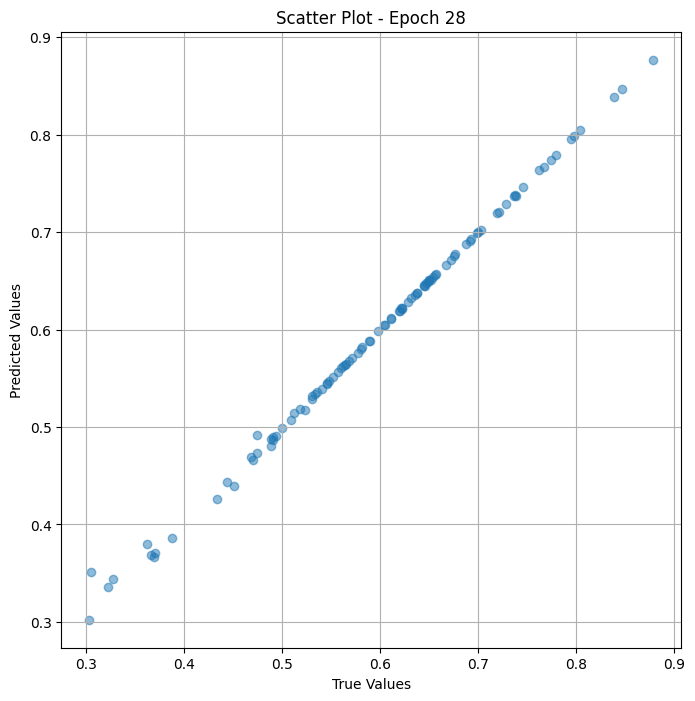

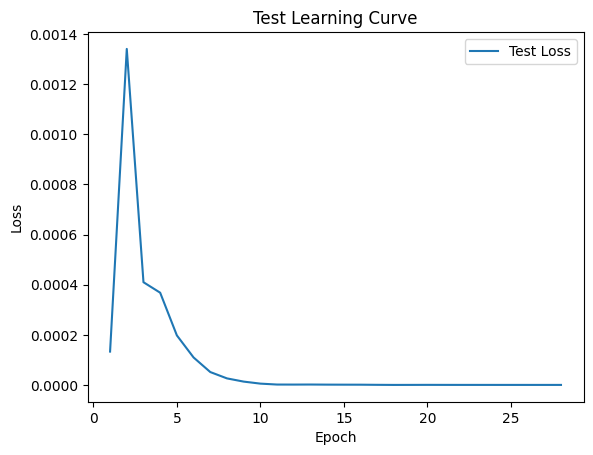


 Epoch: (29/50) Loss = 6.496693316648816e-08

 Epoch: (29/50) Loss_rmse = 0.00025488610845059156

 Epoch: (29/50) R^2 = 0.9999872446060181

 Epoch: (29/50) MAE = 0.00018597394227981567
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.6218487

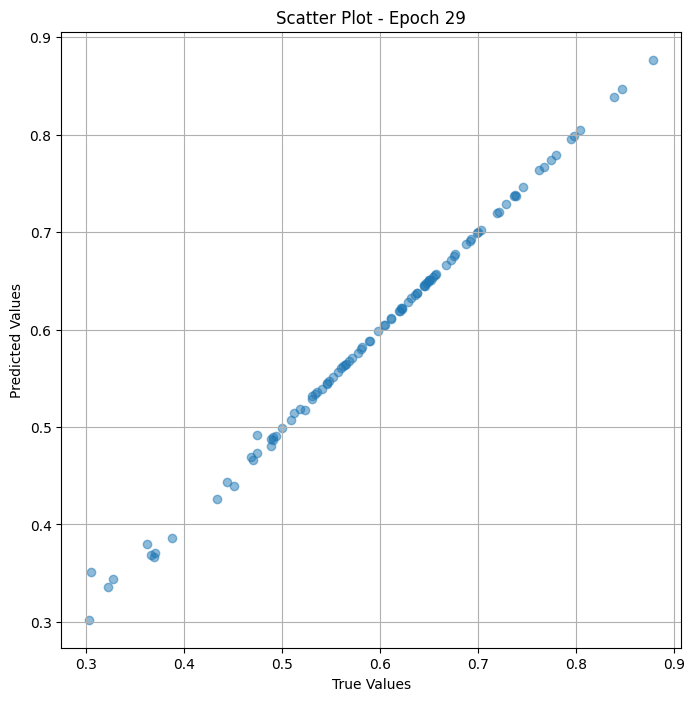

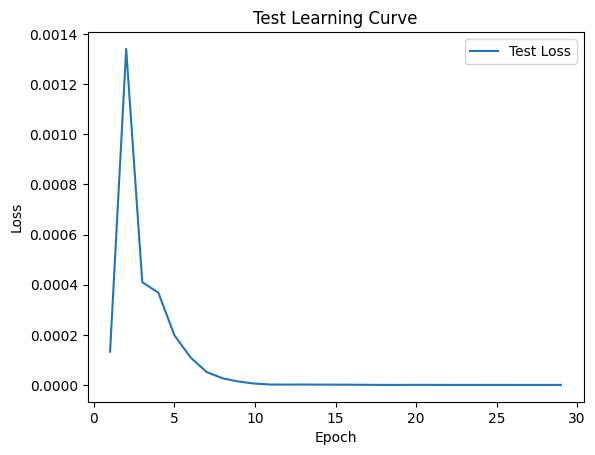


 Epoch: (30/50) Loss = 6.49389235718445e-08

 Epoch: (30/50) Loss_rmse = 0.00025483116041868925

 Epoch: (30/50) R^2 = 0.9999872446060181

 Epoch: (30/50) MAE = 0.00018594413995742798
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

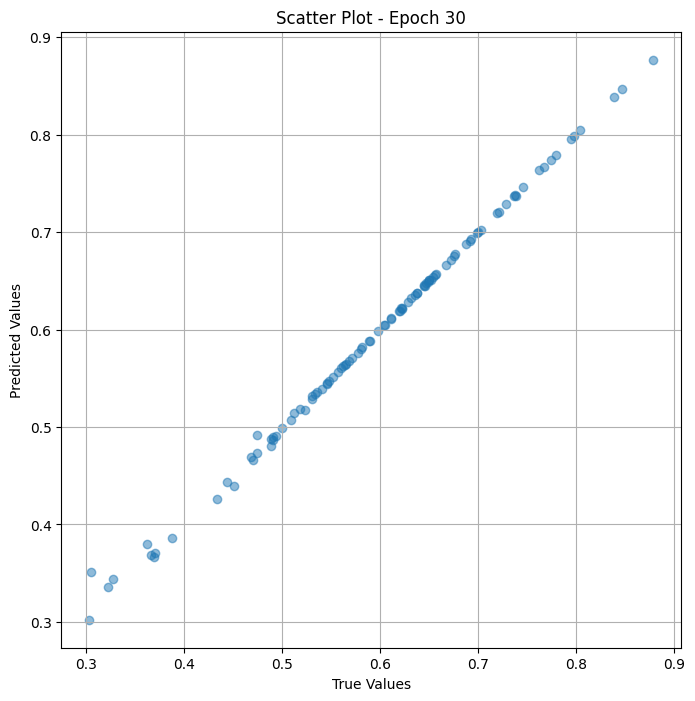

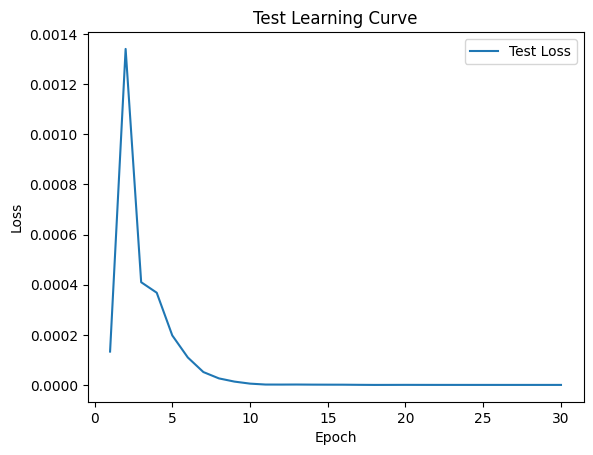


 Epoch: (31/50) Loss = 6.493732485068904e-08

 Epoch: (31/50) Loss_rmse = 0.0002548280172049999

 Epoch: (31/50) R^2 = 0.9999872446060181

 Epoch: (31/50) MAE = 0.00018592923879623413
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

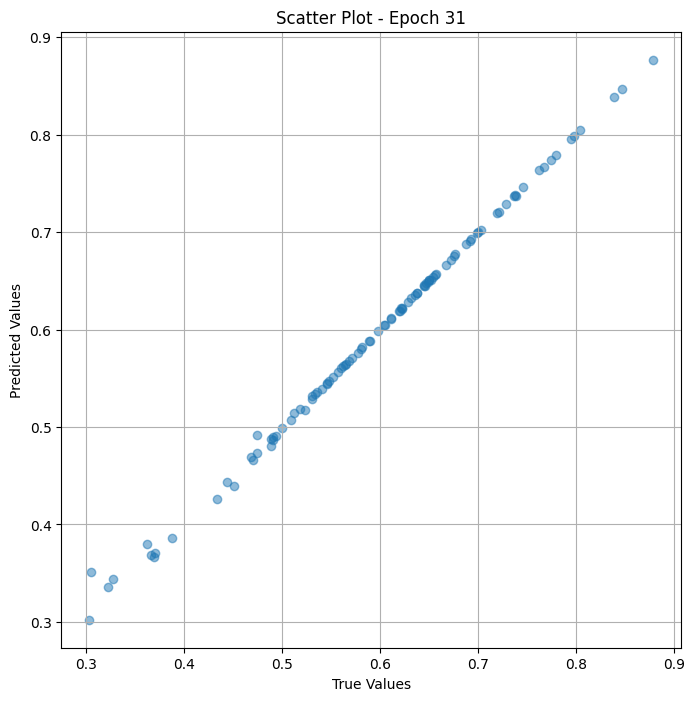

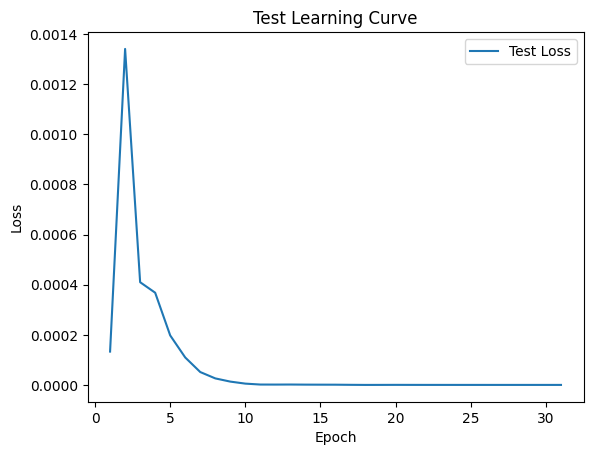


 Epoch: (32/50) Loss = 6.493988280453777e-08

 Epoch: (32/50) Loss_rmse = 0.00025483305216766894

 Epoch: (32/50) R^2 = 0.9999872446060181

 Epoch: (32/50) MAE = 0.00018593668937683105
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.6218487

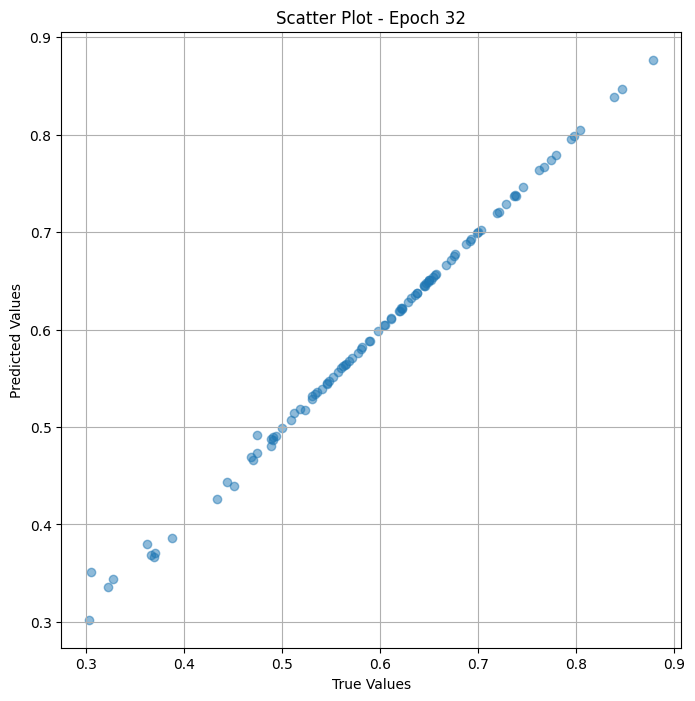

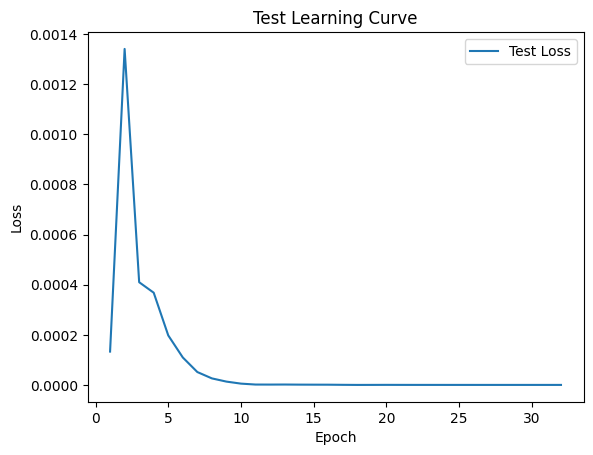


 Epoch: (33/50) Loss = 6.492573589866879e-08

 Epoch: (33/50) Loss_rmse = 0.0002548052871134132

 Epoch: (33/50) R^2 = 0.9999872446060181

 Epoch: (33/50) MAE = 0.0001859217882156372
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

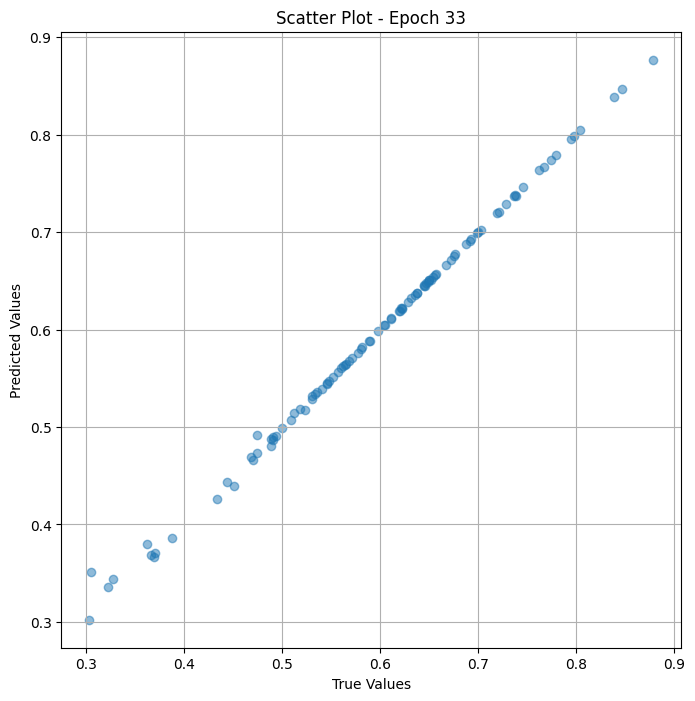

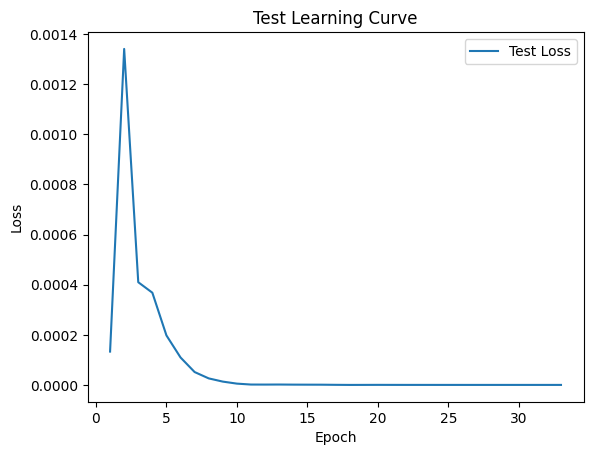


 Epoch: (34/50) Loss = 6.49070983627098e-08

 Epoch: (34/50) Loss_rmse = 0.0002547687035985291

 Epoch: (34/50) R^2 = 0.9999872446060181

 Epoch: (34/50) MAE = 0.00018586218357086182
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

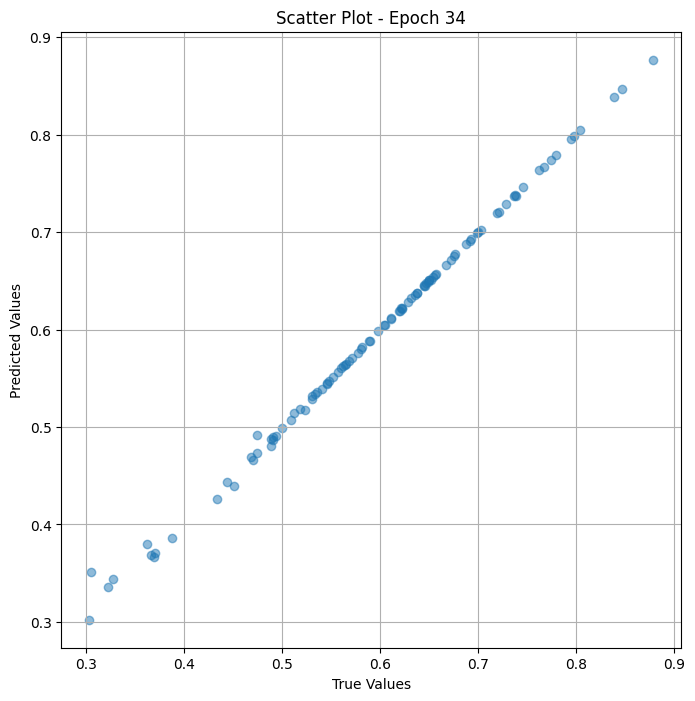

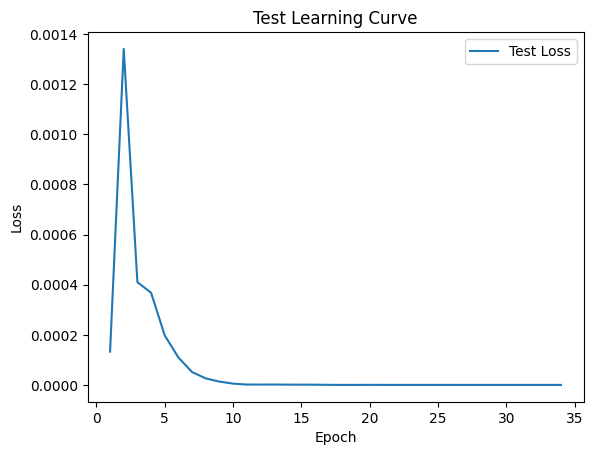


 Epoch: (35/50) Loss = 6.491222137583463e-08

 Epoch: (35/50) Loss_rmse = 0.00025477877352386713

 Epoch: (35/50) R^2 = 0.9999872446060181

 Epoch: (35/50) MAE = 0.00018587708473205566
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.6218487

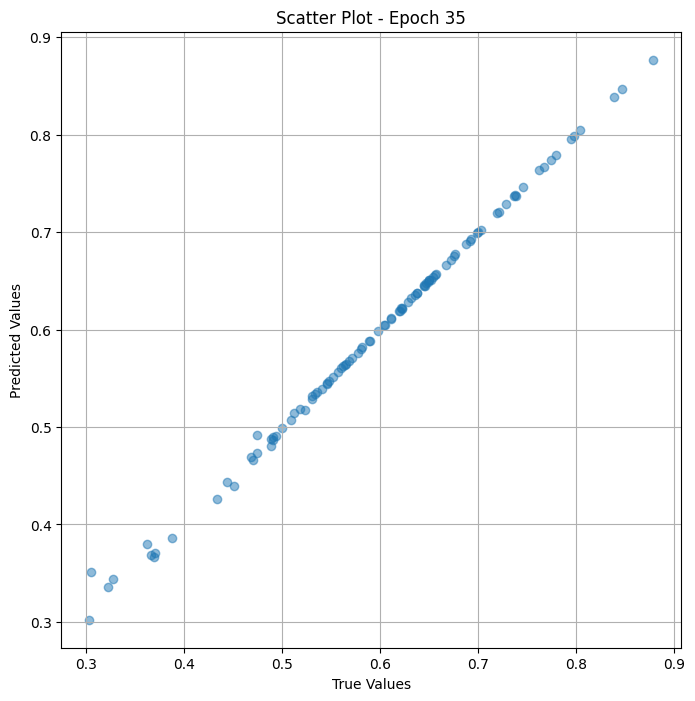

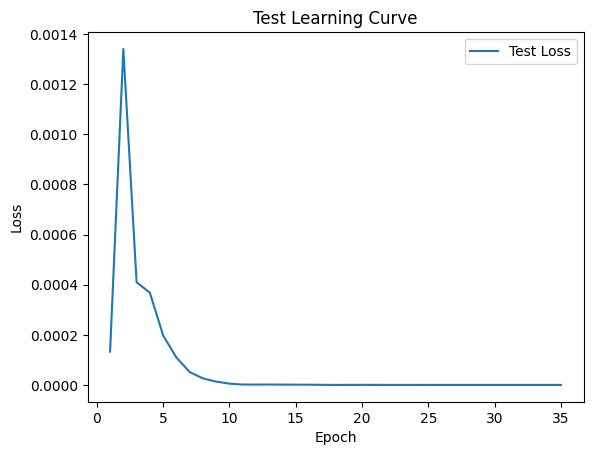


 Epoch: (36/50) Loss = 6.489806736453829e-08

 Epoch: (36/50) Loss_rmse = 0.00025475097936578095

 Epoch: (36/50) R^2 = 0.9999872446060181

 Epoch: (36/50) MAE = 0.00018586218357086182
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.6218487

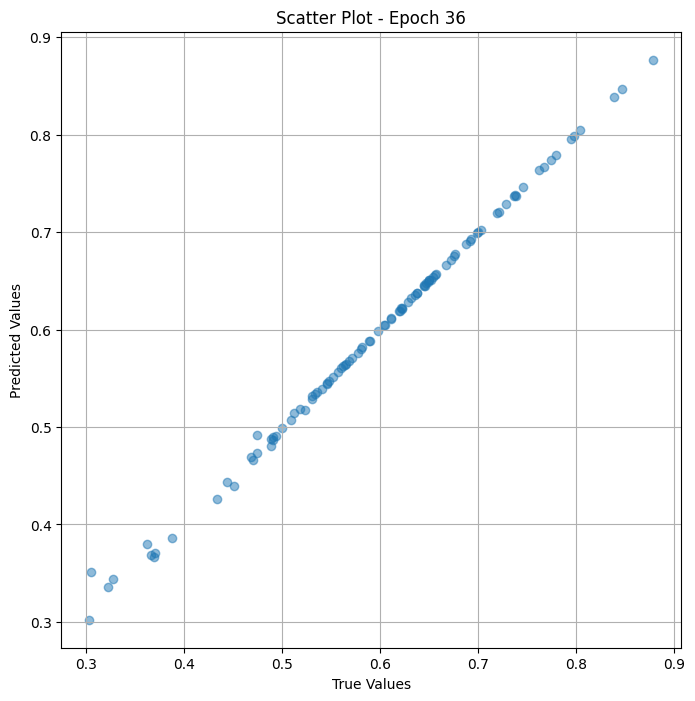

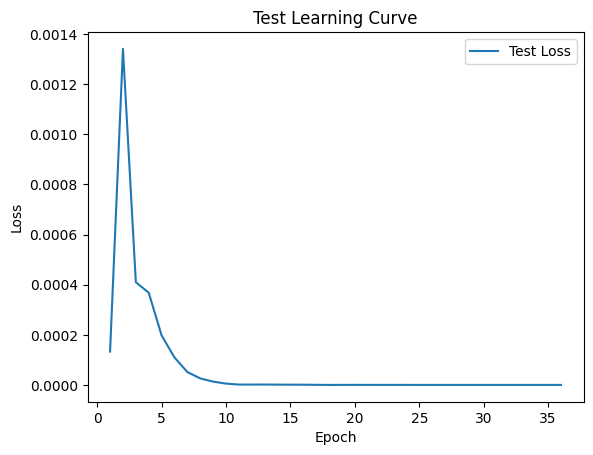


 Epoch: (37/50) Loss = 6.488522075187575e-08

 Epoch: (37/50) Loss_rmse = 0.0002547257754486054

 Epoch: (37/50) R^2 = 0.9999872446060181

 Epoch: (37/50) MAE = 0.00018586218357086182
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

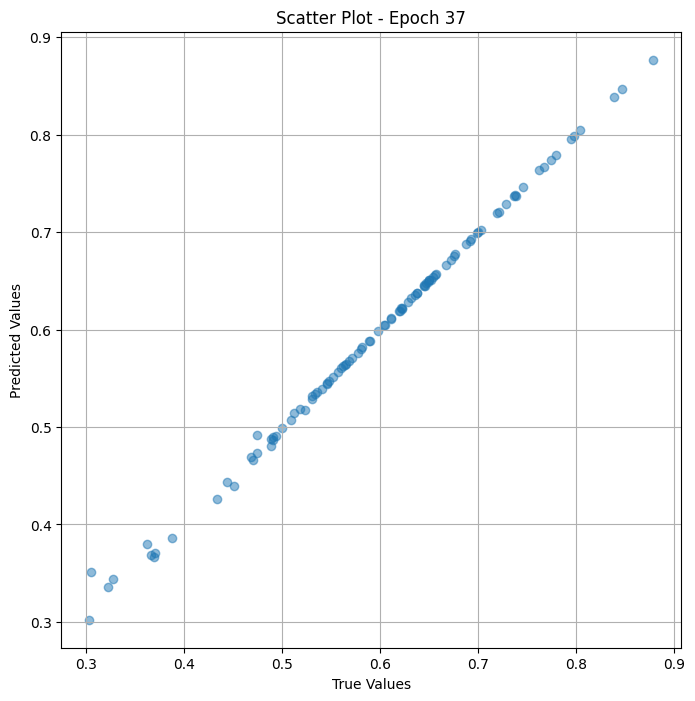

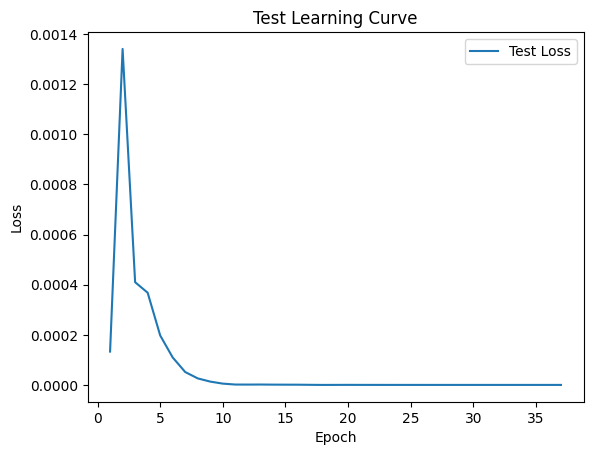


 Epoch: (38/50) Loss = 6.486978065822768e-08

 Epoch: (38/50) Loss_rmse = 0.00025469547836109996

 Epoch: (38/50) R^2 = 0.9999872446060181

 Epoch: (38/50) MAE = 0.00018583238124847412
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.6218487

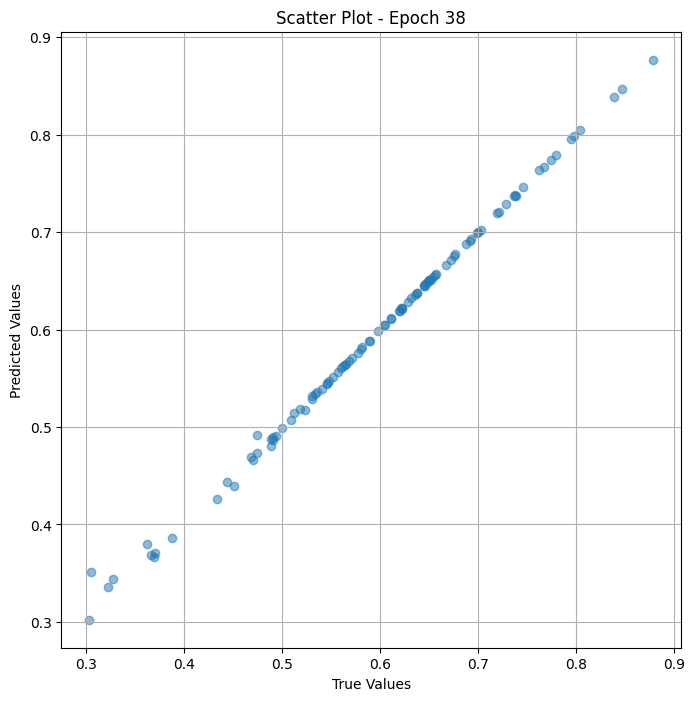

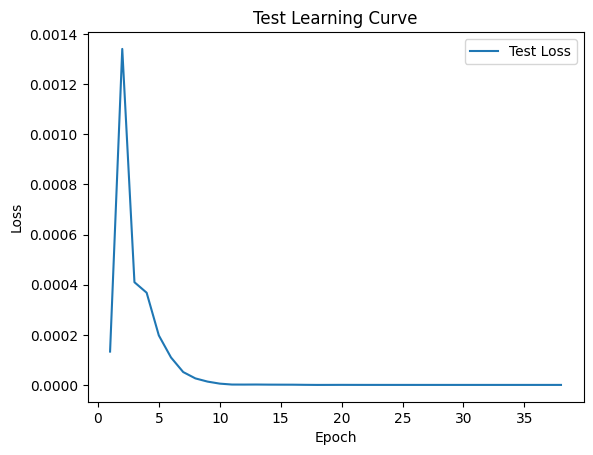


 Epoch: (39/50) Loss = 6.486978065822768e-08

 Epoch: (39/50) Loss_rmse = 0.00025469547836109996

 Epoch: (39/50) R^2 = 0.9999872446060181

 Epoch: (39/50) MAE = 0.00018583238124847412
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.6218487

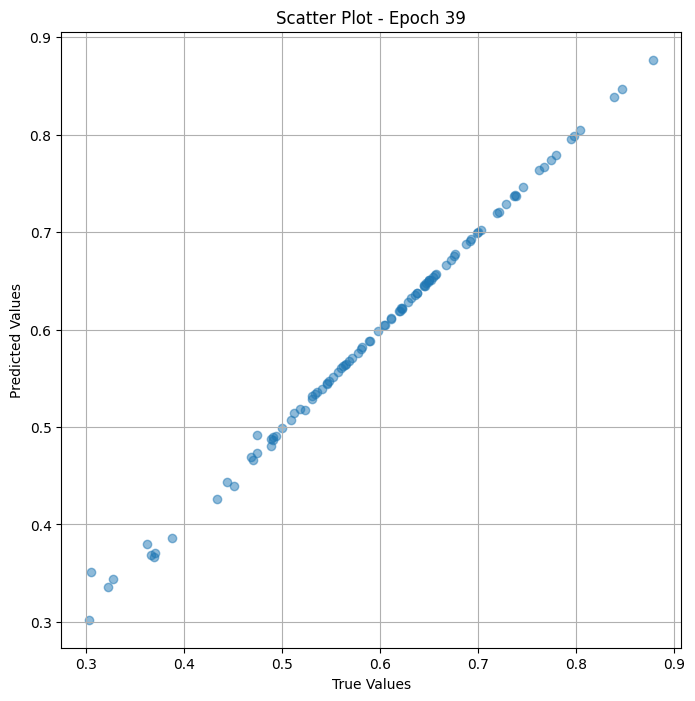

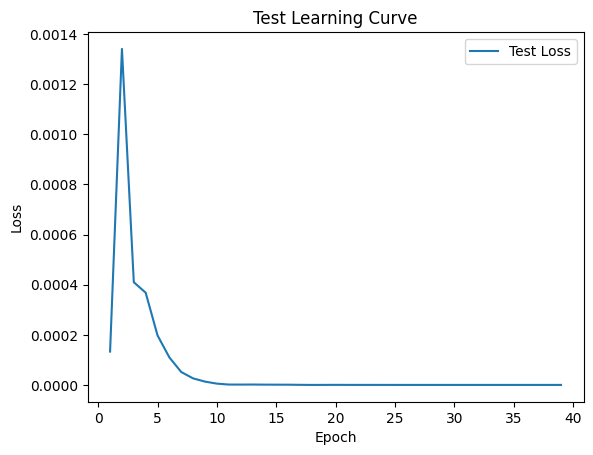


 Epoch: (40/50) Loss = 6.48466169650419e-08

 Epoch: (40/50) Loss_rmse = 0.0002546499890740961

 Epoch: (40/50) R^2 = 0.9999872446060181

 Epoch: (40/50) MAE = 0.00018581748008728027
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

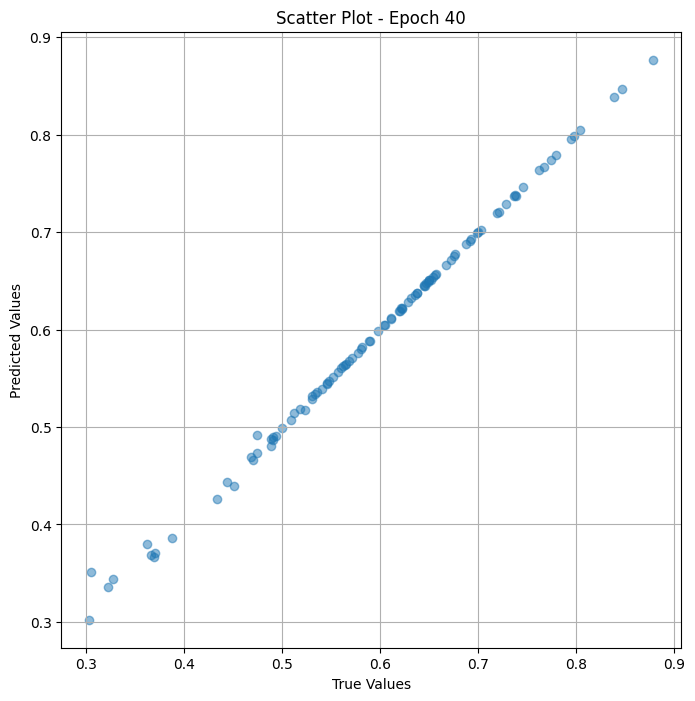

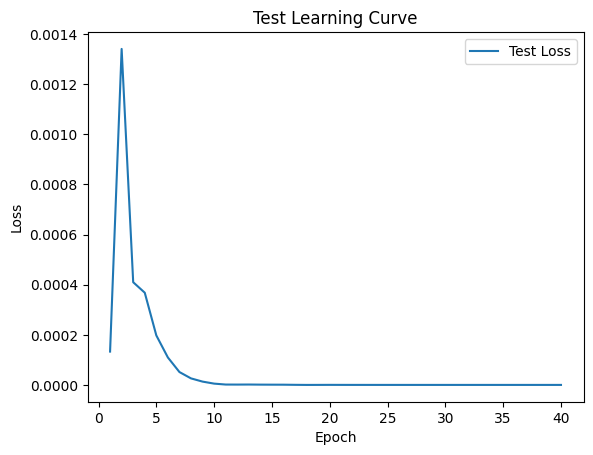


 Epoch: (41/50) Loss = 6.481834446958601e-08

 Epoch: (41/50) Loss_rmse = 0.00025459445896558464

 Epoch: (41/50) R^2 = 0.9999873042106628

 Epoch: (41/50) MAE = 0.00018578767776489258
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.6218487

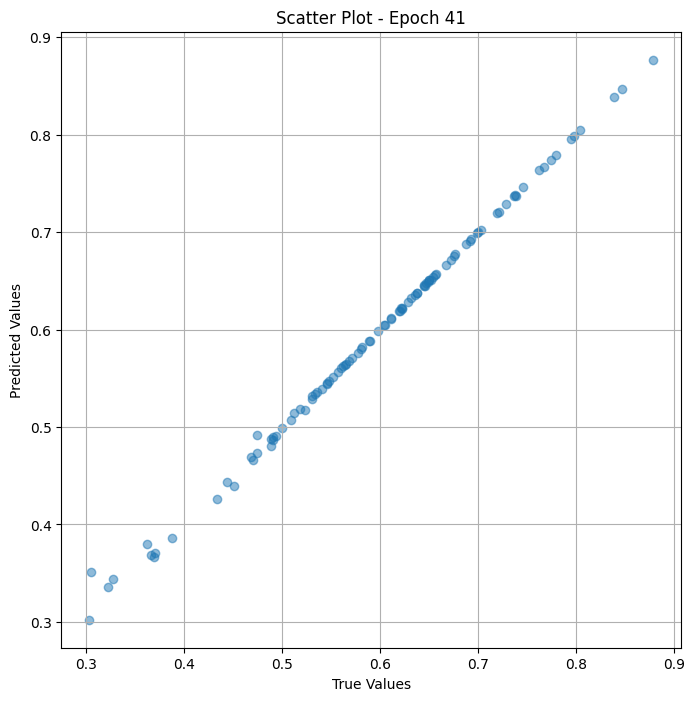

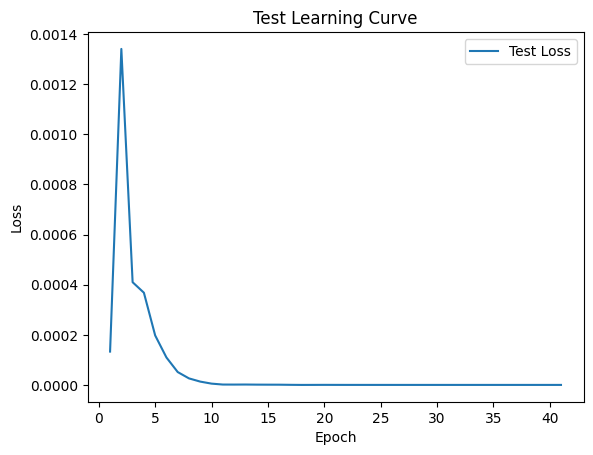


 Epoch: (42/50) Loss = 6.481162984073308e-08

 Epoch: (42/50) Loss_rmse = 0.00025458127493038774

 Epoch: (42/50) R^2 = 0.9999873042106628

 Epoch: (42/50) MAE = 0.00018575787544250488
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.6218487

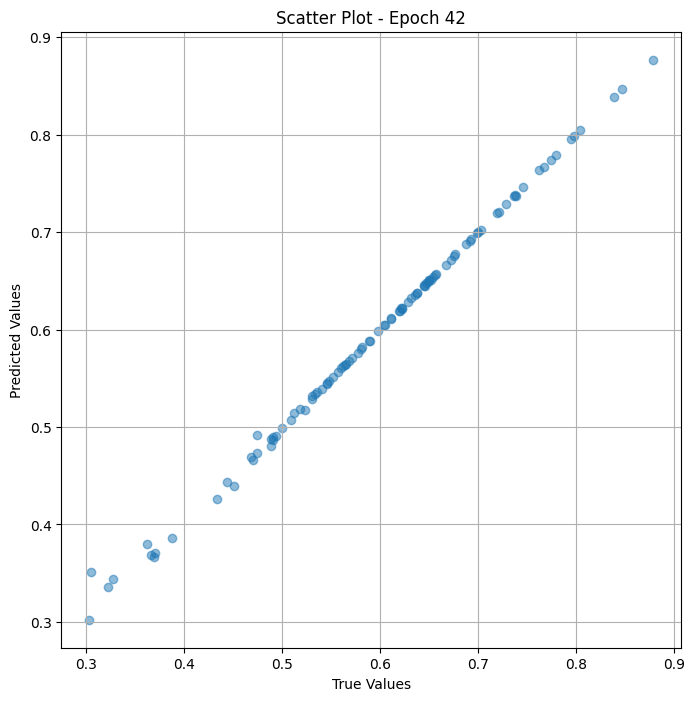

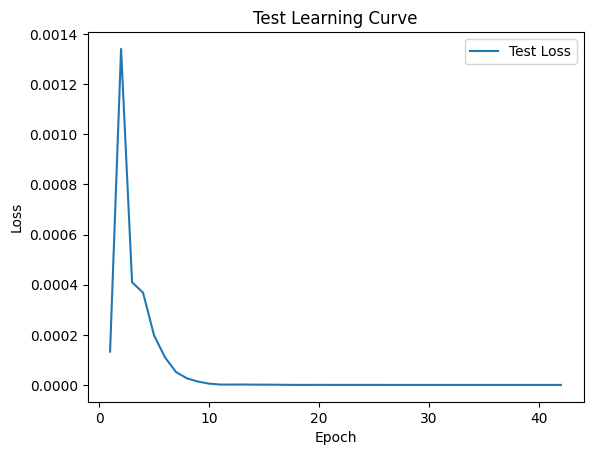


 Epoch: (43/50) Loss = 6.479749004029145e-08

 Epoch: (43/50) Loss_rmse = 0.000254553509876132

 Epoch: (43/50) R^2 = 0.9999873042106628

 Epoch: (43/50) MAE = 0.00018574297428131104
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

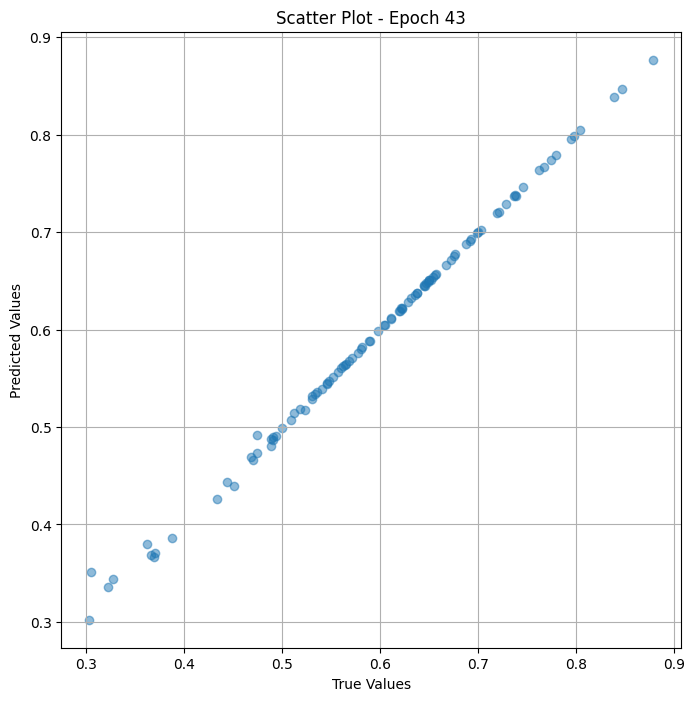

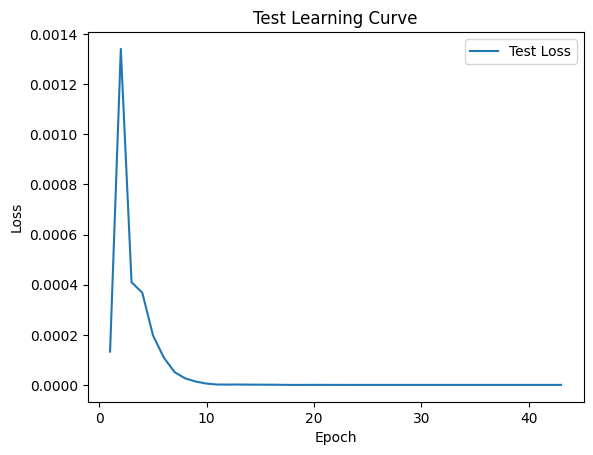


 Epoch: (44/50) Loss = 6.476663827470475e-08

 Epoch: (44/50) Loss_rmse = 0.0002544929157011211

 Epoch: (44/50) R^2 = 0.9999873042106628

 Epoch: (44/50) MAE = 0.00018568336963653564
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

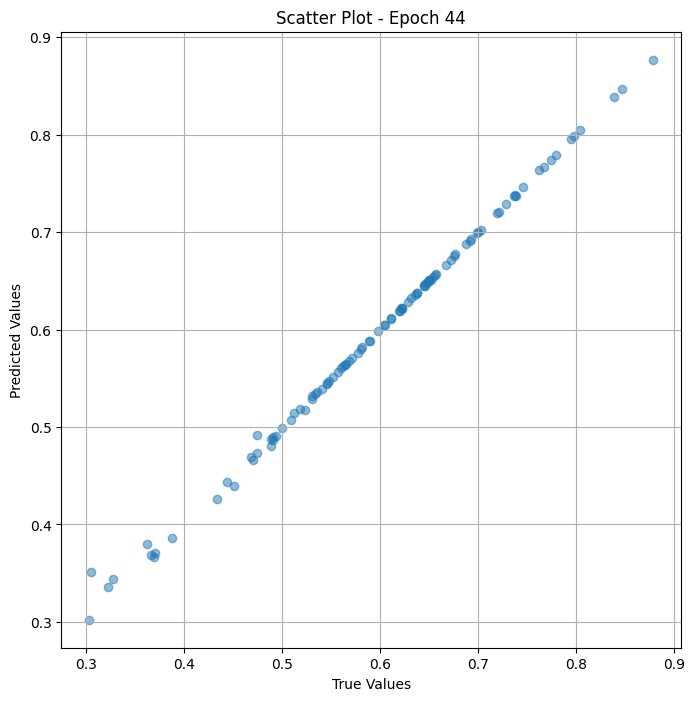

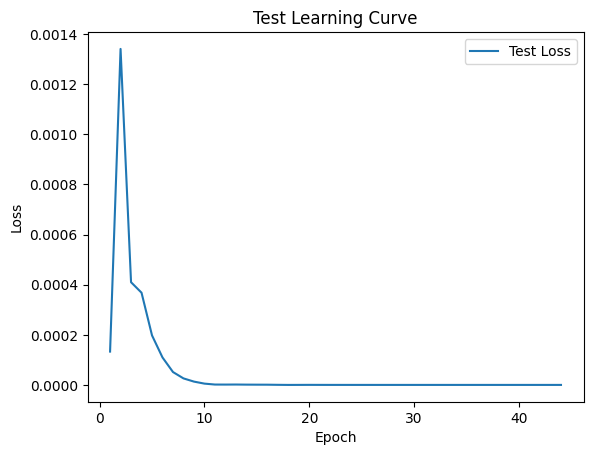


 Epoch: (45/50) Loss = 6.476534508692566e-08

 Epoch: (45/50) Loss_rmse = 0.0002544903545640409

 Epoch: (45/50) R^2 = 0.9999873042106628

 Epoch: (45/50) MAE = 0.0001856684684753418
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

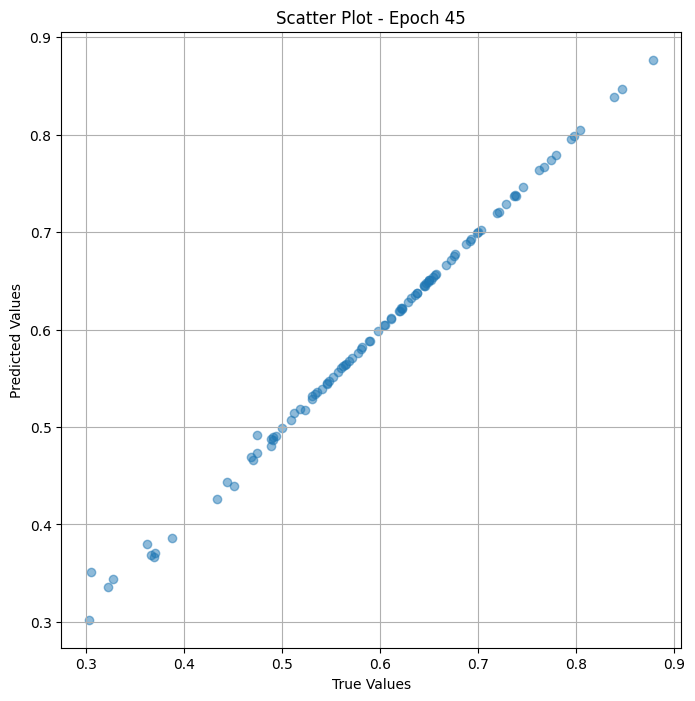

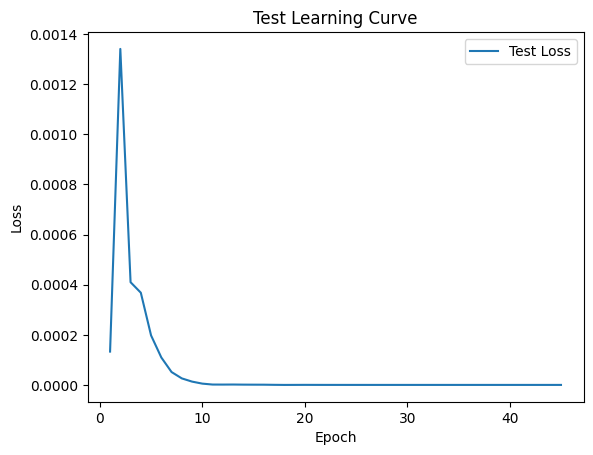


 Epoch: (46/50) Loss = 6.475250557969048e-08

 Epoch: (46/50) Loss_rmse = 0.00025446515064686537

 Epoch: (46/50) R^2 = 0.9999873042106628

 Epoch: (46/50) MAE = 0.0001856684684753418
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876

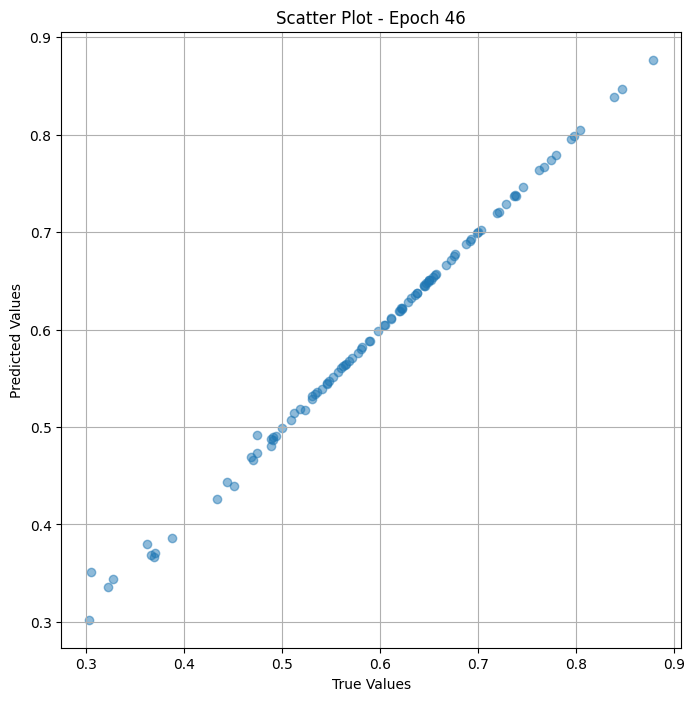

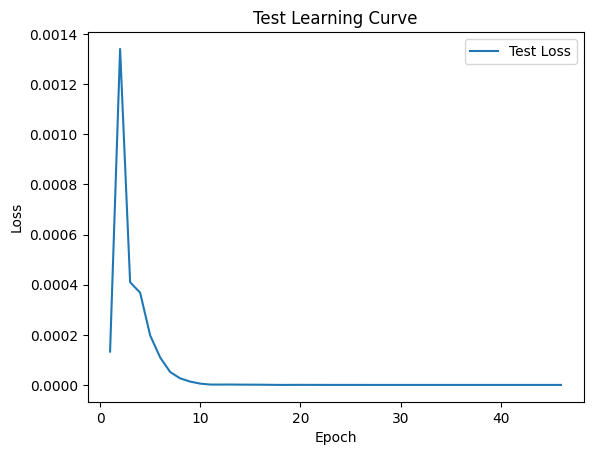


 Epoch: (47/50) Loss = 6.47226556793612e-08

 Epoch: (47/50) Loss_rmse = 0.0002544064773246646

 Epoch: (47/50) R^2 = 0.9999873042106628

 Epoch: (47/50) MAE = 0.00018562376499176025
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

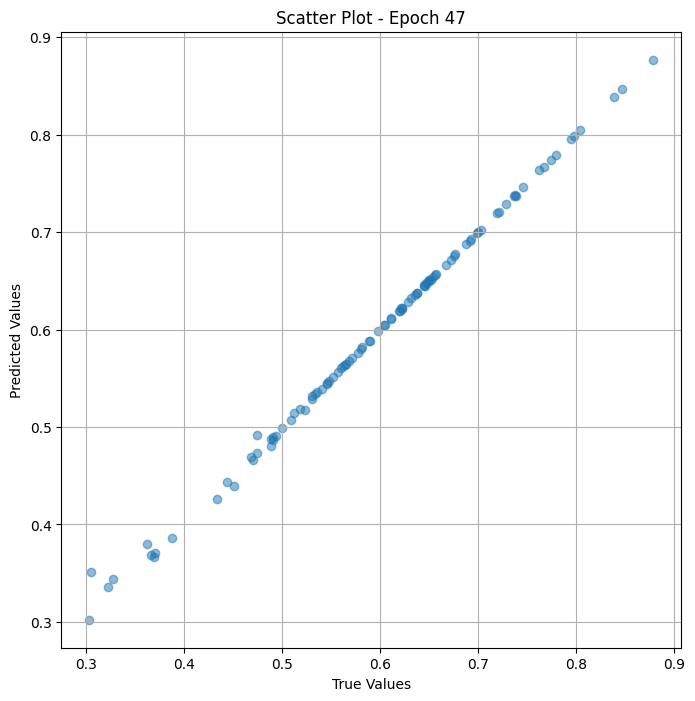

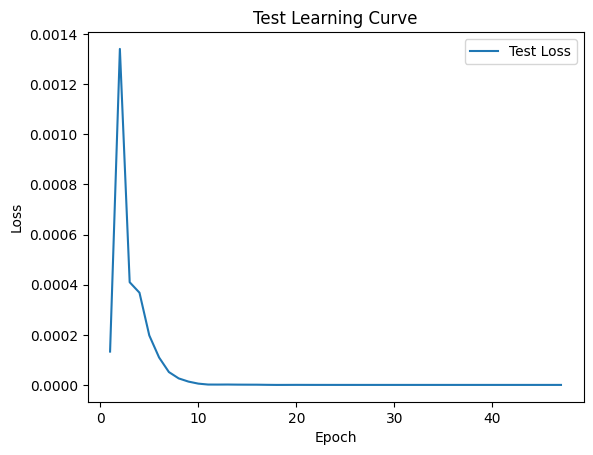


 Epoch: (48/50) Loss = 6.469441160561473e-08

 Epoch: (48/50) Loss_rmse = 0.00025435094721615314

 Epoch: (48/50) R^2 = 0.9999873042106628

 Epoch: (48/50) MAE = 0.00018559396266937256
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.6218487

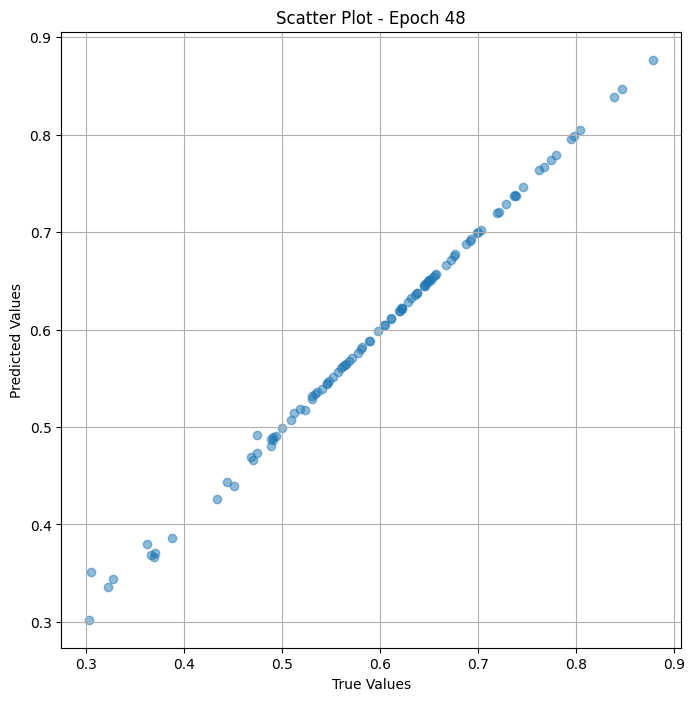

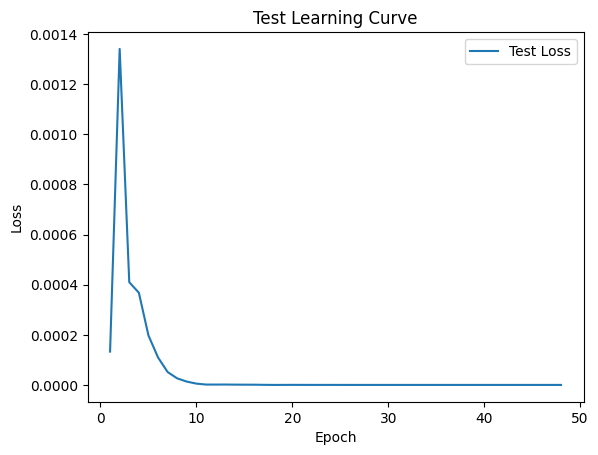


 Epoch: (49/50) Loss = 6.468029312145518e-08

 Epoch: (49/50) Loss_rmse = 0.0002543232112657279

 Epoch: (49/50) R^2 = 0.9999873042106628

 Epoch: (49/50) MAE = 0.0001855790615081787
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

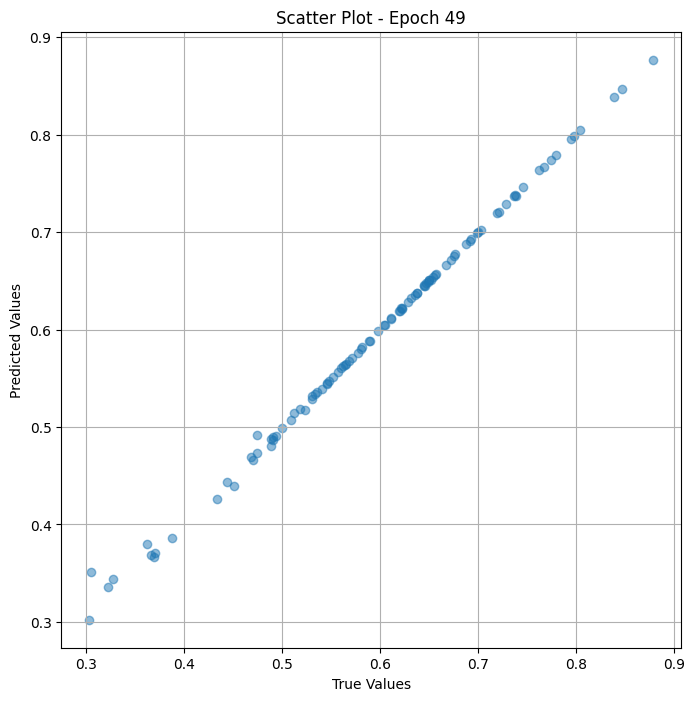

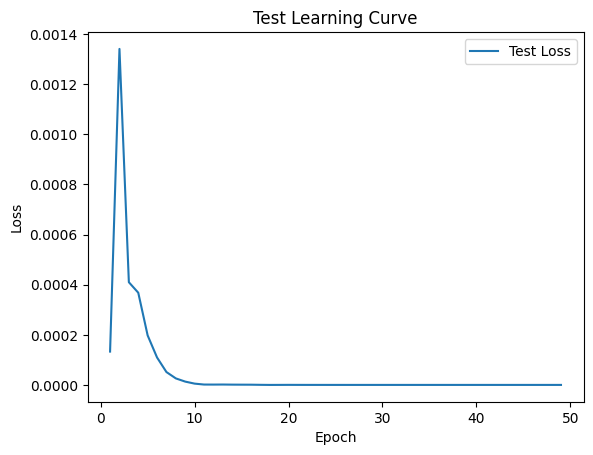


 Epoch: (50/50) Loss = 6.468029312145518e-08

 Epoch: (50/50) Loss_rmse = 0.0002543232112657279

 Epoch: (50/50) R^2 = 0.9999873042106628

 Epoch: (50/50) MAE = 0.0001855790615081787
Spearman correlation coefficient: SignificanceResult(statistic=0.9993760131538407, pvalue=2.69012474796133e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.5119048, 0.37, 0.4742268, 0.36585367, 0.635514, 0.55172414, 0.556701, 0.6216216, 0.60465115, 0.32258064, 0.7941176, 0.7619048, 0.8469388, 0.30555555, 0.67256635, 0.5185185, 0.47058824, 0.6875, 0.5677966, 0.4883721, 0.699187, 0.4939759, 0.58878505, 0.6494845, 0.5480769, 0.6666667, 0.8041237, 0.49056605, 0.5979381, 0.87826085, 0.675, 0.5405405, 0.54545456, 0.7386364, 0.48913044, 0.5301205, 0.58064514, 0.7787611, 0.7195122, 0.79787236, 0.58947366, 0.6111111, 0.6372549, 0.65384614, 0.49107143, 0.5604396, 0.5648148, 0.7368421, 0.5816327, 0.5308642, 0.7669903, 0.6226415, 0.5, 0.30357143, 0.62184876,

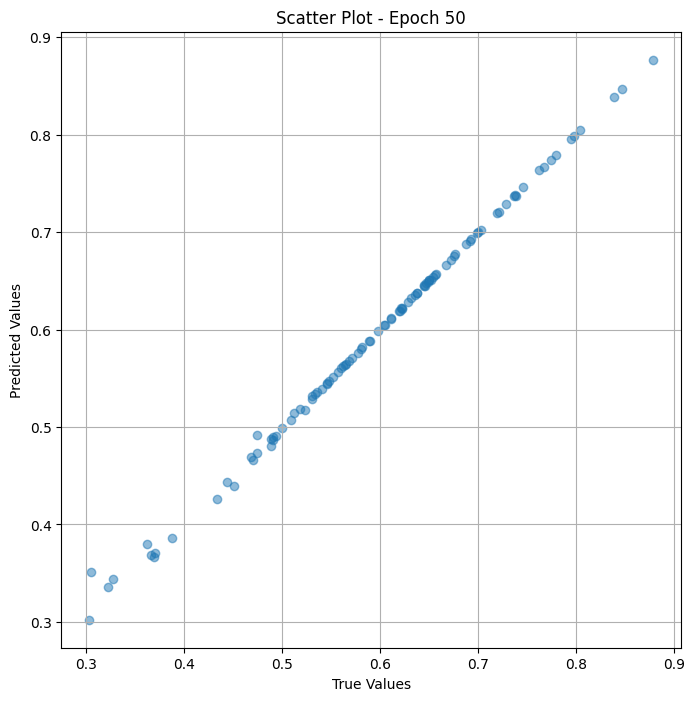

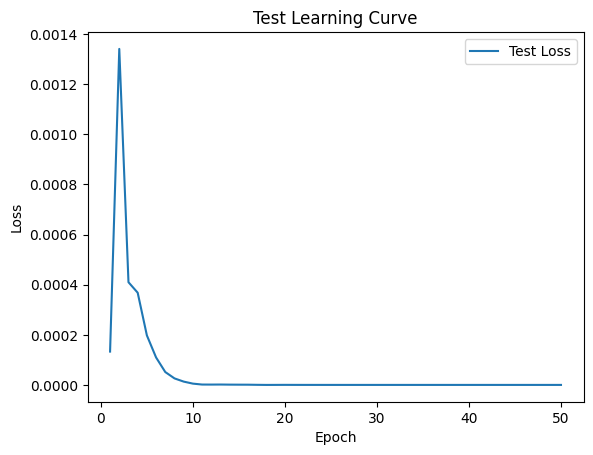

In [ ]:
# val the model and save weights
fit(50,model_res_test , test_dl )
torch.save(model_res_test.state_dict(), "model_weights_s")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds = model_res_test(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_landscape' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result_fine = pd.DataFrame({
    'Image Path': df_test_landscape['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result_fine)

                                           Image Path  True Value  \
0   /content/landscape/n07801091_49081_preprocesse...    0.564356   
1   /content/landscape/0ce0499b7f00cb0e_preprocess...    0.511905   
2   /content/landscape/sun_attunurkvvvrpksl_prepro...    0.370000   
3   /content/landscape/5e3a2b6e7943040f_preprocess...    0.474227   
4   /content/landscape/sun_ammlmcnlqojiatxv_prepro...    0.365854   
..                                                ...         ...   
95  /content/landscape/n09468604_15562_preprocesse...    0.774193   
96  /content/landscape/sun_aabtemlmesogqbbp_prepro...    0.533981   
97  /content/landscape/sun_auvwgyllqzsyfdyg_prepro...    0.535714   
98  /content/landscape/n09288635_12929_preprocesse...    0.644860   
99  /content/landscape/sun_afxtgecjnlpwldpz_prepro...    0.443396   

    Predicted Value  
0          0.563671  
1          0.514083  
2          0.370369  
3          0.473216  
4          0.368150  
..              ...  
95         0.7742

# ทดสอบกับรูปอื่นๆ

In [ ]:
model = ResNet_model_train_landscape()
image = Image.open("/content/animal/000000002066.jpg")

# Define preprocessing transforms
preprocess = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to match the input size expected by the model
    transforms.ToTensor(),           # Convert to a PyTorch tensor
    transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0])  # Normalize the image
])

# Apply preprocessing transforms
input_data = preprocess(image)

# Add batch dimension as the model expects a batch
input_data = input_data.unsqueeze(0)

# Assuming ViTMem_model is a PyTorch model
model = ResNet_model_train_landscape()
memorability = model(input_data)

print(f"Estimated memorability: {memorability}")



Estimated memorability: tensor([[0.4737]], grad_fn=<SigmoidBackward0>)
